In [1]:
cd /project/nakamura-lab08/Work/bin-wu/workspace/projects/clib/egs/riken/s0/

/project/nakamura-lab08/Work/bin-wu/workspace/projects/clib/egs/riken/s0


In [2]:
# Adapted from https://nipunbatra.github.io/blog/2014/latexify.html by bin-wu
!PATH=/project/nakamura-lab08/Work/bin-wu/.local/texlive/2018/bin/x86_64-linux:$PATH
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

sns.set_style('white')
sns.set_context('paper')
%matplotlib inline

import matplotlib
from math import sqrt
SPINE_COLOR = 'gray'

def latexify(fig_width=None, fig_height=None, columns=1):
    """Set up matplotlib's RC params for LaTeX plotting.
    Call this before plotting a figure.

    Parameters
    ----------
    fig_width : float, optional, inches
    fig_height : float,  optional, inches
    columns : {1, 2}
    """

    # code adapted from http://www.scipy.org/Cookbook/Matplotlib/LaTeX_Examples

    # Width and max height in inches for IEEE journals taken from
    # computer.org/cms/Computer.org/Journal%20templates/transactions_art_guide.pdf

    assert(columns in [1,2])

    if fig_width is None:
        fig_width = 3.39 if columns==1 else 6.9 # width in inches

    if fig_height is None:
        golden_mean = (np.sqrt(5)-1.0)/2.0    # Aesthetic ratio
        fig_height = fig_width*golden_mean # height in inches

    MAX_HEIGHT_INCHES = 8.0
    if fig_height > MAX_HEIGHT_INCHES:
        print("WARNING: fig_height too large:" + fig_height + 
              "so will reduce to" + MAX_HEIGHT_INCHES + "inches.")
        fig_height = MAX_HEIGHT_INCHES

    font_size=16
    params = {'backend': 'ps',
              'text.latex.preamble': [r'\usepackage{gensymb}'],
              'axes.labelsize': font_size, # fontsize for x and y labels (was 10)
              'axes.titlesize': font_size,
#              'text.fontsize': font_size, # was 10
              'legend.fontsize': font_size, # was 10
              'xtick.labelsize': font_size,
              'ytick.labelsize': font_size,
#              'text.usetex': True,
              'figure.figsize': [fig_width,fig_height],
              'font.family': 'serif',
              #'axes.prop_cycle': matplotlib.cycler(color='bgrcmyk')
              'errorbar.capsize': 4
    }

    matplotlib.rcParams.update(params)


def format_axes(ax):

    for spine in ['top', 'right']:
        ax.spines[spine].set_visible(False)

    for spine in ['left', 'bottom']:
        ax.spines[spine].set_color(SPINE_COLOR)
        ax.spines[spine].set_linewidth(0.5)

    ax.xaxis.set_ticks_position('bottom')
    ax.yaxis.set_ticks_position('left')

    for axis in [ax.xaxis, ax.yaxis]:
        axis.set_tick_params(direction='out', color=SPINE_COLOR)

    return ax

latexify()

In [3]:
# sox pair10_animal1_together_hear_1h10min.wav pair10_animal1_together_hear_1h10min_1065s_1075s.wav trim 1065 =1075
# sox 1100F_0124_2017.wav 1100F_0124_2017_0s_10s.wav trim 0 =10
# sox 1100F_0124_2017.wav 1100F_0124_2017_0s_30s.wav trim 0 =30
# sox -v 0.99 1100F_0124_2017.wav -t wav -r 48000 -b 16 - > 1100F_0124_2017_sox_uncompressed.wav # 16 bit for Kaldi extraction
# sox -v 0.99 1100F_0124_2017_0s_10s.wav -t wav -r 48000 -b 16 - > 1100F_0124_2017_0s_10s_sox_uncompressed.wav # 16 bit for Kaldi feature extraction
# sox -v 0.99 1100F_0124_2017_0s_30s.wav -t wav -r 48000 -b 16 - > 1100F_0124_2017_0s_30s_sox_uncompressed.wav # 16 bit for Kaldi feature extraction
path = "/project/nakamura-lab08/Work/bin-wu/workspace/datasets/riken/samples/1100F_0124_2017_0s_10s.wav"
# path = "/project/nakamura-lab08/Work/bin-wu/workspace/datasets/riken/samples/1100F_0124_2017_0s_10s_sox_uncompressed.wav"
# path = "/project/nakamura-lab08/Work/bin-wu/workspace/datasets/riken/samples/1100F_0124_2017_0s_30s_sox_uncompressed.wav"
# path = "/project/nakamura-lab08/Work/bin-wu/workspace/datasets/riken/samples/pair10_animal1_together_hear_1h10min_1065s_1075s.wav"

In [4]:
import kaldi_io
raw_mfcc13_scp="/project/nakamura-lab08/Work/bin-wu/workspace/projects/clib/egs/riken/s0/data/riken_sample_mfcc13/raw.scp"
mfcc13_scp="/project/nakamura-lab08/Work/bin-wu/workspace/projects/clib/egs/riken/s0/data/riken_sample_mfcc13/feats.scp"
mfcc39_scp="/project/nakamura-lab08/Work/bin-wu/workspace/projects/clib/egs/riken/s0/data/riken_sample_mfcc39/feats.scp"
mfcc40_scp="/project/nakamura-lab08/Work/bin-wu/workspace/projects/clib/egs/riken/s0/data/riken_sample_mfcc40/feats.scp"
mfcc80_scp="/project/nakamura-lab08/Work/bin-wu/workspace/projects/clib/egs/riken/s0/data/riken_sample_mfcc80/feats.scp"

raw_mel13_scp="/project/nakamura-lab08/Work/bin-wu/workspace/projects/clib/egs/riken/s0/data/riken_sample_mel13/raw.scp"
mel13_scp="/project/nakamura-lab08/Work/bin-wu/workspace/projects/clib/egs/riken/s0/data/riken_sample_mel13/feats.scp"
mel39_scp="/project/nakamura-lab08/Work/bin-wu/workspace/projects/clib/egs/riken/s0/data/riken_sample_mel39/feats.scp"
mel80_scp="/project/nakamura-lab08/Work/bin-wu/workspace/projects/clib/egs/riken/s0/data/riken_sample_mel80/feats.scp"
mel80_delta1_scp="/project/nakamura-lab08/Work/bin-wu/workspace/projects/clib/egs/riken/s0/data/riken_sample_mel80_delta1/feats.scp"
mel80_delta2_scp="/project/nakamura-lab08/Work/bin-wu/workspace/projects/clib/egs/riken/s0/data/riken_sample_mel80_delta2/feats.scp"

raw_mfcc13_feats = {key: mat for key, mat in kaldi_io.read_mat_scp(raw_mfcc13_scp)}
mfcc13_feats = {key: mat for key, mat in kaldi_io.read_mat_scp(mfcc13_scp)}
mfcc39_feats = {key: mat for key, mat in kaldi_io.read_mat_scp(mfcc39_scp)} # 13 + delta + delta
mfcc40_feats = {key: mat for key, mat in kaldi_io.read_mat_scp(mfcc40_scp)}
mfcc80_feats = {key: mat for key, mat in kaldi_io.read_mat_scp(mfcc80_scp)}

raw_mel13_feats = {key: mat for key, mat in kaldi_io.read_mat_scp(raw_mel13_scp)}
mel13_feats = {key: mat for key, mat in kaldi_io.read_mat_scp(mel13_scp)}
mel39_feats = {key: mat for key, mat in kaldi_io.read_mat_scp(mel39_scp)} # 13 + delta + delta
mel80_feats = {key: mat for key, mat in kaldi_io.read_mat_scp(mel80_scp)}
mel80_delta1_feats = {key: mat for key, mat in kaldi_io.read_mat_scp(mel80_delta1_scp)}
mel80_delta2_feats = {key: mat for key, mat in kaldi_io.read_mat_scp(mel80_delta2_scp)}
for key, mat in kaldi_io.read_mat_scp(mel80_scp):
    print(key)

utt_key = "1100F_0124_2017_0s_10s" 

################################################################################
### WARNING, path does not exist: KALDI_ROOT=/mnt/matylda5/iveselyk/Tools/kaldi-trunk
###          (please add 'export KALDI_ROOT=<your_path>' in your $HOME/.profile)
###          (or run as: KALDI_ROOT=<your_path> python <your_script>.py)
################################################################################



1100F_0124_2017
1100F_0124_2017_0s_10s
1100F_0124_2017_0s_30s


In [16]:
import os
import librosa
import librosa.display
import scipy

import python_speech_features

sampling_rate = 48000

# librosa.stft setting (n_fft=512 recommended for speech feature extraction))
n_fft=512
window_size_num_samples = n_fft
window_shift_num_samples = window_size_num_samples // 4 # default shift of librosa.stft.
window_size_ms = round((window_size_num_samples / sampling_rate) * 1000, ndigits=3)
window_shift_ms = round((window_shift_num_samples / sampling_rate) * 1000, ndigits=3)

# Tacotron setting
window_size_ms=50
window_shift_ms=12.5
n_fft=int(window_size_ms / 1000 * sampling_rate)

# # Kaldi setting
# window_size_ms=25
# window_shift_ms=10
# n_fft=int(window_size_ms / 1000 * sampling_rate)

spectrum_type="linear"


# FFT on a frame

In [6]:
def sample2time(sample_index, sr=16000):
    """ Index of a sample of a waveform to the time of the waveform."""
    time = sample_index / float(sr)
    return time

def time2sample(time, sr=16000):
    """ Time of a waveform to the left closest sample index of the waveform."""
    sample_index = time * sr
    return int(sample_index)

def index2time(frame_index, window_size=0.025, window_shift=0.01, ndigits=7, center=False):
    """ Find time of a frame center according to its index (index2framecentertime).                                                                                                                                                                      
                                                                                                                                                                                                                   
    Parameters                                                                                                                                                                                                     
    ----------                                                                                                                                                                                                     
    frame_index: the index of the frame                                                                                                                                                                            
    window_size: the frame window length of each frame in seconds (default: 0.025)                                                                                                                                                    
    window_shift: the frame window shift between successive frames in seconds  (default: 0.01)
    ndigits: The number of decimals to use when rounding the time (default 7)
    center (bool): True when origin is the frame center, False when origin is the frame start.
                                                                                                                                                                                                                   
    Returns                                                                                                                                                                                                        
    -------                                                                                                                                                                                                        
    the time of the center of the give frame in seconds
    
    Example
    -------
    window_size_ms=50
    window_shift_ms=12.5
    print(index2time(frame_index=1, window_size=window_size_ms/1000, window_shift=window_shift_ms/1000)) # 0.0375
    print(time2index(0.0376, window_size=window_size_ms/1000, window_shift=window_shift_ms/1000)) # 1
    print(index2time(frame_index=1, window_size=window_size_ms/1000, window_shift=window_shift_ms/1000, center=True)) # 0.125
    print(time2index(0.0124, window_size=window_size_ms/1000, window_shift=window_shift_ms/1000, center=True)) # 1
    
    time2index(index2time(frame_index=3, window_size=window_size_ms/1000, window_shift=window_shift_ms/1000), window_size=window_size_ms/1000, window_shift=window_shift_ms/1000) # 3
    """
    if (center):
        time = frame_index * window_shift        
    else:
        time = window_size / 2 + frame_index * window_shift
    return round(time, ndigits)

def time2index(time, precision=0.00001, window_size=0.025, window_shift=0.01, ndigits=7, center=False, verbose=False):
    """ Find the nearest frame index to the given time (time2nearestindex).                                                                                                                                                                 
                                                                                                                                                                                                                   
    Parameters                                                                                                                                                                                                     
    ----------                                                                                                                                                                                                     
    time: any given time in seconds                                                                                                                                                                        
    window_size: the frame window length of each frame in seconds (default: 0.025)                                                                                                                                                    
    window_shift: the frame window shift between successive frames in seconds  (default: 0.01)                                                                                                                                        
    precision: the round precision when cutting the float to interger (default: 0.00001)
    ndigits: The number of decimals to use when rounding the time (default 7)
    center (bool): True when origin is the frame center, False when origin is the frame start.
    verbose (bool): True return frame index, frame begin and end times; False return frame index
                                                                                                                                                                                                                   
    Returns                                                                                                                                                                                                        
    ------                                                                                                                                                                                                         
    the index of the frame (starting from zero), alternatively the start second of frame window, and the end second of frame window                                                                                                                                                                                
                                                                                                                                                                                                                   
    
    Example
    -------
    window_size_ms=50
    window_shift_ms=12.5
    print(index2time(frame_index=1, window_size=window_size_ms/1000, window_shift=window_shift_ms/1000)) # 0.0375
    print(time2index(0.0376, window_size=window_size_ms/1000, window_shift=window_shift_ms/1000)) # 1
    print(index2time(frame_index=1, window_size=window_size_ms/1000, window_shift=window_shift_ms/1000, center=True)) # 0.125
    print(time2index(0.0124, window_size=window_size_ms/1000, window_shift=window_shift_ms/1000, center=True)) # 1
    
    time2index(index2time(frame_index=3, window_size=window_size_ms/1000, window_shift=window_shift_ms/1000), window_size=window_size_ms/1000, window_shift=window_shift_ms/1000) # 3
    """
    time=float(time)
    if (center):
        prev_index = int(time / window_shift)
    else:
        if (time < window_size / 2): return 0
        #  prev_index = int((time - window_size / 2) / window_shift)
        prev_index = int(round((time - window_size / 2), ndigits) / window_shift)

    prev_time = index2time(prev_index, window_size=window_size, window_shift=window_shift, center=center)
    next_time = index2time(prev_index + 1, window_size=window_size, window_shift=window_shift, center=center)
    average_time = (prev_time + next_time) / 2

    # 'floor' may have some precision issue, so make a precision bound.                                                                                                         
    assert time - prev_time > -precision and next_time - time > -precision, f"{prev_index=}, {prev_time=}, {time=}, {next_time=}"

    index = prev_index if time -average_time < 0 else prev_index + 1
    begin_window_sec = round(index2time(index, window_size=window_size, window_shift=window_shift, center=center) - window_size/2, ndigits)
    end_window_sec = round(index2time(index, window_size=window_size, window_shift=window_shift, center=center) + window_size/2, ndigits)

    return (index, begin_window_sec, end_window_sec) if verbose else index

def load_wav(path, sr, begin_sec=None, end_sec=None):
    """
    Load a wav file or its segment.

    Parameters
    ----------
    path: the path of the audio
    sr: sampling rate of the audio
    begin_sec: the beginning time (in second) of the segment of the audio
    end_sec: the end time (in second) of the segment of the audio

    Returns
    -------
    the data of wav file or the data of its segment
    """
    wav, _ = librosa.load(path, sr=sr)
    if begin_sec is None and end_sec is None: return wav
    else:
        if begin_sec is None: begin_index = 0
        if end_sec is None: end_index = len(wav)
        assert begin_sec < end_sec, "the begin time of the segment should be less than the end time."
        begin_index = max(int(begin_sec * sr), 0)
        end_index = min(int(end_sec * sr), len(wav))
    
    return wav[begin_index:end_index]

def draw_wav(wav, sampling_rate=48000, xlabel="Time (second)", ylabel="Amplitude", title=None, figsize=(14, 4.2)):
    fig = plt.figure(figsize=figsize)
    ax = fig.add_subplot(111)
    librosa.display.waveshow(wav, x_axis='s', sr=sampling_rate)
    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)
    ax.set_title(title)
    plt.tight_layout()
    format_axes(ax)
    return ax

def draw_line_plot(array, xlabel=None, ylabel=None, title=None, data_range_min=None, data_range_max=None, figsize=(14, 4.2)):
    fig = plt.figure(figsize=figsize)
    ax = fig.add_subplot(111)
    ax.plot(np.arange(len(array)), array)
    if (xlabel): ax.set_xlabel(xlabel)
    if (ylabel): ax.set_ylabel(ylabel)
    if (title): ax.set_title(title)
    plt.tight_layout()
    format_axes(ax)
    return ax


from typing import List
def fourier_transform(wav: List, sr: str = None, amplitude: bool = True, half: bool = True):
    """Apply fast Fourier transform (FFT) on the array of wav.
    
    Parameters
    ----------
    wav: an array of samples
    sampling_rate: the sampling rate of the wav audio shape (n, )
    amplitude: return magnitude of Fourier coefficient if True shape (n, )
    half: only take the half of the FFT frequency values (FFT of real signal is symmetric)
    
    Returns
    -------
    the amplitude of the FFT when amplitude is True; coefficient when amplitude is False (n, 0) or (n//2+1, 0) staring from 0Hz
    the frequency array of FFT (normalized by sampling_rate)
    
    Example
    -------
    amplitude, freq = fourier_transform(wav, sr = sampling_rate, amplitude=True, half=True)
    ax = draw_line_plot(amplitude, title="FFT of waveform", xlabel="Frequency (Hz)", ylabel="Amplitude", figsize=figsize)
    freq_ax(ax, freq, num_xticks_show=6)
    """
    fft_coeff = np.abs(scipy.fft.fft(wav)) if amplitude else scipy.fft.fft(wav)
    freq_bin = np.fft.fftfreq(len(wav), d=1/sr) if sr else None
    result = (fft_coeff[0: len(fft_coeff) // 2 + 1], freq_bin[0: len(freq_bin) // 2 + 1]) if half else (fft_coeff, freq_bin)
    
    return result

def freq_ax(ax, freq, num_xticks_show=6):
    """Normalize the xticks to frequency for fft.

    Example
    -------
    amplitude, freq = fourier_transform(wav, sr = sampling_rate, amplitude=True, half=True)
    ax = draw_line_plot(amplitude, title="FFT of waveform", xlabel="Frequency (Hz)", ylabel="Amplitude", figsize=figsize)
    freq_ax(ax, freq, num_xticks_show=6)
    """
    ax.set_xticks(np.linspace(start=0, stop=len(freq), num=num_xticks_show, endpoint=True))
    xticks=ax.get_xticks().tolist()
    tick_step= xticks[1] - xticks[0]
    labels = ["{:.0f}".format(abs(x)) for x in freq[::int(tick_step)]] # abs makes xticks of -500Hz to be 500Hz
    ax.set_xticklabels(labels)
    ax.grid()
    return ax

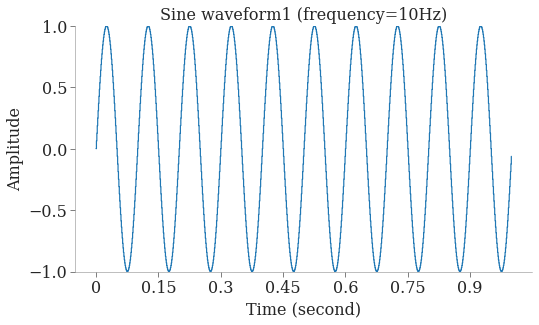

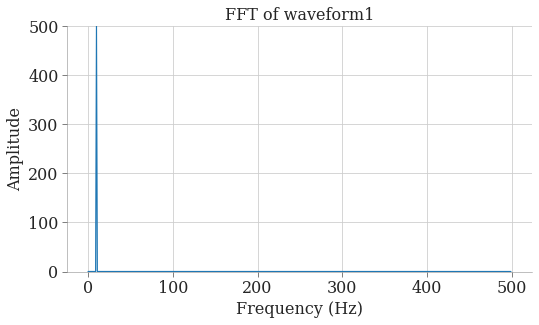

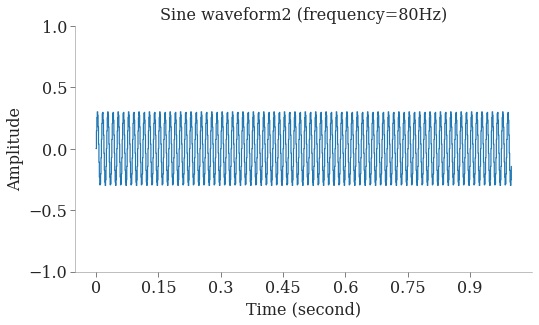

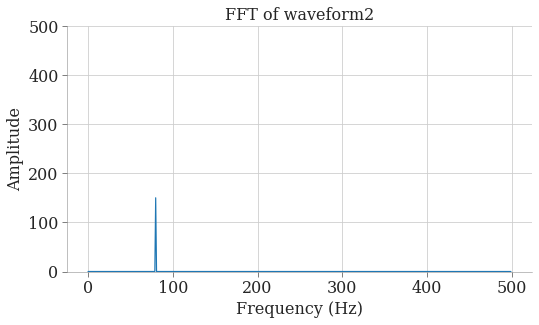

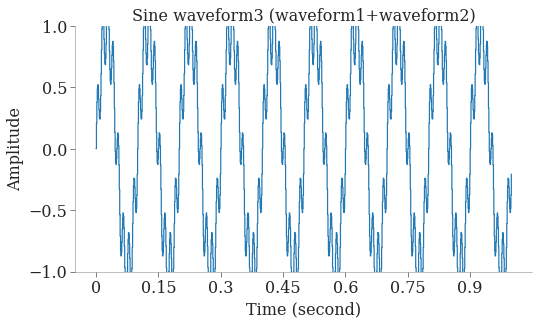

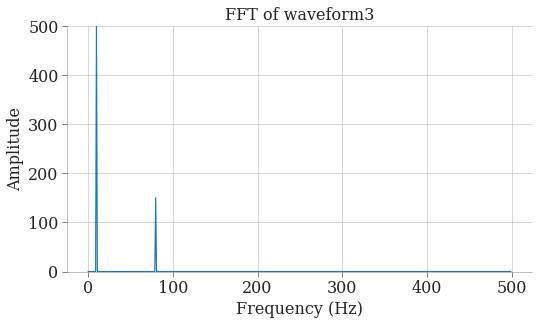

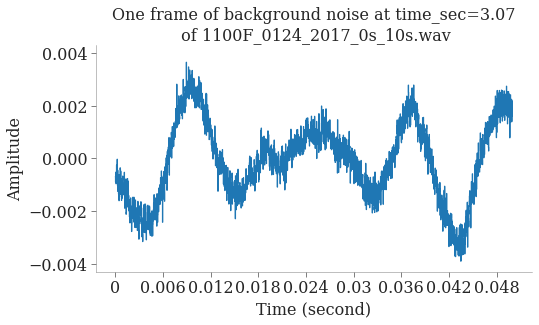

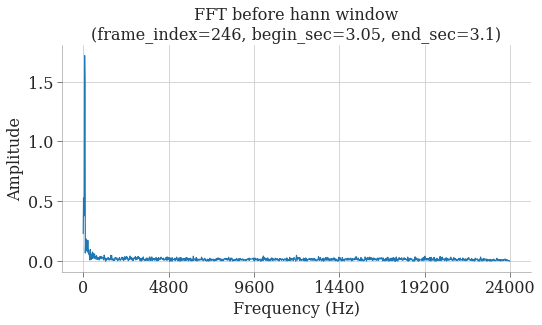

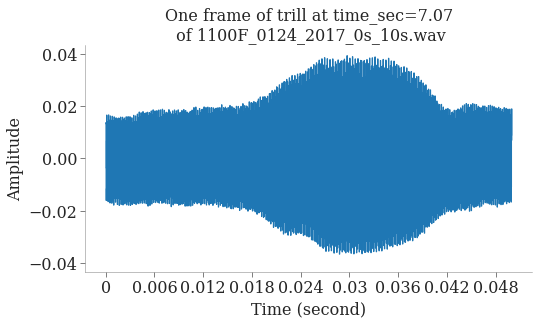

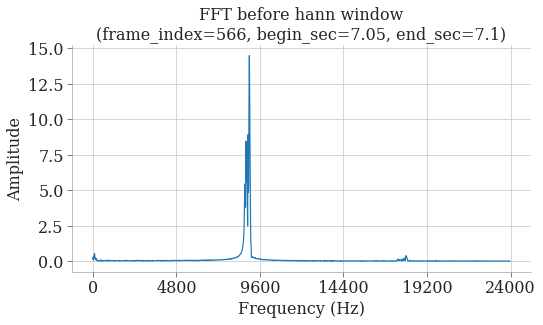

In [7]:
freq1 = 10
freq2 = 80
weight1 = 1
weight2 = 0.3
begin_sec = 0
end_sec = 1
num_samples = 1000
figsize=(6.9 * 1.1, 4.2 * 1.1)

sr = num_samples / (end_sec - begin_sec)
angular_freq1 = 2 * np.pi * freq1
angular_freq2 = 2 * np.pi * freq2
time = np.linspace(begin_sec, end_sec, num_samples, False)  # 1 second
y1 = weight1 * np.sin(angular_freq1 * time)
y2 = weight2 * np.sin(angular_freq2 * time)
y3 = y1 + y2

ax = draw_wav(y1, sampling_rate=sr, title="Sine waveform1 (frequency={}Hz)".format(freq1), figsize=figsize)
ax.set_ylim(-1, 1)
amplitude, freq = fourier_transform(y1, sr = sr, amplitude=True, half=True)
ax = draw_line_plot(amplitude, title="FFT of waveform1", xlabel="Frequency (Hz)", ylabel="Amplitude", figsize=figsize)
freq_ax(ax, freq, num_xticks_show=6)
ax.set_ylim(0, 500)

ax = draw_wav(y2, sampling_rate=sr, title="Sine waveform2 (frequency={}Hz)".format(freq2), figsize=figsize)
ax.set_ylim(-1, 1)
amplitude, freq = fourier_transform(y2, sr = sr, amplitude=True, half=True)
ax = draw_line_plot(amplitude, title="FFT of waveform2", xlabel="Frequency (Hz)", ylabel="Amplitude", figsize=figsize)
freq_ax(ax, freq, num_xticks_show=6)
ax.set_ylim(0, 500)

ax = draw_wav(y3, sampling_rate=sr, title="Sine waveform3 (waveform1+waveform2)", figsize=figsize)
ax.set_ylim(-1, 1)
amplitude, freq = fourier_transform(y3, sr = sr, amplitude=True, half=True)
ax = draw_line_plot(amplitude, title="FFT of waveform3", xlabel="Frequency (Hz)", ylabel="Amplitude", figsize=figsize)
freq_ax(ax, freq, num_xticks_show=6)
ax.set_ylim(0, 500)

time=3.07
frame_index, begin_sec, end_sec = time2index(time, window_size=window_size_ms/1000, window_shift=window_shift_ms/1000, center=True, verbose=True)
wav = load_wav(path=path, sr=sampling_rate, begin_sec=begin_sec, end_sec=end_sec)
draw_wav(wav, sampling_rate=sampling_rate, title="One frame of background noise at time_sec={}\n of {}".format(time, os.path.basename(path)), figsize=figsize)
amplitude, freq = fourier_transform(wav, sr = sampling_rate, amplitude=True, half=True)
ax = draw_line_plot(amplitude, title=f"FFT before hann window\n({frame_index=}, {begin_sec=}, {end_sec=})", xlabel="Frequency (Hz)", ylabel="Amplitude", figsize=figsize)
freq_ax(ax, freq, num_xticks_show=6)

time=7.07
frame_index, begin_sec, end_sec = time2index(time, window_size=window_size_ms/1000, window_shift=window_shift_ms/1000, center=True, verbose=True)
wav = load_wav(path=path, sr=sampling_rate, begin_sec=begin_sec, end_sec=end_sec)
draw_wav(wav, sampling_rate=sampling_rate, title="One frame of trill at time_sec={}\n of {}".format(time, os.path.basename(path)), figsize=figsize)
amplitude, freq = fourier_transform(wav, sr = sampling_rate, amplitude=True, half=True)
ax = draw_line_plot(amplitude, title=f"FFT before hann window\n({frame_index=}, {begin_sec=}, {end_sec=})", xlabel="Frequency (Hz)", ylabel="Amplitude", figsize=figsize)
freq_ax(ax, freq, num_xticks_show=6)

# time=None
# wav = load_wav(path=path, sr=sampling_rate)
# draw_wav(wav, sampling_rate=sampling_rate, title="The first 10 seconds of {}".format(os.path.basename(path)), figsize=figsize)
# amplitude, freq = fourier_transform(wav, sr = sampling_rate, amplitude=True, half=True)
# ax = draw_line_plot(amplitude, title="FFT of the first 10 seconds of {}".format(os.path.basename(path)), xlabel="Frequency (Hz)", ylabel="Amplitude", figsize=figsize)
# freq_ax(ax, freq, num_xticks_show=8)

# time=None
# local_path = "/project/nakamura-lab08/Work/bin-wu/workspace/datasets/riken/samples/1100F_0124_2017.wav"
# wav = load_wav(path=local_path, sr=sampling_rate)
# draw_wav(wav, sampling_rate=sampling_rate, title="{}".format(os.path.basename(local_path)), figsize=figsize)
# amplitude, freq = fourier_transform(wav, sr = sampling_rate, amplitude=True, half=True)
# ax = draw_line_plot(amplitude, title="FFT of {}".format(os.path.basename(local_path)), xlabel="Frequency (Hz)", ylabel="Amplitude", figsize=figsize)
# freq_ax(ax, freq, num_xticks_show=8)

frame_index=566, begin_sec=7.05, end_sec=7.1
len(wav)=2400


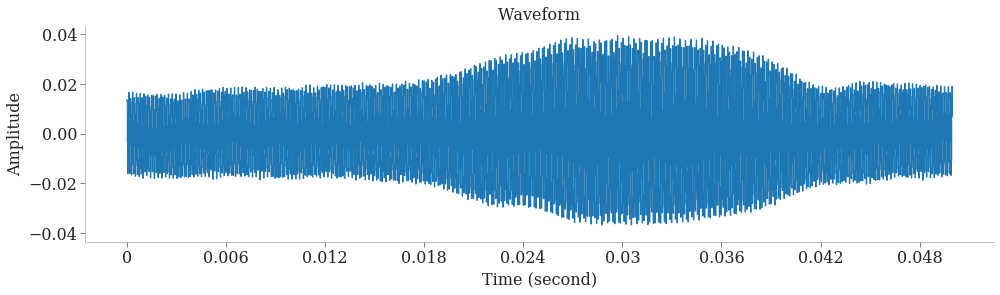

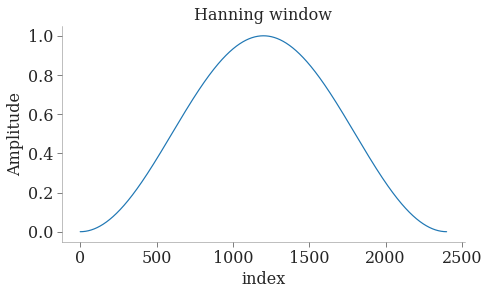

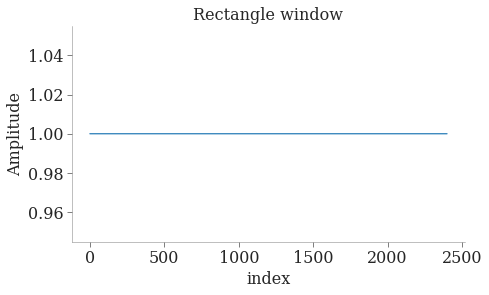

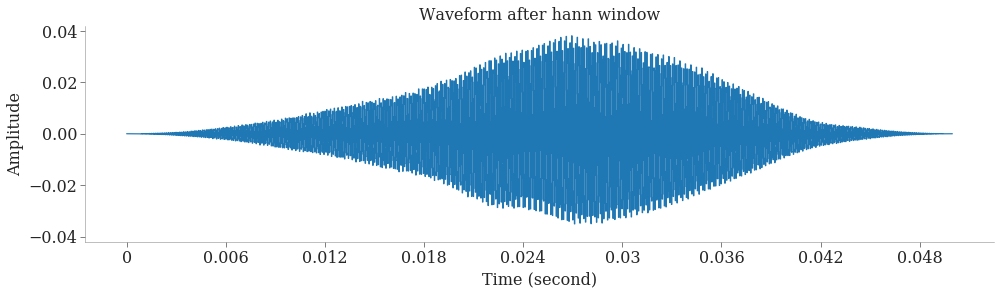

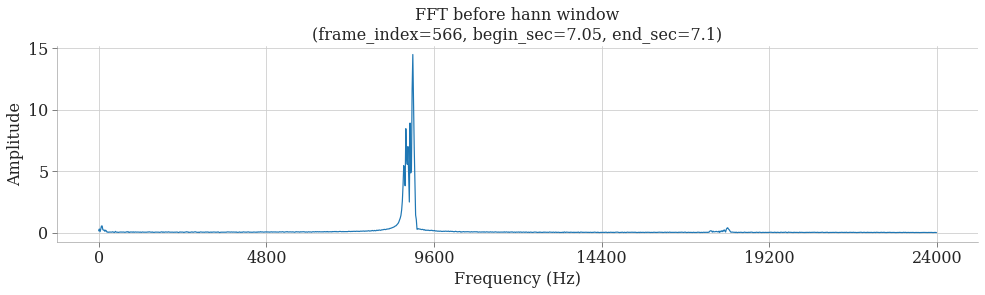

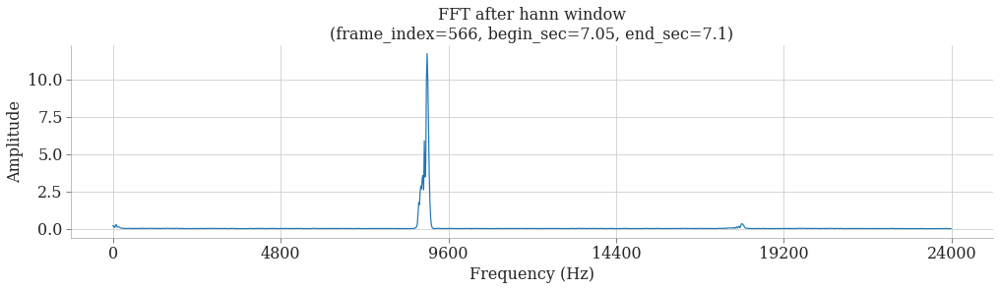

In [9]:
# window_size_ms=50
# window_shift_ms=12.5
time = 5.98
#time = 6.05
#time = 4.63
time=7.07
# time=2.4

# figsize=(6.9*1.8, 4.2*1.58)
figsize=(14, 4.2)

# figsize=(6.9, 4.2)
num_xticks_show=6

frame_index, begin_sec, end_sec = time2index(time, window_size=window_size_ms/1000, window_shift=window_shift_ms/1000, center=True, verbose=True)
print(f"{frame_index=}, {begin_sec=}, {end_sec=}")

wav = load_wav(path=path, sr=sampling_rate, begin_sec=begin_sec, end_sec=end_sec)
print(f"{len(wav)=}")
draw_wav(wav, sampling_rate=sampling_rate, title="Waveform", figsize=figsize)

hann_window = scipy.signal.get_window('hann', len(wav))
draw_line_plot(hann_window, title="Hanning window", xlabel="index", ylabel="Amplitude", figsize=(6.9, 4.2))

rectangle_window = scipy.signal.get_window('boxcar', len(wav))
draw_line_plot(rectangle_window, title="Rectangle window", xlabel="index", ylabel="Amplitude", figsize=(6.9, 4.2))

wav_backup = wav
wav = hann_window * wav
draw_wav(wav, sampling_rate=sampling_rate, title="Waveform after hann window", figsize=figsize)
coeff, freq = fourier_transform(wav, sr=sampling_rate, half=True)

amplitude, freq = fourier_transform(wav_backup, sr = sampling_rate, amplitude=True, half=True)
ax = draw_line_plot(amplitude, title=f"FFT before hann window\n({frame_index=}, {begin_sec=}, {end_sec=})", xlabel="Frequency (Hz)", ylabel="Amplitude", figsize=figsize)
freq_ax(ax, freq, num_xticks_show=num_xticks_show)

amplitude, freq = fourier_transform(wav, sr = sampling_rate, amplitude=True, half=True)
ax = draw_line_plot(amplitude, title=f"FFT after hann window\n({frame_index=}, {begin_sec=}, {end_sec=})", xlabel="Frequency (Hz)", ylabel="Amplitude", figsize=figsize)
freq_ax(ax, freq, num_xticks_show=num_xticks_show)

<ipython-input-6-1b8a40ecd00c>:120: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=figsize)
<ipython-input-6-1b8a40ecd00c>:120: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.figure(figsize=figsize)
<ipython-input-6-1b8a40ecd00c>:120: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig = plt.f

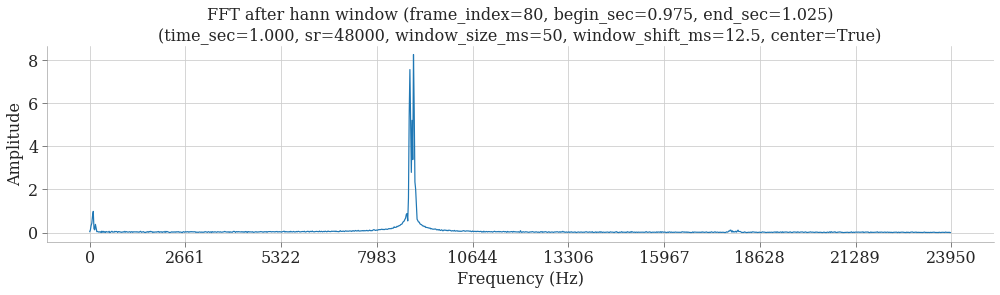

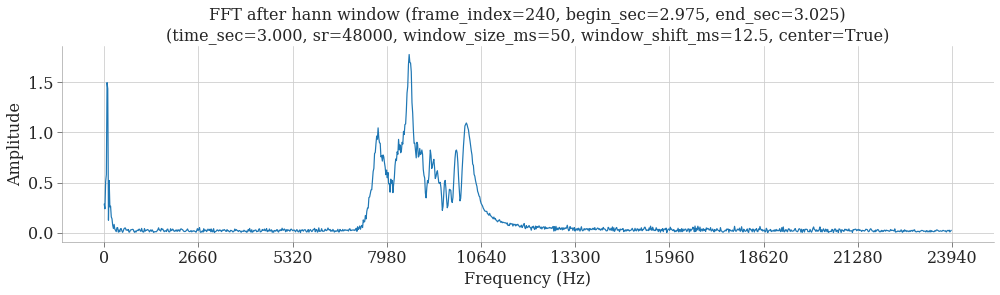

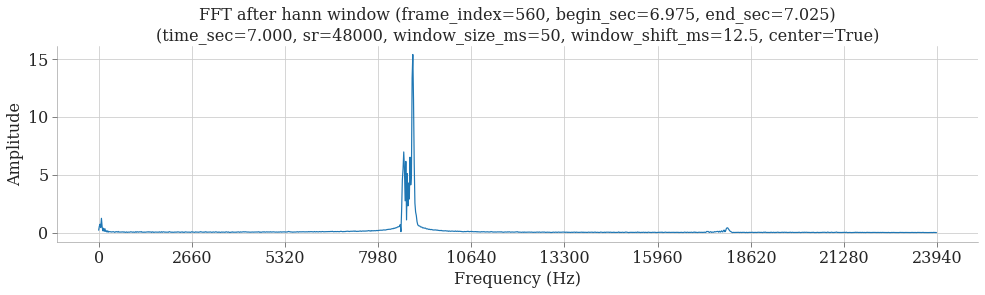

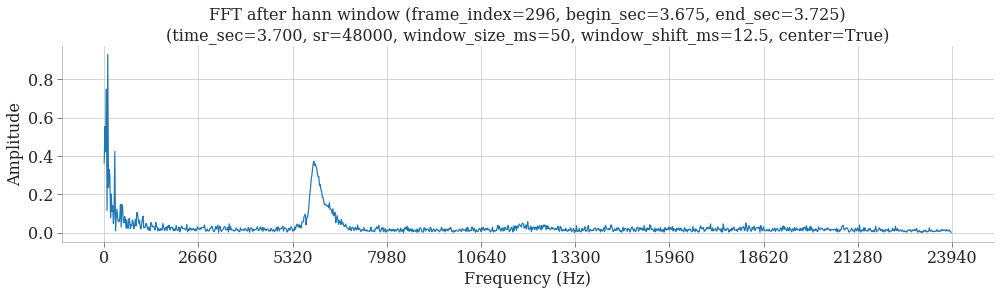

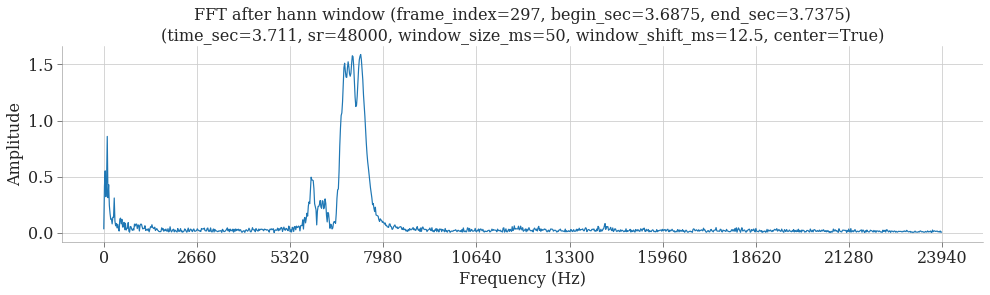

...

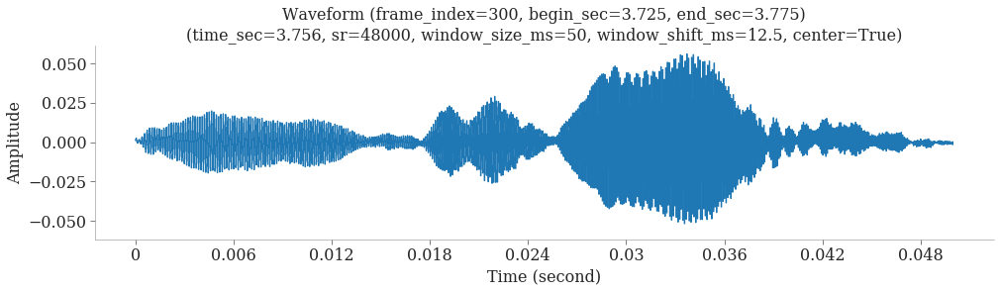

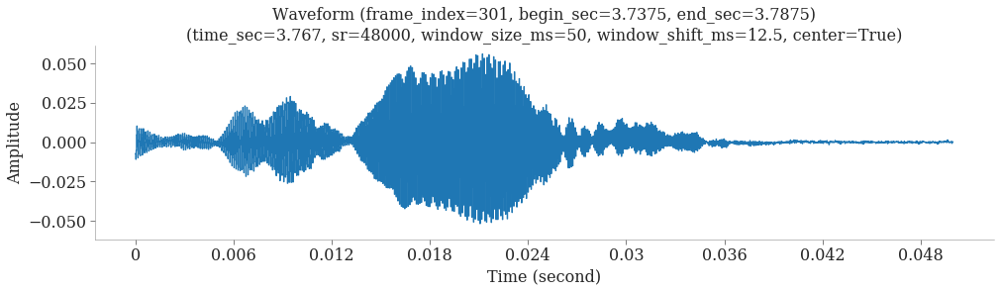

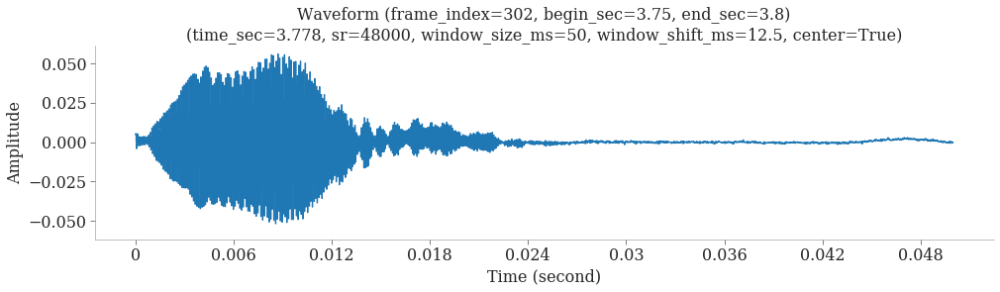

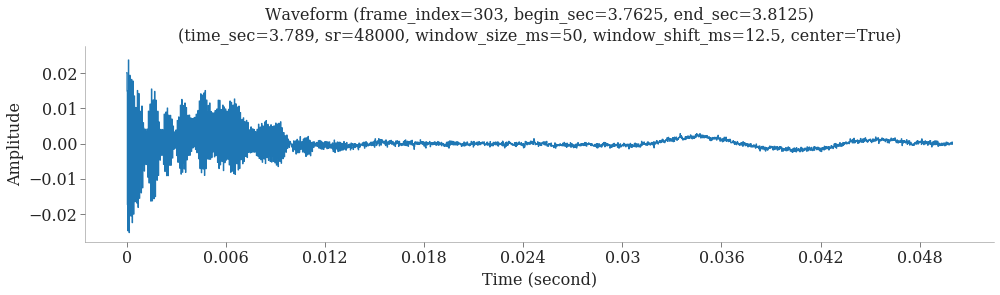

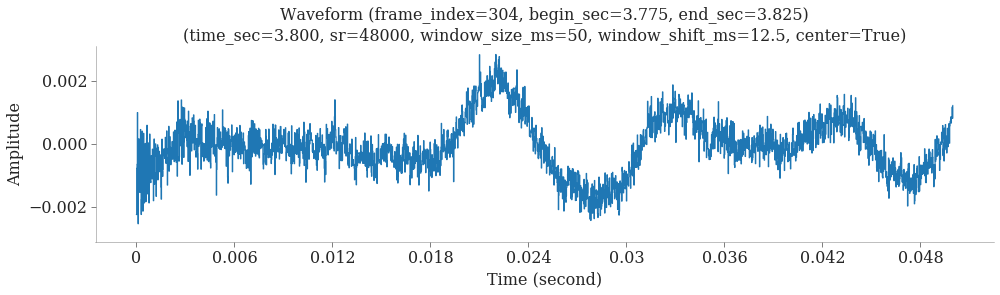

In [10]:
def show_window(path=path, time_sec=time, sr=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms,  draw_wav_fig=False, draw_filtered_wav_fig=False, draw_spec_fig=True, center=True, figsize=(14, 4.2), num_xticks_show=10):
    frame_index, begin_sec, end_sec = time2index(time_sec, window_size=window_size_ms/1000, window_shift=window_shift_ms/1000, center=center, verbose=True)
    wav = load_wav(path=path, sr=sampling_rate, begin_sec=begin_sec, end_sec=end_sec)
    info = f"({time_sec=:.3f}, {sr=}, {window_size_ms=}, {window_shift_ms=}, {center=})"
    
    if (draw_wav_fig):
        draw_wav(wav, sampling_rate=sampling_rate, title=f"Waveform ({frame_index=}, {begin_sec=}, {end_sec=})" + "\n" + info, figsize=figsize)

    if (draw_filtered_wav_fig):
        wav = hann_window * wav
        draw_wav(wav, sampling_rate=sampling_rate, title=f"Waveform after hann window ({frame_index=}, {begin_sec=}, {end_sec=})" + "\n" + info, figsize=figsize)
        coeff, freq = fourier_transform(wav, sr=sampling_rate, half=True)

    if (draw_spec_fig):
        amplitude, freq = fourier_transform(wav, sr = sampling_rate, amplitude=True, half=True)
        ax = draw_line_plot(amplitude, title=f"FFT after hann window ({frame_index=}, {begin_sec=}, {end_sec=})" + "\n" + info, xlabel="Frequency (Hz)", ylabel="Amplitude", figsize=figsize)
        freq_ax(ax, freq, num_xticks_show=num_xticks_show)

# n_fft = 512 # n_fft=512 recommend for speech (default 2048)

# path=
# sampling_rate=48000

# # librosa.stft setting (n_fft=512 recommended for speech feature extraction))
# n_fft=512
# window_size_num_samples = n_fft
# window_shift_num_samples = window_size_num_samples // 4 # default shift of librosa.stft.
# window_size_ms = round((window_size_num_samples / sampling_rate) * 1000, ndigits=3)
# window_shift_ms = round((window_shift_num_samples / sampling_rate) * 1000, ndigits=3)

# # Tacotron setting
# window_size_ms=50
# window_shift_ms=12.5
# n_fft=int(window_size_ms / 1000 * sampling_rate)

# # Kaldi setting
# window_size_ms=25
# window_shift_ms=10
# n_fft=int(window_size_ms / 1000 * sampling_rate)

# time=1
# show_window(path=path, time_sec=time, sr=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms)

begin_sec = 3.7
end_sec = 3.8
num_windows = 10
figsize=(14, 4.2)
num_xticks_show=10

# figsize=(6.9*2, 4.2*2)
# num_xticks_show=5

# for time in [5.98, 6.05, 4.63]:
# for time in np.linspace(2.98, 3.04, 10):
for time in [1, 3, 7]:
    show_window(path=path, time_sec=time, sr=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, figsize=figsize)


for time in np.linspace(begin_sec, end_sec, num_windows):
    show_window(path=path, time_sec=time, sr=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms,  draw_wav_fig=False, draw_filtered_wav_fig=False, draw_spec_fig=True, figsize=figsize, num_xticks_show=num_xticks_show)
    
#for time in np.linspace(begin_sec, end_sec, num_windows):
#    show_window(path=path, time_sec=time, sr=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms,  draw_wav_fig=False, draw_filtered_wav_fig=True, draw_spec_fig=False, figsize=figsize, num_xticks_show=num_xticks_show)

draw_wav(load_wav(path, sr=sampling_rate, begin_sec=begin_sec, end_sec=end_sec), sampling_rate, figsize=figsize)
for time in np.linspace(begin_sec, end_sec, num_windows):
    show_window(path=path, time_sec=time, sr=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms,  draw_wav_fig=True, draw_filtered_wav_fig=False, draw_spec_fig=False, figsize=figsize, num_xticks_show=num_xticks_show)

# Filter design

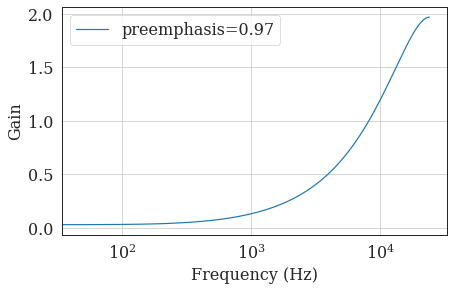

In [11]:
order = 1
cutoff_freq = 4000
filter_type = "highpass"

preemphasis=0.97
fig = plt.figure(figsize=(6.9, 4.2))
ax = fig.add_subplot(111)
freq, response_of_freq = scipy.signal.freqz([1, -preemphasis], [1], worN=512,  fs=sampling_rate) # w and h with shape: (worN,); h contains complex numbers
# ax.plot(freq, abs(response_of_freq))
ax.semilogx(freq, abs(response_of_freq), label=f"{preemphasis=}".format(cutoff_freq, order, sampling_rate))

# ax.plot([0, 0.5 * sampling_rate], [np.sqrt(0.5), np.sqrt(0.5)], '--', label='sqrt(0.5)')
ax.set_xlabel('Frequency (Hz)')
ax.set_ylabel('Gain')
# ax.set_title()
# plt.axvline(cutoff_freq, color='black') # cutoff frequency
plt.grid(True)
plt.legend(loc='best')

# ax.set_xticks(np.linspace(start=0, stop=6000, num=4, endpoint=False))

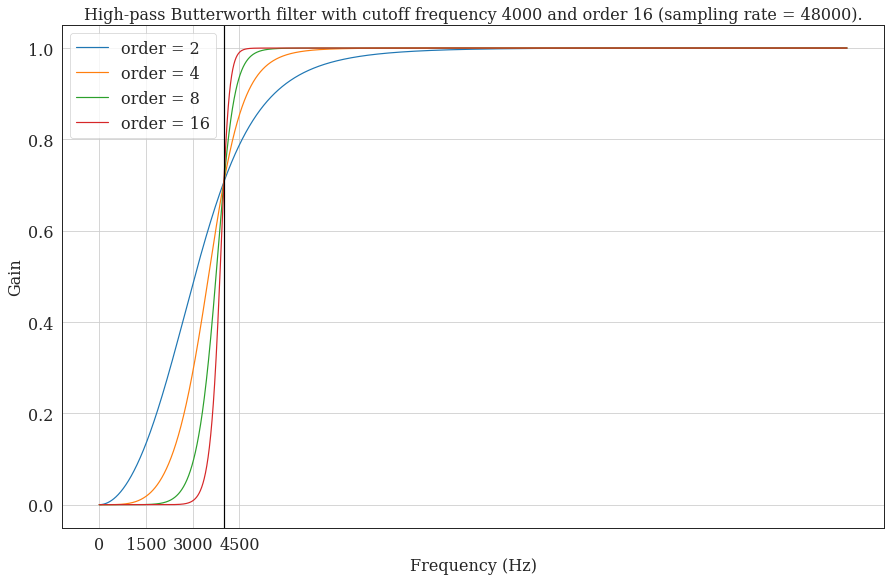

In [12]:
order = 1
cutoff_freq = 4000
filter_type = "highpass"

figsize=(6.7*2.2, 4.2*2.2)

fig = plt.figure(figsize=figsize)
ax = fig.add_subplot(111)
for order in [2, 4, 8, 16]:
    # sos format (second-order sections) instead of ba (transfer function) format to avoid numerical errors. 
    # (Reference: https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.butter.html)
    # (sos and ba formats: https://www.dsprelated.com/freebooks/filters/Series_Second_Order_Sections.html)
    second_order_sections = scipy.signal.butter(N=order, Wn=cutoff_freq, btype=filter_type, analog=False, fs=sampling_rate, output='sos')
    freq, response_of_freq = scipy.signal.sosfreqz(sos=second_order_sections, worN=4000,  fs=sampling_rate) # w and h with shape: (worN,); h contains complex numbers
    ax.plot(freq, abs(response_of_freq), label="order = %d" % order)

# ax.plot([0, 0.5 * sampling_rate], [np.sqrt(0.5), np.sqrt(0.5)], '--', label='sqrt(0.5)')
ax.set_xlabel('Frequency (Hz)')
ax.set_ylabel('Gain')
ax.set_title("High-pass Butterworth filter with cutoff frequency {} and order {} (sampling rate = {}).".format(cutoff_freq, order, sampling_rate))
plt.axvline(cutoff_freq, color='black') # cutoff frequency
plt.grid(True)
plt.legend(loc='best')

ax.set_xticks(np.linspace(start=0, stop=6000, num=4, endpoint=False))

shape of wav: (480000,)
shape of STFT: (1201, 801)
window size (win_length) for STFT: 2400
window shift (hop_length) for STFT: 600
center=True, padding on both sides with zeros (pad_mode='constant'); the signal y is padded so that frame D[:, t] is centered at y[t * hop_length].
number of samples: 480000; samples processing by STFT(window_size+window_shift(num_frames-1)): 2400+600*(801-1)=482400
shape of wav: (480000,)
shape of STFT: (1201, 801)
window size (win_length) for STFT: 2400
window shift (hop_length) for STFT: 600
center=True, padding on both sides with zeros (pad_mode='constant'); the signal y is padded so that frame D[:, t] is centered at y[t * hop_length].
number of samples: 480000; samples processing by STFT(window_size+window_shift(num_frames-1)): 2400+600*(801-1)=482400
shape of wav: (480000,)
shape of STFT: (1201, 801)
window size (win_length) for STFT: 2400
window shift (hop_length) for STFT: 600
center=True, padding on both sides with zeros (pad_mode='constant'); the 

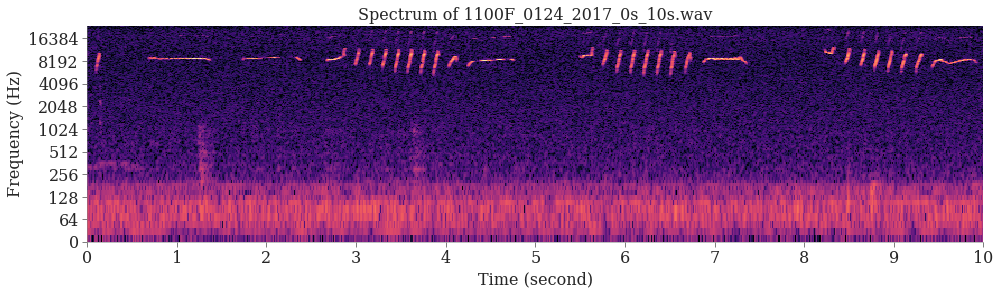

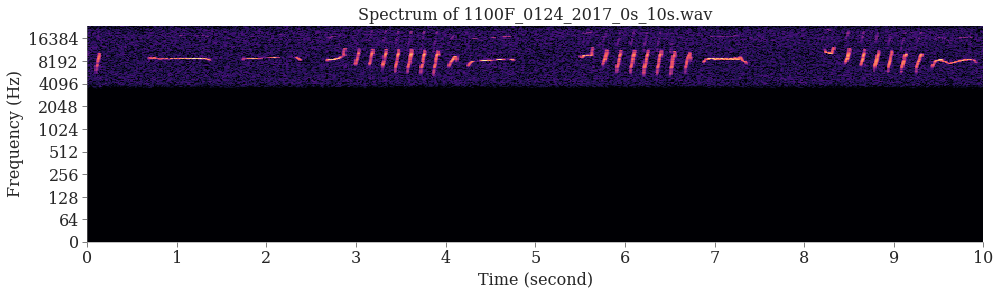

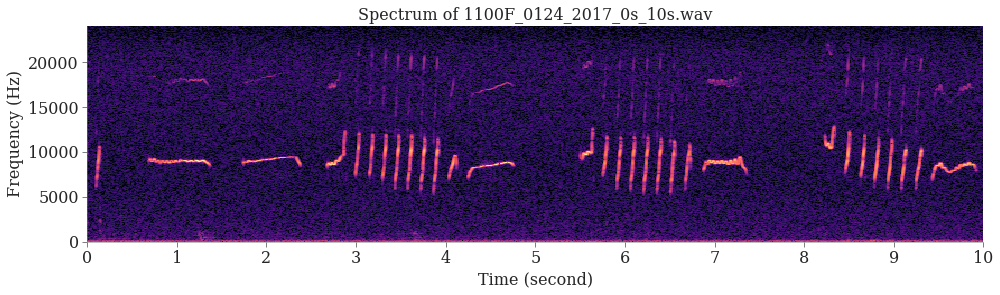

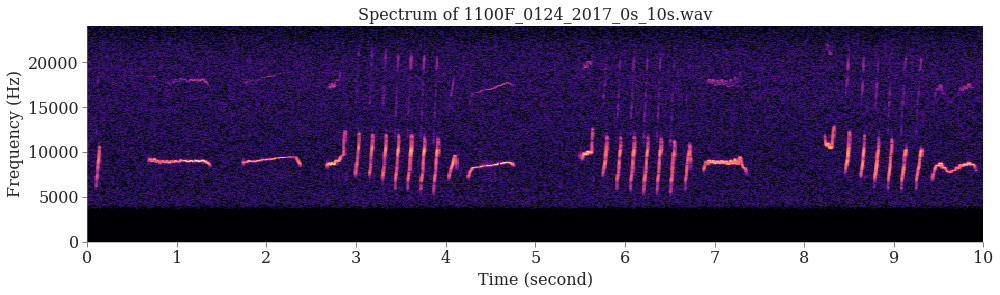

In [24]:
import os
def librosa_spectrum(path=None, n_fft=512, sampling_rate=48000, spectrum_type="linear", title=None, center=False, apply_filter=False, order=16, cutoff_freq=4000, filter_type="highpass", figsize=figsize):
    import numpy as np
    import matplotlib.pyplot as plt

    import librosa
    import librosa.display
    
    fft_window_size = n_fft # win_length: If unspecified for librosa.stft, defaults to ``win_length = n_fft``.
    fft_window_shift = fft_window_size // 4 # hop_length: If unspecified for librosa.stft, defaults to ``win_length // 4`` (see below).

   
    time_type="s"  # "time" or "ms"
    
    wav, sampling_rate = librosa.load(path, sr=sampling_rate)
    if apply_filter:
        # sos format (second-order sections) instead of ba (transfer function) format to avoid numerical errors. 
        # (Reference: https://docs.scipy.org/doc/scipy/reference/generated/scipy.signal.butter.html)
        # (sos and ba formats: https://www.dsprelated.com/freebooks/filters/Series_Second_Order_Sections.html)
        second_order_sections = scipy.signal.butter(N=order, Wn=cutoff_freq, btype=filter_type, analog=False, fs=sampling_rate, output='sos')
        wav = scipy.signal.sosfilt(second_order_sections, wav)

    # If center=True, the signal y is padded so that frame D[:, t] is centered at y[t * hop_length], padding on both sides with zeros (pad_mode="constant"). 
    # If center=False, then D[:, t] begins at y[t * hop_length], padding ignored
    fft_coeff = librosa.stft(wav, n_fft=n_fft, window='hann', center=center) # center=False padding ignored
    spectrum_db = librosa.amplitude_to_db(np.abs(fft_coeff), ref=np.max)
    
    print("shape of wav: {}".format(wav.shape))
    print("shape of STFT: {}".format(fft_coeff.shape))
    print("window size (win_length) for STFT: {}".format(fft_window_size)) 
    print("window shift (hop_length) for STFT: {}".format(fft_window_shift))
    if (center):
        print("center=True, padding on both sides with zeros (pad_mode='constant'); the signal y is padded so that frame D[:, t] is centered at y[t * hop_length].")
    else:
        print("center=False, padding ignored; the D[:, t] begins at signal y[t * hop_length].")
    print("number of samples: {}; samples processing by STFT(window_size+window_shift(num_frames-1)): {}+{}*({}-1)={}".format(len(wav), fft_window_size, fft_window_shift, fft_coeff.shape[1], fft_window_size+fft_window_shift*(fft_coeff.shape[1]-1)))

    fig = plt.figure(figsize=figsize)
    ax = fig.add_subplot(111)

    img = librosa.display.specshow(spectrum_db, sr=sampling_rate, hop_length=fft_window_shift, y_axis=spectrum_type, x_axis=time_type, ax=ax, cmap='magma')
    # img = librosa.display.specshow(spectrum_db, y_axis="linear", ax=ax, cmap='viridis')

    ax.set_xlabel("Time (second)")
    ax.set_ylabel("Frequency (Hz)")
    if title: ax.set_title(title)

    plt.tight_layout()
    format_axes(ax)
    # plt.savefig(cur_dir + "/fig/"+measure+"_corp.pdf")

figsize=(14, 4.2)
title = "Spectrum of {}".format(os.path.basename(path))
# n_fft = 512 # n_fft=512 recommend for speech (default 2048)
librosa_spectrum(path=path, n_fft=n_fft, sampling_rate=sampling_rate, spectrum_type="log", title=title, center=True)
# librosa_spectrum(path=path, title=title, spectrum_type=spectrum_type)
librosa_spectrum(path=path, n_fft=n_fft, sampling_rate=sampling_rate, spectrum_type="log", title=title, center=True, apply_filter=True)
librosa_spectrum(path=path, n_fft=n_fft, sampling_rate=sampling_rate, spectrum_type="linear", title=title, center=True)
# librosa_spectrum(path=path, title=title, spectrum_type=spectrum_type)
librosa_spectrum(path=path, n_fft=n_fft, sampling_rate=sampling_rate, spectrum_type="linear", title=title, center=True, apply_filter=True)

STFT on noise: 0:00:00.001326
STFT on signal: 0:00:00.020168
[  9.44965     5.194161    5.7523007 ... -39.239853  -39.23992
 -39.240067 ] -45.70802
Masking: 0:00:00.004186
Mask convolution: 0:00:00.031992
Mask application: 0:00:00.069540
Signal recovery: 0:00:00.053401


<ipython-input-158-37ea595c36ba>:102: FutureWarning: Pass hop_length=512, win_length=2048 as keyword args. From version 0.10 passing these as positional arguments will result in an error
  return librosa.istft(y, hop_length, win_length)


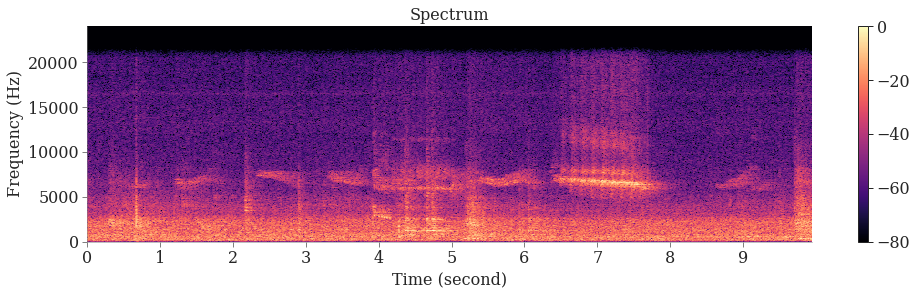

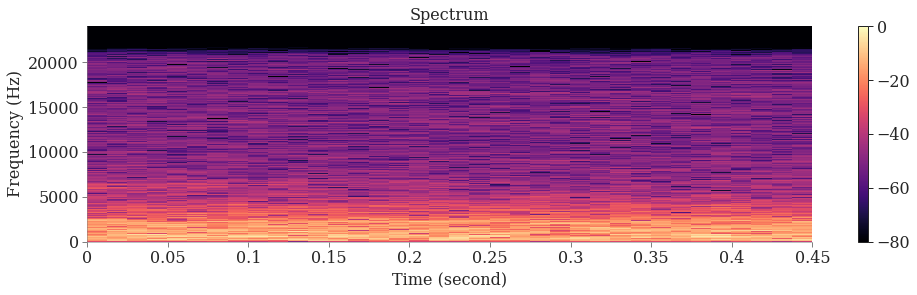

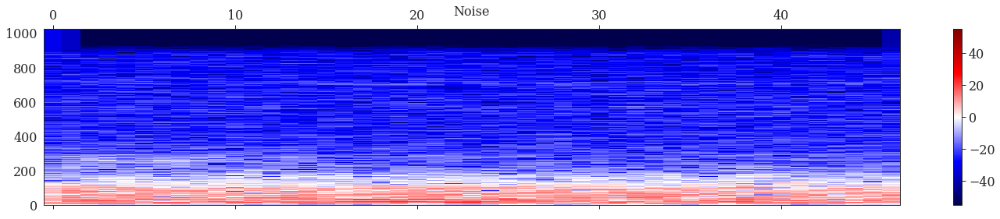

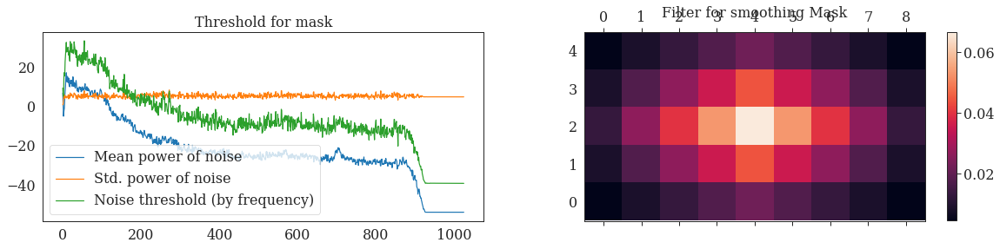

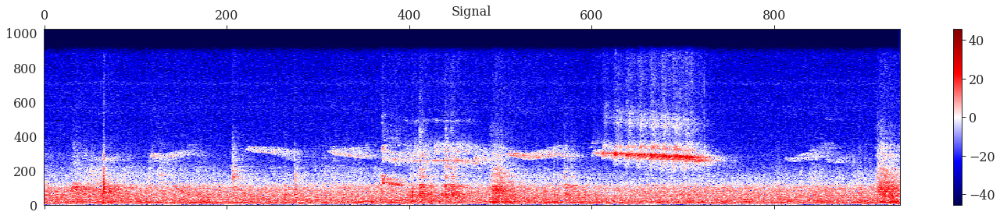

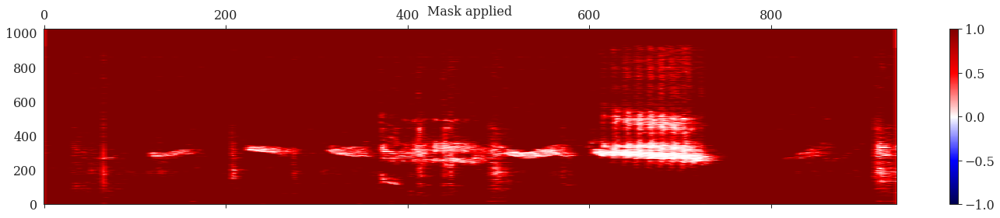

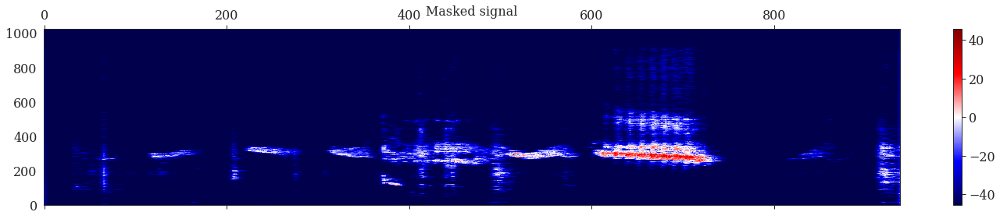

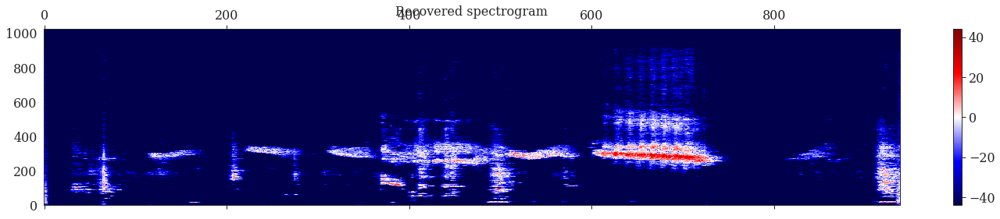

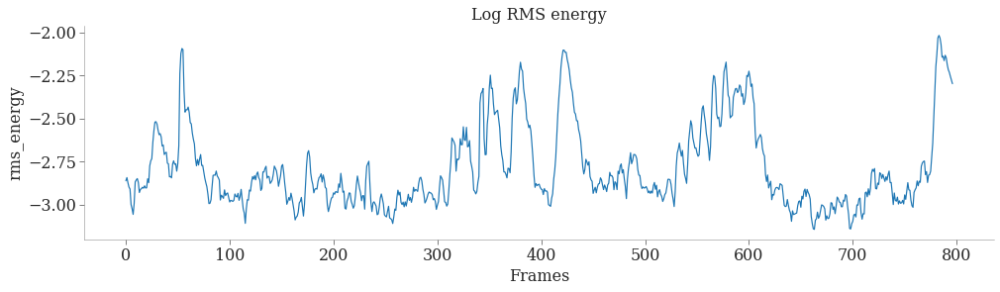

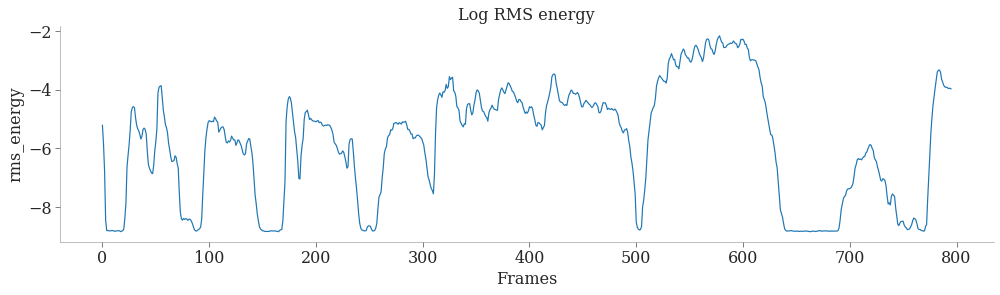

In [158]:
def load_wav(path, sr, begin_sec=None, end_sec=None):
    """
    Load a wav file or its segment.

    Parameters
    ----------
    path: the path of the audio
    sr: sampling rate of the audio
    begin_sec: the beginning time (in second) of the segment of the audio
    end_sec: the end time (in second) of the segment of the audio

    Returns
    -------
    the data of wav file or the data of its segment
    """
    wav, _ = librosa.load(path, sr=sr)
    if begin_sec is None and end_sec is None: return wav
    else:
        if begin_sec is None: begin_index = 0
        if end_sec is None: end_index = len(wav)
        assert begin_sec < end_sec, "the begin time of the segment should be less than the end time."
        begin_index = max(int(begin_sec * sr), 0)
        end_index = min(int(end_sec * sr), len(wav))
    
    return wav[begin_index:end_index]

def librosa_wav2spectrum(wav=None, n_fft=512, sampling_rate=48000, window_size_ms=None, window_shift_ms=None, spectrum_type="linear", title=None, center=False, colorbar=True, figsize=(14, 4.2)):
    if (window_size_ms and window_shift_ms):
        fft_window_size = int(window_size_ms / 1000 * sampling_rate)
        fft_window_shift = int(window_shift_ms / 1000 * sampling_rate)
    else:
        fft_window_size = n_fft # win_length: If unspecified for librosa.stft, defaults to ``win_length = n_fft``.
        fft_window_shift = fft_window_size // 4 # hop_length: If unspecified for librosa.stft, defaults to ``win_length // 4`` (see below).
        window_size_ms = (fft_window_size / sampling_rate) * 1000
        window_shift_ms = (fft_window_shift / sampling_rate) * 1000

    time_type="s"  # "time" or "ms"
    
    fft_coeff = librosa.stft(wav, n_fft=n_fft, hop_length=fft_window_shift, win_length=fft_window_size, window='hann', center=center) # center=False padding ignored
    spectrum_db = librosa.amplitude_to_db(np.abs(fft_coeff), ref=np.max)

    fig = plt.figure(figsize=figsize)
    ax = fig.add_subplot(111)
    image = librosa.display.specshow(spectrum_db, sr=sampling_rate, n_fft=n_fft, hop_length=fft_window_shift, win_length=fft_window_size, y_axis=spectrum_type, x_axis=time_type, ax=ax, cmap='magma')
    
    ax.set_xlabel("Time (second)")
    ax.set_ylabel("Frequency (Hz)")
    if title: ax.set_title(title)
    if (colorbar): plt.colorbar(image, ax=ax)

    plt.tight_layout()
    format_axes(ax)
    return ax

# path=
# sampling_rate=48000

# # librosa.stft setting (n_fft=512 recommended for speech feature extraction))
# n_fft=512
# window_size_num_samples = n_fft
# window_shift_num_samples = window_size_num_samples // 4 # default shift of librosa.stft.
# window_size_ms = round((window_size_num_samples / sampling_rate) * 1000, ndigits=3)
# window_shift_ms = round((window_shift_num_samples / sampling_rate) * 1000, ndigits=3)

# # Tacotron setting
# window_size_ms=50
# window_shift_ms=12.5
# n_fft=int(window_size_ms / 1000 * sampling_rate)

# # Kaldi setting
# window_size_ms=25
# window_shift_ms=10
# n_fft=int(window_size_ms / 1000 * sampling_rate)

npath = "/project/nakamura-lab08/Work/bin-wu/workspace/datasets/riken/samples/pair10_animal1_together_hear_1h10min_1065s_1075s.wav"

mel=13
# window_size_ms=50
# window_shift_ms=12.5
spectrum_type="linear"
center=False
# n_fft=int(window_size_ms / 1000 * sampling_rate)
figsize=(14, 4.2)


wav = load_wav(path=npath, sr=sampling_rate)
librosa_wav2spectrum(wav=wav, n_fft=n_fft, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, spectrum_type=spectrum_type, title="Spectrum", center=center, colorbar=True, figsize=figsize)

nwav = load_wav(path=npath, sr=sampling_rate, begin_sec=8, end_sec=8.5)
librosa_wav2spectrum(wav=nwav, n_fft=n_fft, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, spectrum_type=spectrum_type, title="Spectrum", center=center, colorbar=True, figsize=figsize)

# https://timsainburg.com/noise-reduction-python.html
import time
from datetime import timedelta as td


def _stft(y, n_fft, hop_length, win_length):
    return librosa.stft(y=y, n_fft=n_fft, hop_length=hop_length, win_length=win_length)


def _istft(y, hop_length, win_length):
    return librosa.istft(y, hop_length, win_length)


def _amp_to_db(x):
    return librosa.core.amplitude_to_db(x, ref=1.0, amin=1e-20, top_db=80.0)


def _db_to_amp(x,):
    return librosa.core.db_to_amplitude(x, ref=1.0)


def plot_spectrogram(signal, title):
    fig, ax = plt.subplots(figsize=(20, 4))
    cax = ax.matshow(
        signal,
        origin="lower",
        aspect="auto",
        cmap=plt.cm.seismic,
        vmin=-1 * np.max(np.abs(signal)),
        vmax=np.max(np.abs(signal)),
    )
    fig.colorbar(cax)
    ax.set_title(title)
    plt.tight_layout()
    plt.show()


def plot_statistics_and_filter(
    mean_freq_noise, std_freq_noise, noise_thresh, smoothing_filter
):
    fig, ax = plt.subplots(ncols=2, figsize=(20, 4))
    plt_mean, = ax[0].plot(mean_freq_noise, label="Mean power of noise")
    plt_std, = ax[0].plot(std_freq_noise, label="Std. power of noise")
    plt_std, = ax[0].plot(noise_thresh, label="Noise threshold (by frequency)")
    ax[0].set_title("Threshold for mask")
    ax[0].legend()
    cax = ax[1].matshow(smoothing_filter, origin="lower")
    fig.colorbar(cax)
    ax[1].set_title("Filter for smoothing Mask")
    plt.show()


def removeNoise(
    audio_clip,
    noise_clip,
    n_grad_freq=2,
    n_grad_time=4,
    n_fft=2048,
    win_length=2048,
    hop_length=512,
    n_std_thresh=1.5,
    prop_decrease=1.0,
    verbose=False,
    visual=False,
):
    """Remove noise from audio based upon a clip containing only noise

    Args:
        audio_clip (array): The first parameter.
        noise_clip (array): The second parameter.
        n_grad_freq (int): how many frequency channels to smooth over with the mask.
        n_grad_time (int): how many time channels to smooth over with the mask.
        n_fft (int): number audio of frames between STFT columns.
        win_length (int): Each frame of audio is windowed by `window()`. The window will be of length `win_length` and then padded with zeros to match `n_fft`..
        hop_length (int):number audio of frames between STFT columns.
        n_std_thresh (int): how many standard deviations louder than the mean dB of the noise (at each frequency level) to be considered signal
        prop_decrease (float): To what extent should you decrease noise (1 = all, 0 = none)
        visual (bool): Whether to plot the steps of the algorithm

    Returns:
        array: The recovered signal with noise subtracted

    """
    if verbose:
        start = time.time()
    # STFT over noise
    noise_stft = _stft(noise_clip, n_fft, hop_length, win_length)
    noise_stft_db = _amp_to_db(np.abs(noise_stft))  # convert to dB
    # Calculate statistics over noise
    mean_freq_noise = np.mean(noise_stft_db, axis=1)
    std_freq_noise = np.std(noise_stft_db, axis=1)
    noise_thresh = mean_freq_noise + std_freq_noise * n_std_thresh
    if verbose:
        print("STFT on noise:", td(seconds=time.time() - start))
        start = time.time()
    # STFT over signal
    if verbose:
        start = time.time()
    sig_stft = _stft(audio_clip, n_fft, hop_length, win_length)
    sig_stft_db = _amp_to_db(np.abs(sig_stft))
    if verbose:
        print("STFT on signal:", td(seconds=time.time() - start))
        start = time.time()
    # Calculate value to mask dB to
    mask_gain_dB = np.min(_amp_to_db(np.abs(sig_stft)))
    print(noise_thresh, mask_gain_dB)
    # Create a smoothing filter for the mask in time and frequency
    smoothing_filter = np.outer(
        np.concatenate(
            [
                np.linspace(0, 1, n_grad_freq + 1, endpoint=False),
                np.linspace(1, 0, n_grad_freq + 2),
            ]
        )[1:-1],
        np.concatenate(
            [
                np.linspace(0, 1, n_grad_time + 1, endpoint=False),
                np.linspace(1, 0, n_grad_time + 2),
            ]
        )[1:-1],
    )
    smoothing_filter = smoothing_filter / np.sum(smoothing_filter)
    # calculate the threshold for each frequency/time bin
    db_thresh = np.repeat(
        np.reshape(noise_thresh, [1, len(mean_freq_noise)]),
        np.shape(sig_stft_db)[1],
        axis=0,
    ).T
    # mask if the signal is above the threshold
    sig_mask = sig_stft_db < db_thresh
    if verbose:
        print("Masking:", td(seconds=time.time() - start))
        start = time.time()
    # convolve the mask with a smoothing filter
    sig_mask = scipy.signal.fftconvolve(sig_mask, smoothing_filter, mode="same")
    sig_mask = sig_mask * prop_decrease
    if verbose:
        print("Mask convolution:", td(seconds=time.time() - start))
        start = time.time()
    # mask the signal
    sig_stft_db_masked = (
        sig_stft_db * (1 - sig_mask)
        + np.ones(np.shape(mask_gain_dB)) * mask_gain_dB * sig_mask
    )  # mask real
    sig_imag_masked = np.imag(sig_stft) * (1 - sig_mask)
    sig_stft_amp = (_db_to_amp(sig_stft_db_masked) * np.sign(sig_stft)) + (
        1j * sig_imag_masked
    )
    if verbose:
        print("Mask application:", td(seconds=time.time() - start))
        start = time.time()
    # recover the signal
    recovered_signal = _istft(sig_stft_amp, hop_length, win_length)
    recovered_spec = _amp_to_db(
        np.abs(_stft(recovered_signal, n_fft, hop_length, win_length))
    )
    if verbose:
        print("Signal recovery:", td(seconds=time.time() - start))
    if visual:
        plot_spectrogram(noise_stft_db, title="Noise")
    if visual:
        plot_statistics_and_filter(
            mean_freq_noise, std_freq_noise, noise_thresh, smoothing_filter
        )
    if visual:
        plot_spectrogram(sig_stft_db, title="Signal")
    if visual:
        plot_spectrogram(sig_mask, title="Mask applied")
    if visual:
        plot_spectrogram(sig_stft_db_masked, title="Masked signal")
    if visual:
        plot_spectrogram(recovered_spec, title="Recovered spectrogram")
    return recovered_signal

import IPython
# output = removeNoise(audio_clip=wav, noise_clip=nwav, n_grad_freq=2, n_grad_time=4, n_std_thresh=1.5, verbose=True,visual=True)
output = removeNoise(audio_clip=wav, noise_clip=nwav, n_grad_freq=2, n_grad_time=4, n_std_thresh=3, verbose=True,visual=True)

IPython.display.Audio(data=output, rate=sampling_rate)

rms_energy = librosa.feature.rms(y=wav, hop_length=fft_window_shift, frame_length=fft_window_size, center=center)
draw_line_plot(np.log(rms_energy[0]), xlabel="Frames", ylabel="rms_energy", title="Log RMS energy")

rms_energy = librosa.feature.rms(y=output, hop_length=fft_window_shift, frame_length=fft_window_size, center=center)
draw_line_plot(np.log(rms_energy[0]), xlabel="Frames", ylabel="rms_energy", title="Log RMS energy")

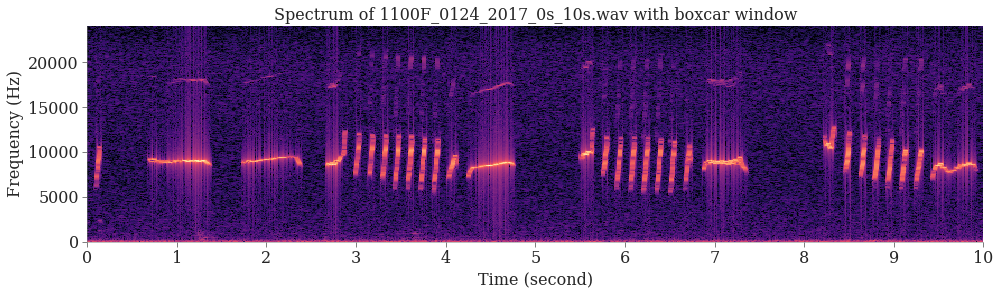

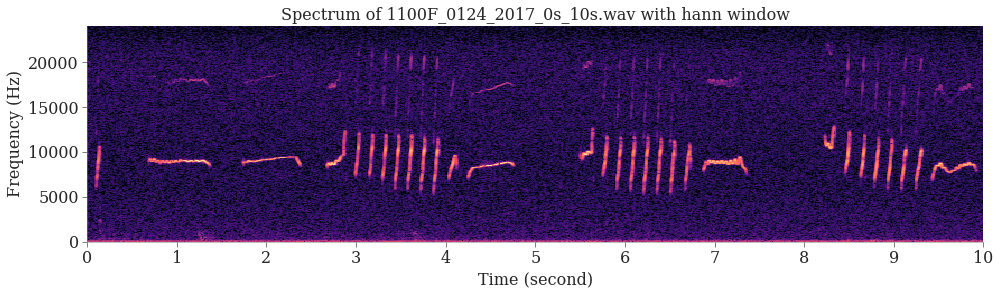

In [14]:
# # librosa.stft setting (n_fft=512 recommended for speech feature extraction))
# n_fft=512
# window_size_num_samples = n_fft
# window_shift_num_samples = window_size_num_samples // 4 # default shift of librosa.stft.
# window_size_ms = round((window_size_num_samples / sampling_rate) * 1000, ndigits=3)
# window_shift_ms = round((window_shift_num_samples / sampling_rate) * 1000, ndigits=3)

# # Tacotron setting
# window_size_ms=50
# window_shift_ms=12.5
# n_fft=int(window_size_ms / 1000 * sampling_rate)

# # # Kaldi setting
# # window_size_ms=25
# # window_shift_ms=10
# # n_fft=int(window_size_ms / 1000 * sampling_rate)

spectrum_type="linear"

import numpy as np
import matplotlib.pyplot as plt

import librosa
import librosa.display

if (window_size_ms and window_shift_ms):
    fft_window_size = int(window_size_ms / 1000 * sampling_rate)
    fft_window_shift = int(window_shift_ms / 1000 * sampling_rate)
else:
    fft_window_size = n_fft # win_length: If unspecified for librosa.stft, defaults to ``win_length = n_fft``.
    fft_window_shift = fft_window_size // 4 # hop_length: If unspecified for librosa.stft, defaults to ``win_length // 4`` (see below).
    window_size_ms = (fft_window_size / sampling_rate) * 1000
    window_shift_ms = (fft_window_shift / sampling_rate) * 1000

center=True
time_type="s"  # "time" or "ms"
figsize=(6.9, 4.2)
figsize=(14, 4.2)
figsize=figsize

window_type="boxcar" # "hann"
fig = plt.figure(figsize=figsize)
ax = fig.add_subplot(111)
wav, sampling_rate = librosa.load(path, sr=sampling_rate)
fft_coeff = librosa.stft(wav, n_fft=n_fft, window=window_type, center=center) # center=False padding ignored
spectrum_db = librosa.amplitude_to_db(np.abs(fft_coeff), ref=np.max)
img = librosa.display.specshow(spectrum_db, sr=sampling_rate, n_fft=n_fft, hop_length=fft_window_shift, win_length=fft_window_size, y_axis=spectrum_type, x_axis=time_type, ax=ax, cmap='magma')
ax.set_xlabel("Time (second)")
ax.set_ylabel("Frequency (Hz)")
if title: ax.set_title(title + " with " + window_type + " window")
plt.tight_layout()
format_axes(ax)

window_type="hann"
fig = plt.figure(figsize=figsize)
ax = fig.add_subplot(111)
wav, sampling_rate = librosa.load(path, sr=sampling_rate)
fft_coeff = librosa.stft(wav, n_fft=n_fft, window=window_type, center=center) # center=False padding ignored
spectrum_db = librosa.amplitude_to_db(np.abs(fft_coeff), ref=np.max)
img = librosa.display.specshow(spectrum_db, sr=sampling_rate, n_fft=n_fft, hop_length=fft_window_shift, win_length=fft_window_size, y_axis=spectrum_type, x_axis=time_type, ax=ax, cmap='magma')
ax.set_xlabel("Time (second)")
ax.set_ylabel("Frequency (Hz)")
if title: ax.set_title(title + " with " + window_type + " window")
plt.tight_layout()
format_axes(ax)


rms_energy.shape=(1, 797)
python_speech_feature_mfcc.shape=(797, 26)
mfcc40_feats[utt_key].shape=(998, 40)
(1201, 797)
2400
(1, 797)
log_frame_energy[0:10]=array([-6.4982147, -7.048642 , -6.9625044, -6.8560987, -6.782546 ,
       -4.571255 , -2.9945424, -2.4777822, -2.4154496, -2.5239232],
      dtype=float32)
np.log(rms_energy[0][0:10])=array([-7.94719211, -8.04821448, -8.07782892, -8.07121679, -7.90945365,
       -5.89139669, -5.06322028, -4.7936728 , -4.76129066, -4.81533814])


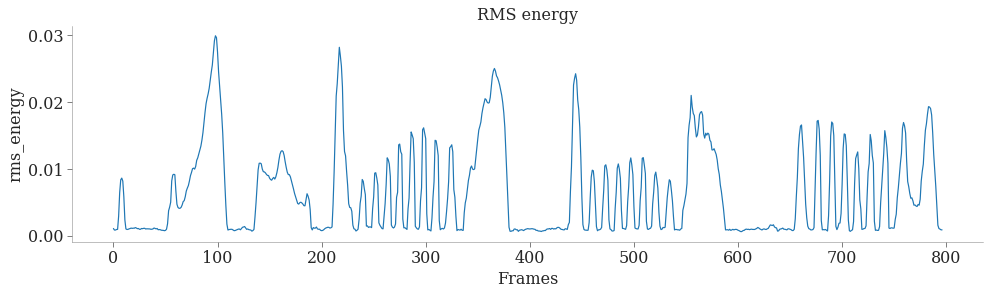

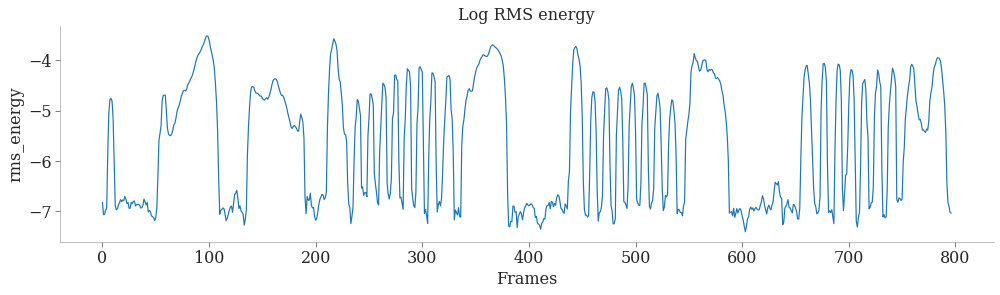

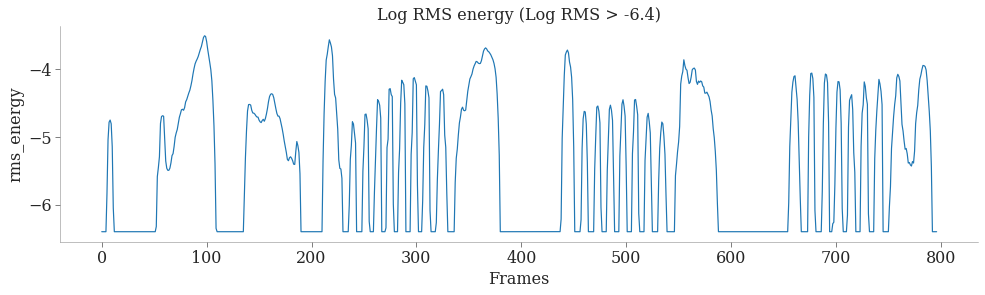

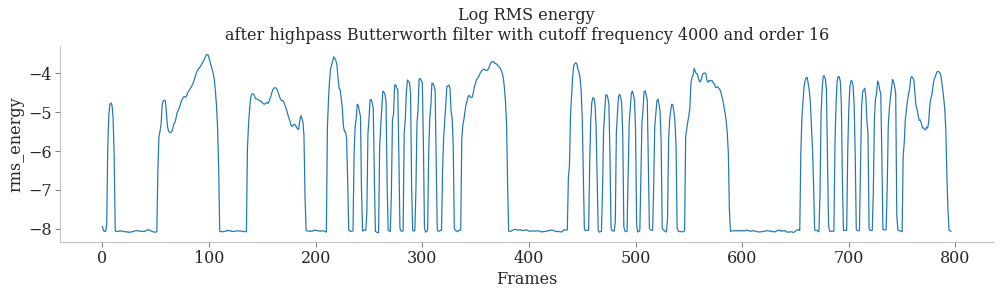

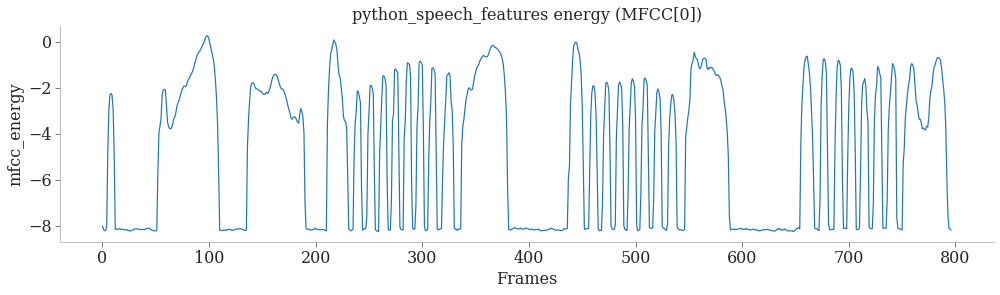

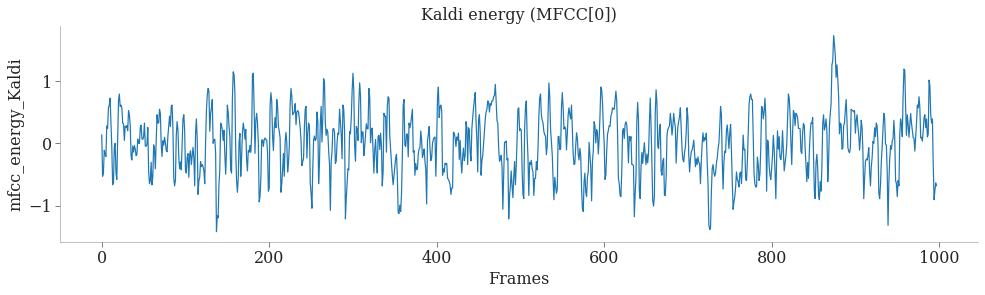

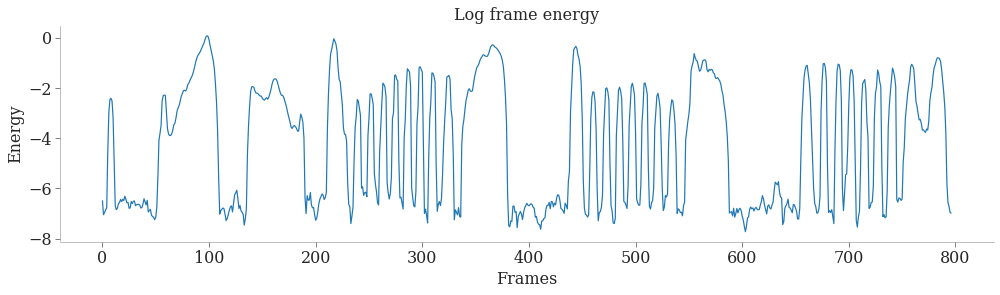

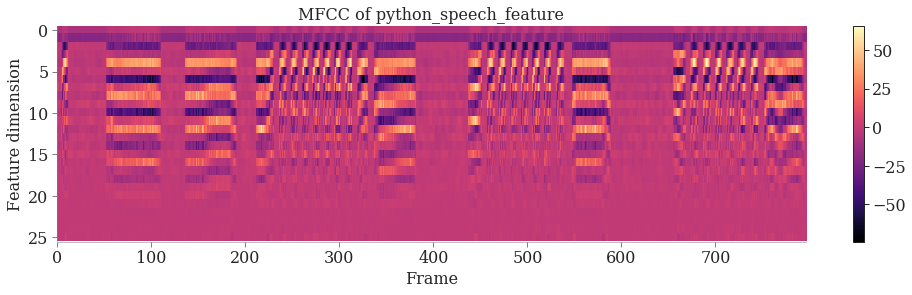

In [130]:
# # librosa.stft setting (n_fft=512 recommended for speech feature extraction))
# n_fft=512
# window_size_num_samples = n_fft
# window_shift_num_samples = window_size_num_samples // 4 # default shift of librosa.stft.
# window_size_ms = round((window_size_num_samples / sampling_rate) * 1000, ndigits=3)
# window_shift_ms = round((window_shift_num_samples / sampling_rate) * 1000, ndigits=3)

# # Tacotron setting
# window_size_ms=50
# window_shift_ms=12.5
# n_fft=int(window_size_ms / 1000 * sampling_rate)

# # Kaldi setting
# window_size_ms=25
# window_shift_ms=10
# n_fft=int(window_size_ms / 1000 * sampling_rate)

pitch_min=75
pitch_max=4000
threshold=0.1
ref=None # np.mean

numcep = 80 # 40  # the number of cepstrum to return, default 13
nfilt = 26 # the number of filters in the filterbank, default 26.
ceplifter=22 # apply a lifter to final cepstral coefficients. 0 is no lifter. Default is 22.

window="hann"
center= False # False will cause distortion at the first frame; False will match python speech feature
time_type="s"  # "time" or "ms"
figsize=(6.9, 4.2)
figsize=(14, 4.2)
figsize=figsize

if (window_size_ms and window_shift_ms):
    fft_window_size = int(window_size_ms / 1000 * sampling_rate)
    fft_window_shift = int(window_shift_ms / 1000 * sampling_rate)
else:
    fft_window_size = n_fft # win_length: If unspecified for librosa.stft, defaults to ``win_length = n_fft``.
    fft_window_shift = fft_window_size // 4 # hop_length: If unspecified for librosa.stft, defaults to ``win_length // 4`` (see below).
    window_size_ms = (fft_window_size / sampling_rate) * 1000
    window_shift_ms = (fft_window_shift / sampling_rate) * 1000

wav, sampling_rate = librosa.load(path, sr=sampling_rate)
rms_energy = librosa.feature.rms(y=wav,hop_length=fft_window_shift, frame_length=fft_window_size, center=center)
print(f"{rms_energy.shape=}")

draw_line_plot(rms_energy[0], xlabel="Frames", ylabel="rms_energy", title="RMS energy")
draw_line_plot(np.log(rms_energy[0]) , xlabel="Frames", ylabel="rms_energy", title="Log RMS energy")

log_rms_threshold = -6.4
log_rms_energy = np.where(np.log(rms_energy[0]) < log_rms_threshold, log_rms_threshold, np.log(rms_energy[0])) # if energy is zero, we get problems with log
draw_line_plot(log_rms_energy, xlabel="Frames", ylabel="rms_energy", title="Log RMS energy (Log RMS > {})".format(log_rms_threshold))

filter_type="highpass"
cutoff_freq=4000
order=16
wav, sampling_rate = librosa.load(path, sr=sampling_rate)
second_order_sections = scipy.signal.butter(N=order, Wn=cutoff_freq, btype=filter_type, analog=False, fs=sampling_rate, output='sos')
filtered_wav = scipy.signal.sosfilt(second_order_sections, wav)
rms_energy = librosa.feature.rms(y=filtered_wav, hop_length=fft_window_shift, frame_length=fft_window_size, center=center)
draw_line_plot(np.log(rms_energy[0]) , xlabel="Frames", ylabel="rms_energy", title="Log RMS energy\nafter {} Butterworth filter with cutoff frequency {} and order {}".format(filter_type, cutoff_freq, order))

wav, sampling_rate = librosa.load(path, sr=sampling_rate)
# second_order_sections = scipy.signal.butter(N=16, Wn=4000, btype="highpass", analog=False, fs=sampling_rate, output='sos')
# wav = scipy.signal.sosfilt(second_order_sections, wav)
python_speech_feature_mfcc = python_speech_features.mfcc(wav, samplerate=sampling_rate, lowfreq=3000, winlen=window_size_ms/1000, winstep=window_shift_ms/1000, nfft=n_fft, numcep=numcep, nfilt=nfilt, ceplifter=ceplifter, appendEnergy=True)
print(f"{python_speech_feature_mfcc.shape=}")
ax = draw_line_plot(python_speech_feature_mfcc[:,0], xlabel="Frames", ylabel="mfcc_energy", title="python_speech_features energy (MFCC[0])")

print(f"{mfcc40_feats[utt_key].shape=}")
ax = draw_line_plot(mfcc40_feats[utt_key][:,0], xlabel="Frames", ylabel="mfcc_energy_Kaldi", title="Kaldi energy (MFCC[0])")

wav, sampling_rate = librosa.load(path, sr=sampling_rate)
fft_coeff = librosa.stft(wav, n_fft=n_fft, hop_length=fft_window_shift, win_length=fft_window_size, window='boxcar', center=center) # center=False padding ignored
amplitude = np.abs(fft_coeff)
power_spec= 1.0 / n_fft * np.square(amplitude) # by python_speech_feature
frame_energy = np.sum(power_spec, axis=0) # the total energy in each frame
frame_energy = np.where(frame_energy == 0, np.finfo(float).eps, frame_energy) # if energy is zero, we get problems with log
log_frame_energy = np.log(frame_energy)
ax = draw_line_plot(log_frame_energy , xlabel="Frames", ylabel="Energy", title="Log frame energy")

print(power_spec.shape)
print(n_fft)
print(rms_energy.shape)
print(f"{log_frame_energy[0:10]=}")
print(f"{np.log(rms_energy[0][0:10])=}")

draw_matrix(python_speech_feature_mfcc.T, title="MFCC of python_speech_feature", xlabel="Frame", ylabel="Feature dimension", colorbar=True, origin="upper", figsize=figsize)

# draw_line_plot(rms_energy[0], xlabel="Frames", ylabel="rms_energy", title="RMS energy")
# draw_line_plot(np.log(rms_energy[0]) , xlabel="Frames", ylabel="rms_energy", title="Log RMS energy")
# threshold = 0.003
# energy = np.where(rms_energy[0] < threshold, np.finfo(float).eps,rms_energy[0]) # if energy is zero, we get problems with log
# draw_line_plot(np.log(energy) , xlabel="Frames", ylabel="rms_energy", title="Log RMS energy (RMS > {})".format(threshold))


# https://groups.google.com/g/librosa/c/W50-0qf--Dk
# energy = librosa.feature.melspectrogram(y=wav,  n_fft=n_fft, hop_length=fft_window_shift, win_length=fft_window_size, window='hann', center=center, power=2.0)
# energy_db = librosa.core.amplitude_to_db (energy)
# print(f"{energy_db.shape=}")
# ax = draw_line_plot(energy_db, xlabel="Frames", ylabel="mfcc_energy", title="python_speech_features energy (MFCC[0])", data_range_min=-4, data_range_max=0)

# ax.set_ylim(-5, 0.5)
# fig = plt.figure(figsize=figsize)
# plt.subplot(212)
# plt.imshow(rms_energy[:, :], aspect="auto", interpolation="nearest", origin="bottom")
# plt.title('rms')
# print(pitch)
# print(amplitude)
# image = draw_matrix(pitch)
# image = draw_matrix(amplitude)
# ax.set_xlabel("Time (second)")
# ax.set_ylabel("Frequency (Hz)")
# if title: ax.set_title(title + " with " + window_type + " window")
# plt.tight_layout()
# format_axes(ax)


window_size_ms=50, window_shift_ms=12.5, sampling_rate=48000, n_fft=2400, energy_filter={'filter': 'butter', 'filter_type': 'highpass', 'cutoff_freq': 4000, 'order': 16}
window_size_num_samples(win_length)=2400, window_shift_num_samples(hop_length)=600

shape of wav: (480000,)
shape of STFT: (1201, 797) (n_fft = (num_freq - 1) * 2) = (1201 - 1) * 2) = 2400)
window size (win_length) for STFT: 2400
window shift (hop_length) for STFT: 600
center=False, padding ignored; the first frame begins at the origin (the D[:, t] begins at signal y[t * hop_length]).
number of samples: 480000; samples processed by STFT, including padding, is
window_size + window_shift * (num_frames - 1) = 2400 + 600 * (797 - 1) = 480000

Final feature to return has a shape of (797, ).


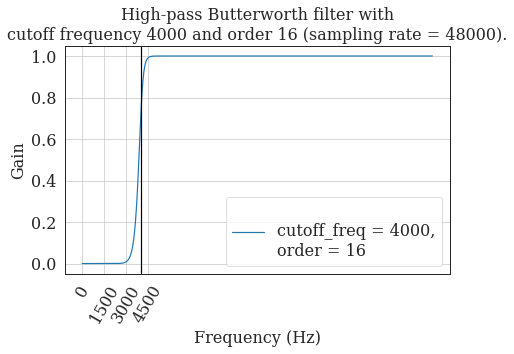

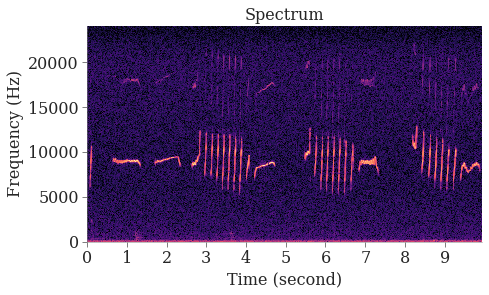

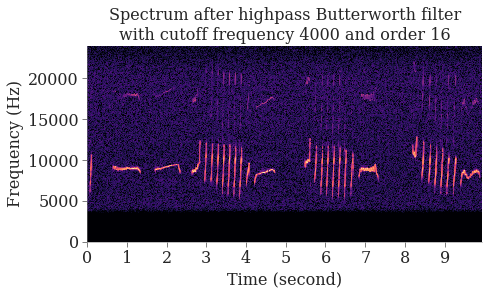

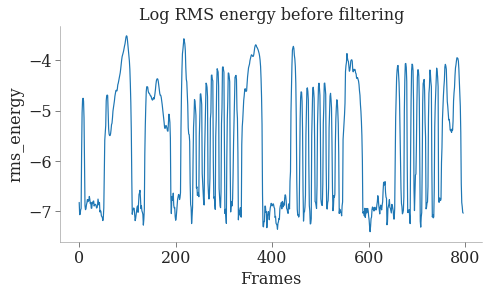

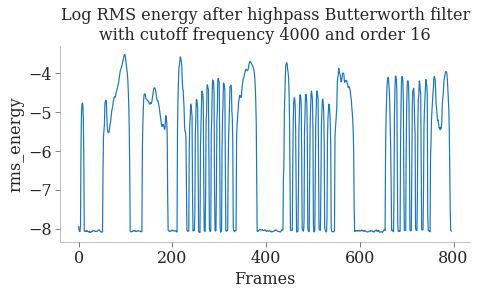

In [123]:
def log_rms_energy(path=None, sampling_rate=48000, window_size_ms=None, window_shift_ms=None, n_fft=512, center=False, verbose=True, draw_verbose=False, colorbar=True, figsize=(6.9, 4.2)):
    """ Compute log root-mean-square (rms) value for each frame with an optional highpass filter to remove low-freq noise.
    
    Parameters
    ----------
    path: the path of the audio
    sampling_rate: the sampling rate of audio
    window_size_ms: the frame window size (If unspecified, defaults to window_size_ms = (n_fft / sampling_rate) * 1000)
    window_shift_ms: the frame window shift (If unspecified, default to window_size_ms // 4)
    n_fft: n_fft should be the number of samples in a frame window by default. (n_fft = int(window_size_ms / 1000 * sampling_rate))
        If it is more than the number of samples in a frame window, zeros will be padded to be spectral oversampling 
        with more frequency points than the theoretical maximum level of detail in the fourier transform.
        For application of FFT on a frame, the result frequency number (num_freq) should be half of the n_fft,
        because of the symmetric of Fourier coefficients of a real signal only half of the coefficients provides all information
        (n_fft = (num_freq - 1) * 2))
    energy_filter: filter on spectrum (to remove noise) before extracting the energy (e.g. {'filter': "butter", "filter_type": "highpass", "cutoff_freq": 4000, "order": 16})
    verbose: whether to verbose the parameter informations or not
    draw_verbose: whether to draw all the figures or not
    colorbar: whether to draw color bar on figures or not
    figsize: figsize for draw_verbose
    
    Return
    ------
    the log rms energy of shape (num_frames, 0)
    
    Example
    -------
    # path=
    # sampling_rate=48000

    # # librosa.stft setting (n_fft=512 recommended for speech feature extraction))
    # n_fft=512
    # window_size_num_samples = n_fft
    # window_shift_num_samples = window_size_num_samples // 4 # default shift of librosa.stft.
    # window_size_ms = round((window_size_num_samples / sampling_rate) * 1000, ndigits=3)
    # window_shift_ms = round((window_shift_num_samples / sampling_rate) * 1000, ndigits=3)

    # # Tacotron setting
    # window_size_ms=50
    # window_shift_ms=12.5
    # n_fft=int(window_size_ms / 1000 * sampling_rate)

    # # Kaldi setting
    # window_size_ms=25
    # window_shift_ms=10
    # n_fft=int(window_size_ms / 1000 * sampling_rate)

    center=False
    verbose=True
    draw_verbose=True
    figsize=(6.9, 4.2)
    colorbar=False
    energy_filter= {'filter': "butter", "filter_type": "highpass", "cutoff_freq": 4000, "order": 16}
    energy = log_rms_energy(path=path, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, n_fft=n_fft, center=center, verbose=verbose, draw_verbose=draw_verbose, colorbar=colorbar, figsize=figsize)
        """
    if (window_size_ms and window_shift_ms):
        fft_window_size = int(window_size_ms / 1000 * sampling_rate)
        fft_window_shift = int(window_shift_ms / 1000 * sampling_rate)
    else:
        fft_window_size = n_fft # win_length: If unspecified for librosa.stft, defaults to ``win_length = n_fft``.
        fft_window_shift = fft_window_size // 4 # hop_length: If unspecified for librosa.stft, defaults to ``win_length // 4`` (see below).
        window_size_ms = (fft_window_size / sampling_rate) * 1000
        window_shift_ms = (fft_window_shift / sampling_rate) * 1000

    wav, sampling_rate = librosa.load(path, sr=sampling_rate)
    if (energy_filter and energy_filter['filter'] == 'butter'):
        filter_type=energy_filter['filter_type']
        cutoff_freq=energy_filter['cutoff_freq']
        order=energy_filter['order']
        second_order_sections = scipy.signal.butter(N=order, Wn=cutoff_freq, btype=filter_type, analog=False, fs=sampling_rate, output='sos')
        filtered_wav = scipy.signal.sosfilt(second_order_sections, wav)
        if (draw_verbose):
            fig = plt.figure(figsize=figsize)
            ax = fig.add_subplot(111)
            freq, response_of_freq = scipy.signal.sosfreqz(sos=second_order_sections, worN=4000,  fs=sampling_rate) # w (freq) and h (response of freq) with shape: (worN,); h contains complex numbers
            ax.plot(freq, abs(response_of_freq), label="\ncutoff_freq = {:.0f},\norder = {}".format(cutoff_freq, order))

            # ax.plot([0, 0.5 * sampling_rate], [np.sqrt(0.5), np.sqrt(0.5)], '--', label='sqrt(0.5)')
            ax.set_xlabel('Frequency (Hz)')
            ax.set_ylabel('Gain')
            ax.set_title("High-pass Butterworth filter with\ncutoff frequency {} and order {} (sampling rate = {}).".format(cutoff_freq, order, sampling_rate))
            plt.axvline(cutoff_freq, color='black') # cutoff frequency
            plt.grid(True)
            plt.legend(loc='best')
            
            librosa_wav2spectrum(wav=wav, n_fft=n_fft, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, spectrum_type="linear", title="Spectrum", center=center, colorbar=colorbar, figsize=figsize)
            librosa_wav2spectrum(wav=filtered_wav, n_fft=n_fft, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, spectrum_type="linear", title="Spectrum after {} Butterworth filter\nwith cutoff frequency {} and order {}".format(filter_type, cutoff_freq, order), center=center, colorbar=colorbar, figsize=figsize)
            ax.set_xticks(np.linspace(start=0, stop=6000, num=4, endpoint=False))
            ax.tick_params(axis='x', which='major', labelrotation=60)
    else:
        filtered_wav = wav
        
    rms_energy = librosa.feature.rms(y=filtered_wav, hop_length=fft_window_shift, frame_length=fft_window_size, center=center)
    rms_energy = rms_energy[0] # shape from (1, N) to (N,)
    if (draw_verbose):
        if (energy_filter and energy_filter['filter'] == 'butter'):
            raw_rms_energy = librosa.feature.rms(y=wav, hop_length=fft_window_shift, frame_length=fft_window_size, center=center)[0]
            draw_line_plot(np.log(raw_rms_energy), xlabel="Frames", ylabel="rms_energy", title="Log RMS energy before filtering", figsize=figsize)
            draw_line_plot(np.log(rms_energy), xlabel="Frames", ylabel="rms_energy", title="Log RMS energy after {} Butterworth filter\nwith cutoff frequency {} and order {}".format(filter_type, cutoff_freq, order), figsize=figsize)
        else:
            draw_line_plot(np.log(rms_energy), xlabel="Frames", ylabel="rms_energy", title="Log RMS energy", figsize=figsize)
    if (verbose):
        print(f"{window_size_ms=}, {window_shift_ms=}, {sampling_rate=}, {n_fft=}, {energy_filter=}")
        print("window_size_num_samples(win_length)={}, window_shift_num_samples(hop_length)={}".format(fft_window_size, fft_window_shift))
        print()

        print("shape of wav: {}".format(wav.shape))
        print("shape of STFT: {} (n_fft = (num_freq - 1) * 2) = ({} - 1) * 2) = {})".format(fft_coeff.shape, fft_coeff.shape[0],  (fft_coeff.shape[0] - 1) * 2))
        print("window size (win_length) for STFT: {}".format(fft_window_size))
        print("window shift (hop_length) for STFT: {}".format(fft_window_shift))
        if (center):
            print("center=True, padding on both sides with zeros (pad_mode='constant'); the signal y is padded so that the first frame is centered at the origin (frame D[:, t] is centered at y[t * hop_length]).")
        else:
            print("center=False, padding ignored; the first frame begins at the origin (the D[:, t] begins at signal y[t * hop_length]).")
        print("number of samples: {}; samples processed by STFT, including padding, is\nwindow_size + window_shift * (num_frames - 1) = {} + {} * ({} - 1) = {}".format(len(wav), fft_window_size, fft_window_shift, fft_coeff.shape[1], fft_window_size+fft_window_shift*(fft_coeff.shape[1]-1)))
        print()
        print("Final feature to return has a shape of ({}, ).".format(len(np.log(rms_energy))))

    return np.log(rms_energy)


# path=
# sampling_rate=48000

# # librosa.stft setting (n_fft=512 recommended for speech feature extraction))
# n_fft=512
# window_size_num_samples = n_fft
# window_shift_num_samples = window_size_num_samples // 4 # default shift of librosa.stft.
# window_size_ms = round((window_size_num_samples / sampling_rate) * 1000, ndigits=3)
# window_shift_ms = round((window_shift_num_samples / sampling_rate) * 1000, ndigits=3)

# # Tacotron setting
# window_size_ms=50
# window_shift_ms=12.5
# n_fft=int(window_size_ms / 1000 * sampling_rate)

# # Kaldi setting
# window_size_ms=25
# window_shift_ms=10
# n_fft=int(window_size_ms / 1000 * sampling_rate)

center=False
verbose=True
draw_verbose=True
figsize=(6.9, 4.2)
colorbar=False
energy_filter= {'filter': "butter", "filter_type": "highpass", "cutoff_freq": 4000, "order": 16}
energy = log_rms_energy(path=path, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, n_fft=n_fft, center=center, verbose=verbose, draw_verbose=draw_verbose, colorbar=colorbar, figsize=figsize)

In [18]:
# # # librosa.stft setting (n_fft=512 recommended for speech feature extraction))
# # n_fft=512
# # window_size_num_samples = n_fft
# # window_shift_num_samples = window_size_num_samples // 4 # default shift of librosa.stft.
# # window_size_ms = round((window_size_num_samples / sampling_rate) * 1000, ndigits=3)
# # window_shift_ms = round((window_shift_num_samples / sampling_rate) * 1000, ndigits=3)

# # # Tacotron setting
# # window_size_ms=50
# # window_shift_ms=12.5
# # n_fft=int(window_size_ms / 1000 * sampling_rate)

# # # # Kaldi setting
# # # window_size_ms=25
# # # window_shift_ms=10
# # # n_fft=int(window_size_ms / 1000 * sampling_rate)


# pitch_min=75
# pitch_max=4000
# threshold=0.1
# ref=None # np.mean

# window="hann"
# center=True
# time_type="s"  # "time" or "ms"
# figsize=(6.9, 4.2)
# figsize=(14, 4.2)
# figsize=figsize


# import numpy as np
# import matplotlib.pyplot as plt

# import librosa
# import librosa.display

# if (window_size_ms and window_shift_ms):
#     fft_window_size = int(window_size_ms / 1000 * sampling_rate)
#     fft_window_shift = int(window_shift_ms / 1000 * sampling_rate)
# else:
#     fft_window_size = n_fft # win_length: If unspecified for librosa.stft, defaults to ``win_length = n_fft``.
#     fft_window_shift = fft_window_size // 4 # hop_length: If unspecified for librosa.stft, defaults to ``win_length // 4`` (see below).
#     window_size_ms = (fft_window_size / sampling_rate) * 1000
#     window_shift_ms = (fft_window_shift / sampling_rate) * 1000


# fig = plt.figure(figsize=figsize)
# ax = fig.add_subplot(111)
# wav, sampling_rate = librosa.load(path, sr=sampling_rate)
# pitch, amplitude = librosa.piptrack(y=wav, sr=sampling_rate, n_fft=n_fft, hop_length=fft_window_shift, win_length=fft_window_size, fmin=pitch_min, fmax=pitch_max, window=window, center=center, threshold=threshold, ref=ref)
# plt.subplot(212)
# plt.imshow(pitches[:, :], aspect="auto", interpolation="nearest", origin="bottom")
# plt.title('pitches')
# # print(pitch)
# # print(amplitude)
# # image = draw_matrix(pitch)
# # image = draw_matrix(amplitude)
# # ax.set_xlabel("Time (second)")
# # ax.set_ylabel("Frequency (Hz)")
# # if title: ax.set_title(title + " with " + window_type + " window")
# plt.tight_layout()
# format_axes(ax)


In [19]:
# import crepe
# from scipy.io import wavfile

# sr, audio = wavfile.read(path)
# second_order_sections = scipy.signal.butter(N=16, Wn=4000, btype="highpass", analog=False, fs=sampling_rate, output='sos')
# wav = scipy.signal.sosfilt(second_order_sections, wav)
# time, frequency, confidence, activation = crepe.predict(wav, sr=sr, viterbi=False)

# # print(f"{time=}\n {frequency=}\n {confidence=}\n {activation=}")
# figure = plt.figure(figsize=(14, 4.2))
# ax = figure.add_subplot(111)
# ax.plot(time, frequency)

(1201, 797)
(2401, 793)
(4801, 785)


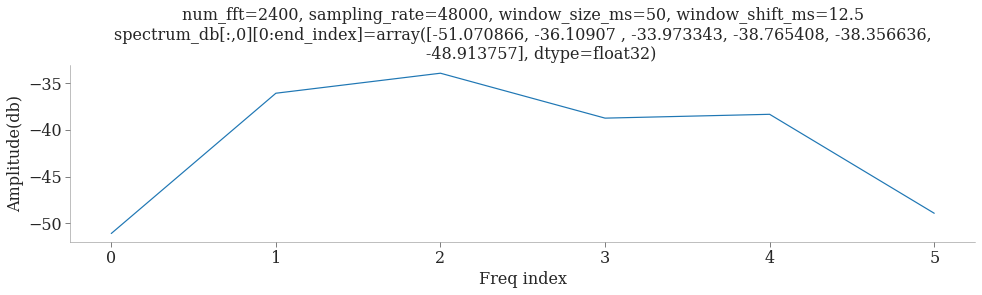

<Figure size 1008x302.4 with 0 Axes>

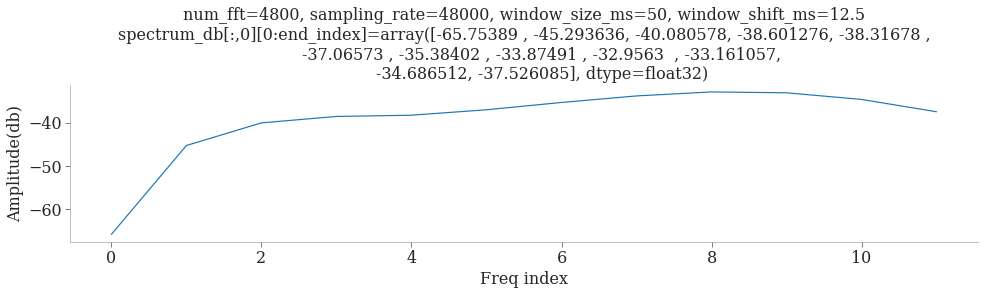

<Figure size 1008x302.4 with 0 Axes>

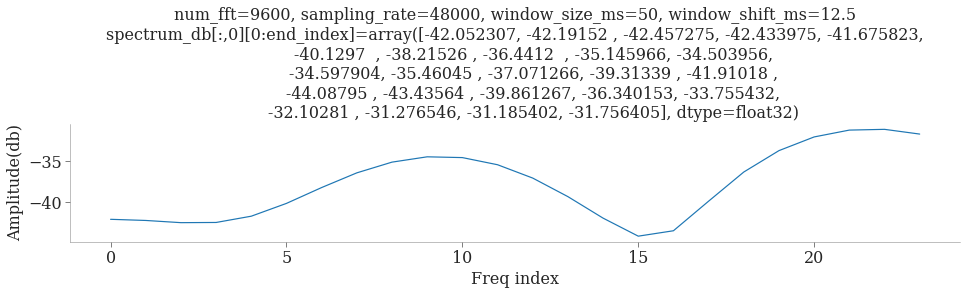

<Figure size 1008x302.4 with 0 Axes>

In [20]:
def librosa_wav2spectrumx(wav=None, n_fft=512, sampling_rate=48000, window_size_ms=None, window_shift_ms=None, spectrum_type="linear", title=None, center=False, colorbar=True, figsize=(14, 4.2)):
    if (window_size_ms and window_shift_ms):
        fft_window_size = int(window_size_ms / 1000 * sampling_rate)
        fft_window_shift = int(window_shift_ms / 1000 * sampling_rate)
    else:
        fft_window_size = n_fft # win_length: If unspecified for librosa.stft, defaults to ``win_length = n_fft``.
        fft_window_shift = fft_window_size // 4 # hop_length: If unspecified for librosa.stft, defaults to ``win_length // 4`` (see below).
        window_size_ms = (fft_window_size / sampling_rate) * 1000
        window_shift_ms = (fft_window_shift / sampling_rate) * 1000

    time_type="s"  # "time" or "ms"
    
    fft_coeff = librosa.stft(wav, n_fft=n_fft, hop_length=fft_window_shift, win_length=fft_window_size, window='hann', center=center) # center=False padding ignored
    spectrum_db = librosa.amplitude_to_db(np.abs(fft_coeff), ref=np.max)
    print(spectrum_db.shape)
    end_index=int(spectrum_db.shape[0]/200)
    draw_line_plot(spectrum_db[:,0][0:end_index], title=info + "\n" + f"{spectrum_db[:,0][0:end_index]=}", xlabel="Freq index", ylabel="Amplitude(db)")

    fig = plt.figure(figsize=figsize)
    #ax = fig.add_subplot(111)
    # image = librosa.display.specshow(spectrum_db, sr=sampling_rate, hop_length=fft_window_shift, y_axis=spectrum_type, x_axis=time_type, ax=ax, cmap='magma')
    #image = ax.imshow(spectrum_db, origin="lower", aspect='auto',cmap='magma', vmin=None, vmax=None) # continuous cmap='viridis' discrete cmap='tab20c'

    ax.set_xlabel("Time (second)")
    ax.set_ylabel("Frame (index)")
    if title: ax.set_title(title)
    #if (colorbar): plt.colorbar(image, ax=ax)

    plt.tight_layout()
    format_axes(ax)
    return ax

wav, sampling_rate = librosa.load(path, sr=sampling_rate)

num_fft=2400
info = f"{num_fft=}, {sampling_rate=}, {window_size_ms=}, {window_shift_ms=}"
librosa_wav2spectrumx(wav=wav, n_fft=num_fft, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, spectrum_type=spectrum_type, title=info, center=center, colorbar=True)

num_fft=2400*2
info = f"{num_fft=}, {sampling_rate=}, {window_size_ms=}, {window_shift_ms=}"
librosa_wav2spectrumx(wav=wav, n_fft=num_fft, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, spectrum_type=spectrum_type, title=info, center=center, colorbar=True)

num_fft=2400*4
info = f"{num_fft=}, {sampling_rate=}, {window_size_ms=}, {window_shift_ms=}"
librosa_wav2spectrumx(wav=wav, n_fft=num_fft, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, spectrum_type=spectrum_type, title=info, center=center, colorbar=True)


# Spectrum (tacotron analysis)

mel=26, window_size_ms=50, window_shift_ms=12.5, sampling_rate=48000, n_fft=2400, preemphasis=0.97, ref_db=20, min_db=-100, mean_norm=(True,), mel_min_freq=3000
window_size_num_samples(win_length)=2400, window_shift_num_samples(hop_length)=600

shape of wav: (480000,)
shape of STFT: (1201, 797) (n_fft = (num_freq - 1) * 2) = (1201 - 1) * 2) = 2400)
window size (win_length) for STFT: 2400
window shift (hop_length) for STFT: 600
center=False, padding ignored; the first frame begins at the origin (the D[:, t] begins at signal y[t * hop_length]).
number of samples: 480000; samples processed by STFT, including padding, is
window_size + window_shift * (num_frames - 1) = 2400 + 600 * (797 - 1) = 480000

shape of mel_basis: (26, 1201)
shape of amplitude: (26, 797)
Apply mel filter bank: amplitude = np.dot(mel_basis, amplitude)
Final feature to return has a shape of (26, 797).

window_size_ms=50, window_shift_ms=12.5, sampling_rate=48000, n_fft=2400, energy_filter={'filter': 'butter', 'filter_t

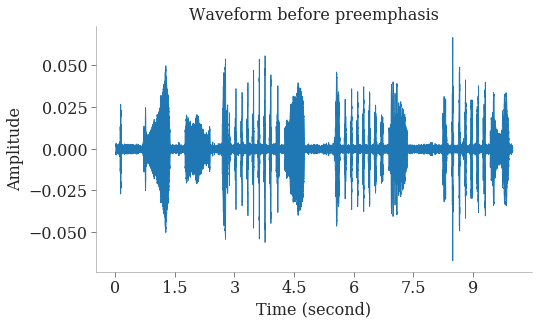

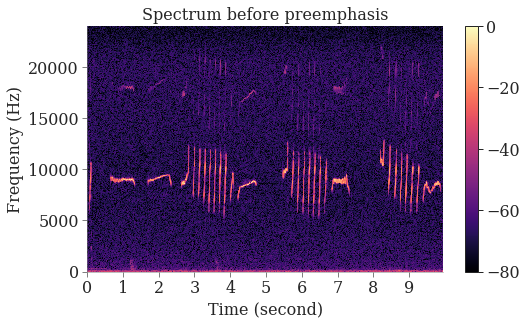

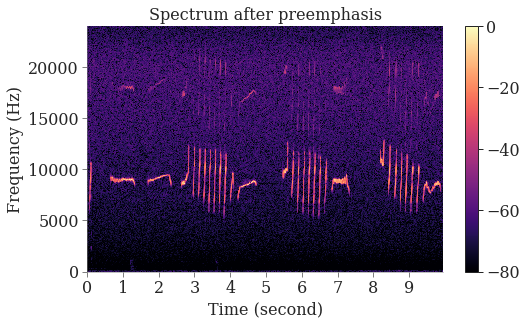

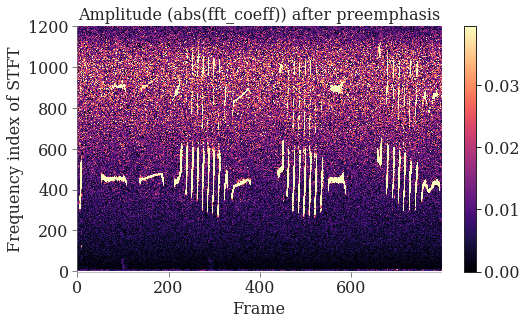

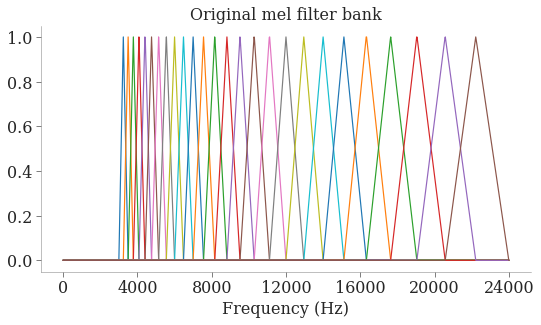

...

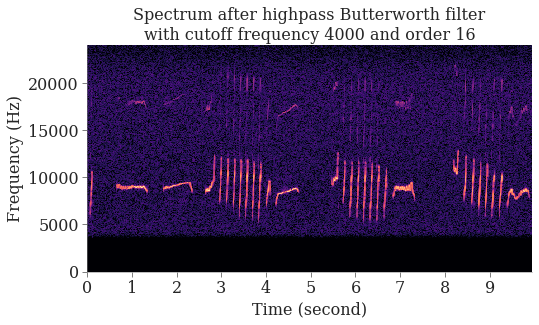

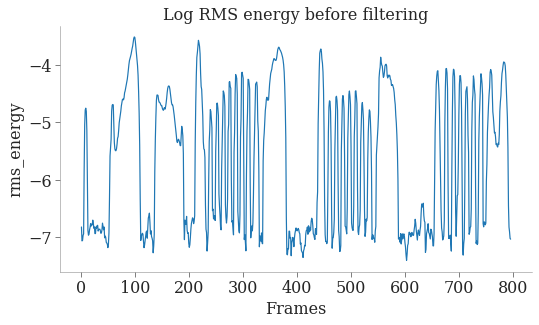

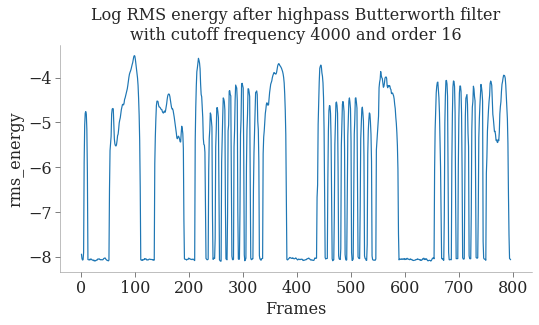

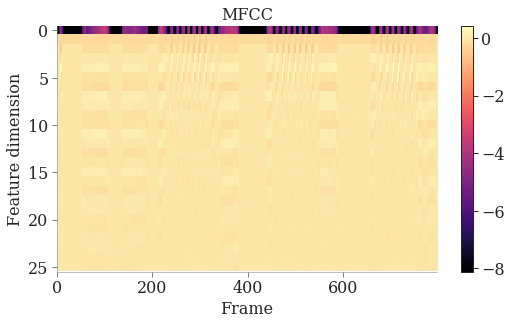

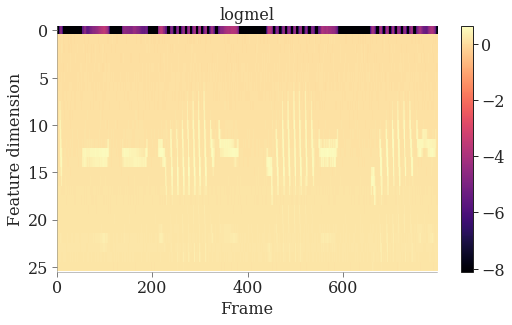

In [227]:
import os

def draw_line_plot(array, xlabel=None, ylabel=None, title=None, data_range_min=None, data_range_max=None, figsize=(14, 4.2)):
    fig =plt.figure(figsize=figsize)
    ax = fig.add_subplot(111)
    ax.plot(np.arange(len(array)), array)
    if (xlabel): ax.set_xlabel(xlabel)
    if (ylabel): ax.set_ylabel(ylabel)
    if (title): ax.set_title(title)
    plt.tight_layout()
    format_axes(ax)
    return ax

def draw_plot(matrix, xlabel=None, ylabel=None, title=None, data_range_min=None, data_range_max=None, figsize=(14, 4.2)):
    fig =plt.figure(figsize=figsize)
    ax = fig.add_subplot(111)
    ax.plot(matrix)
    if (xlabel): ax.set_xlabel(xlabel)
    if (ylabel): ax.set_ylabel(ylabel)
    if (title): ax.set_title(title)
    plt.tight_layout()
    format_axes(ax)
    return ax

def draw_matrix(matrix, xlabel=None, ylabel=None, title=None, data_range_min=None, data_range_max=None, colorbar=False, origin="lower", figsize=(14, 4.2)):
    fig =plt.figure(figsize=figsize)
    ax = fig.add_subplot(111)
    image = ax.imshow(matrix, origin=origin, aspect='auto',cmap='magma', vmin=data_range_min, vmax=data_range_max) # continuous cmap='viridis' discrete cmap='tab20c'
    if (colorbar): plt.colorbar(image, ax=ax)
    if (xlabel): ax.set_xlabel(xlabel)
    if (ylabel): ax.set_ylabel(ylabel)
    if (title): ax.set_title(title)
    plt.tight_layout()
    format_axes(ax)
    return ax

def draw_wav(wav, sampling_rate=48000, xlabel="Time (second)", ylabel="Amplitude", title=None, figsize=(14, 4.2)):
    fig = plt.figure(figsize=figsize)
    ax = fig.add_subplot(111)
    librosa.display.waveshow(wav, x_axis='s', sr=sampling_rate)
    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)
    ax.set_title(title)
    plt.tight_layout()
    format_axes(ax)
    return ax

def librosa_wav2spectrum(wav=None, n_fft=512, sampling_rate=48000, window_size_ms=None, window_shift_ms=None, spectrum_type="linear", title=None, center=False, colorbar=True, figsize=(14, 4.2)):
    if (window_size_ms and window_shift_ms):
        fft_window_size = int(window_size_ms / 1000 * sampling_rate)
        fft_window_shift = int(window_shift_ms / 1000 * sampling_rate)
    else:
        fft_window_size = n_fft # win_length: If unspecified for librosa.stft, defaults to ``win_length = n_fft``.
        fft_window_shift = fft_window_size // 4 # hop_length: If unspecified for librosa.stft, defaults to ``win_length // 4`` (see below).
        window_size_ms = (fft_window_size / sampling_rate) * 1000
        window_shift_ms = (fft_window_shift / sampling_rate) * 1000

    time_type="s"  # "time" or "ms"
    
    fft_coeff = librosa.stft(wav, n_fft=n_fft, hop_length=fft_window_shift, win_length=fft_window_size, window='hann', center=center) # center=False padding ignored
    spectrum_db = librosa.amplitude_to_db(np.abs(fft_coeff), ref=np.max)

    fig = plt.figure(figsize=figsize)
    ax = fig.add_subplot(111)
    image = librosa.display.specshow(spectrum_db, sr=sampling_rate, n_fft=n_fft, hop_length=fft_window_shift, win_length=fft_window_size, y_axis=spectrum_type, x_axis=time_type, ax=ax, cmap='magma')
    
    ax.set_xlabel("Time (second)")
    ax.set_ylabel("Frequency (Hz)")
    if title: ax.set_title(title)
    if (colorbar): plt.colorbar(image, ax=ax)

    plt.tight_layout()
    format_axes(ax)
    return ax

def apply_freq_ax(ax, ax_direction='x', n_fft=512, sampling_rate=48000):
    freq_bin_width = sampling_rate / n_fft
    if ax_direction == 'x':
        xticks = ax.get_xticks()
        labels = ["{:.0f}".format(x * freq_bin_width) for x in xticks]
        ax.set_xticklabels(labels)
        ax.set_xlabel("Frequency (Hz)")
    if ax_direction == 'y':
        yticks = ax.get_yticks()
        labels = ["{:.0f}".format(y * freq_bin_width) for y in yticks]
        ax.set_yticklabels(labels)
        ax.set_ylabel("Frequency (Hz)") 
    return ax

def log_rms_energy(path=None, sampling_rate=48000, window_size_ms=None, window_shift_ms=None, n_fft=512, center=False, verbose=True, draw_verbose=False, colorbar=True, figsize=(6.9, 4.2)):
    """ Compute log root-mean-square (rms) value for each frame with an optional highpass filter to remove low-freq noise.
    
    Parameters
    ----------
    path: the path of the audio
    sampling_rate: the sampling rate of audio
    window_size_ms: the frame window size (If unspecified, defaults to window_size_ms = (n_fft / sampling_rate) * 1000)
    window_shift_ms: the frame window shift (If unspecified, default to window_size_ms // 4)
    n_fft: n_fft should be the number of samples in a frame window by default. (n_fft = int(window_size_ms / 1000 * sampling_rate))
        If it is more than the number of samples in a frame window, zeros will be padded to be spectral oversampling 
        with more frequency points than the theoretical maximum level of detail in the fourier transform.
        For application of FFT on a frame, the result frequency number (num_freq) should be half of the n_fft,
        because of the symmetric of Fourier coefficients of a real signal only half of the coefficients provides all information
        (n_fft = (num_freq - 1) * 2))
    energy_filter: filter on spectrum (to remove noise) before extracting the energy (e.g. {'filter': "butter", "filter_type": "highpass", "cutoff_freq": 4000, "order": 16})
    verbose: whether to verbose the parameter informations or not
    draw_verbose: whether to draw all the figures or not
    colorbar: whether to draw color bar on figures or not
    figsize: figsize for draw_verbose
    
    Return
    ------
    the log rms energy of shape (num_frames, 0)
    
    Example
    -------
    # path=
    # sampling_rate=48000

    # # librosa.stft setting (n_fft=512 recommended for speech feature extraction))
    # n_fft=512
    # window_size_num_samples = n_fft
    # window_shift_num_samples = window_size_num_samples // 4 # default shift of librosa.stft.
    # window_size_ms = round((window_size_num_samples / sampling_rate) * 1000, ndigits=3)
    # window_shift_ms = round((window_shift_num_samples / sampling_rate) * 1000, ndigits=3)

    # # Tacotron setting
    # window_size_ms=50
    # window_shift_ms=12.5
    # n_fft=int(window_size_ms / 1000 * sampling_rate)

    # # Kaldi setting
    # window_size_ms=25
    # window_shift_ms=10
    # n_fft=int(window_size_ms / 1000 * sampling_rate)

    center=False
    verbose=True
    draw_verbose=True
    figsize=(6.9, 4.2)
    colorbar=False
    energy_filter= {'filter': "butter", "filter_type": "highpass", "cutoff_freq": 4000, "order": 16}
    energy = log_rms_energy(path=path, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, n_fft=n_fft, center=center, verbose=verbose, draw_verbose=draw_verbose, colorbar=colorbar, figsize=figsize)
        """
    if (window_size_ms and window_shift_ms):
        fft_window_size = int(window_size_ms / 1000 * sampling_rate)
        fft_window_shift = int(window_shift_ms / 1000 * sampling_rate)
    else:
        fft_window_size = n_fft # win_length: If unspecified for librosa.stft, defaults to ``win_length = n_fft``.
        fft_window_shift = fft_window_size // 4 # hop_length: If unspecified for librosa.stft, defaults to ``win_length // 4`` (see below).
        window_size_ms = (fft_window_size / sampling_rate) * 1000
        window_shift_ms = (fft_window_shift / sampling_rate) * 1000

    wav, sampling_rate = librosa.load(path, sr=sampling_rate)
    if (energy_filter and energy_filter['filter'] == 'butter'):
        filter_type=energy_filter['filter_type']
        cutoff_freq=energy_filter['cutoff_freq']
        order=energy_filter['order']
        second_order_sections = scipy.signal.butter(N=order, Wn=cutoff_freq, btype=filter_type, analog=False, fs=sampling_rate, output='sos')
        filtered_wav = scipy.signal.sosfilt(second_order_sections, wav)
        if (draw_verbose):
            fig = plt.figure(figsize=figsize)
            ax = fig.add_subplot(111)
            freq, response_of_freq = scipy.signal.sosfreqz(sos=second_order_sections, worN=4000,  fs=sampling_rate) # w (freq) and h (response of freq) with shape: (worN,); h contains complex numbers
            ax.plot(freq, abs(response_of_freq), label="\ncutoff_freq = {:.0f},\norder = {}".format(cutoff_freq, order))

            # ax.plot([0, 0.5 * sampling_rate], [np.sqrt(0.5), np.sqrt(0.5)], '--', label='sqrt(0.5)')
            ax.set_xlabel('Frequency (Hz)')
            ax.set_ylabel('Gain')
            ax.set_title("High-pass Butterworth filter with\ncutoff frequency {} and order {} (sampling rate = {}).".format(cutoff_freq, order, sampling_rate))
            plt.axvline(cutoff_freq, color='black') # cutoff frequency
            plt.grid(True)
            plt.legend(loc='best')
            
            librosa_wav2spectrum(wav=wav, n_fft=n_fft, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, spectrum_type="linear", title="Spectrum", center=center, colorbar=colorbar, figsize=figsize)
            librosa_wav2spectrum(wav=filtered_wav, n_fft=n_fft, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, spectrum_type="linear", title="Spectrum after {} Butterworth filter\nwith cutoff frequency {} and order {}".format(filter_type, cutoff_freq, order), center=center, colorbar=colorbar, figsize=figsize)
            ax.set_xticks(np.linspace(start=0, stop=6000, num=4, endpoint=False))
            ax.tick_params(axis='x', which='major', labelrotation=60)
    else:
        filtered_wav = wav
        
    rms_energy = librosa.feature.rms(y=filtered_wav, hop_length=fft_window_shift, frame_length=fft_window_size, center=center)
    rms_energy = rms_energy[0] # shape from (1, N) to (N,)
    if (draw_verbose):
        if (energy_filter and energy_filter['filter'] == 'butter'):
            raw_rms_energy = librosa.feature.rms(y=wav, hop_length=fft_window_shift, frame_length=fft_window_size, center=center)[0]
            draw_line_plot(np.log(raw_rms_energy), xlabel="Frames", ylabel="rms_energy", title="Log RMS energy before filtering", figsize=figsize)
            draw_line_plot(np.log(rms_energy), xlabel="Frames", ylabel="rms_energy", title="Log RMS energy after {} Butterworth filter\nwith cutoff frequency {} and order {}".format(filter_type, cutoff_freq, order), figsize=figsize)
        else:
            draw_line_plot(np.log(rms_energy), xlabel="Frames", ylabel="rms_energy", title="Log RMS energy", figsize=figsize)
    if (verbose):
        print(f"{window_size_ms=}, {window_shift_ms=}, {sampling_rate=}, {n_fft=}, {energy_filter=}")
        print("window_size_num_samples(win_length)={}, window_shift_num_samples(hop_length)={}".format(fft_window_size, fft_window_shift))
        print()

        print("shape of wav: {}".format(wav.shape))
        print("shape of STFT: {} (n_fft = (num_freq - 1) * 2) = ({} - 1) * 2) = {})".format(fft_coeff.shape, fft_coeff.shape[0],  (fft_coeff.shape[0] - 1) * 2))
        print("window size (win_length) for STFT: {}".format(fft_window_size))
        print("window shift (hop_length) for STFT: {}".format(fft_window_shift))
        if (center):
            print("center=True, padding on both sides with zeros (pad_mode='constant'); the signal y is padded so that the first frame is centered at the origin (frame D[:, t] is centered at y[t * hop_length]).")
        else:
            print("center=False, padding ignored; the first frame begins at the origin (the D[:, t] begins at signal y[t * hop_length]).")
        print("number of samples: {}; samples processed by STFT, including padding, is\nwindow_size + window_shift * (num_frames - 1) = {} + {} * ({} - 1) = {}".format(len(wav), fft_window_size, fft_window_shift, fft_coeff.shape[1], fft_window_size+fft_window_shift*(fft_coeff.shape[1]-1)))
        print()
        print("Final feature to return has a shape of ({}, ).".format(len(np.log(rms_energy))))

    return np.log(rms_energy)

def librosa_spectrum_tacotron3(path=None, n_fft=512, sampling_rate=48000, window_size_ms=None, window_shift_ms=None, spectrum_type="linear", title=None, center=False, preemphasis=None, ref_db=None, min_db=None, mel=None, mean_norm=False, mel_min_freq=None, mel_max_freq=None, verbose=True, draw_verbose=False, colorbar=True, figsize=(6.9, 4.2)):
    """ Compute and draw the spectrum.
    
    Parameters
    ----------
    path: the path of the audio
    n_fft: n_fft should be the number of samples in a frame window by default. (n_fft = int(window_size_ms / 1000 * sampling_rate))
        If it is more than the number of samples in a frame window, zeros will be padded to be spectral oversampling 
        with more frequency points than the theoretical maximum level of detail in the fourier transform.
        For application of FFT on a frame, the result frequency number (num_freq) should be half of the n_fft,
        because of the symmetric of Fourier coefficients of a real signal only half of the coefficients provides all information
        (n_fft = (num_freq - 1) * 2))
    sampling_rate: the sampling rate of audio
    window_size_ms: the frame window size (If unspecified, defaults to window_size_ms = (n_fft / sampling_rate) * 1000)
    window_shift_ms: the frame window shift (If unspecified, default to window_size_ms // 4)
    spectrum_type: "linear" or "log" (scaled spectrum)
    title: None (ignore this option)
    center: center is true when the first frame is centered at the origin if True, zeros padded
        center is False when the first frame starts at the origin, padding ignored
    preemphasis: a float value for preemphasis
    ref_db: spectrum_db = 20 * np.log10(np.maximum(1e-5, amplitude)) - ref_db
    min_db: spectrum_db = np.clip((spectrum_db - min_db) / -min_db, 0, 1)
    mel: number of mel spectrum
    mean_norm: mean normalization on the spectrum
    mel_min_freq: the mel starts at mel_min_freq
    mel_max_freq: the mel does not exceed mel_max_freq
    verbose: whether to verbose the parameter informations or not
    draw_verbose: whether to draw all the figures or not
    figsize: figsize for draw_verbose
    colorbar: whether to draw color bar on figures or not
    
    Returns
    -------
    The (log mel) spectrum with shape (num_mels, num_frames)
    
    Example settings
    ----------------
    # librosa.stft setting (n_fft=512 recommended for speech feature extraction))
    n_fft=512
    window_size_num_samples = n_fft
    window_shift_num_samples = window_size_num_samples // 4 # default shift of librosa.stft.
    window_size_ms = round((window_size_num_samples / sampling_rate) * 1000, ndigits=3)
    window_shift_ms = round((window_shift_num_samples / sampling_rate) * 1000, ndigits=3)

    # Tacotron setting
    window_size_ms=50
    window_shift_ms=12.5
    n_fft=int(window_size_ms / 1000 * sampling_rate)

    # Kaldi setting
    window_size_ms=25
    window_shift_ms=10
    n_fft=int(window_size_ms / 1000 * sampling_rate)

    Example
    -------
    path= audio_path
    sampling_rate=48000
    mel=40
    window_size_ms=50
    window_shift_ms=12.5
    spectrum_type="linear"
    title=None
    center=True
    ref_db=20
    preemphasis=0.97
    min_db=-100
    mean_norm=True,
    mel_min_freq=None # 3000
    verbose=True
    draw_verbose=True
    n_fft= int(window_size_ms / 1000 * sampling_rate)
    logmel = librosa_spectrum_tacotron3(path=path, n_fft=n_fft, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, spectrum_type=spectrum_type, title=title, center=center, ref_db=ref_db, preemphasis=preemphasis, mel=mel, min_db=min_db, mean_norm=mean_norm, mel_min_freq=mel_min_freq, verbose=verbose, draw_verbose=draw_verbose)

    Additional information
    ------------------
    The function replicates the tacotron setting of mel spectrum.
    config_taco_mel_f13_sr48000 = {
    "pkg":"taco",
    "type":"mel",
    "num_mels":80,
    "num_freq":2048,
    "sample_rate":48000,
    "frame_length_ms":50,
    "frame_shift_ms":12.5,
    "preemphasis":0.97,
    "min_level_db":-100,
    "ref_level_db":20,
    "griffin_lim_iters":60,
    "power":1.5}
    librosa_spectrum_tacotron3(path=path, n_fft=4094, sampling_rate=sampling_rate,  window_size_ms=50, window_shift_ms=12.5, spectrum_type="linear", title=title, center=True, ref_db=20, preemphasis=0.97, mel=13, min_db=-100, mean_norm=True)
    
    Implemented by bin-wu at 16:53 on 20220614
    """
    import numpy as np
    import scipy
    import matplotlib.pyplot as plt

    import librosa
    import librosa.display

    if (window_size_ms and window_shift_ms):
        fft_window_size = int(window_size_ms / 1000 * sampling_rate)
        fft_window_shift = int(window_shift_ms / 1000 * sampling_rate)
    else:
        fft_window_size = n_fft # win_length: If unspecified for librosa.stft, defaults to ``win_length = n_fft``.
        fft_window_shift = fft_window_size // 4 # hop_length: If unspecified for librosa.stft, defaults to ``win_length // 4`` (see below).
        window_size_ms = (fft_window_size / sampling_rate) * 1000
        window_shift_ms = (fft_window_shift / sampling_rate) * 1000
           
    time_type="s"  # "time" or "ms"

    # Load the data
    wav, sampling_rate = librosa.load(path, sr=sampling_rate)
    if (draw_verbose):
        draw_wav(wav, sampling_rate=sampling_rate, title="Waveform before preemphasis", figsize=figsize)
        librosa_wav2spectrum(wav=wav, n_fft=n_fft, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, spectrum_type=spectrum_type, title="Spectrum before preemphasis", center=center, colorbar=colorbar, figsize=figsize)

    # Preemphasis
    if (preemphasis): 
        wav = scipy.signal.lfilter([1, -preemphasis], [1], wav)
        if (draw_verbose):
            # draw_wav(wav, sampling_rate=sampling_rate, title="Waveform after preemphasis", figsize=figsize)
            librosa_wav2spectrum(wav=wav, n_fft=n_fft, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, spectrum_type=spectrum_type, title="Spectrum after preemphasis", center=center, colorbar=colorbar, figsize=figsize)

    # FFT
    fft_coeff = librosa.stft(wav, n_fft=n_fft, hop_length=fft_window_shift, win_length=fft_window_size, window='hann', center=center) # center=False padding ignored
    amplitude = np.abs(fft_coeff)
    if (draw_verbose): draw_matrix(amplitude, title="Amplitude (abs(fft_coeff)) after preemphasis", xlabel="Frame", ylabel="Frequency index of STFT", data_range_min=0, data_range_max=amplitude.mean(), colorbar=colorbar, figsize=figsize)
    
#     index = 299
#     time_sec=index2time(index, window_size=window_size_ms / 1000, window_shift=window_shift_ms/1000, center=center)
#     frame_index, begin_sec, end_sec = time2index(time_sec,  window_size=window_size_ms / 1000, window_shift=window_shift_ms/1000, center=center, verbose=True)
#     info = f"({time_sec=:.3f}, {sr=}, {window_size_ms=}, {window_shift_ms=}, {center=})"
#     ax = draw_line_plot(amplitude[:,index], title=f"FFT after hann window ({frame_index=}, {begin_sec=}, {end_sec=})\n"+info, xlabel="Frequency (Hz)", ylabel="Amplitude", figsize=(14, 4.2))
#     xticks = ax.get_xticks()
#     N = fft_window_size = int(window_size_ms / 1000 * sampling_rate)
#     ax.set_xticklabels([str(round(tick * sampling_rate/N, ndigits=1)) for tick in xticks])
#     ax.grid()

    # Mel spectrum
    if (mel):
        if (mel_min_freq): 
            mel_basis = librosa.filters.mel(sr=sampling_rate, fmin=mel_min_freq, fmax=mel_max_freq, n_fft=n_fft, n_mels=mel)
        else: 
            mel_basis = librosa.filters.mel(sr=sampling_rate, n_fft=n_fft, n_mels=mel)
        if (draw_verbose):
            ax = draw_plot((mel_basis / np.max(mel_basis, axis=-1)[:, np.newaxis]).T, xlabel="Frequency index of STFT", title="Original mel filter bank", figsize=figsize)
            apply_freq_ax(ax, ax_direction='x', n_fft=n_fft, sampling_rate=sampling_rate)
            ax = draw_plot(mel_basis.T, xlabel="Frequency index of STFT", title="Normalized mel filter bank used by librosa", figsize=figsize)
            apply_freq_ax(ax, ax_direction='x', n_fft=n_fft, sampling_rate=sampling_rate)
        amplitude = np.dot(mel_basis, amplitude) # amplitude ** 2 for librosa's scaling "mel_f.dot(S**power) and power=2"
        if (draw_verbose): draw_matrix(amplitude, title="Mel amplitude (mel * (abs(fft_coeff)))\nafter preemphasis and mel bank.", xlabel="Frame", ylabel="Feature index", data_range_min=0, data_range_max=amplitude.mean(), colorbar=colorbar, figsize=figsize)
    
    # Log mel spectrum
    spectrum_db = 20 * np.log10(np.maximum(1e-5, amplitude)) # 10 * np.log10(amplitude ** 2) = 10 * np.log10(power)
    if (ref_db): spectrum_db = spectrum_db - ref_db
    # if (draw_verbose): draw_matrix(spectrum_db, title="Amplitude2db: log mel amplitude after preemphasis and mel bank.", xlabel="Frame", ylabel="Feature index", data_range_min=-100, data_range_max=-40, colorbar=colorbar)
        
    # Cutoff by the minimum dB and mean normalization
    if (min_db): spectrum_db = np.clip((spectrum_db - min_db) / -min_db, 0, 1)
    if (draw_verbose): draw_matrix(spectrum_db, title="Amplitude2db: log mel amplitude\nafter preemphasis and mel bank.", xlabel="Frame", ylabel="Feature index", colorbar=colorbar, figsize=figsize)

    if (mean_norm): 
        spectrum_db = spectrum_db - spectrum_db.mean(axis=1)[:, np.newaxis]
        if (draw_verbose): draw_matrix(spectrum_db, title="Mean_norm: log mel amplitude\nafter preemphasis and mel bank\nand mean normalization.", xlabel="Frame", ylabel="Feature index", colorbar=colorbar, figsize=figsize)
 
    if (verbose):
        print(f"{mel=}, {window_size_ms=}, {window_shift_ms=}, {sampling_rate=}, {n_fft=}, {preemphasis=}, {ref_db=}, {min_db=}, {mean_norm=}, {mel_min_freq=}")
        print("window_size_num_samples(win_length)={}, window_shift_num_samples(hop_length)={}".format(fft_window_size, fft_window_shift))
        print()

        print("shape of wav: {}".format(wav.shape))
        print("shape of STFT: {} (n_fft = (num_freq - 1) * 2) = ({} - 1) * 2) = {})".format(fft_coeff.shape, fft_coeff.shape[0],  (fft_coeff.shape[0] - 1) * 2))
        print("window size (win_length) for STFT: {}".format(fft_window_size))
        print("window shift (hop_length) for STFT: {}".format(fft_window_shift))
        if (center):
            print("center=True, padding on both sides with zeros (pad_mode='constant'); the signal y is padded so that the first frame is centered at the origin (frame D[:, t] is centered at y[t * hop_length]).")
        else:
            print("center=False, padding ignored; the first frame begins at the origin (the D[:, t] begins at signal y[t * hop_length]).")
        print("number of samples: {}; samples processed by STFT, including padding, is\nwindow_size + window_shift * (num_frames - 1) = {} + {} * ({} - 1) = {}".format(len(wav), fft_window_size, fft_window_shift, fft_coeff.shape[1], fft_window_size+fft_window_shift*(fft_coeff.shape[1]-1)))
        print()

        if (mel):
            print("shape of mel_basis: {}".format(mel_basis.shape))
            print("shape of amplitude: {}".format(amplitude.shape))
            print("Apply mel filter bank: amplitude = np.dot(mel_basis, amplitude)")
        print("Final feature to return has a shape of ({}, {}).".format(spectrum_db.shape[0], spectrum_db.shape[1]))

    return spectrum_db


# n_fft = 512 # n_fft=512 recommend for speech (default 2048)

# path=
# sampling_rate=48000

# # librosa.stft setting (n_fft=512 recommended for speech feature extraction))
# n_fft=512
# window_size_num_samples = n_fft
# window_shift_num_samples = window_size_num_samples // 4 # default shift of librosa.stft.
# window_size_ms = round((window_size_num_samples / sampling_rate) * 1000, ndigits=3)
# window_shift_ms = round((window_shift_num_samples / sampling_rate) * 1000, ndigits=3)

# # Tacotron setting
# window_size_ms=50
# window_shift_ms=12.5
# n_fft=int(window_size_ms / 1000 * sampling_rate)

# # Kaldi setting
# window_size_ms=25
# window_shift_ms=10
# n_fft=int(window_size_ms / 1000 * sampling_rate)

num_mels=26 # 13
# window_size_ms=50
# window_shift_ms=12.5
spectrum_type="linear"
title=None
center=False
ref_db=20
preemphasis=0.97
min_db=-100
mean_norm=True,
mel_min_freq=3000 # None
verbose=True
draw_verbose=True
# n_fft=int(window_size_ms / 1000 * sampling_rate)
figsize=(6.9*1.1, 4.2*1.1)
# figsize=(14*1.1, 4.2*1.1)
logmel = librosa_spectrum_tacotron3(path=path, n_fft=n_fft, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, spectrum_type=spectrum_type, title=title, center=center, ref_db=ref_db, preemphasis=preemphasis, mel=num_mels, min_db=min_db, mean_norm=mean_norm, mel_min_freq=mel_min_freq, verbose=verbose, draw_verbose=draw_verbose, figsize=figsize)
print()

# MFCC
DCT_norm="ortho" # None # normalization of discrete cosine transform
logmel = librosa_spectrum_tacotron3(path=path, n_fft=n_fft, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, spectrum_type=spectrum_type, title=title, center=center, ref_db=ref_db, preemphasis=preemphasis, mel=num_mels, min_db=min_db, mean_norm=False, mel_min_freq=mel_min_freq, verbose=False, draw_verbose=False, figsize=figsize)
draw_matrix(logmel, title="Logmel", xlabel="Frame", ylabel="Feature dimension", colorbar=True, figsize=figsize)
mfcc = librosa.feature.mfcc(sr=sampling_rate, S=logmel, n_mfcc=num_mels, dct_type=2, norm=DCT_norm, lifter=0)
draw_matrix(mfcc, title="MFCC", xlabel="Frame", ylabel="Feature dimension", colorbar=True, origin="upper", figsize=figsize)

# Energy
energy_filter= {'filter': "butter", "filter_type": "highpass", "cutoff_freq": 4000, "order": 16}
energy = log_rms_energy(path=path, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, n_fft=n_fft, center=center, verbose=verbose, draw_verbose=draw_verbose, colorbar=colorbar, figsize=figsize)
logmel = librosa_spectrum_tacotron3(path=path, n_fft=n_fft, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, spectrum_type=spectrum_type, title=title, center=center, ref_db=ref_db, preemphasis=preemphasis, mel=num_mels, min_db=min_db, mean_norm=False, mel_min_freq=mel_min_freq, verbose=False, draw_verbose=False, figsize=figsize)
mfcc = librosa.feature.mfcc(sr=sampling_rate, S=logmel, n_mfcc=num_mels, dct_type=2, norm='ortho', lifter=0)

# Add energy: the zeroth coefficient is replaced with the log of the total frame rms energy.
# energy = (energy - energy.mean()) / energy.std()
mfcc[0] = energy
draw_matrix(mfcc, title="MFCC", xlabel="Frame", ylabel="Feature dimension", colorbar=True, origin="upper", figsize=figsize)
logmel[0] = energy
draw_matrix(logmel, title="logmel", xlabel="Frame", ylabel="Feature dimension", colorbar=True, origin="upper", figsize=figsize)

# Spectrum (can skip) 

shape of wav: (480000,)
shape of STFT: (257, 3751) (n_fft = (num_freq - 1) * 2) = (257 - 1) * 2) = 512)
window size (win_length) for STFT: 512
window shift (hop_length) for STFT: 128
center=True, padding on both sides with zeros (pad_mode='constant'); the signal y is padded so that the first frame is centered at the origin (frame D[:, t] is centered at y[t * hop_length]).
number of samples: 480000; samples processed by STFT, including padding, is
window_size + window_shift * (num_frames - 1) = 512 + 128 * (3751 - 1) = 480512



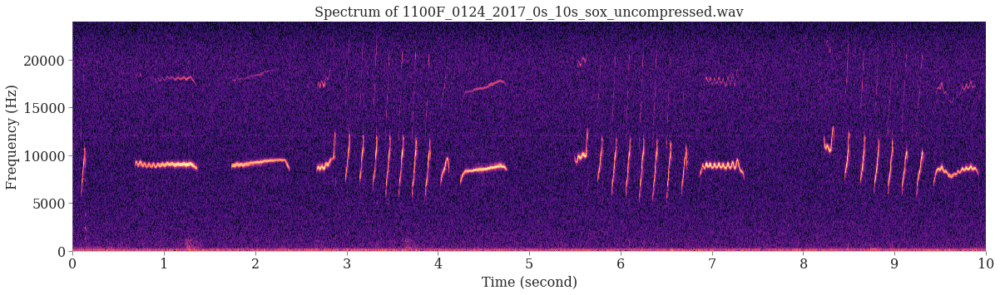

In [38]:
import os
def librosa_spectrum(path=None, n_fft=512, sampling_rate=48000, spectrum_type="linear", title=None, center=False):
    import numpy as np
    import matplotlib.pyplot as plt

    import librosa
    import librosa.display
    
    fft_window_size = n_fft # win_length: If unspecified for librosa.stft, defaults to ``win_length = n_fft``.
    fft_window_shift = fft_window_size // 4 # hop_length: If unspecified for librosa.stft, defaults to ``win_length // 4`` (see below).

   
    time_type="s"  # "time" or "ms"
    
    wav, sampling_rate = librosa.load(path, sr=sampling_rate)
    # If center=True, the signal y is padded so that frame D[:, t] is centered at y[t * hop_length], padding on both sides with zeros (pad_mode="constant"). 
    # If center=False, then D[:, t] begins at y[t * hop_length], padding ignored
    fft_coeff = librosa.stft(wav, n_fft=n_fft, window='hann', center=center) # center=False padding ignored
    spectrum_db = librosa.amplitude_to_db(np.abs(fft_coeff), ref=np.max)
    
    print("shape of wav: {}".format(wav.shape))
    print("shape of STFT: {} (n_fft = (num_freq - 1) * 2) = ({} - 1) * 2) = {})".format(fft_coeff.shape, fft_coeff.shape[0],  (fft_coeff.shape[0] - 1) * 2))
    print("window size (win_length) for STFT: {}".format(fft_window_size))
    print("window shift (hop_length) for STFT: {}".format(fft_window_shift))
    if (center):
        print("center=True, padding on both sides with zeros (pad_mode='constant'); the signal y is padded so that the first frame is centered at the origin (frame D[:, t] is centered at y[t * hop_length]).")
    else:
        print("center=False, padding ignored; the first frame begins at the origin (the D[:, t] begins at signal y[t * hop_length]).")
    print("number of samples: {}; samples processed by STFT, including padding, is\nwindow_size + window_shift * (num_frames - 1) = {} + {} * ({} - 1) = {}".format(len(wav), fft_window_size, fft_window_shift, fft_coeff.shape[1], fft_window_size+fft_window_shift*(fft_coeff.shape[1]-1)))
    print()

    fig = plt.figure(figsize=(14*1.2, 4.2*1.2))
    ax = fig.add_subplot(111)

    img = librosa.display.specshow(spectrum_db, sr=sampling_rate, hop_length=fft_window_shift, y_axis=spectrum_type, x_axis=time_type, ax=ax, cmap='magma')
    # img = librosa.display.specshow(spectrum_db, y_axis="linear", ax=ax, cmap='viridis')

    ax.set_xlabel("Time (second)")
    ax.set_ylabel("Frequency (Hz)")
    if title: ax.set_title(title)

    plt.tight_layout()
    format_axes(ax)
    # plt.savefig(cur_dir + "/fig/"+measure+"_corp.pdf")

title = "Spectrum of {}".format(os.path.basename(path))
# n_fft = 512 # n_fft=512 recommend for speech (default 2048)
librosa_spectrum(path=path, n_fft=n_fft, sampling_rate=sampling_rate, spectrum_type=spectrum_type, title=title, center=True)
# librosa_spectrum(path=path, title=title, spectrum_type=spectrum_type)

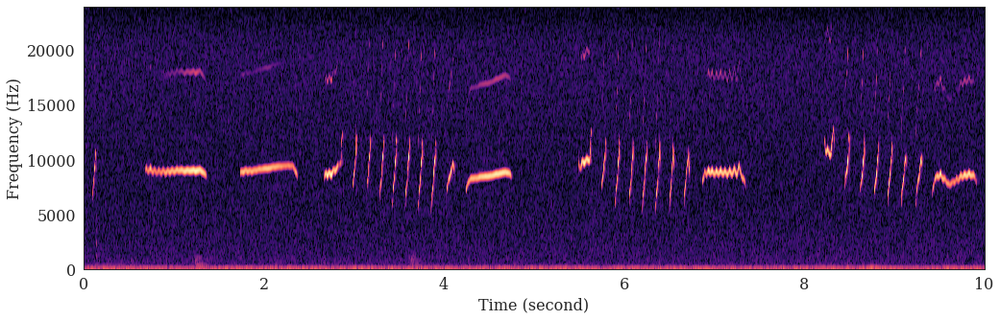

In [18]:
# https://github.com/YannickJadoul/Parselmouth
import parselmouth

import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

snd = parselmouth.Sound(path)
def draw_spectrogram(spectrogram, dynamic_range=70):
    X, Y = spectrogram.x_grid(), spectrogram.y_grid()
    sg_db = 10 * np.log10(spectrogram.values)
    plt.pcolormesh(X, Y, sg_db, vmin=sg_db.max() - dynamic_range, cmap='magma')
    # plt.pcolormesh(X, Y, sg_db, vmin=sg_db.max() - dynamic_range, cmap='viridis') # default
    plt.ylim([spectrogram.ymin, spectrogram.ymax]) # log scale?
    plt.xlabel("Time (second)")
    plt.ylabel("Frequency (Hz)")

intensity = snd.to_intensity()
spectrogram = snd.to_spectrogram(maximum_frequency=25000)

plt.figure(figsize=(14*1.2, 4.2*1.2))
draw_spectrogram(spectrogram)
plt.xlim([snd.xmin, snd.xmax])
plt.show()

# Feature analysis

<ipython-input-24-30ce91ce63df>:32: FutureWarning: Pass y=[ 0.00146484  0.0015564   0.00134277 ... -0.00065613 -0.00123596
 -0.00028992] as keyword args. From version 0.10 passing these as positional arguments will result in an error
  feat = librosa.feature.mfcc(wav, sr=sampling_rate, n_mfcc=13, dct_type=2, norm='ortho')


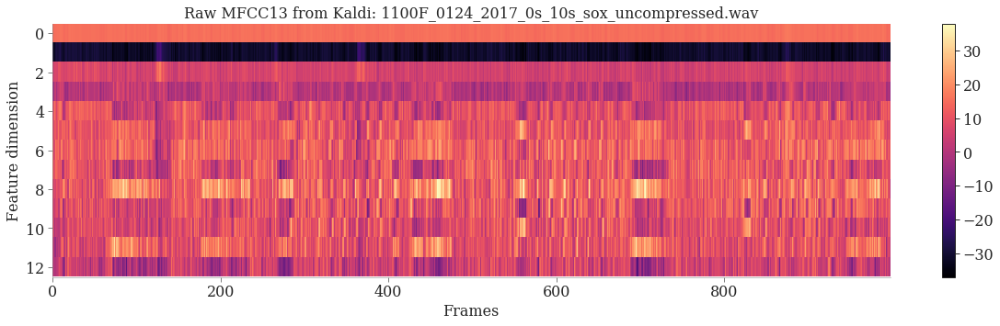

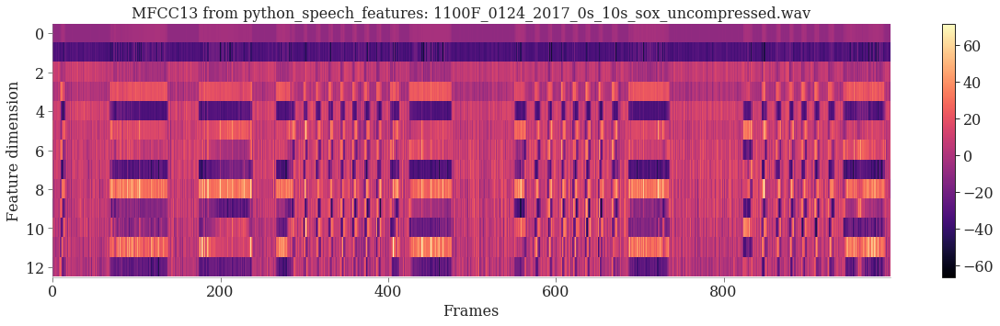

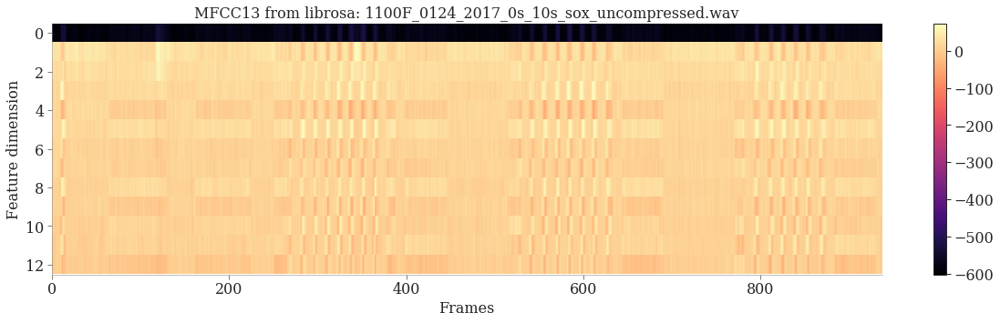

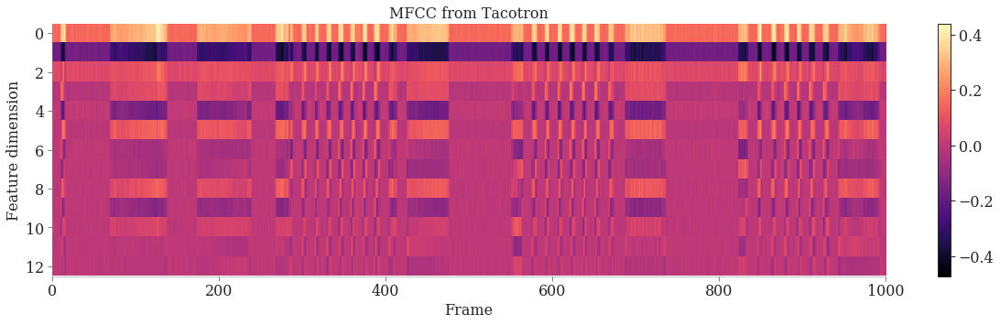

In [24]:
import python_speech_features
import librosa

feat_matrix = raw_mfcc13_feats[utt_key].T
title="Raw MFCC13 from Kaldi: {}".format(os.path.basename(path))
fig =plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = fig.add_subplot(111)
image = ax.imshow(feat_matrix, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'
ax.set_xlabel("Frames")
ax.set_ylabel("Feature dimension".format(title))
ax.set_title(title)
plt.tight_layout()
format_axes(ax)
plt.colorbar(image, ax=ax)

wav, sampling_rate = librosa.load(path, sr=sampling_rate)
feat = python_speech_features.mfcc(wav, samplerate=sampling_rate, appendEnergy=True)

title="MFCC13 from python_speech_features: {}".format(os.path.basename(path))
feat_matrix  = feat.T
fig =plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = fig.add_subplot(111)
image = ax.imshow(feat_matrix, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'
ax.set_xlabel("Frames")
ax.set_ylabel("Feature dimension".format(title))
ax.set_title(title)
plt.tight_layout()
format_axes(ax)
plt.colorbar(image, ax=ax)

wav, sampling_rate = librosa.load(path, sr=sampling_rate)
feat = librosa.feature.mfcc(wav, sr=sampling_rate, n_mfcc=13, dct_type=2, norm='ortho')

title="MFCC13 from librosa: {}".format(os.path.basename(path))
feat_matrix  = feat
fig =plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = fig.add_subplot(111)
image = ax.imshow(feat_matrix, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'
ax.set_xlabel("Frames")
ax.set_ylabel("Feature dimension".format(title))
ax.set_title(title)
plt.tight_layout()
format_axes(ax)
plt.colorbar(image, ax=ax)

logmel = librosa_spectrum_tacotron3(path=path, n_fft=2048, sampling_rate=sampling_rate,  window_size_ms=25, window_shift_ms=10, spectrum_type="linear", title=title, center=True, ref_db=20, preemphasis=0.97, mel=mel, min_db=-100, verbose=False)
mfcc = librosa.feature.mfcc(sr=sampling_rate, S=logmel, n_mfcc=13, dct_type=2, norm='ortho', lifter=0)
draw_matrix(mfcc, title="MFCC from Tacotron", xlabel="Frame", ylabel="Feature dimension",origin="upper",  colorbar=True, figsize=(14*1.2, 4.2*1.2))

shape of wav: (480000,)
shape of STFT: (257, 3747) (n_fft = (num_freq - 1) * 2) = (257 - 1) * 2) = 512)
window size (win_length) for STFT: 512
window shift (hop_length) for STFT: 128
center=False, padding ignored; the first frame begins at the origin (the D[:, t] begins at signal y[t * hop_length]).
number of samples: 480000; samples processed by STFT, including padding, is
window_size + window_shift * (num_frames - 1) = 512 + 128 * (3747 - 1) = 480000



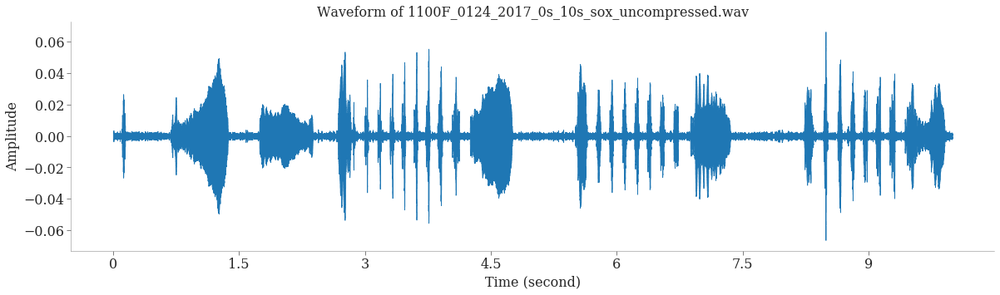

<Figure size 1209.6x362.88 with 0 Axes>

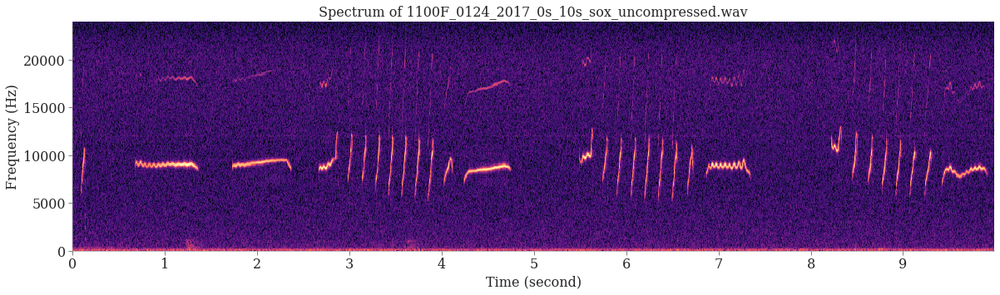

In [25]:
import numpy as np
import matplotlib.pyplot as plt

import librosa
import librosa.display

title = "Waveform of {}".format(os.path.basename(path))
fig = plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = fig.add_subplot(111)
wav, sampling_rate = librosa.load(path, sr=sampling_rate)
librosa.display.waveshow(wav, x_axis='s', sr=sampling_rate)
ax.set_xlabel("Time (second)")
ax.set_ylabel("Amplitude")
ax.set_title(title)
plt.tight_layout()
format_axes(ax)

title = "Spectrum of {}".format(os.path.basename(path))
plt.figure(figsize=(14*1.2, 4.2*1.2))
librosa_spectrum(path, title=title, spectrum_type=spectrum_type)

# MFCC: MFCC40, and MFCC+Delta+Delta

shape of wav: (480000,)
shape of STFT: (257, 3747) (n_fft = (num_freq - 1) * 2) = (257 - 1) * 2) = 512)
window size (win_length) for STFT: 512
window shift (hop_length) for STFT: 128
center=False, padding ignored; the first frame begins at the origin (the D[:, t] begins at signal y[t * hop_length]).
number of samples: 480000; samples processed by STFT, including padding, is
window_size + window_shift * (num_frames - 1) = 512 + 128 * (3747 - 1) = 480000



<Figure size 1209.6x362.88 with 0 Axes>

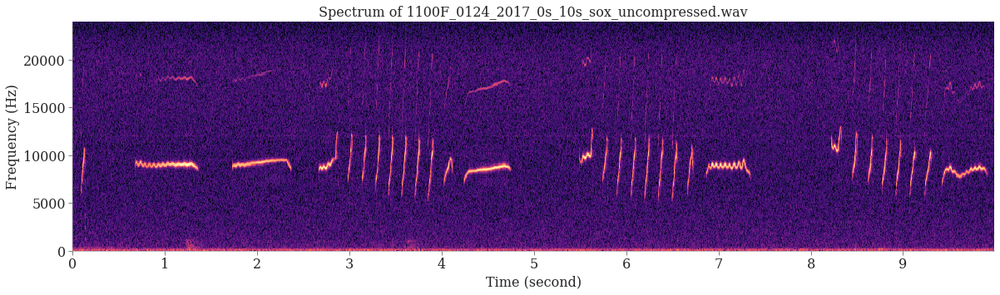

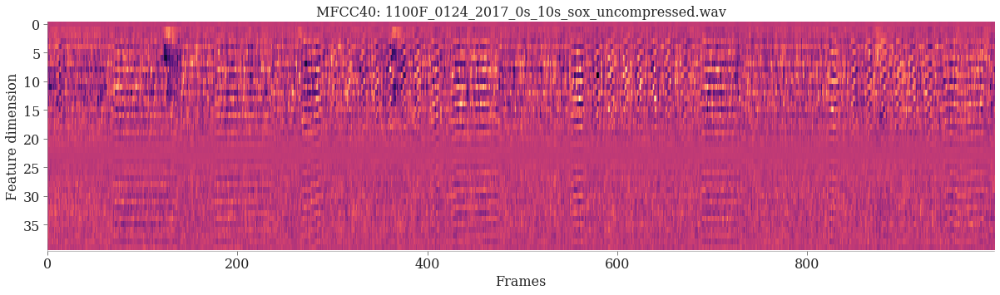

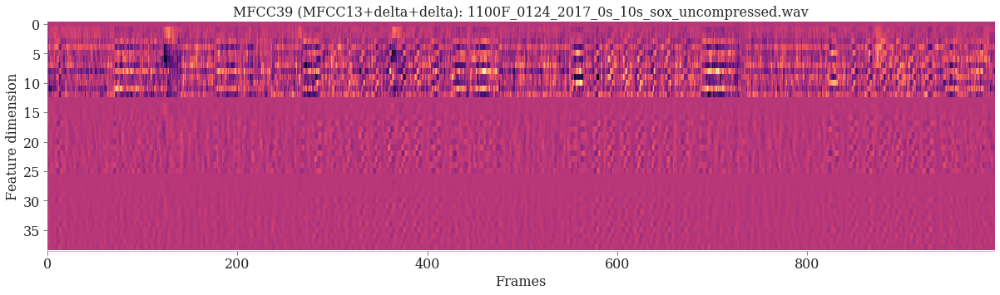

In [26]:
# https://librosa.org/doc/main/auto_examples/plot_display.html
import numpy as np
import matplotlib.pyplot as plt

import librosa
import librosa.display

title = "Spectrum of {}".format(os.path.basename(path))
plt.figure(figsize=(14*1.2, 4.2*1.2))
librosa_spectrum(path=path, n_fft=n_fft, sampling_rate=sampling_rate, spectrum_type=spectrum_type, title=title)

feat_matrix = mfcc40_feats[utt_key].T
title="MFCC40: {}".format(os.path.basename(path))
fig =plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = fig.add_subplot(111)
ax.imshow(feat_matrix, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'
ax.set_xlabel("Frames")
ax.set_ylabel("Feature dimension".format(title))
ax.set_title(title)
plt.tight_layout()
format_axes(ax)

feat_matrix = mfcc39_feats[utt_key].T
title="MFCC39 (MFCC13+delta+delta): {}".format(os.path.basename(path))
fig =plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = fig.add_subplot(111)
ax.imshow(feat_matrix, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'
ax.set_xlabel("Frames")
ax.set_ylabel("Feature dimension".format(title))
ax.set_title(title)
plt.tight_layout()
format_axes(ax)

# Mel: Mel80, mel80+delta+delta

shape of wav: (480000,)
shape of STFT: (257, 3747) (n_fft = (num_freq - 1) * 2) = (257 - 1) * 2) = 512)
window size (win_length) for STFT: 512
window shift (hop_length) for STFT: 128
center=False, padding ignored; the first frame begins at the origin (the D[:, t] begins at signal y[t * hop_length]).
number of samples: 480000; samples processed by STFT, including padding, is
window_size + window_shift * (num_frames - 1) = 512 + 128 * (3747 - 1) = 480000

shape of wav: (480000,)
shape of STFT: (257, 3747) (n_fft = (num_freq - 1) * 2) = (257 - 1) * 2) = 512)
window size (win_length) for STFT: 512
window shift (hop_length) for STFT: 128
center=False, padding ignored; the first frame begins at the origin (the D[:, t] begins at signal y[t * hop_length]).
number of samples: 480000; samples processed by STFT, including padding, is
window_size + window_shift * (num_frames - 1) = 512 + 128 * (3747 - 1) = 480000



<Figure size 1209.6x362.88 with 0 Axes>

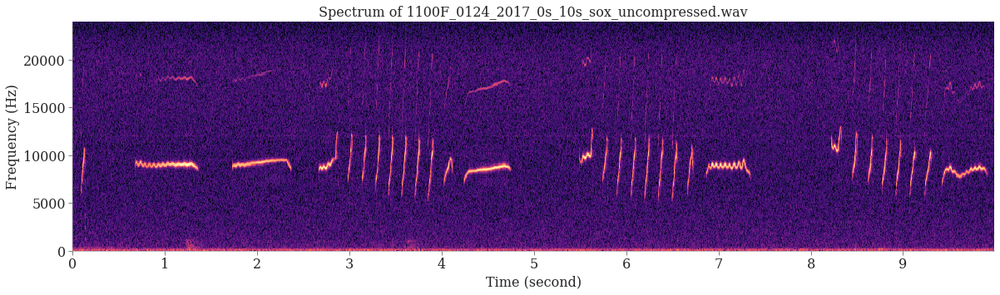

<Figure size 1209.6x362.88 with 0 Axes>

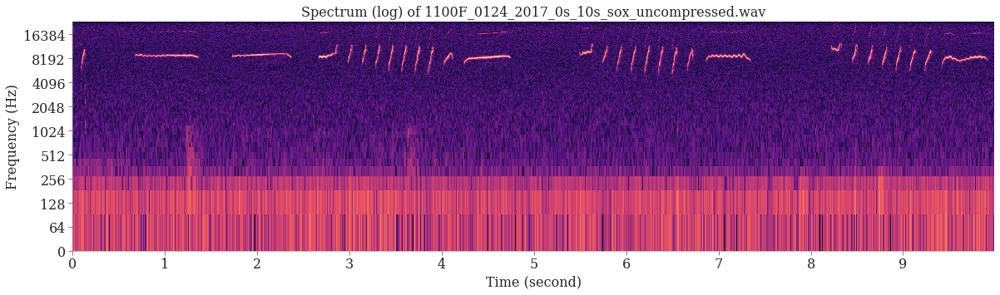

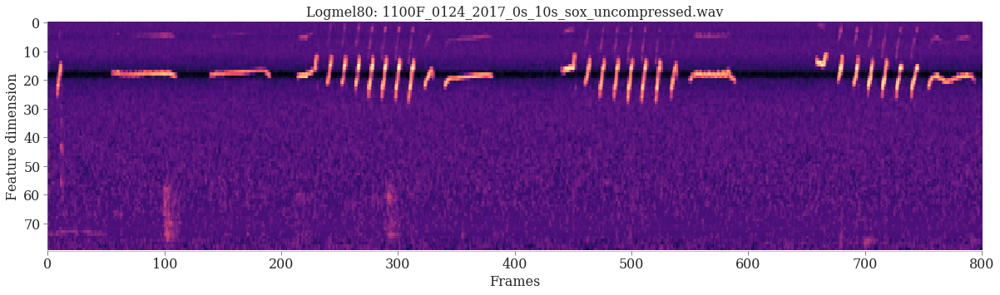

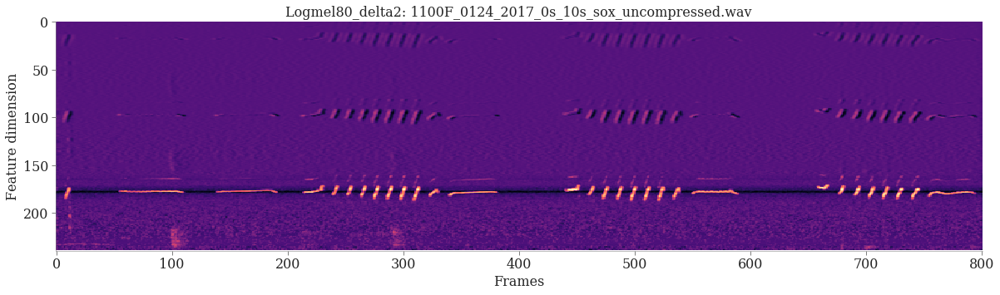

In [27]:
# https://librosa.org/doc/main/auto_examples/plot_display.html
import numpy as np
import matplotlib.pyplot as plt

import librosa
import librosa.display

title = "Spectrum of {}".format(os.path.basename(path))
plt.figure(figsize=(14*1.2, 4.2*1.2))
librosa_spectrum(path, title=title, spectrum_type=spectrum_type)

title = "Spectrum (log) of {}".format(os.path.basename(path))
plt.figure(figsize=(14*1.2, 4.2*1.2))
librosa_spectrum(path, title=title, spectrum_type="log")

feat_matrix = np.flip(mel80_feats[utt_key].T, axis=0)
title="Logmel80: {}".format(os.path.basename(path))
fig =plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = fig.add_subplot(111)
ax.imshow(feat_matrix, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'
ax.set_xlabel("Frames")
ax.set_ylabel("Feature dimension".format(title))
ax.set_title(title)
plt.tight_layout()
format_axes(ax)

feat_matrix = np.flip(mel80_delta2_feats[utt_key].T, axis=0)
title="Logmel80_delta2: {}".format(os.path.basename(path))
fig =plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = fig.add_subplot(111)
ax.imshow(feat_matrix, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'
ax.set_xlabel("Frames")
ax.set_ylabel("Feature dimension".format(title))
ax.set_title(title)
plt.tight_layout()
format_axes(ax)

# Mel13, mel13+delta+delta, MFCC80 (options might have problem)

shape of wav: (480000,)
shape of STFT: (257, 3747) (n_fft = (num_freq - 1) * 2) = (257 - 1) * 2) = 512)
window size (win_length) for STFT: 512
window shift (hop_length) for STFT: 128
center=False, padding ignored; the first frame begins at the origin (the D[:, t] begins at signal y[t * hop_length]).
number of samples: 480000; samples processed by STFT, including padding, is
window_size + window_shift * (num_frames - 1) = 512 + 128 * (3747 - 1) = 480000



<Figure size 1209.6x362.88 with 0 Axes>

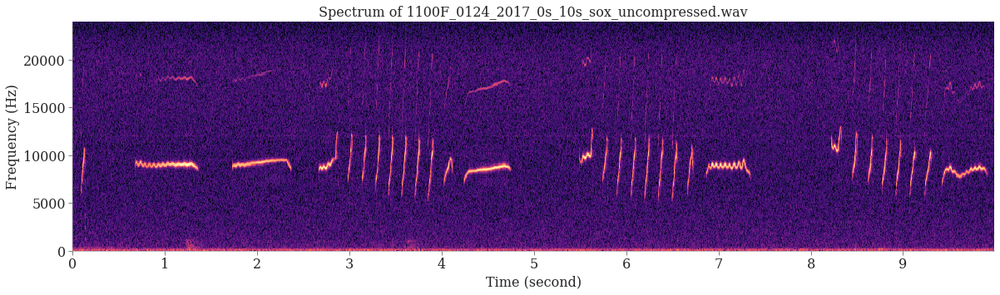

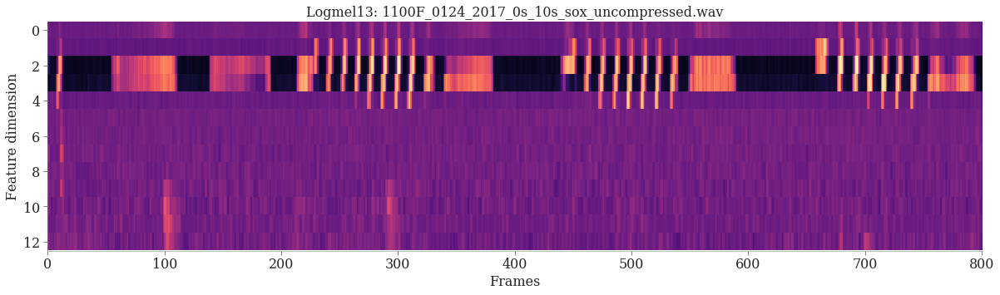

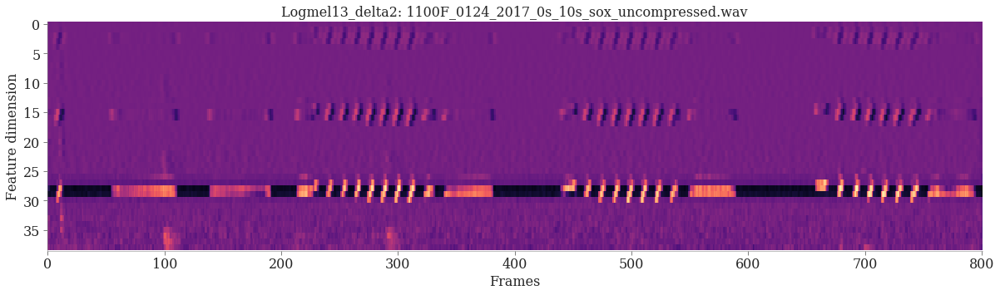

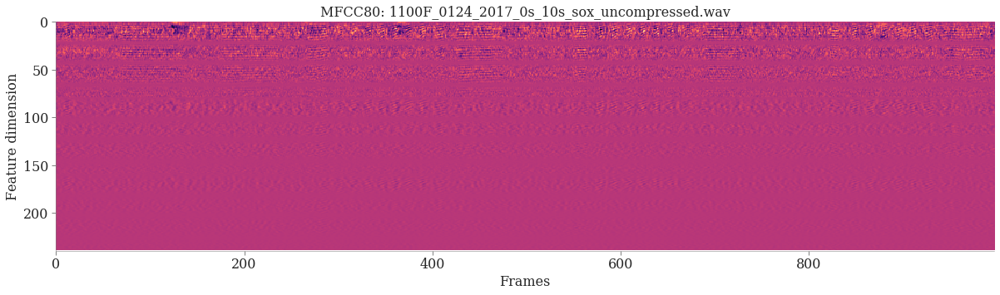

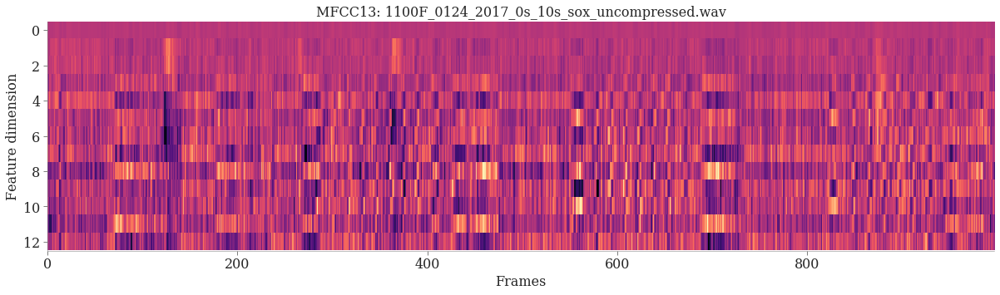

In [28]:
# https://librosa.org/doc/main/auto_examples/plot_display.html
import numpy as np
import matplotlib.pyplot as plt

import librosa
import librosa.display

title = "Spectrum of {}".format(os.path.basename(path))
plt.figure(figsize=(14*1.2, 4.2*1.2))
librosa_spectrum(path, title=title, spectrum_type=spectrum_type)

feat_matrix = np.flip(mel13_feats[utt_key].T, axis=0)
title="Logmel13: {}".format(os.path.basename(path))
fig =plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = fig.add_subplot(111)
ax.imshow(feat_matrix, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'
ax.set_xlabel("Frames")
ax.set_ylabel("Feature dimension".format(title))
ax.set_title(title)
plt.tight_layout()
format_axes(ax)

feat_matrix = np.flip(mel39_feats[utt_key].T, axis=0)
title="Logmel13_delta2: {}".format(os.path.basename(path))
fig =plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = fig.add_subplot(111)
ax.imshow(feat_matrix, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'
ax.set_xlabel("Frames")
ax.set_ylabel("Feature dimension".format(title))
ax.set_title(title)
plt.tight_layout()
format_axes(ax)

feat_matrix = mfcc80_feats[utt_key].T
title="MFCC80: {}".format(os.path.basename(path))
fig =plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = fig.add_subplot(111)
ax.imshow(feat_matrix, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'
ax.set_xlabel("Frames")
ax.set_ylabel("Feature dimension".format(title))
ax.set_title(title)
plt.tight_layout()
format_axes(ax)

feat_matrix = mfcc13_feats[utt_key].T
title="MFCC13: {}".format(os.path.basename(path))
fig =plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = fig.add_subplot(111)
ax.imshow(feat_matrix, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'
ax.set_xlabel("Frames")
ax.set_ylabel("Feature dimension".format(title))
ax.set_title(title)
plt.tight_layout()
format_axes(ax)

# Comparison Delta+Delta from kaldi python_speech_feature and librosa

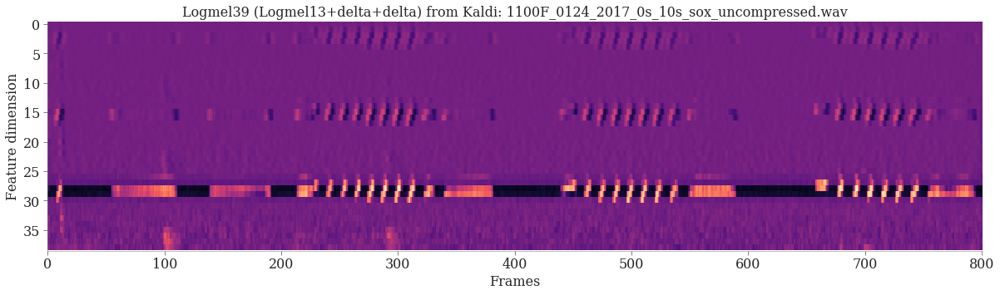

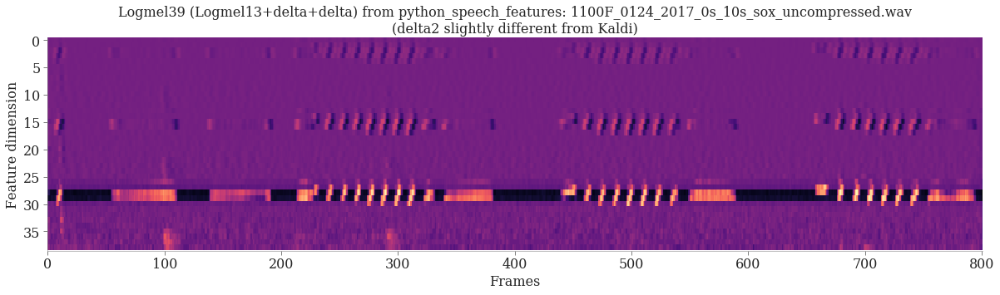

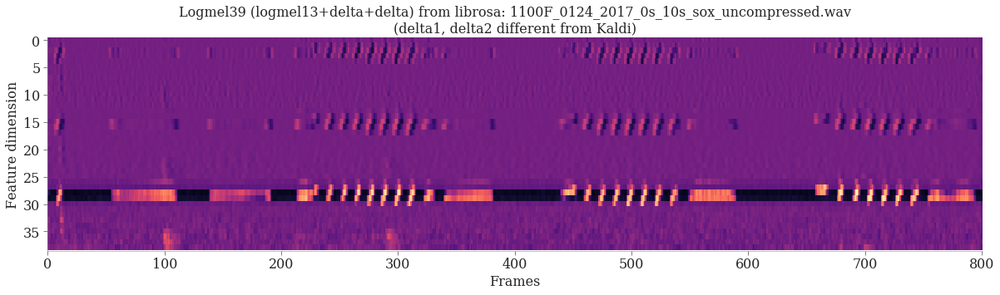

In [29]:
# in kaldi  --delta-window              : Parameter controlling window for delta computation (actual window size for each delta order is 1 + 2*delta-window-size) (int, default = 2)
librosa_delta_delta = np.concatenate([mel13_feats["1100F_0124_2017_0s_10s"].T, librosa.feature.delta(mel13_feats["1100F_0124_2017_0s_10s"].T, width=5, order=1), librosa.feature.delta(mel13_feats["1100F_0124_2017_0s_10s"].T, width=5, order=2)])

import python_speech_features
feat = mel13_feats["1100F_0124_2017_0s_10s"]
feat_delta = python_speech_features.base.delta(feat, N=2)
feat_delta2 = python_speech_features.base.delta(feat_delta, N=2)
python_speech_features_delta_delta = np.concatenate([mel13_feats[utt_key], feat_delta, feat_delta2], axis=1)

feat_matrix = np.flip(mel39_feats[utt_key].T, axis=0)
title="Logmel39 (Logmel13+delta+delta) from Kaldi: {}".format(os.path.basename(path))
fig = plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = fig.add_subplot(111)
ax.imshow(feat_matrix, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'
ax.set_xlabel("Frames")
ax.set_ylabel("Feature dimension".format(title))
ax.set_title(title)
plt.tight_layout()
format_axes(ax)

feat_matrix = np.flip(python_speech_features_delta_delta.T, axis=0)
title="Logmel39 (Logmel13+delta+delta) from python_speech_features: {}\n(delta2 slightly different from Kaldi)".format(os.path.basename(path))
fig = plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = fig.add_subplot(111)
ax.imshow(feat_matrix, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'
ax.set_xlabel("Frames")
ax.set_ylabel("Feature dimension".format(title))
ax.set_title(title)
plt.tight_layout()
format_axes(ax)

feat_matrix = np.flip(librosa_delta_delta, axis=0)
title="Logmel39 (logmel13+delta+delta) from librosa: {}\n(delta1, delta2 different from Kaldi)".format(os.path.basename(path))
fig = plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = fig.add_subplot(111)
ax.imshow(feat_matrix, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'
ax.set_xlabel("Frames")
ax.set_ylabel("Feature dimension".format(title))
ax.set_title(title)
plt.tight_layout()
format_axes(ax)

# Comparison CMVN Kaldi vs. python

shape of wav: (480000,)
shape of STFT: (257, 3747) (n_fft = (num_freq - 1) * 2) = (257 - 1) * 2) = 512)
window size (win_length) for STFT: 512
window shift (hop_length) for STFT: 128
center=False, padding ignored; the first frame begins at the origin (the D[:, t] begins at signal y[t * hop_length]).
number of samples: 480000; samples processed by STFT, including padding, is
window_size + window_shift * (num_frames - 1) = 512 + 128 * (3747 - 1) = 480000

[ 0.02889863  0.0251256   0.02321556  0.02796126  0.00919403  0.04099619
 -0.02597361 -0.01869854 -0.03258064 -0.13692695 -0.07848398 -0.0365949
 -0.04052404]
[ 0.02889868  0.02512559  0.02321557  0.02796128  0.00919399  0.04099621
 -0.02597367 -0.01869853 -0.03258064 -0.13692704 -0.07848401 -0.03659491
 -0.04052395]


<Figure size 1209.6x362.88 with 0 Axes>

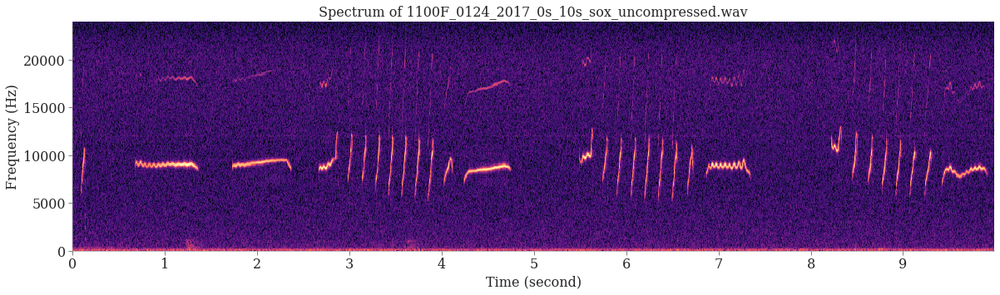

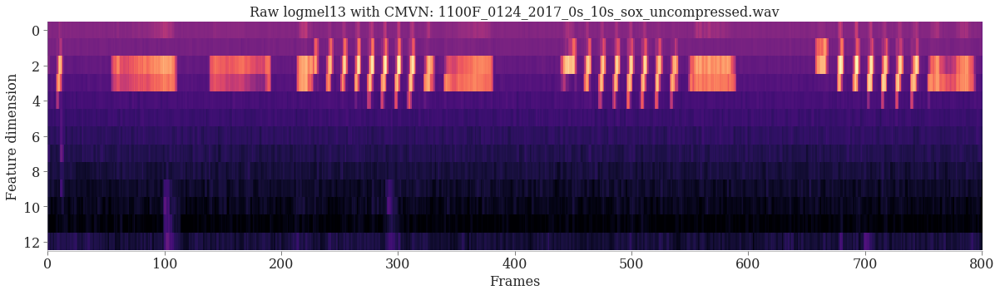

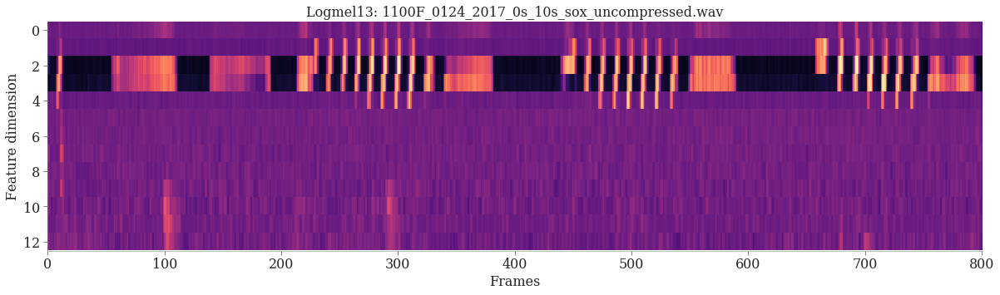

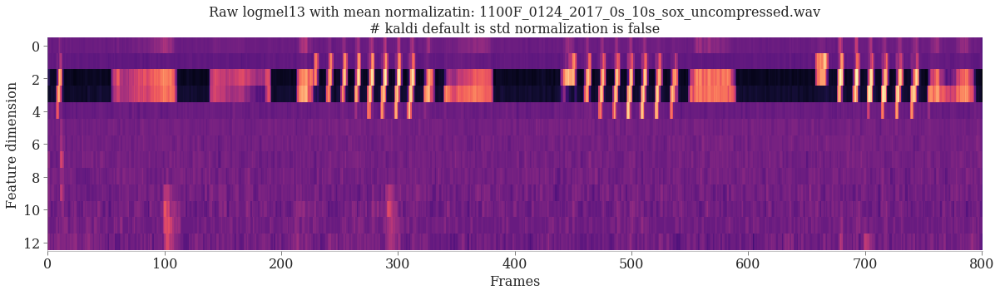

In [30]:
# https://librosa.org/doc/main/auto_examples/plot_display.html
import numpy as np
import matplotlib.pyplot as plt

import librosa
import librosa.display

title = "Spectrum of {}".format(os.path.basename(path))
plt.figure(figsize=(14*1.2, 4.2*1.2))
librosa_spectrum(path, title=title, spectrum_type=spectrum_type)

feat_matrix = np.flip(raw_mel13_feats[utt_key].T, axis=0)
title="Raw logmel13 with CMVN: {}".format(os.path.basename(path))
fig =plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = fig.add_subplot(111)
ax.imshow(feat_matrix, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'
ax.set_xlabel("Frames")
ax.set_ylabel("Feature dimension".format(title))
ax.set_title(title)
plt.tight_layout()
format_axes(ax)

feat_matrix = np.flip(mel13_feats[utt_key].T, axis=0)
title="Logmel13: {}".format(os.path.basename(path))
fig =plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = fig.add_subplot(111)
ax.imshow(feat_matrix, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'
ax.set_xlabel("Frames")
ax.set_ylabel("Feature dimension".format(title))
ax.set_title(title)
plt.tight_layout()
format_axes(ax)

feat = raw_mel13_feats[utt_key] # shape (num_frames, feat_dim)
feat_cmvn = feat - feat.mean(axis=0) # kaldi default is std normalization is false
feat_matrix = np.flip(feat_cmvn.T, axis=0)
title="Raw logmel13 with mean normalizatin: {}\n# kaldi default is std normalization is false".format(os.path.basename(path))
fig =plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = fig.add_subplot(111)
ax.imshow(feat_matrix, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'
ax.set_xlabel("Frames")
ax.set_ylabel("Feature dimension".format(title))
ax.set_title(title)
plt.tight_layout()
format_axes(ax)

print(mel13_feats[utt_key][0])
feat = raw_mel13_feats[utt_key] # shape (num_frames, feat_dim)
feat_cmvn = feat - feat.mean(axis=0) # kaldi default is std normalization is false
print(feat_cmvn[0])

# Test highpass filter

In [31]:
import numpy as np
import librosa
import librosa.filters
import soundfile
import math
import warnings
from scipy import signal

# Modified by bin-wu from the class TacotronHelper (andros)
class TacotronAudio() :
    def __init__(self, config={"num_mels":80,
                               "sample_rate":16000,
                               "frame_length_ms":50,
                               "frame_shift_ms":12.5}) :
        """
        Feature processing of audios by Tacotron, including the methods 
        such as load_wav, save_wav, melspectrogram, spectrogram, inv_spectrogram...

        Parameters
        ---------
        config: a dictionary of feature configuration. You can pass a new dict to update the default configuration
        Default as following:
        {"pkg":"taco",
        "type":"mel",
        "num_mels":80,
        "num_freq":1025,
        "sample_rate":16000,
        "frame_length_ms":50,
        "frame_shift_ms":12.5,
        "preemphasis":0.97,
        "min_level_db":-100,
        "ref_level_db":20,
        "griffin_lim_iters":60,
        "power":1.5}
        """
        default_config = {"pkg":"taco",
                          "type":"mel",
                          "num_mels":80,
                          "num_freq":1025,
                          "sample_rate":16000,
                          "frame_length_ms":50,
                          "frame_shift_ms":12.5,
                          "preemphasis":0.97,
                          "min_level_db":-100,
                          "ref_level_db":20,
                          "griffin_lim_iters":60,
                          "power":1.5}
        default_config.update(config)
        self.config = default_config

    def load_wav(self, path, begin_sec=None, end_sec=None):
        """
        Load a wav file or its segment.

        Parameters
        ----------
        path: the path of the audio
        begin_sec: the beginning time (in second) of the segment of the audio
        end_sec: the end time (in second) of the segment of the audio
        
        Returns
        -------
        the data of wav file or the data of its segment
        """
        wav = librosa.core.load(path, sr=self.config['sample_rate'])[0]
        if begin_sec is None and end_sec is None: return wav
        else:
            if begin_sec is None: begin_index = 0
            if end_sec is None: end_index = len(wav)
            assert begin_sec < end_sec, "the begin time of the segment should be less than the end time."
            begin_index = max(int(begin_sec * self.config['sample_rate']), 0)
            end_index = min(int(end_sec * self.config['sample_rate']), len(wav))

            return wav[begin_index:end_index]

    def save_wav(self, wav, path) :
        """
        save a waveform data to an audio file at path.

        Parameters
        ----------
        path: the path of the audio
        """
        wav *= 32767 / max(0.01, np.max(np.abs(wav)))
        try :
            librosa.output.write_wav(path, wav.astype(np.int16), self.config['sample_rate'])
        except :
            soundfile.write(path, wav.astype(np.int16), self.config['sample_rate'])

    def spectrogram(self, y):
        """
        Convert a waveform to its spectrogram
        
        Parameters
        ----------
        y: the waveform [num_samples]
        
        Returns
        -------
        the spectrogram [num_freq, num_frames] (Note: num_frames is computed by padded signal in librosa's stft, so approximated by num_samples / num_samples_of_a_frame_shift)
        """
        D = self._stft(self.preemphasis(y))
        S = self._amp_to_db(np.abs(D)) - self.config['ref_level_db']
        return self._normalize(S)

    def inv_spectrogram(self, spectrogram):
        """Convert a spectrogram to its waveform using librosa, paired with spectrogram function.
        
        Parameters
        ----------
        spectrogram: the spectrogram [num_freq, num_frames]

        Returns
        ---------
        waveform [num_samples] (Note: the num_samples may not equals to original signal due to padding at stft transformation)
        """
        S = self._db_to_amp(self._denormalize(spectrogram) + self.config['ref_level_db']) # Convert back to linear
        return self.inv_preemphasis(self._griffin_lim(S ** self.config['power'])) # Reconstruct phase

    def melspectrogram(self, y):
        """
        Convert a wavform to its melspectrogram.
        
        Parameters
        ----------
        y: the waveform [num_samples]
        
        Returns
        -------
        the melspectrogram of the waveform [num_mels, num_frames] (Note: num_frames is computed by padded signal in librosa's stft, so approximated by num_samples / num_samples_of_a_frame_shift)
        """
        D = self._stft(self.preemphasis(y))
        S = self._amp_to_db(self._linear_to_mel(np.abs(D))) - self.config['ref_level_db']
        return self._normalize(S)

    def preemphasis(self, x):
        return signal.lfilter([1, -self.config['preemphasis']], [1], x)

    def inv_preemphasis(self, x):
        return signal.lfilter([1], [1, -self.config['preemphasis']], x)

    def _griffin_lim(self, S):
        '''librosa implementation of Griffin-Lim
        Based on https://github.com/librosa/librosa/issues/434
        '''
        angles = np.exp(2j * np.pi * np.random.rand(*S.shape))
        S_complex = np.abs(S).astype(np.complex)
        y = self._istft(S_complex * angles)
        for i in range(self.config['griffin_lim_iters']):
            angles = np.exp(1j * np.angle(self._stft(y)))
            y = self._istft(S_complex * angles)
        return y

    def _stft(self, y):
        n_fft, hop_length, win_length = self._stft_parameters()
        return librosa.stft(y=y, n_fft=n_fft, hop_length=hop_length, win_length=win_length)

    def _istft(self, y):
        _, hop_length, win_length = self._stft_parameters()
        return librosa.istft(y, hop_length=hop_length, win_length=win_length)

    def _stft_parameters(self):
        n_fft = (self.config['num_freq'] - 1) * 2
        hop_length = int(self.config['frame_shift_ms'] / 1000 * self.config['sample_rate'])
        win_length = int(self.config['frame_length_ms'] / 1000 * self.config['sample_rate'])
        return n_fft, hop_length, win_length

    # Conversions:
    def _linear_to_mel(self, spectrogram):
        _mel_basis = None
        if _mel_basis is None:
            _mel_basis = self._build_mel_basis()
        return np.dot(_mel_basis, spectrogram)

    def _build_mel_basis(self):
        n_fft = (self.config['num_freq'] - 1) * 2
        return librosa.filters.mel(sr=self.config['sample_rate'], n_fft=n_fft, n_mels=self.config['num_mels'])

    def _amp_to_db(self, x):
        return 20 * np.log10(np.maximum(1e-5, x))

    def _db_to_amp(self, x):
        return np.power(10.0, x * 0.05)

    def _normalize(self, S):
        return np.clip((S - self.config['min_level_db']) / -self.config['min_level_db'], 0, 1)

    def _denormalize(self, S):
        return (np.clip(S, 0, 1) * -self.config['min_level_db']) + self.config['min_level_db']


In [32]:
config_taco_mel_f13_sr48000 = {
    "pkg":"taco",
    "type":"mel",
    "num_mels":13,
    "num_freq":2048,
    "sample_rate":48000,
    "frame_length_ms":50,
    "frame_shift_ms":12.5,
    "preemphasis":0.97,
    "min_level_db":-100,
    "ref_level_db":20,
    "griffin_lim_iters":60,
    "power":1.5
}

taudio = TacotronAudio(config_taco_mel_f13_sr48000)
wav = taudio.load_wav(path)
raw_mel13_taco = taudio.melspectrogram(wav).T # shape (num_frames, num_mels)
mel13_taco_feats = raw_mel13_taco - raw_mel13_taco.mean(axis=0) # cmvn by subtracting mean, default to kaldi




shape of wav: (480000,)
shape of STFT: (257, 3747) (n_fft = (num_freq - 1) * 2) = (257 - 1) * 2) = 512)
window size (win_length) for STFT: 512
window shift (hop_length) for STFT: 128
center=False, padding ignored; the first frame begins at the origin (the D[:, t] begins at signal y[t * hop_length]).
number of samples: 480000; samples processed by STFT, including padding, is
window_size + window_shift * (num_frames - 1) = 512 + 128 * (3747 - 1) = 480000

shape of wav: (480000,)
shape of STFT: (257, 3747) (n_fft = (num_freq - 1) * 2) = (257 - 1) * 2) = 512)
window size (win_length) for STFT: 512
window shift (hop_length) for STFT: 128
center=False, padding ignored; the first frame begins at the origin (the D[:, t] begins at signal y[t * hop_length]).
number of samples: 480000; samples processed by STFT, including padding, is
window_size + window_shift * (num_frames - 1) = 512 + 128 * (3747 - 1) = 480000

[ 0.02889863  0.0251256   0.02321556  0.02796126  0.00919403  0.04099619
 -0.0259736

<Figure size 1209.6x362.88 with 0 Axes>

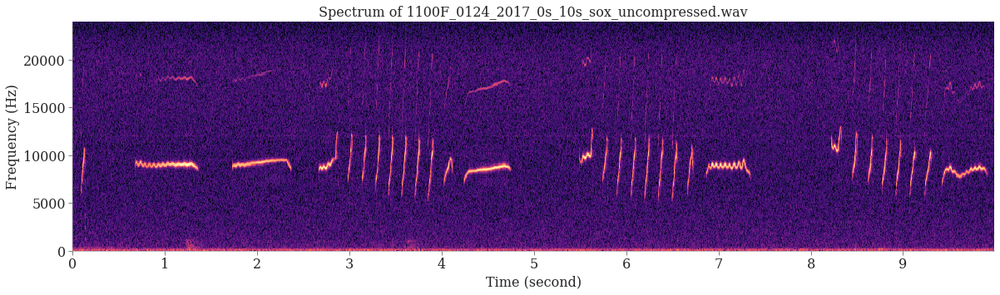

<Figure size 1209.6x362.88 with 0 Axes>

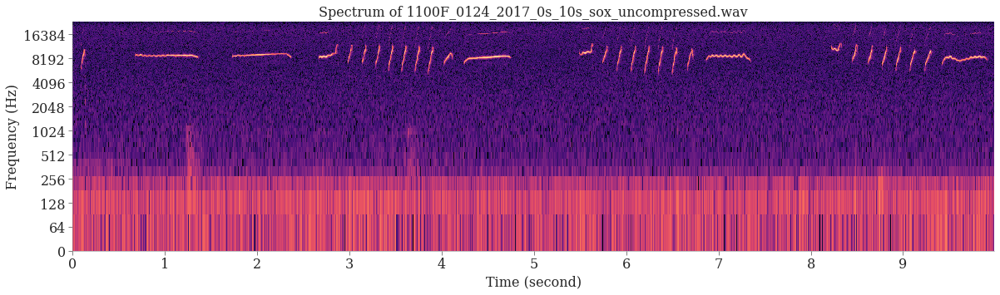

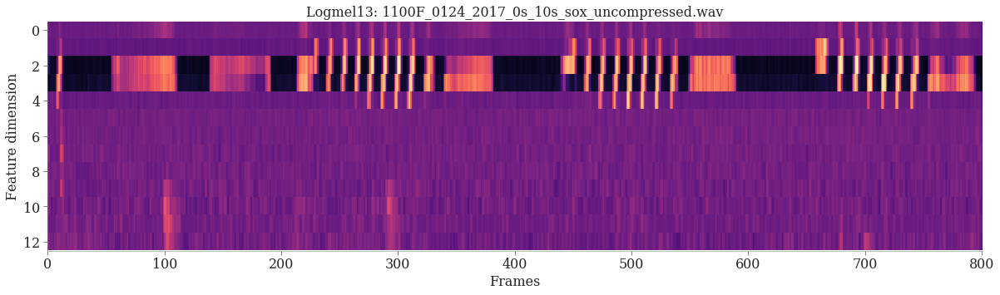

In [33]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt

import librosa
import librosa.display

title = "Spectrum of {}".format(os.path.basename(path))
plt.figure(figsize=(14*1.2, 4.2*1.2))
librosa_spectrum(path, title=title, spectrum_type="linear")

title = "Spectrum of {}".format(os.path.basename(path))
plt.figure(figsize=(14*1.2, 4.2*1.2))
librosa_spectrum(path, title=title, spectrum_type="log")

config_taco_mel_f13_sr48000 = {
    "pkg":"taco",
    "type":"mel",
    "num_mels":13,
    "num_freq":2048,
    "sample_rate":48000,
    "frame_length_ms":50,
    "frame_shift_ms":12.5,
    "preemphasis":0.97,
    "min_level_db":-100,
    "ref_level_db":20,
    "griffin_lim_iters":60,
    "power":1.5
}

taudio = TacotronAudio(config_taco_mel_f13_sr48000)
wav = taudio.load_wav(path)
raw_mel13_taco = taudio.melspectrogram(wav).T # shape (num_frames, num_mels)
mel13_taco_feats = raw_mel13_taco - raw_mel13_taco.mean(axis=0) # cmvn by subtracting mean, default to kaldi
print(mel13_feats[utt_key][0])
print(mel13_taco_feats[0])

feat_matrix = np.flip(mel13_taco_feats.T, axis=0)
title="Logmel13: {}".format(os.path.basename(path))
fig =plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = fig.add_subplot(111)
ax.imshow(feat_matrix, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'
ax.set_xlabel("Frames")
ax.set_ylabel("Feature dimension".format(title))
ax.set_title(title)
plt.tight_layout()
format_axes(ax)

In [34]:
def DPGMM1(alpha, mu0, lmbda, Sigma0, nu, sources, K0, num_iterations, verbose=True):
    %matplotlib notebook
    from scipy.stats import multivariate_normal

    z = np.random.choice(K0, len(sources))
    niw_sampler = NormalInverseWishartDistribution(mu0, lmbda, nu, Sigma0)

    # Plot the the initial state of network.
    plt.ion() # Turn on the interactive mode.
    fig = plt.figure(figsize=(6,4))
    ax = fig.add_subplot(111)

    def display_cluster(sources, preds, ax, iteration):
        ax.clear()
        ax.set_title("Iteration {}".format(iteration))
        colors = np.array(list(islice(cycle(['#377eb8', '#ff7f00', '#4daf4a',
                                         '#f781bf', '#a65628', '#984ea3',
                                         '#999999', '#e41a1c', '#dede00']),
                                  int(max(preds) + 1))))
        ax.scatter(sources[:, 0], sources[:, 1], s=10, color=colors[preds])

        fig.canvas.draw()
        fig.canvas.flush_events()



    for iteration in range(num_iterations):
        # sample weights
        clusters, counts = np.unique(z, return_counts=True)
        if verbose: print(f"clusters: {clusters}")
        clusters = np.append(clusters, [clusters.max() + 1]) # 1,....,K, K+1 --- not empty clusters + possible new cluster
        counts = np.append(counts, [alpha]) # n_1,.., n_K, n_{K+1}
        weights = np.random.dirichlet(counts)

        # sample mean and covariance
        parameters = []
        for cluster in clusters[:-1]: # exclude the new K+1 cluster
            parameters.append(niw_sampler.posterior(sources[z==cluster]).sample())
        parameters.append(niw_sampler.sample()) # sample for the K+1 cluster
        means, covs = list(zip(*parameters))

        # sample z
        num_clusters = len(clusters) # number of not empty clusters and possible new one
        num_sources = len(sources)
        assert (len(clusters) == len(means) == len(covs) == len(weights))

#         updated_z = []
#         for i in range(num_sources):
#             z_posterior = []
#             for k in range(num_clusters):
#                 z_posterior.append(scipy.stats.multivariate_normal.pdf(sources[i], mean=means[k], cov=covs[k]) * weights[k])
#             z_posterior = np.array(z_posterior)
#             z_posterior = z_posterior / z_posterior.sum()
#             updated_z.append(np.random.choice(clusters, p=z_posterior))

        z_posterior = []
        for k in range(num_clusters):
            z_posterior.append((multivariate_normal.pdf(sources, mean=means[k], cov=covs[k]) * weights[k]).reshape(-1, 1))
        z_posterior = np.concatenate(z_posterior, axis=1)
        z_posterior = z_posterior / z_posterior.sum(axis=1).reshape(-1, 1)
        
        updated_z = []
        for i in range(num_sources):
            updated_z.append(np.random.choice(clusters, p=z_posterior[i]))

        # update z
        z = np.array(updated_z)
        display_cluster(sources, z, ax, iteration)

In [160]:
from typing import Optional

import os
import sys
import argparse
import logging
logging.basicConfig(stream=sys.stdout,level=logging.INFO, format="[ %(asctime)s | %(filename)s | %(levelname)s ] %(message)s", datefmt="%d/%m/%Y %H:%M:%S")

import numpy as np
from scipy.stats import chi2
from scipy.stats import multivariate_normal

# https://en.wikipedia.org/wiki/Inverse-Wishart_distribution
class NormalInverseWishartDistribution(object):
    def __init__(self, mu, lmbda, nu, psi):
        self.mu = mu
        self.lmbda = float(lmbda)
        self.nu = nu
        self.psi = psi
        self.inv_psi = np.linalg.inv(psi)

    def sample(self):
        sigma = np.linalg.inv(self.wishartrand())
        return (np.random.multivariate_normal(self.mu, sigma / self.lmbda), sigma)

    def wishartrand(self):
        dim = self.inv_psi.shape[0]

        # ###
        # def check_symmetric(a, rtol=1e-05, atol=1e-08):
        #     return np.allclose(a, a.T, rtol=rtol, atol=atol)
        # print(self.psi)
        # print(self.inv_psi)
        # print(check_symmetric(self.psi))
        # print(check_symmetric(self.inv_psi))
        # print(np.linalg.eigvals(self.psi))
        # print(np.linalg.eigvals(self.inv_psi))
        # ###

        chol = np.linalg.cholesky(self.inv_psi)
        foo = np.zeros((dim,dim))

        for i in range(dim):
            for j in range(i+1):
                if i == j:
                    foo[i,j] = np.sqrt(chi2.rvs(self.nu-(i+1)+1))
                else:
                    foo[i,j]  = np.random.normal(0,1)
        return np.dot(chol, np.dot(foo, np.dot(foo.T, chol.T)))

    def posterior(self, data):
        n = len(data)
        mean_data = np.mean(data, axis=0)
        sum_squares = np.sum([np.array(np.matrix(x - mean_data).T * np.matrix(x - mean_data)) for x in data], axis=0)
        mu_n = (self.lmbda * self.mu + n * mean_data) / (self.lmbda + n)
        lmbda_n = self.lmbda + n
        nu_n = self.nu + n
        psi_n = self.psi + sum_squares + self.lmbda * n / float(self.lmbda + n) * np.array(np.matrix(mean_data - self.mu).T * np.matrix(mean_data - self.mu))
        return NormalInverseWishartDistribution(mu_n, lmbda_n, nu_n, psi_n)

def DPGMM3(alpha, mu0, lmbda, Sigma0, nu, sources, K0, num_iterations, verbose=True, targets=None, sources_test=None, targets_test=None):
    """ Implementation of the DPGMM clustering by the Gibb sampling. (implemented by bin-wu)
    Parameters
    ----------
    alpha: the concentration parameter
    mu0: the prior belief of the mean (np.array with shape [data_dim])
    lmbda: the belief-strength of the mean
    Sigma0: the prior belief of the covariance (np.array with shape [data_dim, data_dim])
    nu: the belief-strength of the covariance (degree of freedom (df)); df>=dim_data+3
    sources: the data (np.array with shape [num_data, data_dim])
    K0: the initial number of the clusters (can be any number)
    num_iterations: number of the iterations
    verbose: print verbose information or not
    targets: for evaluation (np.array with shape [num_data_target])
    sources_test: train model at sources to get parameters, 
        use these parameters to get cluster indicators z, 
        posteriorgram z_posterior and clusters_test for the sources_test
        (np.array with shape [num_data_test, data_dim])
    targets_test: for evaluation of sources_test (np.array with shape [num_data_target])
    Returns
    -------
    NOTE: the num_clusters includes a possible new cluster.
    A dict of key-value:
        {'z': z, 'z_posterior': z_posterior, 'weights': weights, 'means': means, 'covs': covs, 'clusters': clusters}
    z: the sampled hidden cluster indicators of the last iteration (shape [num_data])
    z_posterior: the posterior of all the data (shape [num_data, num_clusters])
    weights: the sampled weights of the last iteration (shape [num_clusters])
    means: the sampled mean of the last iteration (list of np.array with length num_clusters)
    covs: the sampled variance of the last iteration (list of np.array with length num_clusters)
    clusters: the cluster index set of the last iteration (shape [num_clusters]) (not update for sources_test) (from z)
    clusters_test: the cluster index set for the cluster_test (number of clusters_test maybe less than clusters)
    
    Example
    -------
    import scipy
    from sklearn import cluster, datasets
    from itertools import cycle, islice
    n_samples = 1500
    blobs = datasets.make_blobs(n_samples=n_samples, random_state=8)
    sources, targets = blobs[0], blobs[1]
    D = sources.shape[1]
    alpha = 1 # concentrate parameter
    mu0 = np.mean(sources, axis = 0)
    lmbda = 1 # belief of the mean
    Sigma0 = np.cov(sources.T) # belief of the covariance; for np.cov(m), each column of m is a single observation
    nu = D + 3 # belief of variance or degree of freedom
    K0=10 # initial number of clusters
    num_iterations = 100
    verbose=True
    results = DPGMM2(alpha, mu0, lmbda, Sigma0, nu, sources, K0, num_iterations, verbose)
    # preds = results['z']
    preds = np.argmax(results['z_posterior'], axis=1)
    colors = np.array(list(islice(cycle(['#377eb8', '#ff7f00', '#4daf4a',
                                         '#f781bf', '#a65628', '#984ea3',
                                         '#999999', '#e41a1c', '#dede00']),
                                  int(max(preds) + 1))))
    plt.scatter(sources[:, 0], sources[:, 1], s=10, color=colors[preds])
    plt.show()
    implemented by bin-wu at 15:38 in 2020.02.09
    """
    # randomly initilize the cluster indicator
    z = np.random.choice(K0, len(sources))
    niw_sampler = NormalInverseWishartDistribution(mu0, lmbda, nu, Sigma0)

    for iteration in range(num_iterations):
        # sample the weights
        clusters, counts = np.unique(z, return_counts=True) # counter, remove empty clusters
        num_clusters = len(clusters)
        if verbose: logging.info(f"iter: {iteration} - num_clusters: {num_clusters}")
        clusters = np.append(clusters, [clusters.max() + 1]) # 1,....,K, K+1 --- not empty clusters + possible new cluster
        counts = np.append(counts, [alpha]) # n_1,.., n_K, n_{K+1}
        weights = np.random.dirichlet(counts)

        # sample the mean and the covariance for each Gaussian cluster including the possible new K+1 one
        parameters = []
        for cluster in clusters[:-1]: # exclude the new K+1 cluster
            parameters.append(niw_sampler.posterior(sources[z==cluster]).sample())
        parameters.append(niw_sampler.sample()) # sample for the K+1 cluster
        means, covs = list(zip(*parameters))

        # sample z
        num_clusters = len(clusters) # number of not empty clusters and possible new one
        num_sources = len(sources)
        assert (len(clusters) == len(means) == len(covs) == len(weights))

        z_posterior = []
        for k in range(num_clusters):
            z_posterior.append((multivariate_normal.pdf(sources, mean=means[k], cov=covs[k]) * weights[k]).reshape(-1, 1))
        z_posterior = np.concatenate(z_posterior, axis=1)
        z_posterior = z_posterior / z_posterior.sum(axis=1).reshape(-1, 1)

        updated_z = []
        for i in range(num_sources):
            updated_z.append(np.random.choice(clusters, p=z_posterior[i]))

        # update z
        z = np.array(updated_z)

        # evaluation
        if targets is not None:
            preds = np.argmax(z_posterior, axis=1) # preds = z
            result = metrics.homogeneity_completeness_v_measure(targets, preds)
            if verbose: logging.info('iter: {}, num_clusters: {}, homo: {:.4f}, comp: {:.4f}, v_meas: {:.4f}'.format(iteration, len(clusters), result[0], result[1], result[2]))
    
    clusters_test = None
    if sources_test is not None:
        z_posterior = []
        for k in range(num_clusters):
            z_posterior.append((multivariate_normal.pdf(sources_test, mean=means[k], cov=covs[k]) * weights[k]).reshape(-1, 1))
        z_posterior = np.concatenate(z_posterior, axis=1)
        z_posterior = z_posterior / z_posterior.sum(axis=1).reshape(-1, 1)
        
        num_sources_test = len(sources_test)
        updated_z = []
        for i in range(num_sources_test):
            updated_z.append(np.random.choice(clusters, p=z_posterior[i]))

        # update z
        z = np.array(updated_z)
        
        # update clusters_test
        clusters_test, counts = np.unique(z, return_counts=True) # counter, remove empty clusters
    
    if (sources_test is not None) and (targets_test is not None) and verbose:
        preds_test = np.argmax(z_posterior, axis=1) # preds = z
        result = metrics.homogeneity_completeness_v_measure(targets_test, preds_test)
        if verbose: logging.info('train_iter: {}, num_clusters_test: {}, homo: {:.4f}, comp: {:.4f}, v_meas: {:.4f}'.format(iteration, len(clusters_test), result[0], result[1], result[2]))

    return  {'z': z, 'z_posterior': z_posterior, 'weights': weights, 'means': means, 'covs': covs, 'clusters': clusters, 'clusters_test': clusters_test}

<IPython.core.display.Javascript object>


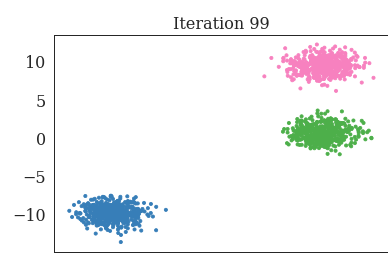

clusters: [0]
clusters: [0 1]
clusters: [0 2]
clusters: [0 2]
clusters: [0 2]
clusters: [0 2 3]
clusters: [0 2]
clusters: [0 2]
clusters: [0 2]
clusters: [0 2]
clusters: [0 2]
clusters: [0 2 3]
clusters: [0 2 4]
clusters: [0 2 4]
clusters: [0 2 4]
clusters: [0 2 4 5]
clusters: [0 2 4]
clusters: [0 2 5]
clusters: [0 2 5]
clusters: [0 2]
clusters: [0 2 3]
clusters: [0 2 4]
clusters: [0 2 4]
clusters: [0 2]
clusters: [0 2]
clusters: [0 2 3]
clusters: [0 2 3 4]
clusters: [0 2 3 4]
clusters: [0 2 3 4 5]
clusters: [0 2 3 4]
clusters: [0 2 3 4]
clusters: [0 2 3]
clusters: [0 2 3]
clusters: [0 2 3]
clusters: [0 2 3]
clusters: [0 2 3 4]
clusters: [0 2 3]
clusters: [0 2 3]
clusters: [0 2 3]
clusters: [0 2 3]
clusters: [0 2 3]
clusters: [0 2 3]
clusters: [0 2 3]
clusters: [0 2 3 4]
clusters: [0 2 3]
clusters: [0 2 3]
clusters: [0 2 3]
clusters: [0 2 3]
clusters: [0 2 3]
clusters: [0 2 3]
clusters: [0 2 3]
clusters: [0 2 3]
clusters: [0 2 3]
clusters: [0 2 3]
clusters: [0 2 3]
clusters: [0 2 3 4]


TypeError: 'NoneType' object is not subscriptable

In [18]:
%matplotlib notebook
import logging

import scipy
from sklearn import cluster, datasets
from itertools import cycle, islice

n_samples = 1500
blobs = datasets.make_blobs(n_samples=n_samples, random_state=8)
sources, targets = blobs[0], blobs[1]

D = sources.shape[1]
alpha = 1 # concentrate parameter
mu0 = np.mean(sources, axis = 0)
lmbda = 1 # belief of the mean
Sigma0 = np.cov(sources.T) # belief of the covariance
nu = D + 3 # belief of variance or degree of freedom
K0=1 # initial number of clusters
num_iterations = 100
verbose=True

results = DPGMM1(alpha, mu0, lmbda, Sigma0, nu, sources, K0, num_iterations, verbose)
# preds = results['z']
preds = np.argmax(results['z_posterior'], axis=1)

colors = np.array(list(islice(cycle(['#377eb8', '#ff7f00', '#4daf4a',
                                     '#f781bf', '#a65628', '#984ea3',
                                     '#999999', '#e41a1c', '#dede00']),
                              int(max(preds) + 1))))
plt.scatter(sources[:, 0], sources[:, 1], s=10, color=colors[preds])
plt.show()

In [46]:
%matplotlib inline
import logging

import scipy
from sklearn import cluster, datasets
from itertools import cycle, islice

n_samples = 1500
blobs = datasets.make_blobs(n_samples=n_samples, random_state=8)
sources, targets = blobs[0], blobs[1]

utt_key = "1100F_0124_2017_0s_10s"
print(mfcc40_feats[utt_key].shape)
# print(mel80_feats[utt_key].shape)

sources = mfcc40_feats[utt_key] # (num_frames, feat_dim) 
# sources = mel80_feats[utt_key] 

D = sources.shape[1]
alpha = 1 # concentrate parameter
mu0 = np.mean(sources, axis = 0)
lmbda = 1 # belief of the mean
Sigma0 = np.cov(sources.T) # belief of the covariance
nu = D + 3 # belief of variance or degree of freedom
K0=3 # initial number of clusters
num_iterations = 1500
verbose=False

results = DPGMM3(alpha, mu0, lmbda, Sigma0, nu, sources, K0, num_iterations, verbose)
# preds = results['z']
preds_mfcc40 = np.argmax(results['z_posterior'], axis=1)

(998, 40)


In [47]:
preds_mfcc40

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 2, 2,
       2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2,

(801, 80)
(998, 13)


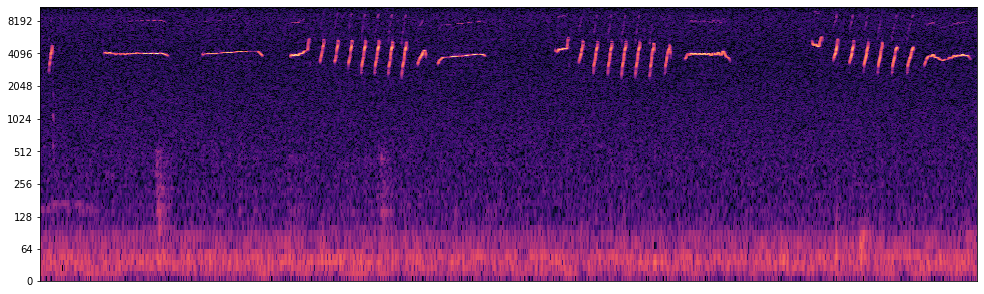

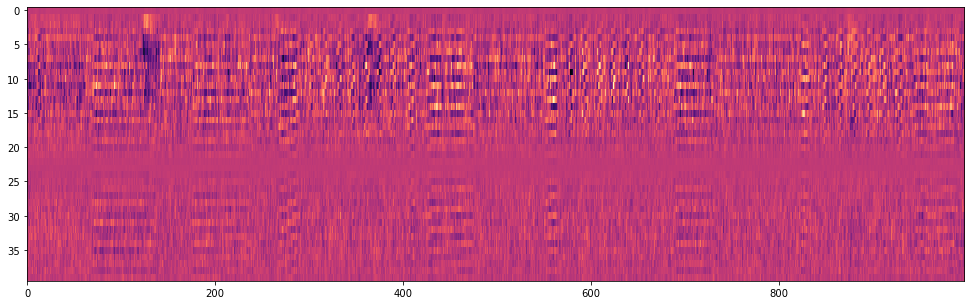

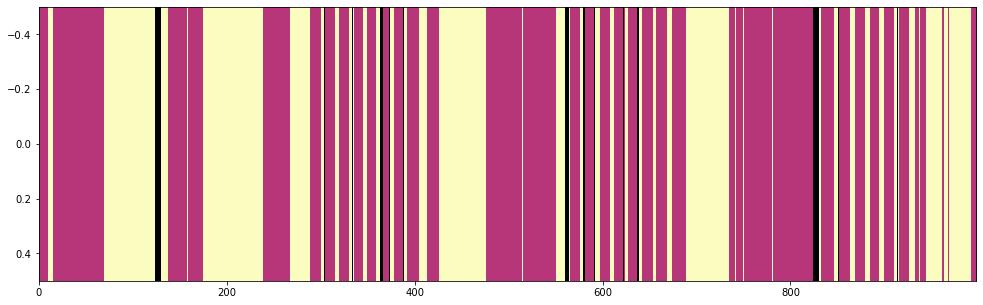

In [48]:
# https://librosa.org/doc/main/auto_examples/plot_display.html
import numpy as np
import matplotlib.pyplot as plt

import librosa
import librosa.display

utt_key = "1100F_0124_2017_0s_10s"
print(mel80_feats["1100F_0124_2017_0s_10s"].shape)
print(mfcc13_feats["1100F_0124_2017_0s_10s"].shape)

y, sr = librosa.load(path, sr=48000)
D = librosa.stft(y)  # STFT of y
S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)

plt.figure(figsize=(14*1.2, 4.2*1.2))
# draw_spectrogram(spectrogram)
ax = librosa.display.specshow(S_db, cmap='magma', y_axis='log')
plt.gca().set_ylabel(None)# Turn off y labels

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = plt.imshow(mfcc40_feats[utt_key].T, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = plt.imshow(preds_mfcc40[:,np.newaxis].T, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'

(998, 40)
[0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 2 2 2 2 2 2 2 1 2 2 1 2 1 1 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0
 0 0 0 0 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 1 1 1
 1 1 0 0 0 0 0 0 0 0 0 0 1 1 1 1 0 0 0 0 0 0 0 0 0 0 1 1 1 1 2 2 2 2 0 0 0
 0 0 2 1 1 1 1 1 0 0 0 0 0 0 0 0 0 2 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1
 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0
 0 0 0 0 0 0 0 

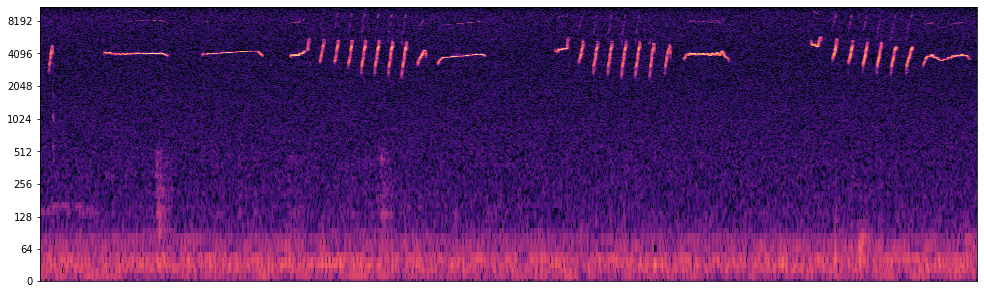

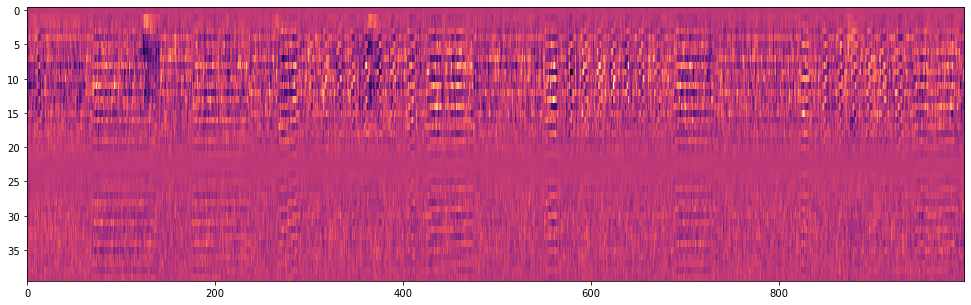

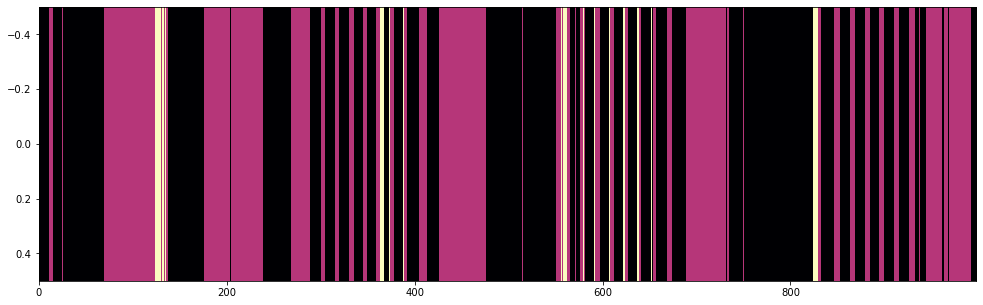

In [207]:
%matplotlib inline
import logging

import scipy
from sklearn import cluster, datasets
from itertools import cycle, islice

n_samples = 1500
blobs = datasets.make_blobs(n_samples=n_samples, random_state=8)
sources, targets = blobs[0], blobs[1]

utt_key = "1100F_0124_2017_0s_10s"
print(mfcc40_feats[utt_key].shape)
# print(mel80_feats[utt_key].shape)

sources = mfcc40_feats[utt_key] # (num_frames, feat_dim) 
# sources = mel80_feats[utt_key] 

D = sources.shape[1]
alpha = 1 # concentrate parameter
mu0 = np.mean(sources, axis = 0)
lmbda = 1 # belief of the mean
Sigma0 = np.cov(sources.T) # belief of the covariance
nu = D + 3 # belief of variance or degree of freedom
K0=3 # initial number of clusters
num_iterations = 1500
verbose=False

results = DPGMM3(alpha, mu0, lmbda, Sigma0, nu, sources, K0, num_iterations, verbose)
# preds = results['z']
preds_mfcc40 = np.argmax(results['z_posterior'], axis=1)

print(preds_mfcc40)

# https://librosa.org/doc/main/auto_examples/plot_display.html
import numpy as np
import matplotlib.pyplot as plt

import librosa
import librosa.display

utt_key = "1100F_0124_2017_0s_10s"
print(mel80_feats["1100F_0124_2017_0s_10s"].shape)
print(mfcc13_feats["1100F_0124_2017_0s_10s"].shape)

y, sr = librosa.load(path, sr=48000)
D = librosa.stft(y)  # STFT of y
S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)

plt.figure(figsize=(14*1.2, 4.2*1.2))
# draw_spectrogram(spectrogram)
ax = librosa.display.specshow(S_db, cmap='magma', y_axis='log')
plt.gca().set_ylabel(None)# Turn off y labels

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = plt.imshow(mfcc40_feats[utt_key].T, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = plt.imshow(preds_mfcc40[:,np.newaxis].T, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'

(801, 13)
[ 06/06/2022 12:33:39 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 0 - num_clusters: 3
[ 06/06/2022 12:33:39 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1 - num_clusters: 3
[ 06/06/2022 12:33:39 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 2 - num_clusters: 3
[ 06/06/2022 12:33:39 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 3 - num_clusters: 3
[ 06/06/2022 12:33:40 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 4 - num_clusters: 3
[ 06/06/2022 12:33:40 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 5 - num_clusters: 3
[ 06/06/2022 12:33:40 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 6 - num_clusters: 3
[ 06/06/2022 12:33:40 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 7 - num_clusters: 4
[ 06/06/2022 12:33:40 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 8 - num_clusters: 4
[ 06/06/2022 12:33:40 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 9 - num_clusters: 4
[ 06/06/2022 12:33:40 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 10 - num_

[ 06/06/2022 12:33:45 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 90 - num_clusters: 5
[ 06/06/2022 12:33:45 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 91 - num_clusters: 5
[ 06/06/2022 12:33:45 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 92 - num_clusters: 5
[ 06/06/2022 12:33:45 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 93 - num_clusters: 5
[ 06/06/2022 12:33:45 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 94 - num_clusters: 5
[ 06/06/2022 12:33:45 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 95 - num_clusters: 5
[ 06/06/2022 12:33:45 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 96 - num_clusters: 5
[ 06/06/2022 12:33:45 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 97 - num_clusters: 5
[ 06/06/2022 12:33:45 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 98 - num_clusters: 5
[ 06/06/2022 12:33:45 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 99 - num_clusters: 5
[ 06/06/2022 12:33:45 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 100 - num

[ 06/06/2022 12:33:50 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 179 - num_clusters: 7
[ 06/06/2022 12:33:50 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 180 - num_clusters: 7
[ 06/06/2022 12:33:50 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 181 - num_clusters: 7
[ 06/06/2022 12:33:50 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 182 - num_clusters: 7
[ 06/06/2022 12:33:50 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 183 - num_clusters: 7
[ 06/06/2022 12:33:51 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 184 - num_clusters: 7
[ 06/06/2022 12:33:51 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 185 - num_clusters: 7
[ 06/06/2022 12:33:51 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 186 - num_clusters: 7
[ 06/06/2022 12:33:51 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 187 - num_clusters: 7
[ 06/06/2022 12:33:51 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 188 - num_clusters: 7
[ 06/06/2022 12:33:51 | <ipython-input-14-a49e42be2f2d> | INFO ] iter:

[ 06/06/2022 12:33:56 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 268 - num_clusters: 7
[ 06/06/2022 12:33:56 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 269 - num_clusters: 7
[ 06/06/2022 12:33:57 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 270 - num_clusters: 7
[ 06/06/2022 12:33:57 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 271 - num_clusters: 7
[ 06/06/2022 12:33:57 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 272 - num_clusters: 7
[ 06/06/2022 12:33:57 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 273 - num_clusters: 7
[ 06/06/2022 12:33:57 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 274 - num_clusters: 8
[ 06/06/2022 12:33:57 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 275 - num_clusters: 8
[ 06/06/2022 12:33:57 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 276 - num_clusters: 8
[ 06/06/2022 12:33:57 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 277 - num_clusters: 8
[ 06/06/2022 12:33:57 | <ipython-input-14-a49e42be2f2d> | INFO ] iter:

[ 06/06/2022 12:34:04 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 357 - num_clusters: 6
[ 06/06/2022 12:34:04 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 358 - num_clusters: 6
[ 06/06/2022 12:34:04 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 359 - num_clusters: 6
[ 06/06/2022 12:34:04 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 360 - num_clusters: 6
[ 06/06/2022 12:34:04 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 361 - num_clusters: 6
[ 06/06/2022 12:34:04 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 362 - num_clusters: 6
[ 06/06/2022 12:34:04 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 363 - num_clusters: 6
[ 06/06/2022 12:34:04 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 364 - num_clusters: 6
[ 06/06/2022 12:34:04 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 365 - num_clusters: 6
[ 06/06/2022 12:34:04 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 366 - num_clusters: 6
[ 06/06/2022 12:34:04 | <ipython-input-14-a49e42be2f2d> | INFO ] iter:

[ 06/06/2022 12:34:10 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 446 - num_clusters: 8
[ 06/06/2022 12:34:10 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 447 - num_clusters: 8
[ 06/06/2022 12:34:10 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 448 - num_clusters: 8
[ 06/06/2022 12:34:10 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 449 - num_clusters: 8
[ 06/06/2022 12:34:10 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 450 - num_clusters: 8
[ 06/06/2022 12:34:10 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 451 - num_clusters: 8
[ 06/06/2022 12:34:10 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 452 - num_clusters: 7
[ 06/06/2022 12:34:10 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 453 - num_clusters: 7
[ 06/06/2022 12:34:10 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 454 - num_clusters: 7
[ 06/06/2022 12:34:10 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 455 - num_clusters: 7
[ 06/06/2022 12:34:11 | <ipython-input-14-a49e42be2f2d> | INFO ] iter:

[ 06/06/2022 12:34:16 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 535 - num_clusters: 7
[ 06/06/2022 12:34:16 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 536 - num_clusters: 7
[ 06/06/2022 12:34:16 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 537 - num_clusters: 7
[ 06/06/2022 12:34:16 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 538 - num_clusters: 7
[ 06/06/2022 12:34:16 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 539 - num_clusters: 7
[ 06/06/2022 12:34:16 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 540 - num_clusters: 7
[ 06/06/2022 12:34:16 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 541 - num_clusters: 7
[ 06/06/2022 12:34:16 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 542 - num_clusters: 7
[ 06/06/2022 12:34:16 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 543 - num_clusters: 7
[ 06/06/2022 12:34:17 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 544 - num_clusters: 7
[ 06/06/2022 12:34:17 | <ipython-input-14-a49e42be2f2d> | INFO ] iter:

[ 06/06/2022 12:34:22 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 624 - num_clusters: 7
[ 06/06/2022 12:34:22 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 625 - num_clusters: 7
[ 06/06/2022 12:34:22 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 626 - num_clusters: 7
[ 06/06/2022 12:34:22 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 627 - num_clusters: 7
[ 06/06/2022 12:34:22 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 628 - num_clusters: 7
[ 06/06/2022 12:34:22 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 629 - num_clusters: 7
[ 06/06/2022 12:34:22 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 630 - num_clusters: 7
[ 06/06/2022 12:34:22 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 631 - num_clusters: 7
[ 06/06/2022 12:34:22 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 632 - num_clusters: 7
[ 06/06/2022 12:34:23 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 633 - num_clusters: 7
[ 06/06/2022 12:34:23 | <ipython-input-14-a49e42be2f2d> | INFO ] iter:

[ 06/06/2022 12:34:27 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 713 - num_clusters: 8
[ 06/06/2022 12:34:27 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 714 - num_clusters: 9
[ 06/06/2022 12:34:27 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 715 - num_clusters: 9
[ 06/06/2022 12:34:27 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 716 - num_clusters: 9
[ 06/06/2022 12:34:27 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 717 - num_clusters: 9
[ 06/06/2022 12:34:27 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 718 - num_clusters: 9
[ 06/06/2022 12:34:28 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 719 - num_clusters: 9
[ 06/06/2022 12:34:28 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 720 - num_clusters: 9
[ 06/06/2022 12:34:28 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 721 - num_clusters: 8
[ 06/06/2022 12:34:28 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 722 - num_clusters: 8
[ 06/06/2022 12:34:28 | <ipython-input-14-a49e42be2f2d> | INFO ] iter:

[ 06/06/2022 12:34:32 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 802 - num_clusters: 7
[ 06/06/2022 12:34:32 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 803 - num_clusters: 7
[ 06/06/2022 12:34:32 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 804 - num_clusters: 7
[ 06/06/2022 12:34:32 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 805 - num_clusters: 7
[ 06/06/2022 12:34:32 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 806 - num_clusters: 7
[ 06/06/2022 12:34:32 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 807 - num_clusters: 7
[ 06/06/2022 12:34:32 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 808 - num_clusters: 7
[ 06/06/2022 12:34:32 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 809 - num_clusters: 7
[ 06/06/2022 12:34:33 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 810 - num_clusters: 7
[ 06/06/2022 12:34:33 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 811 - num_clusters: 7
[ 06/06/2022 12:34:33 | <ipython-input-14-a49e42be2f2d> | INFO ] iter:

[ 06/06/2022 12:34:37 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 891 - num_clusters: 6
[ 06/06/2022 12:34:37 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 892 - num_clusters: 6
[ 06/06/2022 12:34:37 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 893 - num_clusters: 6
[ 06/06/2022 12:34:37 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 894 - num_clusters: 6
[ 06/06/2022 12:34:37 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 895 - num_clusters: 6
[ 06/06/2022 12:34:37 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 896 - num_clusters: 6
[ 06/06/2022 12:34:37 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 897 - num_clusters: 6
[ 06/06/2022 12:34:37 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 898 - num_clusters: 6
[ 06/06/2022 12:34:37 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 899 - num_clusters: 6
[ 06/06/2022 12:34:37 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 900 - num_clusters: 6
[ 06/06/2022 12:34:37 | <ipython-input-14-a49e42be2f2d> | INFO ] iter:

[ 06/06/2022 12:34:42 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 980 - num_clusters: 8
[ 06/06/2022 12:34:42 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 981 - num_clusters: 8
[ 06/06/2022 12:34:42 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 982 - num_clusters: 8
[ 06/06/2022 12:34:42 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 983 - num_clusters: 8
[ 06/06/2022 12:34:42 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 984 - num_clusters: 8
[ 06/06/2022 12:34:42 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 985 - num_clusters: 9
[ 06/06/2022 12:34:42 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 986 - num_clusters: 8
[ 06/06/2022 12:34:42 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 987 - num_clusters: 8
[ 06/06/2022 12:34:42 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 988 - num_clusters: 8
[ 06/06/2022 12:34:42 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 989 - num_clusters: 8
[ 06/06/2022 12:34:42 | <ipython-input-14-a49e42be2f2d> | INFO ] iter:

[ 06/06/2022 12:34:46 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1068 - num_clusters: 9
[ 06/06/2022 12:34:47 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1069 - num_clusters: 9
[ 06/06/2022 12:34:47 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1070 - num_clusters: 9
[ 06/06/2022 12:34:47 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1071 - num_clusters: 9
[ 06/06/2022 12:34:47 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1072 - num_clusters: 9
[ 06/06/2022 12:34:47 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1073 - num_clusters: 9
[ 06/06/2022 12:34:47 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1074 - num_clusters: 9
[ 06/06/2022 12:34:47 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1075 - num_clusters: 9
[ 06/06/2022 12:34:47 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1076 - num_clusters: 9
[ 06/06/2022 12:34:47 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1077 - num_clusters: 9
[ 06/06/2022 12:34:47 | <ipython-input-14-a49e42be2f2d> | IN

[ 06/06/2022 12:34:51 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1155 - num_clusters: 10
[ 06/06/2022 12:34:51 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1156 - num_clusters: 10
[ 06/06/2022 12:34:51 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1157 - num_clusters: 10
[ 06/06/2022 12:34:52 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1158 - num_clusters: 10
[ 06/06/2022 12:34:52 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1159 - num_clusters: 11
[ 06/06/2022 12:34:52 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1160 - num_clusters: 11
[ 06/06/2022 12:34:52 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1161 - num_clusters: 11
[ 06/06/2022 12:34:52 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1162 - num_clusters: 10
[ 06/06/2022 12:34:52 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1163 - num_clusters: 10
[ 06/06/2022 12:34:52 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1164 - num_clusters: 10
[ 06/06/2022 12:34:52 | <ipython-input-14-a49e42be

[ 06/06/2022 12:34:56 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1242 - num_clusters: 10
[ 06/06/2022 12:34:56 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1243 - num_clusters: 10
[ 06/06/2022 12:34:56 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1244 - num_clusters: 10
[ 06/06/2022 12:34:56 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1245 - num_clusters: 10
[ 06/06/2022 12:34:57 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1246 - num_clusters: 11
[ 06/06/2022 12:34:57 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1247 - num_clusters: 11
[ 06/06/2022 12:34:57 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1248 - num_clusters: 11
[ 06/06/2022 12:34:57 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1249 - num_clusters: 11
[ 06/06/2022 12:34:57 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1250 - num_clusters: 11
[ 06/06/2022 12:34:57 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1251 - num_clusters: 11
[ 06/06/2022 12:34:57 | <ipython-input-14-a49e42be

[ 06/06/2022 12:35:01 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1329 - num_clusters: 10
[ 06/06/2022 12:35:01 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1330 - num_clusters: 10
[ 06/06/2022 12:35:01 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1331 - num_clusters: 10
[ 06/06/2022 12:35:02 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1332 - num_clusters: 10
[ 06/06/2022 12:35:02 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1333 - num_clusters: 10
[ 06/06/2022 12:35:02 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1334 - num_clusters: 10
[ 06/06/2022 12:35:02 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1335 - num_clusters: 10
[ 06/06/2022 12:35:02 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1336 - num_clusters: 10
[ 06/06/2022 12:35:02 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1337 - num_clusters: 10
[ 06/06/2022 12:35:02 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1338 - num_clusters: 10
[ 06/06/2022 12:35:02 | <ipython-input-14-a49e42be

[ 06/06/2022 12:35:06 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1416 - num_clusters: 10
[ 06/06/2022 12:35:06 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1417 - num_clusters: 10
[ 06/06/2022 12:35:06 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1418 - num_clusters: 10
[ 06/06/2022 12:35:07 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1419 - num_clusters: 10
[ 06/06/2022 12:35:07 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1420 - num_clusters: 10
[ 06/06/2022 12:35:07 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1421 - num_clusters: 10
[ 06/06/2022 12:35:07 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1422 - num_clusters: 10
[ 06/06/2022 12:35:07 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1423 - num_clusters: 10
[ 06/06/2022 12:35:07 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1424 - num_clusters: 10
[ 06/06/2022 12:35:07 | <ipython-input-14-a49e42be2f2d> | INFO ] iter: 1425 - num_clusters: 10
[ 06/06/2022 12:35:07 | <ipython-input-14-a49e42be

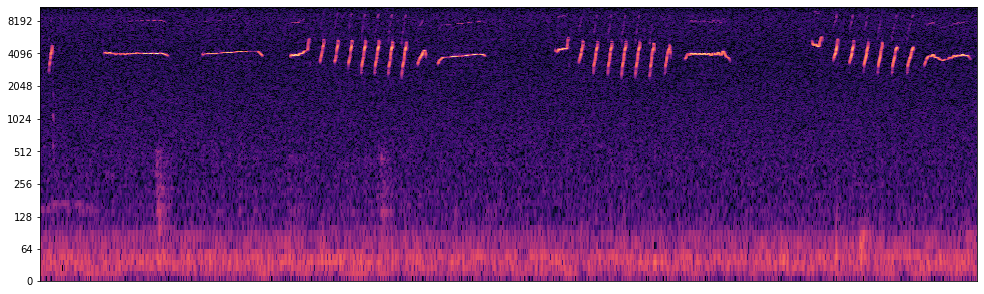

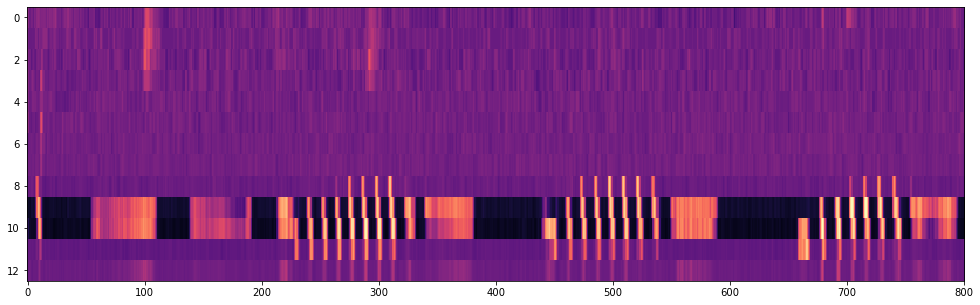

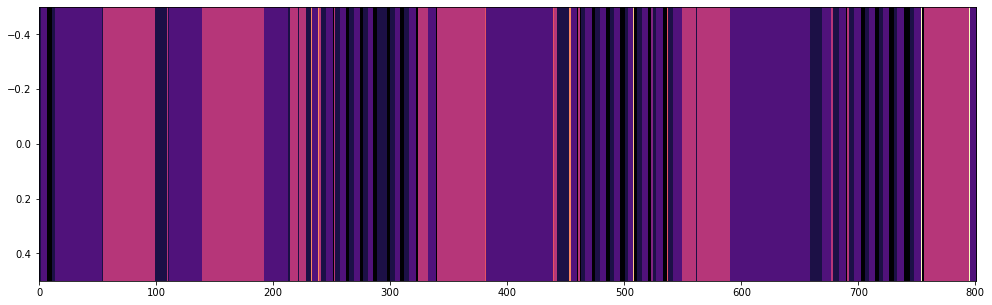

In [21]:
%matplotlib inline
import logging

import scipy
from sklearn import cluster, datasets
from itertools import cycle, islice

n_samples = 1500
blobs = datasets.make_blobs(n_samples=n_samples, random_state=8)
sources, targets = blobs[0], blobs[1]

utt_key = "1100F_0124_2017_0s_10s"
print(mel13_feats[utt_key].shape)
# print(mel80_feats[utt_key].shape)

sources = mel13_feats[utt_key] # (num_frames, feat_dim) 
# sources = mel80_feats[utt_key] 

D = sources.shape[1]
alpha = 1 # concentrate parameter
mu0 = np.mean(sources, axis = 0)
lmbda = 1 # belief of the mean
Sigma0 = np.cov(sources.T) # belief of the covariance
nu = D + 3 # belief of variance or degree of freedom
K0=3 # initial number of clusters
num_iterations = 1500
verbose=True

results = DPGMM3(alpha, mu0, lmbda, Sigma0, nu, sources, K0, num_iterations, verbose)
# preds = results['z']
preds_mel13 = np.argmax(results['z_posterior'], axis=1)

print(preds_mel13)

# https://librosa.org/doc/main/auto_examples/plot_display.html
import numpy as np
import matplotlib.pyplot as plt

import librosa
import librosa.display

utt_key = "1100F_0124_2017_0s_10s"
print(mel13_feats["1100F_0124_2017_0s_10s"].shape)
# print(mfcc13_feats["1100F_0124_2017_0s_10s"].shape)

y, sr = librosa.load(path, sr=48000)
D = librosa.stft(y)  # STFT of y
S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)

plt.figure(figsize=(14*1.2, 4.2*1.2))
# draw_spectrogram(spectrogram)
ax = librosa.display.specshow(S_db, cmap='magma', y_axis='log')
plt.gca().set_ylabel(None)# Turn off y labels

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = plt.imshow(mel13_feats[utt_key].T, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = plt.imshow(preds_mel13[:,np.newaxis].T, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'

(797, 13)


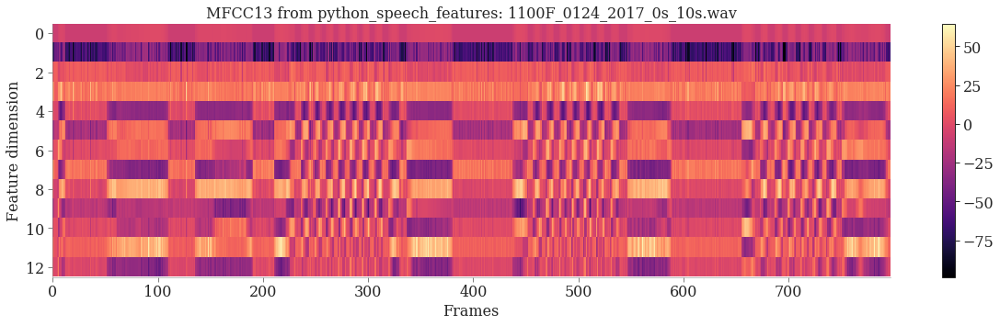

In [90]:
import python_speech_features

# # librosa.stft setting (n_fft=512 recommended for speech feature extraction))
# n_fft=512
# window_size_num_samples = n_fft
# window_shift_num_samples = window_size_num_samples // 4 # default shift of librosa.stft.
# window_size_ms = round((window_size_num_samples / sampling_rate) * 1000, ndigits=3)
# window_shift_ms = round((window_shift_num_samples / sampling_rate) * 1000, ndigits=3)

# Tacotron setting
window_size_ms=50
window_shift_ms=12.5
n_fft=int(window_size_ms / 1000 * sampling_rate)

# # # Kaldi setting
# # window_size_ms=25
# # window_shift_ms=10
# # n_fft=int(window_size_ms / 1000 * sampling_rate)

import numpy as np
import matplotlib.pyplot as plt

import librosa
import librosa.display

if (window_size_ms and window_shift_ms):
    fft_window_size = int(window_size_ms / 1000 * sampling_rate)
    fft_window_shift = int(window_shift_ms / 1000 * sampling_rate)
else:
    fft_window_size = n_fft # win_length: If unspecified for librosa.stft, defaults to ``win_length = n_fft``.
    fft_window_shift = fft_window_size // 4 # hop_length: If unspecified for librosa.stft, defaults to ``win_length // 4`` (see below).
    window_size_ms = (fft_window_size / sampling_rate) * 1000
    window_shift_ms = (fft_window_shift / sampling_rate) * 1000

wav, sampling_rate = librosa.load(path, sr=sampling_rate)
# second_order_sections = scipy.signal.butter(N=16, Wn=4000, btype="highpass", analog=False, fs=sampling_rate, output='sos')
# wav = scipy.signal.sosfilt(second_order_sections, wav)
feat = python_speech_features.mfcc(wav, samplerate=sampling_rate, winlen=window_size_ms/1000, winstep=window_shift_ms/1000, nfft=n_fft, numcep=13, appendEnergy=True)

title="MFCC13 from python_speech_features: {}".format(os.path.basename(path))
feat_matrix  = feat.T
fig =plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = fig.add_subplot(111)
image = ax.imshow(feat_matrix, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'
ax.set_xlabel("Frames")
ax.set_ylabel("Feature dimension".format(title))
ax.set_title(title)
plt.tight_layout()
format_axes(ax)
plt.colorbar(image, ax=ax)
print(feat.shape)

[ 21/06/2022 00:14:33 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 0 - num_clusters: 3
[ 21/06/2022 00:14:33 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1 - num_clusters: 3
[ 21/06/2022 00:14:33 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 2 - num_clusters: 3
[ 21/06/2022 00:14:33 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 3 - num_clusters: 3
[ 21/06/2022 00:14:33 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 4 - num_clusters: 3
[ 21/06/2022 00:14:33 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 5 - num_clusters: 3
[ 21/06/2022 00:14:33 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 6 - num_clusters: 3
[ 21/06/2022 00:14:33 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 7 - num_clusters: 3
[ 21/06/2022 00:14:34 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 8 - num_clusters: 3
[ 21/06/2022 00:14:34 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 9 - num_clusters: 3
[ 21/06/2022 00:14:34 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 10 - num_clusters: 

[ 21/06/2022 00:14:44 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 90 - num_clusters: 3
[ 21/06/2022 00:14:44 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 91 - num_clusters: 3
[ 21/06/2022 00:14:45 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 92 - num_clusters: 3
[ 21/06/2022 00:14:45 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 93 - num_clusters: 3
[ 21/06/2022 00:14:45 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 94 - num_clusters: 3
[ 21/06/2022 00:14:45 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 95 - num_clusters: 3
[ 21/06/2022 00:14:45 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 96 - num_clusters: 3
[ 21/06/2022 00:14:45 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 97 - num_clusters: 3
[ 21/06/2022 00:14:45 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 98 - num_clusters: 3
[ 21/06/2022 00:14:45 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 99 - num_clusters: 3
[ 21/06/2022 00:14:46 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 100 - num

[ 21/06/2022 00:14:56 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 179 - num_clusters: 3
[ 21/06/2022 00:14:56 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 180 - num_clusters: 3
[ 21/06/2022 00:14:56 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 181 - num_clusters: 3
[ 21/06/2022 00:14:56 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 182 - num_clusters: 3
[ 21/06/2022 00:14:57 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 183 - num_clusters: 3
[ 21/06/2022 00:14:57 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 184 - num_clusters: 3
[ 21/06/2022 00:14:57 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 185 - num_clusters: 3
[ 21/06/2022 00:14:57 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 186 - num_clusters: 3
[ 21/06/2022 00:14:57 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 187 - num_clusters: 3
[ 21/06/2022 00:14:57 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 188 - num_clusters: 3
[ 21/06/2022 00:14:57 | <ipython-input-84-a49e42be2f2d> | INFO ] iter:

[ 21/06/2022 00:15:08 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 268 - num_clusters: 3
[ 21/06/2022 00:15:08 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 269 - num_clusters: 3
[ 21/06/2022 00:15:08 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 270 - num_clusters: 3
[ 21/06/2022 00:15:08 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 271 - num_clusters: 3
[ 21/06/2022 00:15:08 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 272 - num_clusters: 3
[ 21/06/2022 00:15:08 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 273 - num_clusters: 3
[ 21/06/2022 00:15:08 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 274 - num_clusters: 3
[ 21/06/2022 00:15:08 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 275 - num_clusters: 3
[ 21/06/2022 00:15:09 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 276 - num_clusters: 3
[ 21/06/2022 00:15:09 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 277 - num_clusters: 3
[ 21/06/2022 00:15:09 | <ipython-input-84-a49e42be2f2d> | INFO ] iter:

[ 21/06/2022 00:15:19 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 357 - num_clusters: 3
[ 21/06/2022 00:15:19 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 358 - num_clusters: 3
[ 21/06/2022 00:15:19 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 359 - num_clusters: 3
[ 21/06/2022 00:15:19 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 360 - num_clusters: 3
[ 21/06/2022 00:15:19 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 361 - num_clusters: 3
[ 21/06/2022 00:15:19 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 362 - num_clusters: 3
[ 21/06/2022 00:15:20 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 363 - num_clusters: 3
[ 21/06/2022 00:15:20 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 364 - num_clusters: 3
[ 21/06/2022 00:15:20 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 365 - num_clusters: 3
[ 21/06/2022 00:15:20 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 366 - num_clusters: 3
[ 21/06/2022 00:15:20 | <ipython-input-84-a49e42be2f2d> | INFO ] iter:

[ 21/06/2022 00:15:29 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 446 - num_clusters: 3
[ 21/06/2022 00:15:29 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 447 - num_clusters: 3
[ 21/06/2022 00:15:30 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 448 - num_clusters: 3
[ 21/06/2022 00:15:30 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 449 - num_clusters: 3
[ 21/06/2022 00:15:30 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 450 - num_clusters: 3
[ 21/06/2022 00:15:30 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 451 - num_clusters: 3
[ 21/06/2022 00:15:30 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 452 - num_clusters: 3
[ 21/06/2022 00:15:30 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 453 - num_clusters: 3
[ 21/06/2022 00:15:30 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 454 - num_clusters: 3
[ 21/06/2022 00:15:31 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 455 - num_clusters: 3
[ 21/06/2022 00:15:31 | <ipython-input-84-a49e42be2f2d> | INFO ] iter:

[ 21/06/2022 00:15:39 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 535 - num_clusters: 3
[ 21/06/2022 00:15:40 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 536 - num_clusters: 3
[ 21/06/2022 00:15:40 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 537 - num_clusters: 3
[ 21/06/2022 00:15:40 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 538 - num_clusters: 3
[ 21/06/2022 00:15:40 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 539 - num_clusters: 3
[ 21/06/2022 00:15:40 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 540 - num_clusters: 3
[ 21/06/2022 00:15:40 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 541 - num_clusters: 3
[ 21/06/2022 00:15:40 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 542 - num_clusters: 3
[ 21/06/2022 00:15:40 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 543 - num_clusters: 3
[ 21/06/2022 00:15:40 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 544 - num_clusters: 3
[ 21/06/2022 00:15:41 | <ipython-input-84-a49e42be2f2d> | INFO ] iter:

[ 21/06/2022 00:15:51 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 624 - num_clusters: 3
[ 21/06/2022 00:15:51 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 625 - num_clusters: 3
[ 21/06/2022 00:15:51 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 626 - num_clusters: 3
[ 21/06/2022 00:15:51 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 627 - num_clusters: 3
[ 21/06/2022 00:15:51 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 628 - num_clusters: 3
[ 21/06/2022 00:15:51 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 629 - num_clusters: 3
[ 21/06/2022 00:15:52 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 630 - num_clusters: 3
[ 21/06/2022 00:15:52 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 631 - num_clusters: 3
[ 21/06/2022 00:15:52 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 632 - num_clusters: 3
[ 21/06/2022 00:15:52 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 633 - num_clusters: 3
[ 21/06/2022 00:15:52 | <ipython-input-84-a49e42be2f2d> | INFO ] iter:

[ 21/06/2022 00:16:03 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 713 - num_clusters: 3
[ 21/06/2022 00:16:03 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 714 - num_clusters: 3
[ 21/06/2022 00:16:03 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 715 - num_clusters: 3
[ 21/06/2022 00:16:03 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 716 - num_clusters: 3
[ 21/06/2022 00:16:03 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 717 - num_clusters: 3
[ 21/06/2022 00:16:03 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 718 - num_clusters: 3
[ 21/06/2022 00:16:03 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 719 - num_clusters: 3
[ 21/06/2022 00:16:04 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 720 - num_clusters: 3
[ 21/06/2022 00:16:04 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 721 - num_clusters: 3
[ 21/06/2022 00:16:04 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 722 - num_clusters: 3
[ 21/06/2022 00:16:04 | <ipython-input-84-a49e42be2f2d> | INFO ] iter:

[ 21/06/2022 00:16:09 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 802 - num_clusters: 3
[ 21/06/2022 00:16:09 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 803 - num_clusters: 3
[ 21/06/2022 00:16:09 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 804 - num_clusters: 3
[ 21/06/2022 00:16:10 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 805 - num_clusters: 3
[ 21/06/2022 00:16:10 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 806 - num_clusters: 3
[ 21/06/2022 00:16:10 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 807 - num_clusters: 3
[ 21/06/2022 00:16:10 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 808 - num_clusters: 3
[ 21/06/2022 00:16:10 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 809 - num_clusters: 3
[ 21/06/2022 00:16:10 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 810 - num_clusters: 3
[ 21/06/2022 00:16:10 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 811 - num_clusters: 3
[ 21/06/2022 00:16:10 | <ipython-input-84-a49e42be2f2d> | INFO ] iter:

[ 21/06/2022 00:16:19 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 891 - num_clusters: 3
[ 21/06/2022 00:16:19 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 892 - num_clusters: 3
[ 21/06/2022 00:16:19 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 893 - num_clusters: 3
[ 21/06/2022 00:16:19 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 894 - num_clusters: 3
[ 21/06/2022 00:16:19 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 895 - num_clusters: 3
[ 21/06/2022 00:16:19 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 896 - num_clusters: 3
[ 21/06/2022 00:16:19 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 897 - num_clusters: 3
[ 21/06/2022 00:16:20 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 898 - num_clusters: 3
[ 21/06/2022 00:16:20 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 899 - num_clusters: 3
[ 21/06/2022 00:16:20 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 900 - num_clusters: 3
[ 21/06/2022 00:16:20 | <ipython-input-84-a49e42be2f2d> | INFO ] iter:

[ 21/06/2022 00:16:26 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 980 - num_clusters: 3
[ 21/06/2022 00:16:26 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 981 - num_clusters: 3
[ 21/06/2022 00:16:26 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 982 - num_clusters: 3
[ 21/06/2022 00:16:26 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 983 - num_clusters: 3
[ 21/06/2022 00:16:26 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 984 - num_clusters: 3
[ 21/06/2022 00:16:27 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 985 - num_clusters: 3
[ 21/06/2022 00:16:27 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 986 - num_clusters: 3
[ 21/06/2022 00:16:27 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 987 - num_clusters: 3
[ 21/06/2022 00:16:27 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 988 - num_clusters: 3
[ 21/06/2022 00:16:27 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 989 - num_clusters: 3
[ 21/06/2022 00:16:27 | <ipython-input-84-a49e42be2f2d> | INFO ] iter:

[ 21/06/2022 00:16:37 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1068 - num_clusters: 3
[ 21/06/2022 00:16:37 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1069 - num_clusters: 3
[ 21/06/2022 00:16:37 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1070 - num_clusters: 3
[ 21/06/2022 00:16:37 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1071 - num_clusters: 3
[ 21/06/2022 00:16:37 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1072 - num_clusters: 3
[ 21/06/2022 00:16:37 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1073 - num_clusters: 3
[ 21/06/2022 00:16:37 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1074 - num_clusters: 3
[ 21/06/2022 00:16:38 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1075 - num_clusters: 3
[ 21/06/2022 00:16:38 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1076 - num_clusters: 3
[ 21/06/2022 00:16:38 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1077 - num_clusters: 3
[ 21/06/2022 00:16:38 | <ipython-input-84-a49e42be2f2d> | IN

[ 21/06/2022 00:16:46 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1156 - num_clusters: 3
[ 21/06/2022 00:16:46 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1157 - num_clusters: 3
[ 21/06/2022 00:16:46 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1158 - num_clusters: 3
[ 21/06/2022 00:16:46 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1159 - num_clusters: 3
[ 21/06/2022 00:16:47 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1160 - num_clusters: 3
[ 21/06/2022 00:16:47 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1161 - num_clusters: 3
[ 21/06/2022 00:16:47 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1162 - num_clusters: 3
[ 21/06/2022 00:16:47 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1163 - num_clusters: 3
[ 21/06/2022 00:16:47 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1164 - num_clusters: 3
[ 21/06/2022 00:16:47 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1165 - num_clusters: 3
[ 21/06/2022 00:16:47 | <ipython-input-84-a49e42be2f2d> | IN

[ 21/06/2022 00:16:54 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1244 - num_clusters: 3
[ 21/06/2022 00:16:54 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1245 - num_clusters: 3
[ 21/06/2022 00:16:55 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1246 - num_clusters: 3
[ 21/06/2022 00:16:55 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1247 - num_clusters: 3
[ 21/06/2022 00:16:55 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1248 - num_clusters: 3
[ 21/06/2022 00:16:55 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1249 - num_clusters: 3
[ 21/06/2022 00:16:55 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1250 - num_clusters: 3
[ 21/06/2022 00:16:55 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1251 - num_clusters: 3
[ 21/06/2022 00:16:55 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1252 - num_clusters: 3
[ 21/06/2022 00:16:55 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1253 - num_clusters: 3
[ 21/06/2022 00:16:55 | <ipython-input-84-a49e42be2f2d> | IN

[ 21/06/2022 00:17:05 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1332 - num_clusters: 3
[ 21/06/2022 00:17:05 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1333 - num_clusters: 3
[ 21/06/2022 00:17:05 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1334 - num_clusters: 3
[ 21/06/2022 00:17:05 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1335 - num_clusters: 3
[ 21/06/2022 00:17:05 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1336 - num_clusters: 3
[ 21/06/2022 00:17:05 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1337 - num_clusters: 3
[ 21/06/2022 00:17:05 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1338 - num_clusters: 3
[ 21/06/2022 00:17:06 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1339 - num_clusters: 3
[ 21/06/2022 00:17:06 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1340 - num_clusters: 3
[ 21/06/2022 00:17:06 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1341 - num_clusters: 3
[ 21/06/2022 00:17:06 | <ipython-input-84-a49e42be2f2d> | IN

[ 21/06/2022 00:17:16 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1420 - num_clusters: 3
[ 21/06/2022 00:17:17 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1421 - num_clusters: 3
[ 21/06/2022 00:17:17 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1422 - num_clusters: 3
[ 21/06/2022 00:17:17 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1423 - num_clusters: 3
[ 21/06/2022 00:17:17 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1424 - num_clusters: 3
[ 21/06/2022 00:17:17 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1425 - num_clusters: 3
[ 21/06/2022 00:17:17 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1426 - num_clusters: 3
[ 21/06/2022 00:17:17 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1427 - num_clusters: 3
[ 21/06/2022 00:17:17 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1428 - num_clusters: 3
[ 21/06/2022 00:17:18 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1429 - num_clusters: 3
[ 21/06/2022 00:17:18 | <ipython-input-84-a49e42be2f2d> | IN

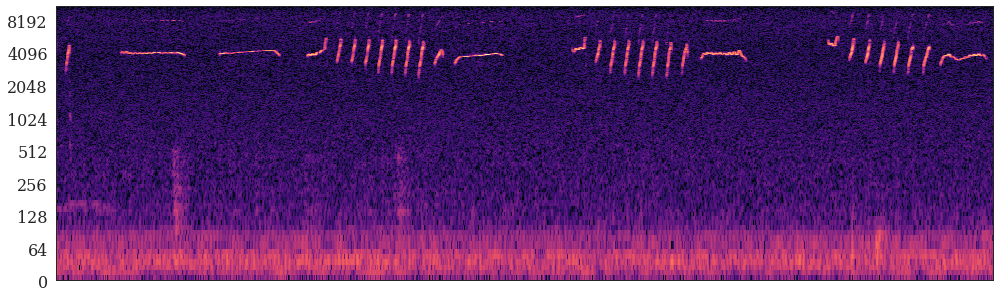

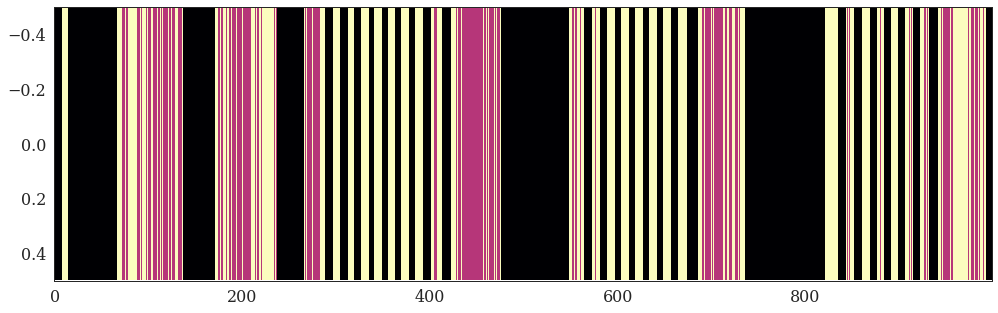

In [122]:
%matplotlib inline
import logging

import scipy
from sklearn import cluster, datasets
from itertools import cycle, islice

import numpy as np
import matplotlib.pyplot as plt

import librosa
import librosa.display

import python_speech_features

# # librosa.stft setting (n_fft=512 recommended for speech feature extraction))
# n_fft=512
# window_size_num_samples = n_fft
# window_shift_num_samples = window_size_num_samples // 4 # default shift of librosa.stft.
# window_size_ms = round((window_size_num_samples / sampling_rate) * 1000, ndigits=3)
# window_shift_ms = round((window_shift_num_samples / sampling_rate) * 1000, ndigits=3)

# Tacotron setting
window_size_ms=50
window_shift_ms=12.5
n_fft=int(window_size_ms / 1000 * sampling_rate)

# Kaldi setting
window_size_ms=25
window_shift_ms=10
n_fft=int(window_size_ms / 1000 * sampling_rate)

if (window_size_ms and window_shift_ms):
    fft_window_size = int(window_size_ms / 1000 * sampling_rate)
    fft_window_shift = int(window_shift_ms / 1000 * sampling_rate)
else:
    fft_window_size = n_fft # win_length: If unspecified for librosa.stft, defaults to ``win_length = n_fft``.
    fft_window_shift = fft_window_size // 4 # hop_length: If unspecified for librosa.stft, defaults to ``win_length // 4`` (see below).
    window_size_ms = (fft_window_size / sampling_rate) * 1000
    window_shift_ms = (fft_window_shift / sampling_rate) * 1000
numcep=80 # 40

wav, sampling_rate = librosa.load(path, sr=sampling_rate)
# second_order_sections = scipy.signal.butter(N=16, Wn=4000, btype="highpass", analog=False, fs=sampling_rate, output='sos')
# wav = scipy.signal.sosfilt(second_order_sections, wav)
sources = python_speech_features.mfcc(wav, samplerate=sampling_rate, winlen=window_size_ms/1000, winstep=window_shift_ms/1000, nfft=n_fft, numcep=numcep, appendEnergy=True)

D = sources.shape[1]
alpha = 1 # concentrate parameter
mu0 = np.mean(sources, axis = 0)
lmbda = 1 # belief of the mean
Sigma0 = np.cov(sources.T) # belief of the covariance
nu = D + 3 # belief of variance or degree of freedom
K0=3 # initial number of clusters
num_iterations = 1500
verbose=True


results = DPGMM3(alpha, mu0, lmbda, Sigma0, nu, sources, K0, num_iterations, verbose)
preds = np.argmax(results['z_posterior'], axis=1) # or preds = results['z']

print(preds)

y, sr = librosa.load(path, sr=48000)
D = librosa.stft(y)  # STFT of y
S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = librosa.display.specshow(S_db, cmap='magma', y_axis='log')
plt.gca().set_ylabel(None)# Turn off y labels

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = plt.imshow(preds[:,np.newaxis].T, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'

[ 21/06/2022 00:17:28 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 0 - num_clusters: 3
[ 21/06/2022 00:17:28 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1 - num_clusters: 3
[ 21/06/2022 00:17:28 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 2 - num_clusters: 3
[ 21/06/2022 00:17:28 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 3 - num_clusters: 3
[ 21/06/2022 00:17:29 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 4 - num_clusters: 3
[ 21/06/2022 00:17:29 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 5 - num_clusters: 3
[ 21/06/2022 00:17:29 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 6 - num_clusters: 3
[ 21/06/2022 00:17:29 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 7 - num_clusters: 3
[ 21/06/2022 00:17:29 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 8 - num_clusters: 3
[ 21/06/2022 00:17:29 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 9 - num_clusters: 3
[ 21/06/2022 00:17:29 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 10 - num_clusters: 

[ 21/06/2022 00:17:38 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 90 - num_clusters: 3
[ 21/06/2022 00:17:38 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 91 - num_clusters: 3
[ 21/06/2022 00:17:38 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 92 - num_clusters: 3
[ 21/06/2022 00:17:38 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 93 - num_clusters: 3
[ 21/06/2022 00:17:39 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 94 - num_clusters: 3
[ 21/06/2022 00:17:39 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 95 - num_clusters: 3
[ 21/06/2022 00:17:39 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 96 - num_clusters: 3
[ 21/06/2022 00:17:39 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 97 - num_clusters: 3
[ 21/06/2022 00:17:39 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 98 - num_clusters: 3
[ 21/06/2022 00:17:39 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 99 - num_clusters: 3
[ 21/06/2022 00:17:39 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 100 - num

[ 21/06/2022 00:17:48 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 179 - num_clusters: 3
[ 21/06/2022 00:17:48 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 180 - num_clusters: 3
[ 21/06/2022 00:17:49 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 181 - num_clusters: 3
[ 21/06/2022 00:17:49 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 182 - num_clusters: 3
[ 21/06/2022 00:17:49 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 183 - num_clusters: 3
[ 21/06/2022 00:17:49 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 184 - num_clusters: 3
[ 21/06/2022 00:17:49 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 185 - num_clusters: 3
[ 21/06/2022 00:17:49 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 186 - num_clusters: 3
[ 21/06/2022 00:17:49 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 187 - num_clusters: 3
[ 21/06/2022 00:17:49 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 188 - num_clusters: 3
[ 21/06/2022 00:17:49 | <ipython-input-84-a49e42be2f2d> | INFO ] iter:

[ 21/06/2022 00:17:58 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 268 - num_clusters: 3
[ 21/06/2022 00:17:59 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 269 - num_clusters: 3
[ 21/06/2022 00:17:59 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 270 - num_clusters: 3
[ 21/06/2022 00:17:59 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 271 - num_clusters: 3
[ 21/06/2022 00:17:59 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 272 - num_clusters: 3
[ 21/06/2022 00:17:59 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 273 - num_clusters: 3
[ 21/06/2022 00:17:59 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 274 - num_clusters: 3
[ 21/06/2022 00:17:59 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 275 - num_clusters: 3
[ 21/06/2022 00:17:59 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 276 - num_clusters: 3
[ 21/06/2022 00:18:00 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 277 - num_clusters: 3
[ 21/06/2022 00:18:00 | <ipython-input-84-a49e42be2f2d> | INFO ] iter:

[ 21/06/2022 00:18:07 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 357 - num_clusters: 3
[ 21/06/2022 00:18:08 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 358 - num_clusters: 3
[ 21/06/2022 00:18:08 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 359 - num_clusters: 3
[ 21/06/2022 00:18:08 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 360 - num_clusters: 3
[ 21/06/2022 00:18:08 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 361 - num_clusters: 3
[ 21/06/2022 00:18:08 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 362 - num_clusters: 3
[ 21/06/2022 00:18:08 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 363 - num_clusters: 3
[ 21/06/2022 00:18:08 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 364 - num_clusters: 3
[ 21/06/2022 00:18:08 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 365 - num_clusters: 3
[ 21/06/2022 00:18:08 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 366 - num_clusters: 3
[ 21/06/2022 00:18:09 | <ipython-input-84-a49e42be2f2d> | INFO ] iter:

[ 21/06/2022 00:18:17 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 446 - num_clusters: 3
[ 21/06/2022 00:18:18 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 447 - num_clusters: 3
[ 21/06/2022 00:18:18 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 448 - num_clusters: 3
[ 21/06/2022 00:18:18 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 449 - num_clusters: 3
[ 21/06/2022 00:18:18 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 450 - num_clusters: 3
[ 21/06/2022 00:18:18 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 451 - num_clusters: 3
[ 21/06/2022 00:18:18 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 452 - num_clusters: 3
[ 21/06/2022 00:18:18 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 453 - num_clusters: 3
[ 21/06/2022 00:18:18 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 454 - num_clusters: 3
[ 21/06/2022 00:18:18 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 455 - num_clusters: 3
[ 21/06/2022 00:18:19 | <ipython-input-84-a49e42be2f2d> | INFO ] iter:

[ 21/06/2022 00:18:28 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 535 - num_clusters: 3
[ 21/06/2022 00:18:28 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 536 - num_clusters: 3
[ 21/06/2022 00:18:28 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 537 - num_clusters: 3
[ 21/06/2022 00:18:28 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 538 - num_clusters: 3
[ 21/06/2022 00:18:28 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 539 - num_clusters: 3
[ 21/06/2022 00:18:28 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 540 - num_clusters: 3
[ 21/06/2022 00:18:28 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 541 - num_clusters: 3
[ 21/06/2022 00:18:28 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 542 - num_clusters: 3
[ 21/06/2022 00:18:29 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 543 - num_clusters: 3
[ 21/06/2022 00:18:29 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 544 - num_clusters: 3
[ 21/06/2022 00:18:29 | <ipython-input-84-a49e42be2f2d> | INFO ] iter:

[ 21/06/2022 00:18:38 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 624 - num_clusters: 3
[ 21/06/2022 00:18:38 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 625 - num_clusters: 3
[ 21/06/2022 00:18:38 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 626 - num_clusters: 3
[ 21/06/2022 00:18:38 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 627 - num_clusters: 3
[ 21/06/2022 00:18:38 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 628 - num_clusters: 3
[ 21/06/2022 00:18:38 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 629 - num_clusters: 3
[ 21/06/2022 00:18:38 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 630 - num_clusters: 3
[ 21/06/2022 00:18:39 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 631 - num_clusters: 3
[ 21/06/2022 00:18:39 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 632 - num_clusters: 3
[ 21/06/2022 00:18:39 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 633 - num_clusters: 3
[ 21/06/2022 00:18:39 | <ipython-input-84-a49e42be2f2d> | INFO ] iter:

[ 21/06/2022 00:18:48 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 713 - num_clusters: 3
[ 21/06/2022 00:18:48 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 714 - num_clusters: 3
[ 21/06/2022 00:18:48 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 715 - num_clusters: 3
[ 21/06/2022 00:18:48 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 716 - num_clusters: 3
[ 21/06/2022 00:18:48 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 717 - num_clusters: 3
[ 21/06/2022 00:18:49 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 718 - num_clusters: 3
[ 21/06/2022 00:18:49 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 719 - num_clusters: 3
[ 21/06/2022 00:18:49 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 720 - num_clusters: 3
[ 21/06/2022 00:18:49 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 721 - num_clusters: 3
[ 21/06/2022 00:18:49 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 722 - num_clusters: 3
[ 21/06/2022 00:18:49 | <ipython-input-84-a49e42be2f2d> | INFO ] iter:

[ 21/06/2022 00:18:58 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 802 - num_clusters: 3
[ 21/06/2022 00:18:58 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 803 - num_clusters: 3
[ 21/06/2022 00:18:58 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 804 - num_clusters: 3
[ 21/06/2022 00:18:58 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 805 - num_clusters: 3
[ 21/06/2022 00:18:59 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 806 - num_clusters: 3
[ 21/06/2022 00:18:59 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 807 - num_clusters: 3
[ 21/06/2022 00:18:59 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 808 - num_clusters: 3
[ 21/06/2022 00:18:59 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 809 - num_clusters: 3
[ 21/06/2022 00:18:59 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 810 - num_clusters: 3
[ 21/06/2022 00:18:59 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 811 - num_clusters: 3
[ 21/06/2022 00:18:59 | <ipython-input-84-a49e42be2f2d> | INFO ] iter:

[ 21/06/2022 00:19:08 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 891 - num_clusters: 3
[ 21/06/2022 00:19:08 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 892 - num_clusters: 3
[ 21/06/2022 00:19:09 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 893 - num_clusters: 3
[ 21/06/2022 00:19:09 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 894 - num_clusters: 3
[ 21/06/2022 00:19:09 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 895 - num_clusters: 3
[ 21/06/2022 00:19:09 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 896 - num_clusters: 3
[ 21/06/2022 00:19:09 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 897 - num_clusters: 3
[ 21/06/2022 00:19:09 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 898 - num_clusters: 3
[ 21/06/2022 00:19:09 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 899 - num_clusters: 3
[ 21/06/2022 00:19:09 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 900 - num_clusters: 3
[ 21/06/2022 00:19:10 | <ipython-input-84-a49e42be2f2d> | INFO ] iter:

[ 21/06/2022 00:19:18 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 980 - num_clusters: 3
[ 21/06/2022 00:19:18 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 981 - num_clusters: 3
[ 21/06/2022 00:19:18 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 982 - num_clusters: 3
[ 21/06/2022 00:19:18 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 983 - num_clusters: 3
[ 21/06/2022 00:19:19 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 984 - num_clusters: 3
[ 21/06/2022 00:19:19 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 985 - num_clusters: 3
[ 21/06/2022 00:19:19 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 986 - num_clusters: 3
[ 21/06/2022 00:19:19 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 987 - num_clusters: 3
[ 21/06/2022 00:19:19 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 988 - num_clusters: 3
[ 21/06/2022 00:19:19 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 989 - num_clusters: 3
[ 21/06/2022 00:19:19 | <ipython-input-84-a49e42be2f2d> | INFO ] iter:

[ 21/06/2022 00:19:28 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1068 - num_clusters: 3
[ 21/06/2022 00:19:28 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1069 - num_clusters: 3
[ 21/06/2022 00:19:28 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1070 - num_clusters: 3
[ 21/06/2022 00:19:29 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1071 - num_clusters: 3
[ 21/06/2022 00:19:29 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1072 - num_clusters: 3
[ 21/06/2022 00:19:29 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1073 - num_clusters: 3
[ 21/06/2022 00:19:29 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1074 - num_clusters: 3
[ 21/06/2022 00:19:29 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1075 - num_clusters: 3
[ 21/06/2022 00:19:29 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1076 - num_clusters: 3
[ 21/06/2022 00:19:29 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1077 - num_clusters: 3
[ 21/06/2022 00:19:29 | <ipython-input-84-a49e42be2f2d> | IN

[ 21/06/2022 00:19:38 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1156 - num_clusters: 3
[ 21/06/2022 00:19:38 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1157 - num_clusters: 3
[ 21/06/2022 00:19:38 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1158 - num_clusters: 3
[ 21/06/2022 00:19:38 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1159 - num_clusters: 3
[ 21/06/2022 00:19:39 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1160 - num_clusters: 3
[ 21/06/2022 00:19:39 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1161 - num_clusters: 3
[ 21/06/2022 00:19:39 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1162 - num_clusters: 3
[ 21/06/2022 00:19:39 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1163 - num_clusters: 3
[ 21/06/2022 00:19:39 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1164 - num_clusters: 3
[ 21/06/2022 00:19:39 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1165 - num_clusters: 3
[ 21/06/2022 00:19:39 | <ipython-input-84-a49e42be2f2d> | IN

[ 21/06/2022 00:19:48 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1244 - num_clusters: 3
[ 21/06/2022 00:19:48 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1245 - num_clusters: 3
[ 21/06/2022 00:19:48 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1246 - num_clusters: 3
[ 21/06/2022 00:19:49 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1247 - num_clusters: 3
[ 21/06/2022 00:19:49 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1248 - num_clusters: 3
[ 21/06/2022 00:19:49 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1249 - num_clusters: 3
[ 21/06/2022 00:19:49 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1250 - num_clusters: 3
[ 21/06/2022 00:19:49 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1251 - num_clusters: 3
[ 21/06/2022 00:19:49 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1252 - num_clusters: 3
[ 21/06/2022 00:19:49 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1253 - num_clusters: 3
[ 21/06/2022 00:19:49 | <ipython-input-84-a49e42be2f2d> | IN

[ 21/06/2022 00:19:58 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1332 - num_clusters: 3
[ 21/06/2022 00:19:58 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1333 - num_clusters: 3
[ 21/06/2022 00:19:58 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1334 - num_clusters: 3
[ 21/06/2022 00:19:59 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1335 - num_clusters: 3
[ 21/06/2022 00:19:59 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1336 - num_clusters: 3
[ 21/06/2022 00:19:59 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1337 - num_clusters: 3
[ 21/06/2022 00:19:59 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1338 - num_clusters: 3
[ 21/06/2022 00:19:59 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1339 - num_clusters: 3
[ 21/06/2022 00:19:59 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1340 - num_clusters: 3
[ 21/06/2022 00:19:59 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1341 - num_clusters: 3
[ 21/06/2022 00:19:59 | <ipython-input-84-a49e42be2f2d> | IN

[ 21/06/2022 00:20:08 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1420 - num_clusters: 3
[ 21/06/2022 00:20:08 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1421 - num_clusters: 3
[ 21/06/2022 00:20:08 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1422 - num_clusters: 3
[ 21/06/2022 00:20:09 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1423 - num_clusters: 3
[ 21/06/2022 00:20:09 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1424 - num_clusters: 3
[ 21/06/2022 00:20:09 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1425 - num_clusters: 3
[ 21/06/2022 00:20:09 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1426 - num_clusters: 3
[ 21/06/2022 00:20:09 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1427 - num_clusters: 3
[ 21/06/2022 00:20:09 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1428 - num_clusters: 3
[ 21/06/2022 00:20:09 | <ipython-input-84-a49e42be2f2d> | INFO ] iter: 1429 - num_clusters: 3
[ 21/06/2022 00:20:09 | <ipython-input-84-a49e42be2f2d> | IN

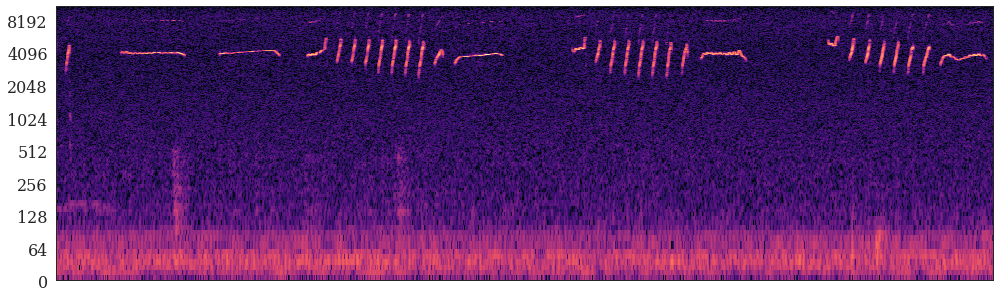

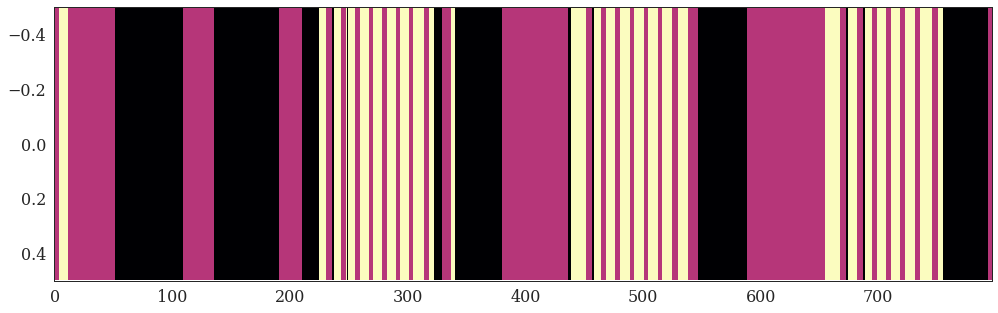

In [123]:
%matplotlib inline
import logging

import scipy
from sklearn import cluster, datasets
from itertools import cycle, islice

import numpy as np
import matplotlib.pyplot as plt

import librosa
import librosa.display

import python_speech_features

# # librosa.stft setting (n_fft=512 recommended for speech feature extraction))
# n_fft=512
# window_size_num_samples = n_fft
# window_shift_num_samples = window_size_num_samples // 4 # default shift of librosa.stft.
# window_size_ms = round((window_size_num_samples / sampling_rate) * 1000, ndigits=3)
# window_shift_ms = round((window_shift_num_samples / sampling_rate) * 1000, ndigits=3)

# Tacotron setting
window_size_ms=50
window_shift_ms=12.5
n_fft=int(window_size_ms / 1000 * sampling_rate)

# # # Kaldi setting
# # window_size_ms=25
# # window_shift_ms=10
# # n_fft=int(window_size_ms / 1000 * sampling_rate)

if (window_size_ms and window_shift_ms):
    fft_window_size = int(window_size_ms / 1000 * sampling_rate)
    fft_window_shift = int(window_shift_ms / 1000 * sampling_rate)
else:
    fft_window_size = n_fft # win_length: If unspecified for librosa.stft, defaults to ``win_length = n_fft``.
    fft_window_shift = fft_window_size // 4 # hop_length: If unspecified for librosa.stft, defaults to ``win_length // 4`` (see below).
    window_size_ms = (fft_window_size / sampling_rate) * 1000
    window_shift_ms = (fft_window_shift / sampling_rate) * 1000
    
numcep = 80 # 40  # the number of cepstrum to return, default 13
nfilt = 26 # the number of filters in the filterbank, default 26.
ceplifter=22 # apply a lifter to final cepstral coefficients. 0 is no lifter. Default is 22.

wav, sampling_rate = librosa.load(path, sr=sampling_rate)
# second_order_sections = scipy.signal.butter(N=16, Wn=4000, btype="highpass", analog=False, fs=sampling_rate, output='sos')
# wav = scipy.signal.sosfilt(second_order_sections, wav)
sources = python_speech_features.mfcc(wav, samplerate=sampling_rate, lowfreq=3000, winlen=window_size_ms/1000, winstep=window_shift_ms/1000, nfft=n_fft, numcep=numcep, nfilt=nfilt, ceplifter=ceplifter, appendEnergy=True)

D = sources.shape[1]
alpha = 1 # concentrate parameter
mu0 = np.mean(sources, axis = 0)
lmbda = 1 # belief of the mean
Sigma0 = np.cov(sources.T) # belief of the covariance
nu = D + 3 # belief of variance or degree of freedom
K0=3 # initial number of clusters
num_iterations = 1500
verbose=True

results = DPGMM3(alpha, mu0, lmbda, Sigma0, nu, sources, K0, num_iterations, verbose)
preds = np.argmax(results['z_posterior'], axis=1) # or preds = results['z']

print(preds)

y, sr = librosa.load(path, sr=48000)
D = librosa.stft(y)  # STFT of y
S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = librosa.display.specshow(S_db, cmap='magma', y_axis='log')
plt.gca().set_ylabel(None)# Turn off y labels

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = plt.imshow(preds[:,np.newaxis].T, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'

# MFCC26 + logMel26

[ 02/07/2022 17:59:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 0 - num_clusters: 3
[ 02/07/2022 17:59:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1 - num_clusters: 3
[ 02/07/2022 17:59:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 2 - num_clusters: 3
[ 02/07/2022 17:59:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 3 - num_clusters: 3
[ 02/07/2022 17:59:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 4 - num_clusters: 3
[ 02/07/2022 17:59:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 5 - num_clusters: 3
[ 02/07/2022 17:59:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 6 - num_clusters: 3
[ 02/07/2022 17:59:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 7 - num_clusters: 3
[ 02/07/2022 17:59:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 8 - num_clusters: 3
[ 02/07/2022 17:59:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 9 - num_clusters: 3
[ 02/07/2022 17:59:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 10 - num

[ 02/07/2022 17:59:58 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 89 - num_clusters: 3
[ 02/07/2022 17:59:58 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 90 - num_clusters: 3
[ 02/07/2022 17:59:58 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 91 - num_clusters: 3
[ 02/07/2022 17:59:58 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 92 - num_clusters: 3
[ 02/07/2022 17:59:58 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 93 - num_clusters: 3
[ 02/07/2022 17:59:58 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 94 - num_clusters: 3
[ 02/07/2022 17:59:58 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 95 - num_clusters: 3
[ 02/07/2022 17:59:58 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 96 - num_clusters: 3
[ 02/07/2022 17:59:58 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 97 - num_clusters: 3
[ 02/07/2022 17:59:58 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 98 - num_clusters: 3
[ 02/07/2022 17:59:58 | <ipython-input-160-a49e42be2f2d> | INFO ] iter

[ 02/07/2022 18:00:03 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 177 - num_clusters: 3
[ 02/07/2022 18:00:03 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 178 - num_clusters: 3
[ 02/07/2022 18:00:03 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 179 - num_clusters: 3
[ 02/07/2022 18:00:03 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 180 - num_clusters: 3
[ 02/07/2022 18:00:03 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 181 - num_clusters: 3
[ 02/07/2022 18:00:03 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 182 - num_clusters: 3
[ 02/07/2022 18:00:03 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 183 - num_clusters: 3
[ 02/07/2022 18:00:03 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 184 - num_clusters: 3
[ 02/07/2022 18:00:03 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 185 - num_clusters: 3
[ 02/07/2022 18:00:03 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 186 - num_clusters: 3
[ 02/07/2022 18:00:03 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:00:08 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 265 - num_clusters: 3
[ 02/07/2022 18:00:08 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 266 - num_clusters: 3
[ 02/07/2022 18:00:08 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 267 - num_clusters: 3
[ 02/07/2022 18:00:08 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 268 - num_clusters: 3
[ 02/07/2022 18:00:08 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 269 - num_clusters: 3
[ 02/07/2022 18:00:08 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 270 - num_clusters: 3
[ 02/07/2022 18:00:08 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 271 - num_clusters: 3
[ 02/07/2022 18:00:09 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 272 - num_clusters: 3
[ 02/07/2022 18:00:09 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 273 - num_clusters: 3
[ 02/07/2022 18:00:09 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 274 - num_clusters: 3
[ 02/07/2022 18:00:09 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:00:14 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 353 - num_clusters: 3
[ 02/07/2022 18:00:14 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 354 - num_clusters: 3
[ 02/07/2022 18:00:14 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 355 - num_clusters: 3
[ 02/07/2022 18:00:14 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 356 - num_clusters: 3
[ 02/07/2022 18:00:14 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 357 - num_clusters: 3
[ 02/07/2022 18:00:14 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 358 - num_clusters: 3
[ 02/07/2022 18:00:14 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 359 - num_clusters: 3
[ 02/07/2022 18:00:14 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 360 - num_clusters: 3
[ 02/07/2022 18:00:14 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 361 - num_clusters: 3
[ 02/07/2022 18:00:14 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 362 - num_clusters: 3
[ 02/07/2022 18:00:15 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:00:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 441 - num_clusters: 3
[ 02/07/2022 18:00:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 442 - num_clusters: 3
[ 02/07/2022 18:00:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 443 - num_clusters: 3
[ 02/07/2022 18:00:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 444 - num_clusters: 3
[ 02/07/2022 18:00:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 445 - num_clusters: 3
[ 02/07/2022 18:00:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 446 - num_clusters: 3
[ 02/07/2022 18:00:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 447 - num_clusters: 3
[ 02/07/2022 18:00:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 448 - num_clusters: 3
[ 02/07/2022 18:00:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 449 - num_clusters: 3
[ 02/07/2022 18:00:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 450 - num_clusters: 3
[ 02/07/2022 18:00:20 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:00:25 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 529 - num_clusters: 3
[ 02/07/2022 18:00:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 530 - num_clusters: 3
[ 02/07/2022 18:00:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 531 - num_clusters: 3
[ 02/07/2022 18:00:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 532 - num_clusters: 3
[ 02/07/2022 18:00:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 533 - num_clusters: 3
[ 02/07/2022 18:00:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 534 - num_clusters: 3
[ 02/07/2022 18:00:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 535 - num_clusters: 3
[ 02/07/2022 18:00:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 536 - num_clusters: 3
[ 02/07/2022 18:00:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 537 - num_clusters: 3
[ 02/07/2022 18:00:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 538 - num_clusters: 3
[ 02/07/2022 18:00:26 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:00:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 617 - num_clusters: 3
[ 02/07/2022 18:00:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 618 - num_clusters: 3
[ 02/07/2022 18:00:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 619 - num_clusters: 3
[ 02/07/2022 18:00:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 620 - num_clusters: 3
[ 02/07/2022 18:00:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 621 - num_clusters: 3
[ 02/07/2022 18:00:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 622 - num_clusters: 3
[ 02/07/2022 18:00:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 623 - num_clusters: 3
[ 02/07/2022 18:00:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 624 - num_clusters: 3
[ 02/07/2022 18:00:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 625 - num_clusters: 3
[ 02/07/2022 18:00:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 626 - num_clusters: 3
[ 02/07/2022 18:00:32 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:00:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 705 - num_clusters: 3
[ 02/07/2022 18:00:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 706 - num_clusters: 3
[ 02/07/2022 18:00:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 707 - num_clusters: 3
[ 02/07/2022 18:00:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 708 - num_clusters: 3
[ 02/07/2022 18:00:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 709 - num_clusters: 3
[ 02/07/2022 18:00:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 710 - num_clusters: 3
[ 02/07/2022 18:00:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 711 - num_clusters: 3
[ 02/07/2022 18:00:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 712 - num_clusters: 3
[ 02/07/2022 18:00:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 713 - num_clusters: 3
[ 02/07/2022 18:00:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 714 - num_clusters: 3
[ 02/07/2022 18:00:37 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:00:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 793 - num_clusters: 3
[ 02/07/2022 18:00:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 794 - num_clusters: 3
[ 02/07/2022 18:00:43 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 795 - num_clusters: 3
[ 02/07/2022 18:00:43 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 796 - num_clusters: 3
[ 02/07/2022 18:00:43 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 797 - num_clusters: 3
[ 02/07/2022 18:00:43 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 798 - num_clusters: 3
[ 02/07/2022 18:00:43 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 799 - num_clusters: 3
[ 02/07/2022 18:00:43 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 800 - num_clusters: 3
[ 02/07/2022 18:00:43 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 801 - num_clusters: 3
[ 02/07/2022 18:00:43 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 802 - num_clusters: 3
[ 02/07/2022 18:00:43 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:00:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 881 - num_clusters: 3
[ 02/07/2022 18:00:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 882 - num_clusters: 3
[ 02/07/2022 18:00:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 883 - num_clusters: 3
[ 02/07/2022 18:00:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 884 - num_clusters: 3
[ 02/07/2022 18:00:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 885 - num_clusters: 3
[ 02/07/2022 18:00:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 886 - num_clusters: 3
[ 02/07/2022 18:00:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 887 - num_clusters: 3
[ 02/07/2022 18:00:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 888 - num_clusters: 3
[ 02/07/2022 18:00:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 889 - num_clusters: 3
[ 02/07/2022 18:00:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 890 - num_clusters: 3
[ 02/07/2022 18:00:50 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:00:55 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 969 - num_clusters: 3
[ 02/07/2022 18:00:55 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 970 - num_clusters: 3
[ 02/07/2022 18:00:55 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 971 - num_clusters: 3
[ 02/07/2022 18:00:55 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 972 - num_clusters: 3
[ 02/07/2022 18:00:55 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 973 - num_clusters: 3
[ 02/07/2022 18:00:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 974 - num_clusters: 3
[ 02/07/2022 18:00:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 975 - num_clusters: 3
[ 02/07/2022 18:00:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 976 - num_clusters: 3
[ 02/07/2022 18:00:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 977 - num_clusters: 3
[ 02/07/2022 18:00:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 978 - num_clusters: 3
[ 02/07/2022 18:00:56 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:01:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1056 - num_clusters: 3
[ 02/07/2022 18:01:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1057 - num_clusters: 3
[ 02/07/2022 18:01:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1058 - num_clusters: 3
[ 02/07/2022 18:01:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1059 - num_clusters: 3
[ 02/07/2022 18:01:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1060 - num_clusters: 3
[ 02/07/2022 18:01:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1061 - num_clusters: 3
[ 02/07/2022 18:01:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1062 - num_clusters: 3
[ 02/07/2022 18:01:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1063 - num_clusters: 3
[ 02/07/2022 18:01:02 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1064 - num_clusters: 3
[ 02/07/2022 18:01:02 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1065 - num_clusters: 3
[ 02/07/2022 18:01:02 | <ipython-input-160-a49e42b

[ 02/07/2022 18:01:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1143 - num_clusters: 3
[ 02/07/2022 18:01:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1144 - num_clusters: 3
[ 02/07/2022 18:01:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1145 - num_clusters: 3
[ 02/07/2022 18:01:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1146 - num_clusters: 3
[ 02/07/2022 18:01:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1147 - num_clusters: 3
[ 02/07/2022 18:01:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1148 - num_clusters: 3
[ 02/07/2022 18:01:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1149 - num_clusters: 3
[ 02/07/2022 18:01:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1150 - num_clusters: 3
[ 02/07/2022 18:01:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1151 - num_clusters: 3
[ 02/07/2022 18:01:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1152 - num_clusters: 3
[ 02/07/2022 18:01:07 | <ipython-input-160-a49e42b

[ 02/07/2022 18:01:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1230 - num_clusters: 3
[ 02/07/2022 18:01:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1231 - num_clusters: 3
[ 02/07/2022 18:01:12 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1232 - num_clusters: 3
[ 02/07/2022 18:01:12 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1233 - num_clusters: 3
[ 02/07/2022 18:01:12 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1234 - num_clusters: 3
[ 02/07/2022 18:01:12 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1235 - num_clusters: 3
[ 02/07/2022 18:01:12 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1236 - num_clusters: 3
[ 02/07/2022 18:01:12 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1237 - num_clusters: 3
[ 02/07/2022 18:01:12 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1238 - num_clusters: 3
[ 02/07/2022 18:01:12 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1239 - num_clusters: 3
[ 02/07/2022 18:01:12 | <ipython-input-160-a49e42b

[ 02/07/2022 18:01:16 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1317 - num_clusters: 3
[ 02/07/2022 18:01:16 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1318 - num_clusters: 3
[ 02/07/2022 18:01:16 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1319 - num_clusters: 3
[ 02/07/2022 18:01:17 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1320 - num_clusters: 3
[ 02/07/2022 18:01:17 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1321 - num_clusters: 3
[ 02/07/2022 18:01:17 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1322 - num_clusters: 3
[ 02/07/2022 18:01:17 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1323 - num_clusters: 3
[ 02/07/2022 18:01:17 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1324 - num_clusters: 3
[ 02/07/2022 18:01:17 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1325 - num_clusters: 3
[ 02/07/2022 18:01:17 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1326 - num_clusters: 3
[ 02/07/2022 18:01:17 | <ipython-input-160-a49e42b

[ 02/07/2022 18:01:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1404 - num_clusters: 3
[ 02/07/2022 18:01:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1405 - num_clusters: 3
[ 02/07/2022 18:01:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1406 - num_clusters: 3
[ 02/07/2022 18:01:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1407 - num_clusters: 3
[ 02/07/2022 18:01:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1408 - num_clusters: 3
[ 02/07/2022 18:01:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1409 - num_clusters: 3
[ 02/07/2022 18:01:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1410 - num_clusters: 3
[ 02/07/2022 18:01:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1411 - num_clusters: 3
[ 02/07/2022 18:01:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1412 - num_clusters: 3
[ 02/07/2022 18:01:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1413 - num_clusters: 3
[ 02/07/2022 18:01:22 | <ipython-input-160-a49e42b

[ 02/07/2022 18:01:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1491 - num_clusters: 3
[ 02/07/2022 18:01:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1492 - num_clusters: 3
[ 02/07/2022 18:01:28 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1493 - num_clusters: 3
[ 02/07/2022 18:01:28 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1494 - num_clusters: 3
[ 02/07/2022 18:01:28 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1495 - num_clusters: 3
[ 02/07/2022 18:01:28 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1496 - num_clusters: 3
[ 02/07/2022 18:01:28 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1497 - num_clusters: 3
[ 02/07/2022 18:01:28 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1498 - num_clusters: 3
[ 02/07/2022 18:01:28 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1499 - num_clusters: 3
[1 1 1 1 1 2 2 2 2 2 2 2 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 2 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0

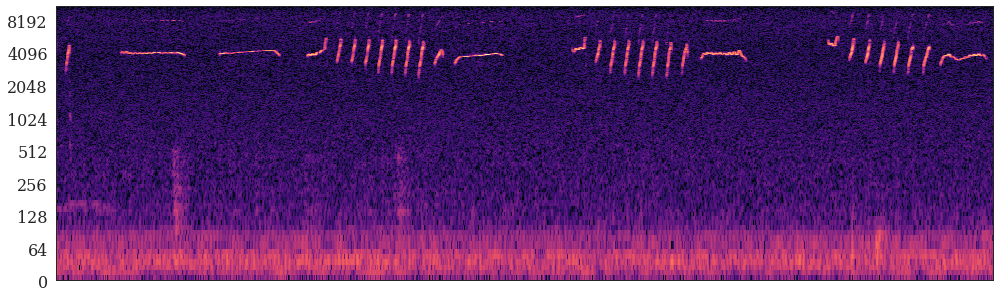

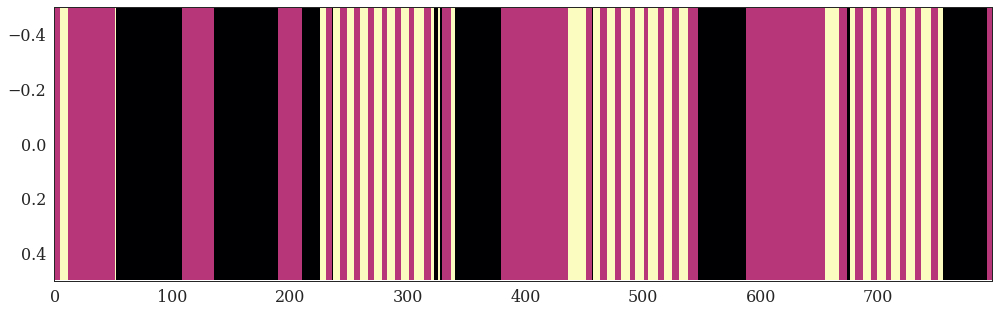

In [203]:
%matplotlib inline

# Energy + MFCC

num_mels=26
# window_size_ms=50
# window_shift_ms=12.5
spectrum_type="linear"
title=None
center=False
ref_db=20
preemphasis=0.97
min_db=-100
mean_norm=True,
mel_min_freq=3000
verbose=False
draw_verbose=False
# n_fft=int(window_size_ms / 1000 * sampling_rate)
figsize=(6.9*1.1, 4.2*1.1)

# Energy
energy_filter= {'filter': "butter", "filter_type": "highpass", "cutoff_freq": 4000, "order": 16}
energy = log_rms_energy(path=path, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, n_fft=n_fft, center=center, verbose=verbose, draw_verbose=draw_verbose, colorbar=colorbar, figsize=figsize)
logmel = librosa_spectrum_tacotron3(path=path, n_fft=n_fft, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, spectrum_type=spectrum_type, title=title, center=center, ref_db=ref_db, preemphasis=preemphasis, mel=num_mels, min_db=min_db, mean_norm=False, mel_min_freq=mel_min_freq, verbose=False, draw_verbose=False, figsize=figsize)
mfcc = librosa.feature.mfcc(sr=sampling_rate, S=logmel, n_mfcc=num_mels, dct_type=2, norm='ortho', lifter=0)

# Add energy: the zeroth coefficient is replaced with the log of the total frame rms energy.
# energy = (energy - energy.mean()) / energy.std()
mfcc[0] = energy
logmel[0] = energy

sources = mfcc.T

D = sources.shape[1]
alpha = 1 # concentrate parameter
mu0 = np.mean(sources, axis = 0)
lmbda = 1 # belief of the mean
Sigma0 = np.cov(sources.T) # belief of the covariance
nu = D + 3 # belief of variance or degree of freedom
K0=3 # initial number of clusters
num_iterations = 1500
verbose=True

results = DPGMM3(alpha, mu0, lmbda, Sigma0, nu, sources, K0, num_iterations, verbose)
preds = np.argmax(results['z_posterior'], axis=1) # or preds = results['z']

print(preds)

y, sr = librosa.load(path, sr=48000)
D = librosa.stft(y)  # STFT of y
S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = librosa.display.specshow(S_db, cmap='magma', y_axis='log')
plt.gca().set_ylabel(None)# Turn off y labels

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = plt.imshow(preds[:,np.newaxis].T, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'

[ 01/07/2022 21:35:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 0 - num_clusters: 3
[ 01/07/2022 21:35:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1 - num_clusters: 3
[ 01/07/2022 21:35:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 2 - num_clusters: 3
[ 01/07/2022 21:35:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 3 - num_clusters: 3
[ 01/07/2022 21:35:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 4 - num_clusters: 3
[ 01/07/2022 21:35:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 5 - num_clusters: 3
[ 01/07/2022 21:35:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 6 - num_clusters: 3
[ 01/07/2022 21:35:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 7 - num_clusters: 3
[ 01/07/2022 21:35:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 8 - num_clusters: 3
[ 01/07/2022 21:35:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 9 - num_clusters: 3
[ 01/07/2022 21:35:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 10 - num

[ 01/07/2022 21:35:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 89 - num_clusters: 3
[ 01/07/2022 21:35:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 90 - num_clusters: 3
[ 01/07/2022 21:35:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 91 - num_clusters: 3
[ 01/07/2022 21:35:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 92 - num_clusters: 3
[ 01/07/2022 21:35:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 93 - num_clusters: 3
[ 01/07/2022 21:35:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 94 - num_clusters: 3
[ 01/07/2022 21:35:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 95 - num_clusters: 3
[ 01/07/2022 21:35:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 96 - num_clusters: 3
[ 01/07/2022 21:35:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 97 - num_clusters: 3
[ 01/07/2022 21:35:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 98 - num_clusters: 3
[ 01/07/2022 21:35:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter

[ 01/07/2022 21:35:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 177 - num_clusters: 3
[ 01/07/2022 21:35:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 178 - num_clusters: 3
[ 01/07/2022 21:35:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 179 - num_clusters: 3
[ 01/07/2022 21:35:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 180 - num_clusters: 3
[ 01/07/2022 21:35:43 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 181 - num_clusters: 3
[ 01/07/2022 21:35:43 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 182 - num_clusters: 3
[ 01/07/2022 21:35:43 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 183 - num_clusters: 3
[ 01/07/2022 21:35:43 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 184 - num_clusters: 3
[ 01/07/2022 21:35:43 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 185 - num_clusters: 3
[ 01/07/2022 21:35:43 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 186 - num_clusters: 3
[ 01/07/2022 21:35:43 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 21:35:48 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 265 - num_clusters: 3
[ 01/07/2022 21:35:48 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 266 - num_clusters: 3
[ 01/07/2022 21:35:48 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 267 - num_clusters: 3
[ 01/07/2022 21:35:48 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 268 - num_clusters: 3
[ 01/07/2022 21:35:48 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 269 - num_clusters: 3
[ 01/07/2022 21:35:48 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 270 - num_clusters: 3
[ 01/07/2022 21:35:48 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 271 - num_clusters: 3
[ 01/07/2022 21:35:48 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 272 - num_clusters: 3
[ 01/07/2022 21:35:48 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 273 - num_clusters: 3
[ 01/07/2022 21:35:49 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 274 - num_clusters: 3
[ 01/07/2022 21:35:49 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 21:35:54 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 353 - num_clusters: 3
[ 01/07/2022 21:35:54 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 354 - num_clusters: 3
[ 01/07/2022 21:35:54 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 355 - num_clusters: 3
[ 01/07/2022 21:35:54 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 356 - num_clusters: 3
[ 01/07/2022 21:35:54 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 357 - num_clusters: 3
[ 01/07/2022 21:35:54 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 358 - num_clusters: 3
[ 01/07/2022 21:35:54 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 359 - num_clusters: 3
[ 01/07/2022 21:35:54 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 360 - num_clusters: 3
[ 01/07/2022 21:35:54 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 361 - num_clusters: 3
[ 01/07/2022 21:35:54 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 362 - num_clusters: 3
[ 01/07/2022 21:35:54 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 21:35:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 441 - num_clusters: 3
[ 01/07/2022 21:35:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 442 - num_clusters: 3
[ 01/07/2022 21:35:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 443 - num_clusters: 3
[ 01/07/2022 21:36:00 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 444 - num_clusters: 3
[ 01/07/2022 21:36:00 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 445 - num_clusters: 3
[ 01/07/2022 21:36:00 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 446 - num_clusters: 3
[ 01/07/2022 21:36:00 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 447 - num_clusters: 3
[ 01/07/2022 21:36:00 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 448 - num_clusters: 3
[ 01/07/2022 21:36:00 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 449 - num_clusters: 3
[ 01/07/2022 21:36:00 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 450 - num_clusters: 3
[ 01/07/2022 21:36:00 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 21:36:05 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 529 - num_clusters: 3
[ 01/07/2022 21:36:05 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 530 - num_clusters: 3
[ 01/07/2022 21:36:05 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 531 - num_clusters: 3
[ 01/07/2022 21:36:05 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 532 - num_clusters: 3
[ 01/07/2022 21:36:05 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 533 - num_clusters: 3
[ 01/07/2022 21:36:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 534 - num_clusters: 3
[ 01/07/2022 21:36:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 535 - num_clusters: 3
[ 01/07/2022 21:36:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 536 - num_clusters: 3
[ 01/07/2022 21:36:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 537 - num_clusters: 3
[ 01/07/2022 21:36:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 538 - num_clusters: 3
[ 01/07/2022 21:36:06 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 21:36:10 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 617 - num_clusters: 3
[ 01/07/2022 21:36:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 618 - num_clusters: 3
[ 01/07/2022 21:36:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 619 - num_clusters: 3
[ 01/07/2022 21:36:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 620 - num_clusters: 3
[ 01/07/2022 21:36:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 621 - num_clusters: 3
[ 01/07/2022 21:36:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 622 - num_clusters: 3
[ 01/07/2022 21:36:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 623 - num_clusters: 3
[ 01/07/2022 21:36:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 624 - num_clusters: 3
[ 01/07/2022 21:36:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 625 - num_clusters: 3
[ 01/07/2022 21:36:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 626 - num_clusters: 3
[ 01/07/2022 21:36:11 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 21:36:15 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 705 - num_clusters: 3
[ 01/07/2022 21:36:16 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 706 - num_clusters: 3
[ 01/07/2022 21:36:16 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 707 - num_clusters: 3
[ 01/07/2022 21:36:16 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 708 - num_clusters: 3
[ 01/07/2022 21:36:16 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 709 - num_clusters: 3
[ 01/07/2022 21:36:16 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 710 - num_clusters: 3
[ 01/07/2022 21:36:16 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 711 - num_clusters: 3
[ 01/07/2022 21:36:16 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 712 - num_clusters: 3
[ 01/07/2022 21:36:16 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 713 - num_clusters: 3
[ 01/07/2022 21:36:16 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 714 - num_clusters: 3
[ 01/07/2022 21:36:16 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 21:36:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 793 - num_clusters: 3
[ 01/07/2022 21:36:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 794 - num_clusters: 3
[ 01/07/2022 21:36:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 795 - num_clusters: 3
[ 01/07/2022 21:36:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 796 - num_clusters: 3
[ 01/07/2022 21:36:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 797 - num_clusters: 3
[ 01/07/2022 21:36:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 798 - num_clusters: 3
[ 01/07/2022 21:36:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 799 - num_clusters: 3
[ 01/07/2022 21:36:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 800 - num_clusters: 3
[ 01/07/2022 21:36:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 801 - num_clusters: 3
[ 01/07/2022 21:36:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 802 - num_clusters: 3
[ 01/07/2022 21:36:21 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 21:36:25 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 881 - num_clusters: 3
[ 01/07/2022 21:36:25 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 882 - num_clusters: 3
[ 01/07/2022 21:36:25 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 883 - num_clusters: 3
[ 01/07/2022 21:36:25 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 884 - num_clusters: 3
[ 01/07/2022 21:36:25 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 885 - num_clusters: 3
[ 01/07/2022 21:36:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 886 - num_clusters: 3
[ 01/07/2022 21:36:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 887 - num_clusters: 3
[ 01/07/2022 21:36:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 888 - num_clusters: 3
[ 01/07/2022 21:36:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 889 - num_clusters: 3
[ 01/07/2022 21:36:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 890 - num_clusters: 3
[ 01/07/2022 21:36:26 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 21:36:30 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 969 - num_clusters: 3
[ 01/07/2022 21:36:30 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 970 - num_clusters: 3
[ 01/07/2022 21:36:30 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 971 - num_clusters: 3
[ 01/07/2022 21:36:30 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 972 - num_clusters: 3
[ 01/07/2022 21:36:30 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 973 - num_clusters: 3
[ 01/07/2022 21:36:30 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 974 - num_clusters: 3
[ 01/07/2022 21:36:30 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 975 - num_clusters: 3
[ 01/07/2022 21:36:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 976 - num_clusters: 3
[ 01/07/2022 21:36:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 977 - num_clusters: 3
[ 01/07/2022 21:36:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 978 - num_clusters: 3
[ 01/07/2022 21:36:31 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 21:36:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1056 - num_clusters: 3
[ 01/07/2022 21:36:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1057 - num_clusters: 3
[ 01/07/2022 21:36:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1058 - num_clusters: 3
[ 01/07/2022 21:36:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1059 - num_clusters: 3
[ 01/07/2022 21:36:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1060 - num_clusters: 3
[ 01/07/2022 21:36:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1061 - num_clusters: 3
[ 01/07/2022 21:36:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1062 - num_clusters: 3
[ 01/07/2022 21:36:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1063 - num_clusters: 3
[ 01/07/2022 21:36:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1064 - num_clusters: 3
[ 01/07/2022 21:36:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1065 - num_clusters: 3
[ 01/07/2022 21:36:36 | <ipython-input-160-a49e42b

[ 01/07/2022 21:36:41 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1143 - num_clusters: 3
[ 01/07/2022 21:36:41 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1144 - num_clusters: 3
[ 01/07/2022 21:36:41 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1145 - num_clusters: 3
[ 01/07/2022 21:36:41 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1146 - num_clusters: 3
[ 01/07/2022 21:36:41 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1147 - num_clusters: 3
[ 01/07/2022 21:36:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1148 - num_clusters: 3
[ 01/07/2022 21:36:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1149 - num_clusters: 3
[ 01/07/2022 21:36:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1150 - num_clusters: 3
[ 01/07/2022 21:36:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1151 - num_clusters: 3
[ 01/07/2022 21:36:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1152 - num_clusters: 3
[ 01/07/2022 21:36:42 | <ipython-input-160-a49e42b

[ 01/07/2022 21:36:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1230 - num_clusters: 3
[ 01/07/2022 21:36:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1231 - num_clusters: 3
[ 01/07/2022 21:36:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1232 - num_clusters: 3
[ 01/07/2022 21:36:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1233 - num_clusters: 3
[ 01/07/2022 21:36:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1234 - num_clusters: 3
[ 01/07/2022 21:36:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1235 - num_clusters: 3
[ 01/07/2022 21:36:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1236 - num_clusters: 3
[ 01/07/2022 21:36:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1237 - num_clusters: 3
[ 01/07/2022 21:36:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1238 - num_clusters: 3
[ 01/07/2022 21:36:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1239 - num_clusters: 3
[ 01/07/2022 21:36:47 | <ipython-input-160-a49e42b

[ 01/07/2022 21:36:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1317 - num_clusters: 3
[ 01/07/2022 21:36:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1318 - num_clusters: 3
[ 01/07/2022 21:36:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1319 - num_clusters: 3
[ 01/07/2022 21:36:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1320 - num_clusters: 3
[ 01/07/2022 21:36:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1321 - num_clusters: 3
[ 01/07/2022 21:36:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1322 - num_clusters: 3
[ 01/07/2022 21:36:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1323 - num_clusters: 3
[ 01/07/2022 21:36:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1324 - num_clusters: 3
[ 01/07/2022 21:36:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1325 - num_clusters: 3
[ 01/07/2022 21:36:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1326 - num_clusters: 3
[ 01/07/2022 21:36:53 | <ipython-input-160-a49e42b

[ 01/07/2022 21:36:58 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1404 - num_clusters: 3
[ 01/07/2022 21:36:58 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1405 - num_clusters: 3
[ 01/07/2022 21:36:58 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1406 - num_clusters: 3
[ 01/07/2022 21:36:58 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1407 - num_clusters: 3
[ 01/07/2022 21:36:58 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1408 - num_clusters: 3
[ 01/07/2022 21:36:58 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1409 - num_clusters: 3
[ 01/07/2022 21:36:58 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1410 - num_clusters: 3
[ 01/07/2022 21:36:58 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1411 - num_clusters: 3
[ 01/07/2022 21:36:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1412 - num_clusters: 3
[ 01/07/2022 21:36:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1413 - num_clusters: 3
[ 01/07/2022 21:36:59 | <ipython-input-160-a49e42b

[ 01/07/2022 21:37:04 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1491 - num_clusters: 3
[ 01/07/2022 21:37:04 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1492 - num_clusters: 3
[ 01/07/2022 21:37:04 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1493 - num_clusters: 3
[ 01/07/2022 21:37:04 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1494 - num_clusters: 3
[ 01/07/2022 21:37:04 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1495 - num_clusters: 3
[ 01/07/2022 21:37:04 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1496 - num_clusters: 3
[ 01/07/2022 21:37:04 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1497 - num_clusters: 3
[ 01/07/2022 21:37:04 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1498 - num_clusters: 3
[ 01/07/2022 21:37:04 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1499 - num_clusters: 3
[2 2 2 2 2 0 0 0 0 0 0 1 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1

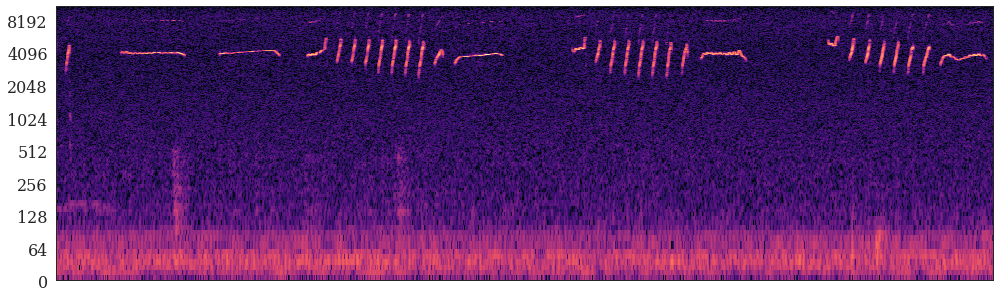

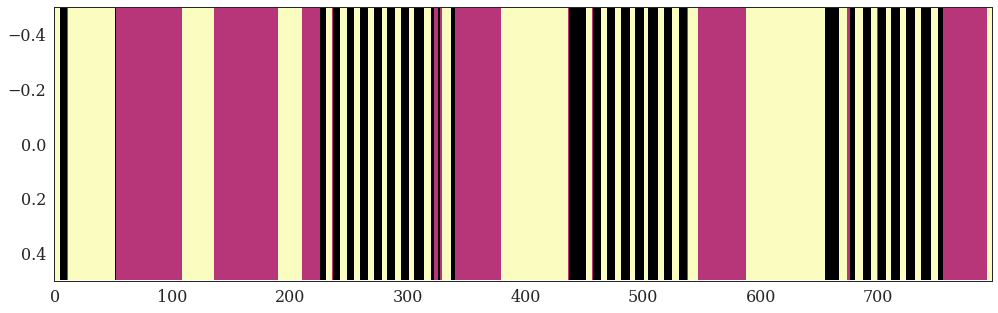

In [176]:
%matplotlib inline

# Energy + Logmel
num_mels=26
# window_size_ms=50
# window_shift_ms=12.5
spectrum_type="linear"
title=None
center=False
ref_db=20
preemphasis=0.97
min_db=-100
mean_norm=True,
mel_min_freq=3000
verbose=False
draw_verbose=False
# n_fft=int(window_size_ms / 1000 * sampling_rate)
figsize=(6.9*1.1, 4.2*1.1)

# Energy
energy_filter= {'filter': "butter", "filter_type": "highpass", "cutoff_freq": 4000, "order": 16}
energy = log_rms_energy(path=path, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, n_fft=n_fft, center=center, verbose=verbose, draw_verbose=draw_verbose, colorbar=colorbar, figsize=figsize)
logmel = librosa_spectrum_tacotron3(path=path, n_fft=n_fft, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, spectrum_type=spectrum_type, title=title, center=center, ref_db=ref_db, preemphasis=preemphasis, mel=num_mels, min_db=min_db, mean_norm=False, mel_min_freq=mel_min_freq, verbose=False, draw_verbose=False, figsize=figsize)
mfcc = librosa.feature.mfcc(sr=sampling_rate, S=logmel, n_mfcc=num_mels, dct_type=2, norm='ortho', lifter=0)

# Add energy: the zeroth coefficient is replaced with the log of the total frame rms energy.
# energy = (energy - energy.mean()) / energy.std()
mfcc[0] = energy
logmel[0] = energy

sources = logmel.T

D = sources.shape[1]
alpha = 1 # concentrate parameter
mu0 = np.mean(sources, axis = 0)
lmbda = 1 # belief of the mean
Sigma0 = np.cov(sources.T) # belief of the covariance
nu = D + 3 # belief of variance or degree of freedom
K0=3 # initial number of clusters
num_iterations = 1500
verbose=True

results = DPGMM3(alpha, mu0, lmbda, Sigma0, nu, sources, K0, num_iterations, verbose)
preds = np.argmax(results['z_posterior'], axis=1) # or preds = results['z']

print(preds)

y, sr = librosa.load(path, sr=48000)
D = librosa.stft(y)  # STFT of y
S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = librosa.display.specshow(S_db, cmap='magma', y_axis='log')
plt.gca().set_ylabel(None)# Turn off y labels

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = plt.imshow(preds[:,np.newaxis].T, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'

[ 01/07/2022 21:31:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 0 - num_clusters: 3
[ 01/07/2022 21:31:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1 - num_clusters: 3
[ 01/07/2022 21:31:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 2 - num_clusters: 3
[ 01/07/2022 21:31:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 3 - num_clusters: 3
[ 01/07/2022 21:31:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 4 - num_clusters: 3
[ 01/07/2022 21:31:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 5 - num_clusters: 3
[ 01/07/2022 21:31:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 6 - num_clusters: 3
[ 01/07/2022 21:31:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 7 - num_clusters: 3
[ 01/07/2022 21:31:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 8 - num_clusters: 3
[ 01/07/2022 21:31:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 9 - num_clusters: 3
[ 01/07/2022 21:31:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 10 - num

[ 01/07/2022 21:31:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 89 - num_clusters: 3
[ 01/07/2022 21:31:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 90 - num_clusters: 3
[ 01/07/2022 21:31:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 91 - num_clusters: 3
[ 01/07/2022 21:31:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 92 - num_clusters: 3
[ 01/07/2022 21:31:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 93 - num_clusters: 3
[ 01/07/2022 21:31:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 94 - num_clusters: 3
[ 01/07/2022 21:31:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 95 - num_clusters: 3
[ 01/07/2022 21:31:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 96 - num_clusters: 3
[ 01/07/2022 21:31:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 97 - num_clusters: 3
[ 01/07/2022 21:31:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 98 - num_clusters: 3
[ 01/07/2022 21:31:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter

[ 01/07/2022 21:31:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 177 - num_clusters: 3
[ 01/07/2022 21:31:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 178 - num_clusters: 3
[ 01/07/2022 21:31:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 179 - num_clusters: 3
[ 01/07/2022 21:31:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 180 - num_clusters: 3
[ 01/07/2022 21:31:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 181 - num_clusters: 3
[ 01/07/2022 21:31:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 182 - num_clusters: 3
[ 01/07/2022 21:31:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 183 - num_clusters: 3
[ 01/07/2022 21:31:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 184 - num_clusters: 3
[ 01/07/2022 21:31:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 185 - num_clusters: 3
[ 01/07/2022 21:31:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 186 - num_clusters: 3
[ 01/07/2022 21:31:32 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 21:31:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 265 - num_clusters: 3
[ 01/07/2022 21:31:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 266 - num_clusters: 3
[ 01/07/2022 21:31:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 267 - num_clusters: 3
[ 01/07/2022 21:31:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 268 - num_clusters: 3
[ 01/07/2022 21:31:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 269 - num_clusters: 3
[ 01/07/2022 21:31:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 270 - num_clusters: 3
[ 01/07/2022 21:31:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 271 - num_clusters: 3
[ 01/07/2022 21:31:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 272 - num_clusters: 3
[ 01/07/2022 21:31:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 273 - num_clusters: 3
[ 01/07/2022 21:31:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 274 - num_clusters: 3
[ 01/07/2022 21:31:37 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 21:31:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 353 - num_clusters: 3
[ 01/07/2022 21:31:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 354 - num_clusters: 3
[ 01/07/2022 21:31:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 355 - num_clusters: 3
[ 01/07/2022 21:31:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 356 - num_clusters: 3
[ 01/07/2022 21:31:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 357 - num_clusters: 3
[ 01/07/2022 21:31:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 358 - num_clusters: 3
[ 01/07/2022 21:31:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 359 - num_clusters: 3
[ 01/07/2022 21:31:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 360 - num_clusters: 3
[ 01/07/2022 21:31:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 361 - num_clusters: 3
[ 01/07/2022 21:31:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 362 - num_clusters: 3
[ 01/07/2022 21:31:42 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 21:31:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 441 - num_clusters: 3
[ 01/07/2022 21:31:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 442 - num_clusters: 3
[ 01/07/2022 21:31:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 443 - num_clusters: 3
[ 01/07/2022 21:31:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 444 - num_clusters: 3
[ 01/07/2022 21:31:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 445 - num_clusters: 3
[ 01/07/2022 21:31:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 446 - num_clusters: 3
[ 01/07/2022 21:31:48 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 447 - num_clusters: 3
[ 01/07/2022 21:31:48 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 448 - num_clusters: 3
[ 01/07/2022 21:31:48 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 449 - num_clusters: 3
[ 01/07/2022 21:31:48 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 450 - num_clusters: 3
[ 01/07/2022 21:31:48 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 21:31:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 529 - num_clusters: 3
[ 01/07/2022 21:31:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 530 - num_clusters: 3
[ 01/07/2022 21:31:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 531 - num_clusters: 3
[ 01/07/2022 21:31:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 532 - num_clusters: 3
[ 01/07/2022 21:31:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 533 - num_clusters: 3
[ 01/07/2022 21:31:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 534 - num_clusters: 3
[ 01/07/2022 21:31:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 535 - num_clusters: 3
[ 01/07/2022 21:31:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 536 - num_clusters: 3
[ 01/07/2022 21:31:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 537 - num_clusters: 3
[ 01/07/2022 21:31:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 538 - num_clusters: 3
[ 01/07/2022 21:31:53 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 21:31:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 617 - num_clusters: 3
[ 01/07/2022 21:31:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 618 - num_clusters: 3
[ 01/07/2022 21:31:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 619 - num_clusters: 3
[ 01/07/2022 21:31:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 620 - num_clusters: 3
[ 01/07/2022 21:31:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 621 - num_clusters: 3
[ 01/07/2022 21:31:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 622 - num_clusters: 3
[ 01/07/2022 21:31:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 623 - num_clusters: 3
[ 01/07/2022 21:31:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 624 - num_clusters: 3
[ 01/07/2022 21:31:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 625 - num_clusters: 3
[ 01/07/2022 21:31:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 626 - num_clusters: 3
[ 01/07/2022 21:31:59 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 21:32:04 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 705 - num_clusters: 3
[ 01/07/2022 21:32:04 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 706 - num_clusters: 3
[ 01/07/2022 21:32:04 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 707 - num_clusters: 3
[ 01/07/2022 21:32:04 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 708 - num_clusters: 3
[ 01/07/2022 21:32:04 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 709 - num_clusters: 3
[ 01/07/2022 21:32:05 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 710 - num_clusters: 3
[ 01/07/2022 21:32:05 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 711 - num_clusters: 3
[ 01/07/2022 21:32:05 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 712 - num_clusters: 3
[ 01/07/2022 21:32:05 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 713 - num_clusters: 3
[ 01/07/2022 21:32:05 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 714 - num_clusters: 3
[ 01/07/2022 21:32:05 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 21:32:10 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 793 - num_clusters: 3
[ 01/07/2022 21:32:10 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 794 - num_clusters: 3
[ 01/07/2022 21:32:10 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 795 - num_clusters: 3
[ 01/07/2022 21:32:10 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 796 - num_clusters: 3
[ 01/07/2022 21:32:10 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 797 - num_clusters: 3
[ 01/07/2022 21:32:10 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 798 - num_clusters: 3
[ 01/07/2022 21:32:10 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 799 - num_clusters: 3
[ 01/07/2022 21:32:10 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 800 - num_clusters: 3
[ 01/07/2022 21:32:10 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 801 - num_clusters: 3
[ 01/07/2022 21:32:10 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 802 - num_clusters: 3
[ 01/07/2022 21:32:10 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 21:32:15 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 881 - num_clusters: 3
[ 01/07/2022 21:32:15 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 882 - num_clusters: 3
[ 01/07/2022 21:32:15 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 883 - num_clusters: 3
[ 01/07/2022 21:32:15 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 884 - num_clusters: 3
[ 01/07/2022 21:32:15 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 885 - num_clusters: 3
[ 01/07/2022 21:32:16 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 886 - num_clusters: 3
[ 01/07/2022 21:32:16 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 887 - num_clusters: 3
[ 01/07/2022 21:32:16 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 888 - num_clusters: 3
[ 01/07/2022 21:32:16 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 889 - num_clusters: 3
[ 01/07/2022 21:32:16 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 890 - num_clusters: 3
[ 01/07/2022 21:32:16 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 21:32:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 969 - num_clusters: 3
[ 01/07/2022 21:32:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 970 - num_clusters: 3
[ 01/07/2022 21:32:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 971 - num_clusters: 3
[ 01/07/2022 21:32:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 972 - num_clusters: 3
[ 01/07/2022 21:32:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 973 - num_clusters: 3
[ 01/07/2022 21:32:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 974 - num_clusters: 3
[ 01/07/2022 21:32:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 975 - num_clusters: 3
[ 01/07/2022 21:32:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 976 - num_clusters: 3
[ 01/07/2022 21:32:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 977 - num_clusters: 3
[ 01/07/2022 21:32:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 978 - num_clusters: 3
[ 01/07/2022 21:32:21 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 21:32:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1056 - num_clusters: 3
[ 01/07/2022 21:32:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1057 - num_clusters: 3
[ 01/07/2022 21:32:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1058 - num_clusters: 3
[ 01/07/2022 21:32:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1059 - num_clusters: 3
[ 01/07/2022 21:32:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1060 - num_clusters: 3
[ 01/07/2022 21:32:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1061 - num_clusters: 3
[ 01/07/2022 21:32:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1062 - num_clusters: 3
[ 01/07/2022 21:32:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1063 - num_clusters: 3
[ 01/07/2022 21:32:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1064 - num_clusters: 3
[ 01/07/2022 21:32:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1065 - num_clusters: 3
[ 01/07/2022 21:32:27 | <ipython-input-160-a49e42b

[ 01/07/2022 21:32:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1143 - num_clusters: 3
[ 01/07/2022 21:32:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1144 - num_clusters: 3
[ 01/07/2022 21:32:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1145 - num_clusters: 3
[ 01/07/2022 21:32:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1146 - num_clusters: 3
[ 01/07/2022 21:32:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1147 - num_clusters: 3
[ 01/07/2022 21:32:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1148 - num_clusters: 3
[ 01/07/2022 21:32:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1149 - num_clusters: 3
[ 01/07/2022 21:32:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1150 - num_clusters: 3
[ 01/07/2022 21:32:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1151 - num_clusters: 3
[ 01/07/2022 21:32:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1152 - num_clusters: 3
[ 01/07/2022 21:32:32 | <ipython-input-160-a49e42b

[ 01/07/2022 21:32:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1230 - num_clusters: 3
[ 01/07/2022 21:32:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1231 - num_clusters: 3
[ 01/07/2022 21:32:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1232 - num_clusters: 3
[ 01/07/2022 21:32:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1233 - num_clusters: 3
[ 01/07/2022 21:32:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1234 - num_clusters: 3
[ 01/07/2022 21:32:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1235 - num_clusters: 3
[ 01/07/2022 21:32:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1236 - num_clusters: 3
[ 01/07/2022 21:32:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1237 - num_clusters: 3
[ 01/07/2022 21:32:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1238 - num_clusters: 3
[ 01/07/2022 21:32:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1239 - num_clusters: 3
[ 01/07/2022 21:32:38 | <ipython-input-160-a49e42b

[ 01/07/2022 21:32:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1317 - num_clusters: 3
[ 01/07/2022 21:32:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1318 - num_clusters: 3
[ 01/07/2022 21:32:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1319 - num_clusters: 3
[ 01/07/2022 21:32:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1320 - num_clusters: 3
[ 01/07/2022 21:32:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1321 - num_clusters: 3
[ 01/07/2022 21:32:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1322 - num_clusters: 3
[ 01/07/2022 21:32:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1323 - num_clusters: 3
[ 01/07/2022 21:32:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1324 - num_clusters: 3
[ 01/07/2022 21:32:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1325 - num_clusters: 3
[ 01/07/2022 21:32:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1326 - num_clusters: 3
[ 01/07/2022 21:32:43 | <ipython-input-160-a49e42b

[ 01/07/2022 21:32:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1404 - num_clusters: 3
[ 01/07/2022 21:32:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1405 - num_clusters: 3
[ 01/07/2022 21:32:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1406 - num_clusters: 3
[ 01/07/2022 21:32:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1407 - num_clusters: 3
[ 01/07/2022 21:32:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1408 - num_clusters: 3
[ 01/07/2022 21:32:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1409 - num_clusters: 3
[ 01/07/2022 21:32:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1410 - num_clusters: 3
[ 01/07/2022 21:32:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1411 - num_clusters: 3
[ 01/07/2022 21:32:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1412 - num_clusters: 3
[ 01/07/2022 21:32:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1413 - num_clusters: 3
[ 01/07/2022 21:32:47 | <ipython-input-160-a49e42b

[ 01/07/2022 21:32:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1491 - num_clusters: 3
[ 01/07/2022 21:32:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1492 - num_clusters: 3
[ 01/07/2022 21:32:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1493 - num_clusters: 3
[ 01/07/2022 21:32:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1494 - num_clusters: 3
[ 01/07/2022 21:32:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1495 - num_clusters: 3
[ 01/07/2022 21:32:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1496 - num_clusters: 3
[ 01/07/2022 21:32:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1497 - num_clusters: 3
[ 01/07/2022 21:32:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1498 - num_clusters: 3
[ 01/07/2022 21:32:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1499 - num_clusters: 3
[1 1 1 1 1 2 2 2 2 2 2 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0

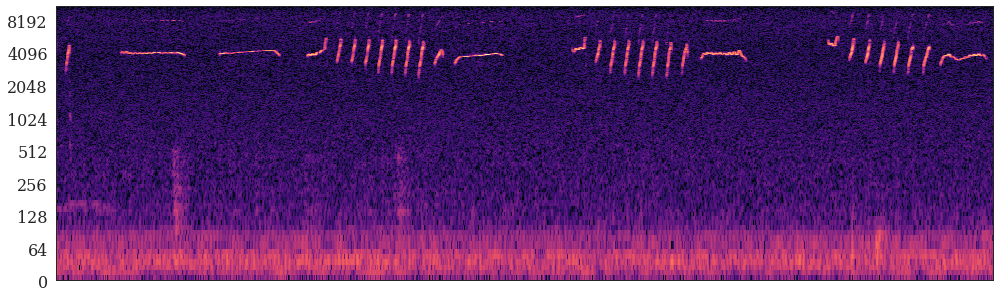

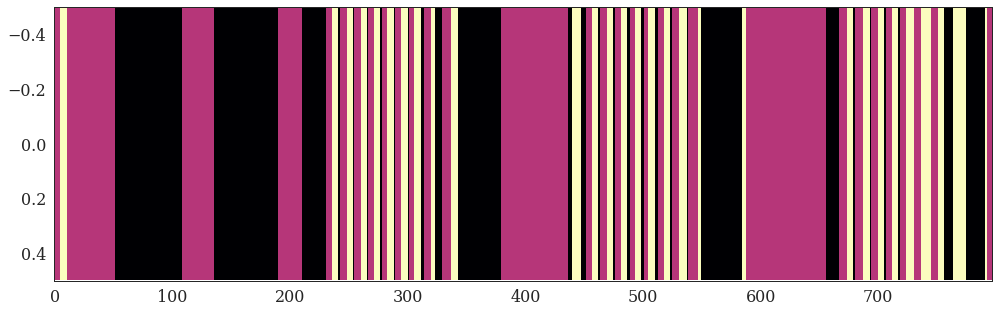

In [174]:
%matplotlib inline
# No Energy + MFCC

num_mels=26
# window_size_ms=50
# window_shift_ms=12.5
spectrum_type="linear"
title=None
center=False
ref_db=20
preemphasis=0.97
min_db=-100
mean_norm=True,
mel_min_freq=3000
verbose=False
draw_verbose=False
# n_fft=int(window_size_ms / 1000 * sampling_rate)
figsize=(6.9*1.1, 4.2*1.1)

# Energy
energy_filter= {'filter': "butter", "filter_type": "highpass", "cutoff_freq": 4000, "order": 16}
energy = log_rms_energy(path=path, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, n_fft=n_fft, center=center, verbose=verbose, draw_verbose=draw_verbose, colorbar=colorbar, figsize=figsize)
logmel = librosa_spectrum_tacotron3(path=path, n_fft=n_fft, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, spectrum_type=spectrum_type, title=title, center=center, ref_db=ref_db, preemphasis=preemphasis, mel=num_mels, min_db=min_db, mean_norm=False, mel_min_freq=mel_min_freq, verbose=False, draw_verbose=False, figsize=figsize)
mfcc = librosa.feature.mfcc(sr=sampling_rate, S=logmel, n_mfcc=num_mels, dct_type=2, norm='ortho', lifter=0)

# # Add energy: the zeroth coefficient is replaced with the log of the total frame rms energy.
# # energy = (energy - energy.mean()) / energy.std()
# mfcc[0] = energy
# logmel[0] = energy

sources = mfcc.T

D = sources.shape[1]
alpha = 1 # concentrate parameter
mu0 = np.mean(sources, axis = 0)
lmbda = 1 # belief of the mean
Sigma0 = np.cov(sources.T) # belief of the covariance
nu = D + 3 # belief of variance or degree of freedom
K0=3 # initial number of clusters
num_iterations = 1500
verbose=True

results = DPGMM3(alpha, mu0, lmbda, Sigma0, nu, sources, K0, num_iterations, verbose)
preds = np.argmax(results['z_posterior'], axis=1) # or preds = results['z']

print(preds)

y, sr = librosa.load(path, sr=48000)
D = librosa.stft(y)  # STFT of y
S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = librosa.display.specshow(S_db, cmap='magma', y_axis='log')
plt.gca().set_ylabel(None)# Turn off y labels

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = plt.imshow(preds[:,np.newaxis].T, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'

[ 01/07/2022 21:32:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 0 - num_clusters: 3
[ 01/07/2022 21:32:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1 - num_clusters: 3
[ 01/07/2022 21:32:54 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 2 - num_clusters: 3
[ 01/07/2022 21:32:54 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 3 - num_clusters: 3
[ 01/07/2022 21:32:54 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 4 - num_clusters: 3
[ 01/07/2022 21:32:54 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 5 - num_clusters: 3
[ 01/07/2022 21:32:54 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 6 - num_clusters: 3
[ 01/07/2022 21:32:54 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 7 - num_clusters: 3
[ 01/07/2022 21:32:54 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 8 - num_clusters: 3
[ 01/07/2022 21:32:54 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 9 - num_clusters: 3
[ 01/07/2022 21:32:54 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 10 - num

[ 01/07/2022 21:32:58 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 89 - num_clusters: 3
[ 01/07/2022 21:32:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 90 - num_clusters: 3
[ 01/07/2022 21:32:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 91 - num_clusters: 3
[ 01/07/2022 21:32:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 92 - num_clusters: 3
[ 01/07/2022 21:32:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 93 - num_clusters: 3
[ 01/07/2022 21:32:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 94 - num_clusters: 3
[ 01/07/2022 21:32:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 95 - num_clusters: 3
[ 01/07/2022 21:32:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 96 - num_clusters: 3
[ 01/07/2022 21:32:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 97 - num_clusters: 3
[ 01/07/2022 21:32:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 98 - num_clusters: 3
[ 01/07/2022 21:32:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter

[ 01/07/2022 21:33:04 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 177 - num_clusters: 3
[ 01/07/2022 21:33:04 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 178 - num_clusters: 3
[ 01/07/2022 21:33:04 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 179 - num_clusters: 3
[ 01/07/2022 21:33:04 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 180 - num_clusters: 3
[ 01/07/2022 21:33:04 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 181 - num_clusters: 3
[ 01/07/2022 21:33:04 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 182 - num_clusters: 3
[ 01/07/2022 21:33:04 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 183 - num_clusters: 3
[ 01/07/2022 21:33:04 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 184 - num_clusters: 3
[ 01/07/2022 21:33:04 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 185 - num_clusters: 3
[ 01/07/2022 21:33:04 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 186 - num_clusters: 3
[ 01/07/2022 21:33:04 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 21:33:09 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 265 - num_clusters: 3
[ 01/07/2022 21:33:09 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 266 - num_clusters: 3
[ 01/07/2022 21:33:09 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 267 - num_clusters: 3
[ 01/07/2022 21:33:09 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 268 - num_clusters: 3
[ 01/07/2022 21:33:09 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 269 - num_clusters: 3
[ 01/07/2022 21:33:09 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 270 - num_clusters: 3
[ 01/07/2022 21:33:09 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 271 - num_clusters: 3
[ 01/07/2022 21:33:09 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 272 - num_clusters: 3
[ 01/07/2022 21:33:09 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 273 - num_clusters: 3
[ 01/07/2022 21:33:09 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 274 - num_clusters: 3
[ 01/07/2022 21:33:09 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 21:33:14 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 353 - num_clusters: 3
[ 01/07/2022 21:33:15 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 354 - num_clusters: 3
[ 01/07/2022 21:33:15 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 355 - num_clusters: 3
[ 01/07/2022 21:33:15 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 356 - num_clusters: 3
[ 01/07/2022 21:33:15 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 357 - num_clusters: 3
[ 01/07/2022 21:33:15 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 358 - num_clusters: 3
[ 01/07/2022 21:33:15 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 359 - num_clusters: 3
[ 01/07/2022 21:33:15 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 360 - num_clusters: 3
[ 01/07/2022 21:33:15 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 361 - num_clusters: 3
[ 01/07/2022 21:33:15 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 362 - num_clusters: 3
[ 01/07/2022 21:33:15 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 21:33:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 441 - num_clusters: 3
[ 01/07/2022 21:33:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 442 - num_clusters: 3
[ 01/07/2022 21:33:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 443 - num_clusters: 3
[ 01/07/2022 21:33:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 444 - num_clusters: 3
[ 01/07/2022 21:33:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 445 - num_clusters: 3
[ 01/07/2022 21:33:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 446 - num_clusters: 3
[ 01/07/2022 21:33:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 447 - num_clusters: 3
[ 01/07/2022 21:33:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 448 - num_clusters: 3
[ 01/07/2022 21:33:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 449 - num_clusters: 3
[ 01/07/2022 21:33:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 450 - num_clusters: 3
[ 01/07/2022 21:33:21 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 21:33:25 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 529 - num_clusters: 3
[ 01/07/2022 21:33:25 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 530 - num_clusters: 3
[ 01/07/2022 21:33:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 531 - num_clusters: 3
[ 01/07/2022 21:33:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 532 - num_clusters: 3
[ 01/07/2022 21:33:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 533 - num_clusters: 3
[ 01/07/2022 21:33:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 534 - num_clusters: 3
[ 01/07/2022 21:33:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 535 - num_clusters: 3
[ 01/07/2022 21:33:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 536 - num_clusters: 3
[ 01/07/2022 21:33:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 537 - num_clusters: 3
[ 01/07/2022 21:33:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 538 - num_clusters: 3
[ 01/07/2022 21:33:26 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 21:33:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 617 - num_clusters: 3
[ 01/07/2022 21:33:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 618 - num_clusters: 3
[ 01/07/2022 21:33:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 619 - num_clusters: 3
[ 01/07/2022 21:33:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 620 - num_clusters: 3
[ 01/07/2022 21:33:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 621 - num_clusters: 3
[ 01/07/2022 21:33:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 622 - num_clusters: 3
[ 01/07/2022 21:33:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 623 - num_clusters: 3
[ 01/07/2022 21:33:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 624 - num_clusters: 3
[ 01/07/2022 21:33:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 625 - num_clusters: 3
[ 01/07/2022 21:33:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 626 - num_clusters: 3
[ 01/07/2022 21:33:31 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 21:33:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 705 - num_clusters: 3
[ 01/07/2022 21:33:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 706 - num_clusters: 3
[ 01/07/2022 21:33:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 707 - num_clusters: 3
[ 01/07/2022 21:33:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 708 - num_clusters: 3
[ 01/07/2022 21:33:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 709 - num_clusters: 3
[ 01/07/2022 21:33:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 710 - num_clusters: 3
[ 01/07/2022 21:33:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 711 - num_clusters: 3
[ 01/07/2022 21:33:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 712 - num_clusters: 3
[ 01/07/2022 21:33:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 713 - num_clusters: 3
[ 01/07/2022 21:33:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 714 - num_clusters: 3
[ 01/07/2022 21:33:36 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 21:33:41 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 793 - num_clusters: 3
[ 01/07/2022 21:33:41 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 794 - num_clusters: 3
[ 01/07/2022 21:33:41 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 795 - num_clusters: 3
[ 01/07/2022 21:33:41 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 796 - num_clusters: 3
[ 01/07/2022 21:33:41 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 797 - num_clusters: 3
[ 01/07/2022 21:33:41 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 798 - num_clusters: 3
[ 01/07/2022 21:33:41 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 799 - num_clusters: 3
[ 01/07/2022 21:33:41 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 800 - num_clusters: 3
[ 01/07/2022 21:33:41 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 801 - num_clusters: 3
[ 01/07/2022 21:33:41 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 802 - num_clusters: 3
[ 01/07/2022 21:33:41 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 21:33:46 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 881 - num_clusters: 3
[ 01/07/2022 21:33:46 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 882 - num_clusters: 3
[ 01/07/2022 21:33:46 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 883 - num_clusters: 3
[ 01/07/2022 21:33:46 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 884 - num_clusters: 3
[ 01/07/2022 21:33:46 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 885 - num_clusters: 3
[ 01/07/2022 21:33:46 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 886 - num_clusters: 3
[ 01/07/2022 21:33:46 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 887 - num_clusters: 3
[ 01/07/2022 21:33:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 888 - num_clusters: 3
[ 01/07/2022 21:33:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 889 - num_clusters: 3
[ 01/07/2022 21:33:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 890 - num_clusters: 3
[ 01/07/2022 21:33:47 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 21:33:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 969 - num_clusters: 3
[ 01/07/2022 21:33:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 970 - num_clusters: 3
[ 01/07/2022 21:33:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 971 - num_clusters: 3
[ 01/07/2022 21:33:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 972 - num_clusters: 3
[ 01/07/2022 21:33:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 973 - num_clusters: 3
[ 01/07/2022 21:33:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 974 - num_clusters: 3
[ 01/07/2022 21:33:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 975 - num_clusters: 3
[ 01/07/2022 21:33:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 976 - num_clusters: 3
[ 01/07/2022 21:33:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 977 - num_clusters: 3
[ 01/07/2022 21:33:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 978 - num_clusters: 3
[ 01/07/2022 21:33:52 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 21:33:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1056 - num_clusters: 3
[ 01/07/2022 21:33:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1057 - num_clusters: 3
[ 01/07/2022 21:33:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1058 - num_clusters: 3
[ 01/07/2022 21:33:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1059 - num_clusters: 3
[ 01/07/2022 21:33:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1060 - num_clusters: 3
[ 01/07/2022 21:33:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1061 - num_clusters: 3
[ 01/07/2022 21:33:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1062 - num_clusters: 3
[ 01/07/2022 21:33:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1063 - num_clusters: 3
[ 01/07/2022 21:33:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1064 - num_clusters: 3
[ 01/07/2022 21:33:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1065 - num_clusters: 3
[ 01/07/2022 21:33:56 | <ipython-input-160-a49e42b

[ 01/07/2022 21:34:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1143 - num_clusters: 3
[ 01/07/2022 21:34:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1144 - num_clusters: 3
[ 01/07/2022 21:34:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1145 - num_clusters: 3
[ 01/07/2022 21:34:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1146 - num_clusters: 3
[ 01/07/2022 21:34:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1147 - num_clusters: 3
[ 01/07/2022 21:34:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1148 - num_clusters: 3
[ 01/07/2022 21:34:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1149 - num_clusters: 3
[ 01/07/2022 21:34:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1150 - num_clusters: 3
[ 01/07/2022 21:34:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1151 - num_clusters: 3
[ 01/07/2022 21:34:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1152 - num_clusters: 3
[ 01/07/2022 21:34:01 | <ipython-input-160-a49e42b

[ 01/07/2022 21:34:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1230 - num_clusters: 3
[ 01/07/2022 21:34:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1231 - num_clusters: 3
[ 01/07/2022 21:34:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1232 - num_clusters: 3
[ 01/07/2022 21:34:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1233 - num_clusters: 3
[ 01/07/2022 21:34:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1234 - num_clusters: 3
[ 01/07/2022 21:34:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1235 - num_clusters: 3
[ 01/07/2022 21:34:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1236 - num_clusters: 3
[ 01/07/2022 21:34:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1237 - num_clusters: 3
[ 01/07/2022 21:34:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1238 - num_clusters: 3
[ 01/07/2022 21:34:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1239 - num_clusters: 3
[ 01/07/2022 21:34:07 | <ipython-input-160-a49e42b

[ 01/07/2022 21:34:12 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1317 - num_clusters: 3
[ 01/07/2022 21:34:12 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1318 - num_clusters: 3
[ 01/07/2022 21:34:12 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1319 - num_clusters: 3
[ 01/07/2022 21:34:12 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1320 - num_clusters: 3
[ 01/07/2022 21:34:12 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1321 - num_clusters: 3
[ 01/07/2022 21:34:12 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1322 - num_clusters: 3
[ 01/07/2022 21:34:12 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1323 - num_clusters: 3
[ 01/07/2022 21:34:12 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1324 - num_clusters: 3
[ 01/07/2022 21:34:12 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1325 - num_clusters: 3
[ 01/07/2022 21:34:12 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1326 - num_clusters: 3
[ 01/07/2022 21:34:12 | <ipython-input-160-a49e42b

[ 01/07/2022 21:34:17 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1404 - num_clusters: 3
[ 01/07/2022 21:34:17 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1405 - num_clusters: 3
[ 01/07/2022 21:34:17 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1406 - num_clusters: 3
[ 01/07/2022 21:34:17 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1407 - num_clusters: 3
[ 01/07/2022 21:34:18 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1408 - num_clusters: 3
[ 01/07/2022 21:34:18 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1409 - num_clusters: 3
[ 01/07/2022 21:34:18 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1410 - num_clusters: 3
[ 01/07/2022 21:34:18 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1411 - num_clusters: 3
[ 01/07/2022 21:34:18 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1412 - num_clusters: 3
[ 01/07/2022 21:34:18 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1413 - num_clusters: 3
[ 01/07/2022 21:34:18 | <ipython-input-160-a49e42b

[ 01/07/2022 21:34:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1491 - num_clusters: 3
[ 01/07/2022 21:34:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1492 - num_clusters: 3
[ 01/07/2022 21:34:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1493 - num_clusters: 3
[ 01/07/2022 21:34:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1494 - num_clusters: 3
[ 01/07/2022 21:34:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1495 - num_clusters: 3
[ 01/07/2022 21:34:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1496 - num_clusters: 3
[ 01/07/2022 21:34:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1497 - num_clusters: 3
[ 01/07/2022 21:34:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1498 - num_clusters: 3
[ 01/07/2022 21:34:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1499 - num_clusters: 3
[2 2 2 2 2 1 1 1 0 0 0 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1

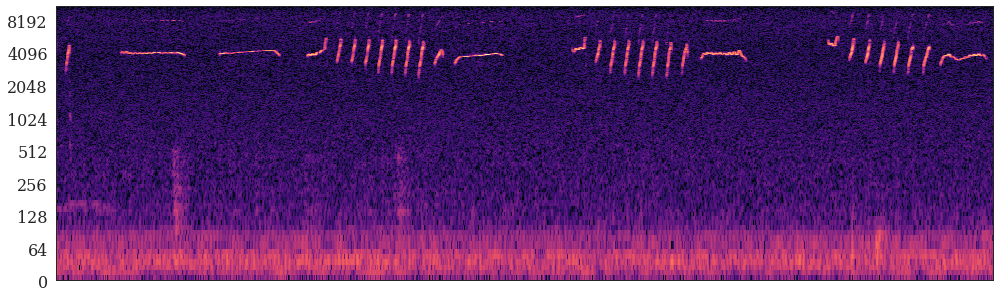

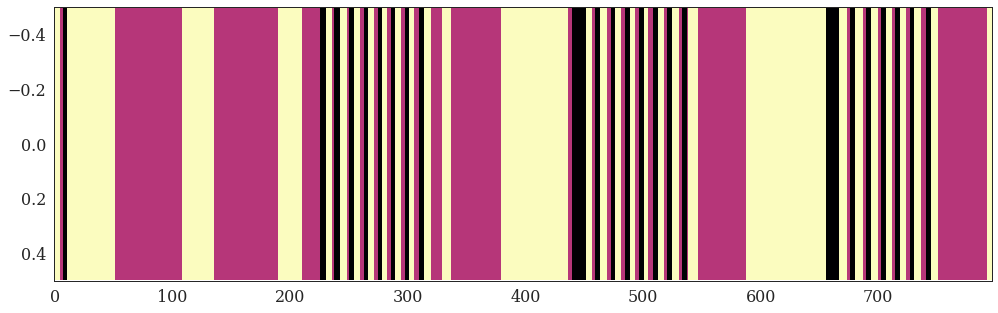

In [175]:
%matplotlib inline

# NoEnergy + Logmel

num_mels=26
# window_size_ms=50
# window_shift_ms=12.5
spectrum_type="linear"
title=None
center=False
ref_db=20
preemphasis=0.97
min_db=-100
mean_norm=True,
mel_min_freq=3000
verbose=False
draw_verbose=False
# n_fft=int(window_size_ms / 1000 * sampling_rate)
figsize=(6.9*1.1, 4.2*1.1)

# Energy
energy_filter= {'filter': "butter", "filter_type": "highpass", "cutoff_freq": 4000, "order": 16}
energy = log_rms_energy(path=path, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, n_fft=n_fft, center=center, verbose=verbose, draw_verbose=draw_verbose, colorbar=colorbar, figsize=figsize)
logmel = librosa_spectrum_tacotron3(path=path, n_fft=n_fft, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, spectrum_type=spectrum_type, title=title, center=center, ref_db=ref_db, preemphasis=preemphasis, mel=num_mels, min_db=min_db, mean_norm=False, mel_min_freq=mel_min_freq, verbose=False, draw_verbose=False, figsize=figsize)
mfcc = librosa.feature.mfcc(sr=sampling_rate, S=logmel, n_mfcc=num_mels, dct_type=2, norm='ortho', lifter=0)

# # Add energy: the zeroth coefficient is replaced with the log of the total frame rms energy.
# # energy = (energy - energy.mean()) / energy.std()
# mfcc[0] = energy
# logmel[0] = energy

sources = logmel.T

D = sources.shape[1]
alpha = 1 # concentrate parameter
mu0 = np.mean(sources, axis = 0)
lmbda = 1 # belief of the mean
Sigma0 = np.cov(sources.T) # belief of the covariance
nu = D + 3 # belief of variance or degree of freedom
K0=3 # initial number of clusters
num_iterations = 1500
verbose=True

results = DPGMM3(alpha, mu0, lmbda, Sigma0, nu, sources, K0, num_iterations, verbose)
preds = np.argmax(results['z_posterior'], axis=1) # or preds = results['z']

print(preds)

y, sr = librosa.load(path, sr=48000)
D = librosa.stft(y)  # STFT of y
S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = librosa.display.specshow(S_db, cmap='magma', y_axis='log')
plt.gca().set_ylabel(None)# Turn off y labels

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = plt.imshow(preds[:,np.newaxis].T, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'

# MFCC13+logmel13

[ 03/07/2022 20:27:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 0 - num_clusters: 3
[ 03/07/2022 20:27:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1 - num_clusters: 3
[ 03/07/2022 20:27:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 2 - num_clusters: 3
[ 03/07/2022 20:27:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 3 - num_clusters: 3
[ 03/07/2022 20:27:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 4 - num_clusters: 3
[ 03/07/2022 20:27:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 5 - num_clusters: 3
[ 03/07/2022 20:27:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 6 - num_clusters: 3
[ 03/07/2022 20:27:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 7 - num_clusters: 3
[ 03/07/2022 20:27:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 8 - num_clusters: 3
[ 03/07/2022 20:27:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 9 - num_clusters: 3
[ 03/07/2022 20:27:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 10 - num

[ 03/07/2022 20:27:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 89 - num_clusters: 5
[ 03/07/2022 20:27:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 90 - num_clusters: 5
[ 03/07/2022 20:27:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 91 - num_clusters: 5
[ 03/07/2022 20:27:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 92 - num_clusters: 5
[ 03/07/2022 20:27:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 93 - num_clusters: 5
[ 03/07/2022 20:27:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 94 - num_clusters: 5
[ 03/07/2022 20:27:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 95 - num_clusters: 5
[ 03/07/2022 20:27:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 96 - num_clusters: 5
[ 03/07/2022 20:27:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 97 - num_clusters: 5
[ 03/07/2022 20:27:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 98 - num_clusters: 5
[ 03/07/2022 20:27:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter

[ 03/07/2022 20:27:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 177 - num_clusters: 6
[ 03/07/2022 20:27:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 178 - num_clusters: 6
[ 03/07/2022 20:27:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 179 - num_clusters: 6
[ 03/07/2022 20:27:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 180 - num_clusters: 6
[ 03/07/2022 20:27:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 181 - num_clusters: 6
[ 03/07/2022 20:27:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 182 - num_clusters: 6
[ 03/07/2022 20:27:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 183 - num_clusters: 6
[ 03/07/2022 20:27:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 184 - num_clusters: 6
[ 03/07/2022 20:27:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 185 - num_clusters: 6
[ 03/07/2022 20:27:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 186 - num_clusters: 6
[ 03/07/2022 20:27:31 | <ipython-input-160-a49e42be2f2d> | I

[ 03/07/2022 20:27:35 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 265 - num_clusters: 6
[ 03/07/2022 20:27:35 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 266 - num_clusters: 6
[ 03/07/2022 20:27:35 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 267 - num_clusters: 6
[ 03/07/2022 20:27:35 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 268 - num_clusters: 6
[ 03/07/2022 20:27:35 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 269 - num_clusters: 6
[ 03/07/2022 20:27:35 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 270 - num_clusters: 6
[ 03/07/2022 20:27:35 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 271 - num_clusters: 6
[ 03/07/2022 20:27:35 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 272 - num_clusters: 6
[ 03/07/2022 20:27:35 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 273 - num_clusters: 6
[ 03/07/2022 20:27:35 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 274 - num_clusters: 6
[ 03/07/2022 20:27:36 | <ipython-input-160-a49e42be2f2d> | I

[ 03/07/2022 20:27:40 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 353 - num_clusters: 6
[ 03/07/2022 20:27:40 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 354 - num_clusters: 6
[ 03/07/2022 20:27:40 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 355 - num_clusters: 6
[ 03/07/2022 20:27:40 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 356 - num_clusters: 6
[ 03/07/2022 20:27:40 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 357 - num_clusters: 6
[ 03/07/2022 20:27:40 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 358 - num_clusters: 6
[ 03/07/2022 20:27:40 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 359 - num_clusters: 6
[ 03/07/2022 20:27:40 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 360 - num_clusters: 6
[ 03/07/2022 20:27:40 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 361 - num_clusters: 6
[ 03/07/2022 20:27:40 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 362 - num_clusters: 6
[ 03/07/2022 20:27:40 | <ipython-input-160-a49e42be2f2d> | I

[ 03/07/2022 20:27:45 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 441 - num_clusters: 6
[ 03/07/2022 20:27:45 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 442 - num_clusters: 6
[ 03/07/2022 20:27:45 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 443 - num_clusters: 6
[ 03/07/2022 20:27:45 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 444 - num_clusters: 6
[ 03/07/2022 20:27:45 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 445 - num_clusters: 6
[ 03/07/2022 20:27:45 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 446 - num_clusters: 6
[ 03/07/2022 20:27:45 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 447 - num_clusters: 6
[ 03/07/2022 20:27:45 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 448 - num_clusters: 6
[ 03/07/2022 20:27:45 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 449 - num_clusters: 6
[ 03/07/2022 20:27:45 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 450 - num_clusters: 6
[ 03/07/2022 20:27:45 | <ipython-input-160-a49e42be2f2d> | I

[ 03/07/2022 20:27:49 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 529 - num_clusters: 6
[ 03/07/2022 20:27:49 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 530 - num_clusters: 6
[ 03/07/2022 20:27:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 531 - num_clusters: 6
[ 03/07/2022 20:27:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 532 - num_clusters: 6
[ 03/07/2022 20:27:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 533 - num_clusters: 6
[ 03/07/2022 20:27:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 534 - num_clusters: 6
[ 03/07/2022 20:27:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 535 - num_clusters: 6
[ 03/07/2022 20:27:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 536 - num_clusters: 6
[ 03/07/2022 20:27:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 537 - num_clusters: 6
[ 03/07/2022 20:27:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 538 - num_clusters: 6
[ 03/07/2022 20:27:50 | <ipython-input-160-a49e42be2f2d> | I

[ 03/07/2022 20:27:55 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 617 - num_clusters: 6
[ 03/07/2022 20:27:55 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 618 - num_clusters: 6
[ 03/07/2022 20:27:55 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 619 - num_clusters: 6
[ 03/07/2022 20:27:55 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 620 - num_clusters: 6
[ 03/07/2022 20:27:55 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 621 - num_clusters: 6
[ 03/07/2022 20:27:55 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 622 - num_clusters: 6
[ 03/07/2022 20:27:55 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 623 - num_clusters: 6
[ 03/07/2022 20:27:55 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 624 - num_clusters: 6
[ 03/07/2022 20:27:55 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 625 - num_clusters: 6
[ 03/07/2022 20:27:55 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 626 - num_clusters: 7
[ 03/07/2022 20:27:55 | <ipython-input-160-a49e42be2f2d> | I

[ 03/07/2022 20:28:00 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 705 - num_clusters: 6
[ 03/07/2022 20:28:00 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 706 - num_clusters: 6
[ 03/07/2022 20:28:00 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 707 - num_clusters: 6
[ 03/07/2022 20:28:00 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 708 - num_clusters: 6
[ 03/07/2022 20:28:00 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 709 - num_clusters: 6
[ 03/07/2022 20:28:00 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 710 - num_clusters: 6
[ 03/07/2022 20:28:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 711 - num_clusters: 6
[ 03/07/2022 20:28:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 712 - num_clusters: 6
[ 03/07/2022 20:28:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 713 - num_clusters: 6
[ 03/07/2022 20:28:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 714 - num_clusters: 6
[ 03/07/2022 20:28:01 | <ipython-input-160-a49e42be2f2d> | I

[ 03/07/2022 20:28:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 793 - num_clusters: 6
[ 03/07/2022 20:28:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 794 - num_clusters: 6
[ 03/07/2022 20:28:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 795 - num_clusters: 6
[ 03/07/2022 20:28:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 796 - num_clusters: 6
[ 03/07/2022 20:28:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 797 - num_clusters: 6
[ 03/07/2022 20:28:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 798 - num_clusters: 6
[ 03/07/2022 20:28:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 799 - num_clusters: 6
[ 03/07/2022 20:28:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 800 - num_clusters: 6
[ 03/07/2022 20:28:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 801 - num_clusters: 6
[ 03/07/2022 20:28:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 802 - num_clusters: 6
[ 03/07/2022 20:28:06 | <ipython-input-160-a49e42be2f2d> | I

[ 03/07/2022 20:28:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 881 - num_clusters: 6
[ 03/07/2022 20:28:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 882 - num_clusters: 6
[ 03/07/2022 20:28:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 883 - num_clusters: 6
[ 03/07/2022 20:28:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 884 - num_clusters: 6
[ 03/07/2022 20:28:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 885 - num_clusters: 6
[ 03/07/2022 20:28:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 886 - num_clusters: 6
[ 03/07/2022 20:28:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 887 - num_clusters: 6
[ 03/07/2022 20:28:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 888 - num_clusters: 6
[ 03/07/2022 20:28:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 889 - num_clusters: 6
[ 03/07/2022 20:28:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 890 - num_clusters: 6
[ 03/07/2022 20:28:12 | <ipython-input-160-a49e42be2f2d> | I

[ 03/07/2022 20:28:16 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 969 - num_clusters: 6
[ 03/07/2022 20:28:16 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 970 - num_clusters: 6
[ 03/07/2022 20:28:16 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 971 - num_clusters: 6
[ 03/07/2022 20:28:17 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 972 - num_clusters: 6
[ 03/07/2022 20:28:17 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 973 - num_clusters: 6
[ 03/07/2022 20:28:17 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 974 - num_clusters: 6
[ 03/07/2022 20:28:17 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 975 - num_clusters: 6
[ 03/07/2022 20:28:17 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 976 - num_clusters: 6
[ 03/07/2022 20:28:17 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 977 - num_clusters: 6
[ 03/07/2022 20:28:17 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 978 - num_clusters: 6
[ 03/07/2022 20:28:17 | <ipython-input-160-a49e42be2f2d> | I

[ 03/07/2022 20:28:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1056 - num_clusters: 6
[ 03/07/2022 20:28:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1057 - num_clusters: 6
[ 03/07/2022 20:28:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1058 - num_clusters: 6
[ 03/07/2022 20:28:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1059 - num_clusters: 6
[ 03/07/2022 20:28:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1060 - num_clusters: 6
[ 03/07/2022 20:28:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1061 - num_clusters: 6
[ 03/07/2022 20:28:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1062 - num_clusters: 6
[ 03/07/2022 20:28:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1063 - num_clusters: 6
[ 03/07/2022 20:28:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1064 - num_clusters: 6
[ 03/07/2022 20:28:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1065 - num_clusters: 6
[ 03/07/2022 20:28:22 | <ipython-input-160-a49e42b

[ 03/07/2022 20:28:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1143 - num_clusters: 6
[ 03/07/2022 20:28:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1144 - num_clusters: 6
[ 03/07/2022 20:28:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1145 - num_clusters: 6
[ 03/07/2022 20:28:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1146 - num_clusters: 6
[ 03/07/2022 20:28:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1147 - num_clusters: 6
[ 03/07/2022 20:28:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1148 - num_clusters: 6
[ 03/07/2022 20:28:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1149 - num_clusters: 6
[ 03/07/2022 20:28:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1150 - num_clusters: 6
[ 03/07/2022 20:28:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1151 - num_clusters: 6
[ 03/07/2022 20:28:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1152 - num_clusters: 6
[ 03/07/2022 20:28:28 | <ipython-input-160-a49e42b

[ 03/07/2022 20:28:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1230 - num_clusters: 7
[ 03/07/2022 20:28:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1231 - num_clusters: 7
[ 03/07/2022 20:28:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1232 - num_clusters: 7
[ 03/07/2022 20:28:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1233 - num_clusters: 7
[ 03/07/2022 20:28:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1234 - num_clusters: 7
[ 03/07/2022 20:28:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1235 - num_clusters: 7
[ 03/07/2022 20:28:33 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1236 - num_clusters: 7
[ 03/07/2022 20:28:33 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1237 - num_clusters: 7
[ 03/07/2022 20:28:33 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1238 - num_clusters: 7
[ 03/07/2022 20:28:33 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1239 - num_clusters: 7
[ 03/07/2022 20:28:33 | <ipython-input-160-a49e42b

[ 03/07/2022 20:28:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1317 - num_clusters: 6
[ 03/07/2022 20:28:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1318 - num_clusters: 6
[ 03/07/2022 20:28:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1319 - num_clusters: 6
[ 03/07/2022 20:28:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1320 - num_clusters: 6
[ 03/07/2022 20:28:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1321 - num_clusters: 6
[ 03/07/2022 20:28:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1322 - num_clusters: 6
[ 03/07/2022 20:28:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1323 - num_clusters: 6
[ 03/07/2022 20:28:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1324 - num_clusters: 6
[ 03/07/2022 20:28:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1325 - num_clusters: 6
[ 03/07/2022 20:28:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1326 - num_clusters: 6
[ 03/07/2022 20:28:38 | <ipython-input-160-a49e42b

[ 03/07/2022 20:28:43 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1404 - num_clusters: 6
[ 03/07/2022 20:28:43 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1405 - num_clusters: 6
[ 03/07/2022 20:28:43 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1406 - num_clusters: 6
[ 03/07/2022 20:28:43 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1407 - num_clusters: 6
[ 03/07/2022 20:28:43 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1408 - num_clusters: 6
[ 03/07/2022 20:28:43 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1409 - num_clusters: 6
[ 03/07/2022 20:28:43 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1410 - num_clusters: 6
[ 03/07/2022 20:28:43 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1411 - num_clusters: 6
[ 03/07/2022 20:28:43 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1412 - num_clusters: 6
[ 03/07/2022 20:28:44 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1413 - num_clusters: 6
[ 03/07/2022 20:28:44 | <ipython-input-160-a49e42b

[ 03/07/2022 20:28:48 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1491 - num_clusters: 6
[ 03/07/2022 20:28:48 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1492 - num_clusters: 6
[ 03/07/2022 20:28:48 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1493 - num_clusters: 6
[ 03/07/2022 20:28:48 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1494 - num_clusters: 6
[ 03/07/2022 20:28:48 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1495 - num_clusters: 6
[ 03/07/2022 20:28:49 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1496 - num_clusters: 6
[ 03/07/2022 20:28:49 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1497 - num_clusters: 6
[ 03/07/2022 20:28:49 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1498 - num_clusters: 6
[ 03/07/2022 20:28:49 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1499 - num_clusters: 6
[1 1 1 1 1 0 0 0 0 4 4 5 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 5 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3

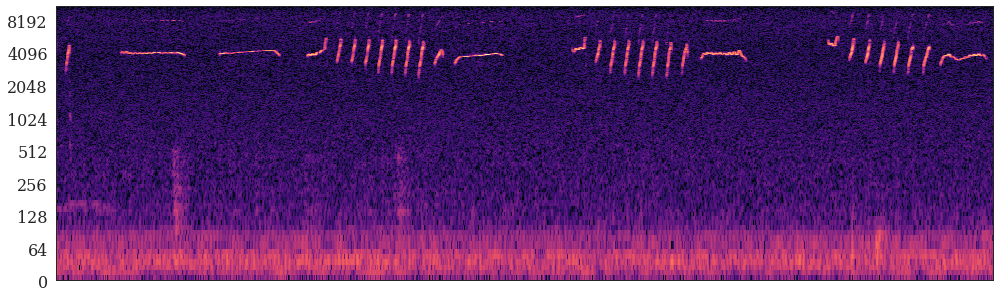

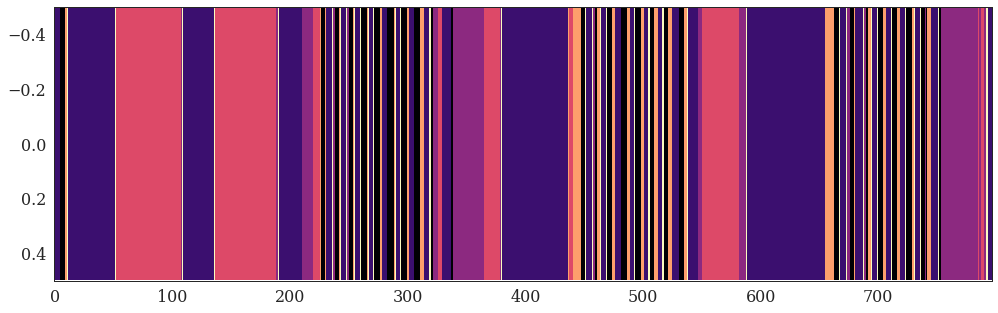

In [224]:
%matplotlib inline

# Energy + MFCC13

num_mels=13
# window_size_ms=50
# window_shift_ms=12.5
spectrum_type="linear"
title=None
center=False
ref_db=20
preemphasis=0.97
min_db=-100
mean_norm=True,
mel_min_freq=3000
verbose=False
draw_verbose=False
# n_fft=int(window_size_ms / 1000 * sampling_rate)
figsize=(6.9*1.1, 4.2*1.1)

# Energy
energy_filter= {'filter': "butter", "filter_type": "highpass", "cutoff_freq": 4000, "order": 16}
energy = log_rms_energy(path=path, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, n_fft=n_fft, center=center, verbose=verbose, draw_verbose=draw_verbose, colorbar=colorbar, figsize=figsize)
logmel = librosa_spectrum_tacotron3(path=path, n_fft=n_fft, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, spectrum_type=spectrum_type, title=title, center=center, ref_db=ref_db, preemphasis=preemphasis, mel=num_mels, min_db=min_db, mean_norm=False, mel_min_freq=mel_min_freq, verbose=False, draw_verbose=False, figsize=figsize)
mfcc = librosa.feature.mfcc(sr=sampling_rate, S=logmel, n_mfcc=num_mels, dct_type=2, norm='ortho', lifter=0)

# Add energy: the zeroth coefficient is replaced with the log of the total frame rms energy.
# energy = (energy - energy.mean()) / energy.std()
mfcc[0] = energy
logmel[0] = energy

sources = mfcc.T

D = sources.shape[1]
alpha = 1 # concentrate parameter
mu0 = np.mean(sources, axis = 0)
lmbda = 1 # belief of the mean
Sigma0 = np.cov(sources.T) # belief of the covariance
nu = D + 3 # belief of variance or degree of freedom
K0=3 # initial number of clusters
num_iterations = 1500
verbose=True

results = DPGMM3(alpha, mu0, lmbda, Sigma0, nu, sources, K0, num_iterations, verbose)
preds = np.argmax(results['z_posterior'], axis=1) # or preds = results['z']

print(preds)

y, sr = librosa.load(path, sr=48000)
D = librosa.stft(y)  # STFT of y
S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = librosa.display.specshow(S_db, cmap='magma', y_axis='log')
plt.gca().set_ylabel(None)# Turn off y labels

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = plt.imshow(preds[:,np.newaxis].T, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'

[ 02/07/2022 18:04:14 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 0 - num_clusters: 3
[ 02/07/2022 18:04:14 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1 - num_clusters: 3
[ 02/07/2022 18:04:14 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 2 - num_clusters: 3
[ 02/07/2022 18:04:14 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 3 - num_clusters: 3
[ 02/07/2022 18:04:14 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 4 - num_clusters: 3
[ 02/07/2022 18:04:14 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 5 - num_clusters: 3
[ 02/07/2022 18:04:14 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 6 - num_clusters: 3
[ 02/07/2022 18:04:14 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 7 - num_clusters: 3
[ 02/07/2022 18:04:14 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 8 - num_clusters: 3
[ 02/07/2022 18:04:14 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 9 - num_clusters: 3
[ 02/07/2022 18:04:14 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 10 - num

[ 02/07/2022 18:04:19 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 89 - num_clusters: 3
[ 02/07/2022 18:04:19 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 90 - num_clusters: 3
[ 02/07/2022 18:04:19 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 91 - num_clusters: 3
[ 02/07/2022 18:04:19 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 92 - num_clusters: 3
[ 02/07/2022 18:04:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 93 - num_clusters: 3
[ 02/07/2022 18:04:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 94 - num_clusters: 3
[ 02/07/2022 18:04:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 95 - num_clusters: 3
[ 02/07/2022 18:04:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 96 - num_clusters: 3
[ 02/07/2022 18:04:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 97 - num_clusters: 3
[ 02/07/2022 18:04:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 98 - num_clusters: 3
[ 02/07/2022 18:04:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter

[ 02/07/2022 18:04:25 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 177 - num_clusters: 3
[ 02/07/2022 18:04:25 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 178 - num_clusters: 3
[ 02/07/2022 18:04:25 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 179 - num_clusters: 3
[ 02/07/2022 18:04:25 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 180 - num_clusters: 3
[ 02/07/2022 18:04:25 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 181 - num_clusters: 3
[ 02/07/2022 18:04:25 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 182 - num_clusters: 3
[ 02/07/2022 18:04:25 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 183 - num_clusters: 3
[ 02/07/2022 18:04:25 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 184 - num_clusters: 3
[ 02/07/2022 18:04:25 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 185 - num_clusters: 3
[ 02/07/2022 18:04:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 186 - num_clusters: 3
[ 02/07/2022 18:04:26 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:04:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 265 - num_clusters: 3
[ 02/07/2022 18:04:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 266 - num_clusters: 3
[ 02/07/2022 18:04:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 267 - num_clusters: 3
[ 02/07/2022 18:04:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 268 - num_clusters: 3
[ 02/07/2022 18:04:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 269 - num_clusters: 3
[ 02/07/2022 18:04:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 270 - num_clusters: 3
[ 02/07/2022 18:04:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 271 - num_clusters: 3
[ 02/07/2022 18:04:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 272 - num_clusters: 3
[ 02/07/2022 18:04:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 273 - num_clusters: 3
[ 02/07/2022 18:04:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 274 - num_clusters: 3
[ 02/07/2022 18:04:31 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:04:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 353 - num_clusters: 3
[ 02/07/2022 18:04:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 354 - num_clusters: 3
[ 02/07/2022 18:04:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 355 - num_clusters: 3
[ 02/07/2022 18:04:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 356 - num_clusters: 3
[ 02/07/2022 18:04:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 357 - num_clusters: 3
[ 02/07/2022 18:04:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 358 - num_clusters: 3
[ 02/07/2022 18:04:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 359 - num_clusters: 3
[ 02/07/2022 18:04:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 360 - num_clusters: 3
[ 02/07/2022 18:04:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 361 - num_clusters: 3
[ 02/07/2022 18:04:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 362 - num_clusters: 3
[ 02/07/2022 18:04:37 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:04:41 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 441 - num_clusters: 3
[ 02/07/2022 18:04:41 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 442 - num_clusters: 3
[ 02/07/2022 18:04:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 443 - num_clusters: 3
[ 02/07/2022 18:04:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 444 - num_clusters: 3
[ 02/07/2022 18:04:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 445 - num_clusters: 3
[ 02/07/2022 18:04:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 446 - num_clusters: 3
[ 02/07/2022 18:04:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 447 - num_clusters: 3
[ 02/07/2022 18:04:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 448 - num_clusters: 3
[ 02/07/2022 18:04:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 449 - num_clusters: 3
[ 02/07/2022 18:04:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 450 - num_clusters: 3
[ 02/07/2022 18:04:42 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:04:46 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 529 - num_clusters: 3
[ 02/07/2022 18:04:46 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 530 - num_clusters: 3
[ 02/07/2022 18:04:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 531 - num_clusters: 3
[ 02/07/2022 18:04:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 532 - num_clusters: 3
[ 02/07/2022 18:04:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 533 - num_clusters: 3
[ 02/07/2022 18:04:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 534 - num_clusters: 3
[ 02/07/2022 18:04:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 535 - num_clusters: 3
[ 02/07/2022 18:04:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 536 - num_clusters: 3
[ 02/07/2022 18:04:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 537 - num_clusters: 3
[ 02/07/2022 18:04:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 538 - num_clusters: 3
[ 02/07/2022 18:04:47 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:04:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 617 - num_clusters: 3
[ 02/07/2022 18:04:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 618 - num_clusters: 3
[ 02/07/2022 18:04:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 619 - num_clusters: 3
[ 02/07/2022 18:04:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 620 - num_clusters: 3
[ 02/07/2022 18:04:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 621 - num_clusters: 3
[ 02/07/2022 18:04:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 622 - num_clusters: 3
[ 02/07/2022 18:04:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 623 - num_clusters: 3
[ 02/07/2022 18:04:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 624 - num_clusters: 3
[ 02/07/2022 18:04:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 625 - num_clusters: 3
[ 02/07/2022 18:04:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 626 - num_clusters: 3
[ 02/07/2022 18:04:52 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:04:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 705 - num_clusters: 3
[ 02/07/2022 18:04:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 706 - num_clusters: 3
[ 02/07/2022 18:04:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 707 - num_clusters: 3
[ 02/07/2022 18:04:57 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 708 - num_clusters: 3
[ 02/07/2022 18:04:57 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 709 - num_clusters: 3
[ 02/07/2022 18:04:57 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 710 - num_clusters: 3
[ 02/07/2022 18:04:57 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 711 - num_clusters: 3
[ 02/07/2022 18:04:57 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 712 - num_clusters: 3
[ 02/07/2022 18:04:57 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 713 - num_clusters: 3
[ 02/07/2022 18:04:57 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 714 - num_clusters: 3
[ 02/07/2022 18:04:57 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:05:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 793 - num_clusters: 3
[ 02/07/2022 18:05:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 794 - num_clusters: 3
[ 02/07/2022 18:05:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 795 - num_clusters: 3
[ 02/07/2022 18:05:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 796 - num_clusters: 3
[ 02/07/2022 18:05:02 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 797 - num_clusters: 3
[ 02/07/2022 18:05:02 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 798 - num_clusters: 3
[ 02/07/2022 18:05:02 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 799 - num_clusters: 3
[ 02/07/2022 18:05:02 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 800 - num_clusters: 3
[ 02/07/2022 18:05:02 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 801 - num_clusters: 3
[ 02/07/2022 18:05:02 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 802 - num_clusters: 3
[ 02/07/2022 18:05:02 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:05:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 881 - num_clusters: 3
[ 02/07/2022 18:05:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 882 - num_clusters: 3
[ 02/07/2022 18:05:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 883 - num_clusters: 3
[ 02/07/2022 18:05:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 884 - num_clusters: 3
[ 02/07/2022 18:05:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 885 - num_clusters: 3
[ 02/07/2022 18:05:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 886 - num_clusters: 3
[ 02/07/2022 18:05:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 887 - num_clusters: 3
[ 02/07/2022 18:05:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 888 - num_clusters: 3
[ 02/07/2022 18:05:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 889 - num_clusters: 3
[ 02/07/2022 18:05:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 890 - num_clusters: 3
[ 02/07/2022 18:05:07 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:05:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 969 - num_clusters: 3
[ 02/07/2022 18:05:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 970 - num_clusters: 3
[ 02/07/2022 18:05:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 971 - num_clusters: 3
[ 02/07/2022 18:05:12 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 972 - num_clusters: 3
[ 02/07/2022 18:05:12 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 973 - num_clusters: 3
[ 02/07/2022 18:05:12 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 974 - num_clusters: 3
[ 02/07/2022 18:05:12 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 975 - num_clusters: 3
[ 02/07/2022 18:05:12 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 976 - num_clusters: 3
[ 02/07/2022 18:05:12 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 977 - num_clusters: 3
[ 02/07/2022 18:05:12 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 978 - num_clusters: 3
[ 02/07/2022 18:05:12 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:05:16 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1056 - num_clusters: 3
[ 02/07/2022 18:05:16 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1057 - num_clusters: 3
[ 02/07/2022 18:05:16 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1058 - num_clusters: 3
[ 02/07/2022 18:05:16 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1059 - num_clusters: 3
[ 02/07/2022 18:05:16 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1060 - num_clusters: 3
[ 02/07/2022 18:05:16 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1061 - num_clusters: 3
[ 02/07/2022 18:05:17 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1062 - num_clusters: 3
[ 02/07/2022 18:05:17 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1063 - num_clusters: 3
[ 02/07/2022 18:05:17 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1064 - num_clusters: 3
[ 02/07/2022 18:05:17 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1065 - num_clusters: 3
[ 02/07/2022 18:05:17 | <ipython-input-160-a49e42b

[ 02/07/2022 18:05:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1143 - num_clusters: 3
[ 02/07/2022 18:05:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1144 - num_clusters: 3
[ 02/07/2022 18:05:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1145 - num_clusters: 3
[ 02/07/2022 18:05:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1146 - num_clusters: 3
[ 02/07/2022 18:05:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1147 - num_clusters: 3
[ 02/07/2022 18:05:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1148 - num_clusters: 3
[ 02/07/2022 18:05:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1149 - num_clusters: 3
[ 02/07/2022 18:05:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1150 - num_clusters: 3
[ 02/07/2022 18:05:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1151 - num_clusters: 3
[ 02/07/2022 18:05:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1152 - num_clusters: 3
[ 02/07/2022 18:05:22 | <ipython-input-160-a49e42b

[ 02/07/2022 18:05:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1230 - num_clusters: 3
[ 02/07/2022 18:05:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1231 - num_clusters: 3
[ 02/07/2022 18:05:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1232 - num_clusters: 3
[ 02/07/2022 18:05:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1233 - num_clusters: 3
[ 02/07/2022 18:05:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1234 - num_clusters: 3
[ 02/07/2022 18:05:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1235 - num_clusters: 3
[ 02/07/2022 18:05:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1236 - num_clusters: 3
[ 02/07/2022 18:05:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1237 - num_clusters: 3
[ 02/07/2022 18:05:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1238 - num_clusters: 3
[ 02/07/2022 18:05:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1239 - num_clusters: 3
[ 02/07/2022 18:05:27 | <ipython-input-160-a49e42b

[ 02/07/2022 18:05:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1317 - num_clusters: 3
[ 02/07/2022 18:05:33 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1318 - num_clusters: 3
[ 02/07/2022 18:05:33 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1319 - num_clusters: 3
[ 02/07/2022 18:05:33 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1320 - num_clusters: 3
[ 02/07/2022 18:05:33 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1321 - num_clusters: 3
[ 02/07/2022 18:05:33 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1322 - num_clusters: 3
[ 02/07/2022 18:05:33 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1323 - num_clusters: 3
[ 02/07/2022 18:05:33 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1324 - num_clusters: 3
[ 02/07/2022 18:05:33 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1325 - num_clusters: 3
[ 02/07/2022 18:05:33 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1326 - num_clusters: 3
[ 02/07/2022 18:05:33 | <ipython-input-160-a49e42b

[ 02/07/2022 18:05:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1404 - num_clusters: 3
[ 02/07/2022 18:05:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1405 - num_clusters: 3
[ 02/07/2022 18:05:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1406 - num_clusters: 3
[ 02/07/2022 18:05:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1407 - num_clusters: 3
[ 02/07/2022 18:05:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1408 - num_clusters: 3
[ 02/07/2022 18:05:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1409 - num_clusters: 3
[ 02/07/2022 18:05:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1410 - num_clusters: 3
[ 02/07/2022 18:05:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1411 - num_clusters: 3
[ 02/07/2022 18:05:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1412 - num_clusters: 3
[ 02/07/2022 18:05:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1413 - num_clusters: 3
[ 02/07/2022 18:05:39 | <ipython-input-160-a49e42b

[ 02/07/2022 18:05:44 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1491 - num_clusters: 3
[ 02/07/2022 18:05:44 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1492 - num_clusters: 3
[ 02/07/2022 18:05:44 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1493 - num_clusters: 3
[ 02/07/2022 18:05:44 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1494 - num_clusters: 3
[ 02/07/2022 18:05:44 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1495 - num_clusters: 3
[ 02/07/2022 18:05:44 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1496 - num_clusters: 3
[ 02/07/2022 18:05:44 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1497 - num_clusters: 3
[ 02/07/2022 18:05:44 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1498 - num_clusters: 3
[ 02/07/2022 18:05:45 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1499 - num_clusters: 3
[0 0 0 0 0 2 2 2 2 2 2 2 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1

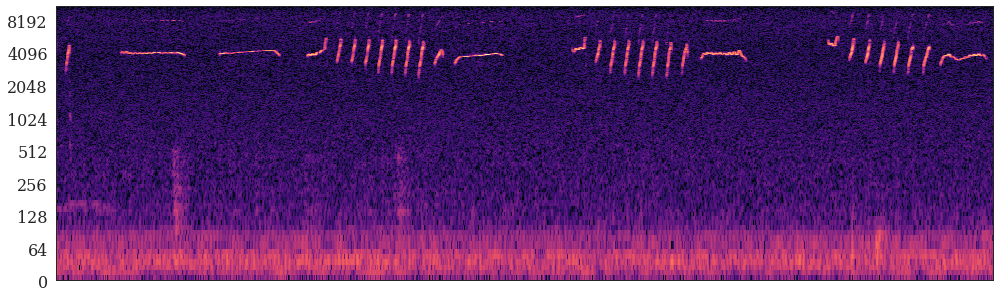

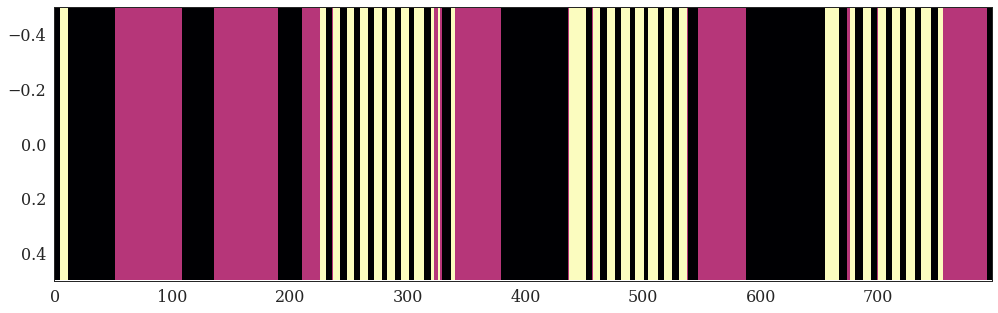

In [205]:
%matplotlib inline

# Energy + Logmel13
num_mels=26
# window_size_ms=50
# window_shift_ms=12.5
spectrum_type="linear"
title=None
center=False
ref_db=20
preemphasis=0.97
min_db=-100
mean_norm=True,
mel_min_freq=3000
verbose=False
draw_verbose=False
# n_fft=int(window_size_ms / 1000 * sampling_rate)
figsize=(6.9*1.1, 4.2*1.1)

# Energy
energy_filter= {'filter': "butter", "filter_type": "highpass", "cutoff_freq": 4000, "order": 16}
energy = log_rms_energy(path=path, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, n_fft=n_fft, center=center, verbose=verbose, draw_verbose=draw_verbose, colorbar=colorbar, figsize=figsize)
logmel = librosa_spectrum_tacotron3(path=path, n_fft=n_fft, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, spectrum_type=spectrum_type, title=title, center=center, ref_db=ref_db, preemphasis=preemphasis, mel=num_mels, min_db=min_db, mean_norm=False, mel_min_freq=mel_min_freq, verbose=False, draw_verbose=False, figsize=figsize)
mfcc = librosa.feature.mfcc(sr=sampling_rate, S=logmel, n_mfcc=num_mels, dct_type=2, norm='ortho', lifter=0)

# Add energy: the zeroth coefficient is replaced with the log of the total frame rms energy.
# energy = (energy - energy.mean()) / energy.std()
mfcc[0] = energy
logmel[0] = energy

sources = logmel.T

D = sources.shape[1]
alpha = 1 # concentrate parameter
mu0 = np.mean(sources, axis = 0)
lmbda = 1 # belief of the mean
Sigma0 = np.cov(sources.T) # belief of the covariance
nu = D + 3 # belief of variance or degree of freedom
K0=3 # initial number of clusters
num_iterations = 1500
verbose=True

results = DPGMM3(alpha, mu0, lmbda, Sigma0, nu, sources, K0, num_iterations, verbose)
preds = np.argmax(results['z_posterior'], axis=1) # or preds = results['z']

print(preds)

y, sr = librosa.load(path, sr=48000)
D = librosa.stft(y)  # STFT of y
S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = librosa.display.specshow(S_db, cmap='magma', y_axis='log')
plt.gca().set_ylabel(None)# Turn off y labels

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = plt.imshow(preds[:,np.newaxis].T, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'

[ 02/07/2022 18:05:46 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 0 - num_clusters: 3
[ 02/07/2022 18:05:46 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1 - num_clusters: 4
[ 02/07/2022 18:05:46 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 2 - num_clusters: 5
[ 02/07/2022 18:05:46 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 3 - num_clusters: 4
[ 02/07/2022 18:05:46 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 4 - num_clusters: 4
[ 02/07/2022 18:05:46 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 5 - num_clusters: 4
[ 02/07/2022 18:05:46 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 6 - num_clusters: 4
[ 02/07/2022 18:05:46 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 7 - num_clusters: 4
[ 02/07/2022 18:05:46 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 8 - num_clusters: 4
[ 02/07/2022 18:05:46 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 9 - num_clusters: 4
[ 02/07/2022 18:05:46 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 10 - num

[ 02/07/2022 18:05:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 89 - num_clusters: 7
[ 02/07/2022 18:05:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 90 - num_clusters: 7
[ 02/07/2022 18:05:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 91 - num_clusters: 7
[ 02/07/2022 18:05:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 92 - num_clusters: 7
[ 02/07/2022 18:05:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 93 - num_clusters: 7
[ 02/07/2022 18:05:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 94 - num_clusters: 7
[ 02/07/2022 18:05:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 95 - num_clusters: 7
[ 02/07/2022 18:05:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 96 - num_clusters: 7
[ 02/07/2022 18:05:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 97 - num_clusters: 7
[ 02/07/2022 18:05:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 98 - num_clusters: 7
[ 02/07/2022 18:05:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter

[ 02/07/2022 18:05:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 177 - num_clusters: 7
[ 02/07/2022 18:05:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 178 - num_clusters: 6
[ 02/07/2022 18:05:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 179 - num_clusters: 6
[ 02/07/2022 18:05:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 180 - num_clusters: 6
[ 02/07/2022 18:05:57 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 181 - num_clusters: 6
[ 02/07/2022 18:05:57 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 182 - num_clusters: 6
[ 02/07/2022 18:05:57 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 183 - num_clusters: 6
[ 02/07/2022 18:05:57 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 184 - num_clusters: 6
[ 02/07/2022 18:05:57 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 185 - num_clusters: 6
[ 02/07/2022 18:05:57 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 186 - num_clusters: 6
[ 02/07/2022 18:05:57 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:06:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 265 - num_clusters: 7
[ 02/07/2022 18:06:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 266 - num_clusters: 7
[ 02/07/2022 18:06:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 267 - num_clusters: 7
[ 02/07/2022 18:06:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 268 - num_clusters: 7
[ 02/07/2022 18:06:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 269 - num_clusters: 7
[ 02/07/2022 18:06:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 270 - num_clusters: 7
[ 02/07/2022 18:06:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 271 - num_clusters: 7
[ 02/07/2022 18:06:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 272 - num_clusters: 7
[ 02/07/2022 18:06:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 273 - num_clusters: 7
[ 02/07/2022 18:06:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 274 - num_clusters: 7
[ 02/07/2022 18:06:01 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:06:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 353 - num_clusters: 6
[ 02/07/2022 18:06:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 354 - num_clusters: 6
[ 02/07/2022 18:06:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 355 - num_clusters: 7
[ 02/07/2022 18:06:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 356 - num_clusters: 7
[ 02/07/2022 18:06:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 357 - num_clusters: 7
[ 02/07/2022 18:06:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 358 - num_clusters: 7
[ 02/07/2022 18:06:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 359 - num_clusters: 7
[ 02/07/2022 18:06:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 360 - num_clusters: 7
[ 02/07/2022 18:06:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 361 - num_clusters: 7
[ 02/07/2022 18:06:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 362 - num_clusters: 7
[ 02/07/2022 18:06:06 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:06:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 441 - num_clusters: 7
[ 02/07/2022 18:06:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 442 - num_clusters: 6
[ 02/07/2022 18:06:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 443 - num_clusters: 6
[ 02/07/2022 18:06:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 444 - num_clusters: 6
[ 02/07/2022 18:06:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 445 - num_clusters: 6
[ 02/07/2022 18:06:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 446 - num_clusters: 6
[ 02/07/2022 18:06:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 447 - num_clusters: 6
[ 02/07/2022 18:06:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 448 - num_clusters: 6
[ 02/07/2022 18:06:12 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 449 - num_clusters: 6
[ 02/07/2022 18:06:12 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 450 - num_clusters: 6
[ 02/07/2022 18:06:12 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:06:17 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 529 - num_clusters: 8
[ 02/07/2022 18:06:17 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 530 - num_clusters: 7
[ 02/07/2022 18:06:17 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 531 - num_clusters: 7
[ 02/07/2022 18:06:17 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 532 - num_clusters: 7
[ 02/07/2022 18:06:17 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 533 - num_clusters: 7
[ 02/07/2022 18:06:17 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 534 - num_clusters: 7
[ 02/07/2022 18:06:17 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 535 - num_clusters: 7
[ 02/07/2022 18:06:17 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 536 - num_clusters: 7
[ 02/07/2022 18:06:17 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 537 - num_clusters: 7
[ 02/07/2022 18:06:17 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 538 - num_clusters: 7
[ 02/07/2022 18:06:17 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:06:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 617 - num_clusters: 6
[ 02/07/2022 18:06:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 618 - num_clusters: 6
[ 02/07/2022 18:06:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 619 - num_clusters: 7
[ 02/07/2022 18:06:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 620 - num_clusters: 7
[ 02/07/2022 18:06:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 621 - num_clusters: 7
[ 02/07/2022 18:06:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 622 - num_clusters: 7
[ 02/07/2022 18:06:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 623 - num_clusters: 7
[ 02/07/2022 18:06:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 624 - num_clusters: 7
[ 02/07/2022 18:06:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 625 - num_clusters: 7
[ 02/07/2022 18:06:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 626 - num_clusters: 7
[ 02/07/2022 18:06:23 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:06:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 705 - num_clusters: 6
[ 02/07/2022 18:06:28 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 706 - num_clusters: 6
[ 02/07/2022 18:06:28 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 707 - num_clusters: 6
[ 02/07/2022 18:06:28 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 708 - num_clusters: 6
[ 02/07/2022 18:06:28 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 709 - num_clusters: 6
[ 02/07/2022 18:06:28 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 710 - num_clusters: 6
[ 02/07/2022 18:06:28 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 711 - num_clusters: 6
[ 02/07/2022 18:06:28 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 712 - num_clusters: 6
[ 02/07/2022 18:06:28 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 713 - num_clusters: 6
[ 02/07/2022 18:06:28 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 714 - num_clusters: 6
[ 02/07/2022 18:06:28 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:06:33 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 793 - num_clusters: 6
[ 02/07/2022 18:06:33 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 794 - num_clusters: 6
[ 02/07/2022 18:06:33 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 795 - num_clusters: 6
[ 02/07/2022 18:06:33 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 796 - num_clusters: 6
[ 02/07/2022 18:06:33 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 797 - num_clusters: 6
[ 02/07/2022 18:06:33 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 798 - num_clusters: 6
[ 02/07/2022 18:06:33 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 799 - num_clusters: 6
[ 02/07/2022 18:06:33 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 800 - num_clusters: 6
[ 02/07/2022 18:06:33 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 801 - num_clusters: 7
[ 02/07/2022 18:06:33 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 802 - num_clusters: 7
[ 02/07/2022 18:06:34 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:06:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 881 - num_clusters: 7
[ 02/07/2022 18:06:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 882 - num_clusters: 7
[ 02/07/2022 18:06:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 883 - num_clusters: 7
[ 02/07/2022 18:06:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 884 - num_clusters: 7
[ 02/07/2022 18:06:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 885 - num_clusters: 7
[ 02/07/2022 18:06:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 886 - num_clusters: 7
[ 02/07/2022 18:06:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 887 - num_clusters: 7
[ 02/07/2022 18:06:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 888 - num_clusters: 7
[ 02/07/2022 18:06:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 889 - num_clusters: 7
[ 02/07/2022 18:06:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 890 - num_clusters: 7
[ 02/07/2022 18:06:39 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:06:44 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 969 - num_clusters: 8
[ 02/07/2022 18:06:44 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 970 - num_clusters: 8
[ 02/07/2022 18:06:44 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 971 - num_clusters: 8
[ 02/07/2022 18:06:44 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 972 - num_clusters: 8
[ 02/07/2022 18:06:45 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 973 - num_clusters: 8
[ 02/07/2022 18:06:45 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 974 - num_clusters: 8
[ 02/07/2022 18:06:45 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 975 - num_clusters: 8
[ 02/07/2022 18:06:45 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 976 - num_clusters: 8
[ 02/07/2022 18:06:45 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 977 - num_clusters: 8
[ 02/07/2022 18:06:45 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 978 - num_clusters: 8
[ 02/07/2022 18:06:45 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:06:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1056 - num_clusters: 7
[ 02/07/2022 18:06:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1057 - num_clusters: 7
[ 02/07/2022 18:06:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1058 - num_clusters: 7
[ 02/07/2022 18:06:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1059 - num_clusters: 7
[ 02/07/2022 18:06:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1060 - num_clusters: 7
[ 02/07/2022 18:06:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1061 - num_clusters: 7
[ 02/07/2022 18:06:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1062 - num_clusters: 7
[ 02/07/2022 18:06:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1063 - num_clusters: 7
[ 02/07/2022 18:06:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1064 - num_clusters: 7
[ 02/07/2022 18:06:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1065 - num_clusters: 7
[ 02/07/2022 18:06:51 | <ipython-input-160-a49e42b

[ 02/07/2022 18:06:55 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1143 - num_clusters: 7
[ 02/07/2022 18:06:55 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1144 - num_clusters: 7
[ 02/07/2022 18:06:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1145 - num_clusters: 7
[ 02/07/2022 18:06:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1146 - num_clusters: 7
[ 02/07/2022 18:06:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1147 - num_clusters: 7
[ 02/07/2022 18:06:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1148 - num_clusters: 7
[ 02/07/2022 18:06:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1149 - num_clusters: 7
[ 02/07/2022 18:06:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1150 - num_clusters: 7
[ 02/07/2022 18:06:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1151 - num_clusters: 8
[ 02/07/2022 18:06:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1152 - num_clusters: 8
[ 02/07/2022 18:06:56 | <ipython-input-160-a49e42b

[ 02/07/2022 18:07:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1230 - num_clusters: 7
[ 02/07/2022 18:07:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1231 - num_clusters: 7
[ 02/07/2022 18:07:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1232 - num_clusters: 7
[ 02/07/2022 18:07:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1233 - num_clusters: 7
[ 02/07/2022 18:07:01 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1234 - num_clusters: 7
[ 02/07/2022 18:07:02 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1235 - num_clusters: 7
[ 02/07/2022 18:07:02 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1236 - num_clusters: 7
[ 02/07/2022 18:07:02 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1237 - num_clusters: 7
[ 02/07/2022 18:07:02 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1238 - num_clusters: 7
[ 02/07/2022 18:07:02 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1239 - num_clusters: 7
[ 02/07/2022 18:07:02 | <ipython-input-160-a49e42b

[ 02/07/2022 18:07:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1317 - num_clusters: 8
[ 02/07/2022 18:07:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1318 - num_clusters: 9
[ 02/07/2022 18:07:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1319 - num_clusters: 9
[ 02/07/2022 18:07:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1320 - num_clusters: 9
[ 02/07/2022 18:07:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1321 - num_clusters: 9
[ 02/07/2022 18:07:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1322 - num_clusters: 9
[ 02/07/2022 18:07:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1323 - num_clusters: 9
[ 02/07/2022 18:07:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1324 - num_clusters: 9
[ 02/07/2022 18:07:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1325 - num_clusters: 9
[ 02/07/2022 18:07:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1326 - num_clusters: 9
[ 02/07/2022 18:07:07 | <ipython-input-160-a49e42b

[ 02/07/2022 18:07:12 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1404 - num_clusters: 7
[ 02/07/2022 18:07:13 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1405 - num_clusters: 7
[ 02/07/2022 18:07:13 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1406 - num_clusters: 7
[ 02/07/2022 18:07:13 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1407 - num_clusters: 7
[ 02/07/2022 18:07:13 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1408 - num_clusters: 7
[ 02/07/2022 18:07:13 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1409 - num_clusters: 7
[ 02/07/2022 18:07:13 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1410 - num_clusters: 7
[ 02/07/2022 18:07:13 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1411 - num_clusters: 7
[ 02/07/2022 18:07:13 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1412 - num_clusters: 7
[ 02/07/2022 18:07:13 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1413 - num_clusters: 6
[ 02/07/2022 18:07:13 | <ipython-input-160-a49e42b

[ 02/07/2022 18:07:18 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1491 - num_clusters: 7
[ 02/07/2022 18:07:18 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1492 - num_clusters: 7
[ 02/07/2022 18:07:18 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1493 - num_clusters: 7
[ 02/07/2022 18:07:18 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1494 - num_clusters: 7
[ 02/07/2022 18:07:18 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1495 - num_clusters: 7
[ 02/07/2022 18:07:18 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1496 - num_clusters: 7
[ 02/07/2022 18:07:18 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1497 - num_clusters: 7
[ 02/07/2022 18:07:18 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1498 - num_clusters: 7
[ 02/07/2022 18:07:18 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1499 - num_clusters: 7
[3 3 3 3 3 1 1 1 0 5 5 5 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3
 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 5 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2

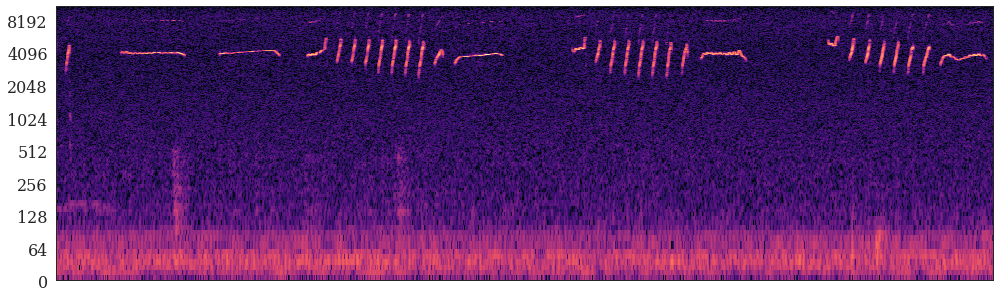

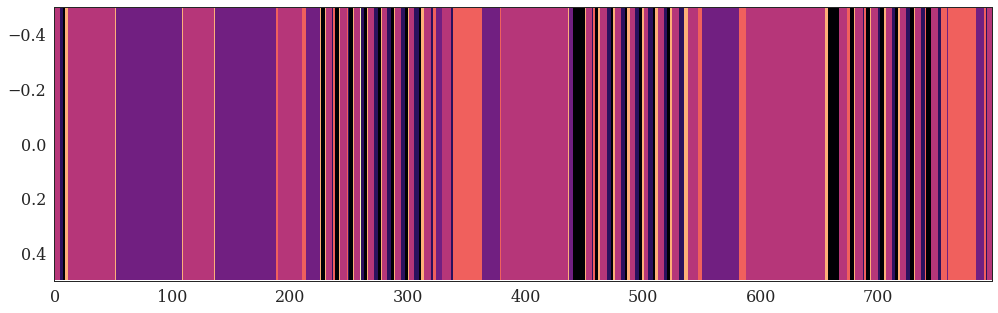

In [206]:
%matplotlib inline
# No Energy + MFCC13

num_mels=13
# window_size_ms=50
# window_shift_ms=12.5
spectrum_type="linear"
title=None
center=False
ref_db=20
preemphasis=0.97
min_db=-100
mean_norm=True,
mel_min_freq=3000
verbose=False
draw_verbose=False
# n_fft=int(window_size_ms / 1000 * sampling_rate)
figsize=(6.9*1.1, 4.2*1.1)

# Energy
energy_filter= {'filter': "butter", "filter_type": "highpass", "cutoff_freq": 4000, "order": 16}
energy = log_rms_energy(path=path, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, n_fft=n_fft, center=center, verbose=verbose, draw_verbose=draw_verbose, colorbar=colorbar, figsize=figsize)
logmel = librosa_spectrum_tacotron3(path=path, n_fft=n_fft, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, spectrum_type=spectrum_type, title=title, center=center, ref_db=ref_db, preemphasis=preemphasis, mel=num_mels, min_db=min_db, mean_norm=False, mel_min_freq=mel_min_freq, verbose=False, draw_verbose=False, figsize=figsize)
mfcc = librosa.feature.mfcc(sr=sampling_rate, S=logmel, n_mfcc=num_mels, dct_type=2, norm='ortho', lifter=0)

# # Add energy: the zeroth coefficient is replaced with the log of the total frame rms energy.
# # energy = (energy - energy.mean()) / energy.std()
# mfcc[0] = energy
# logmel[0] = energy

sources = mfcc.T

D = sources.shape[1]
alpha = 1 # concentrate parameter
mu0 = np.mean(sources, axis = 0)
lmbda = 1 # belief of the mean
Sigma0 = np.cov(sources.T) # belief of the covariance
nu = D + 3 # belief of variance or degree of freedom
K0=3 # initial number of clusters
num_iterations = 1500
verbose=True

results = DPGMM3(alpha, mu0, lmbda, Sigma0, nu, sources, K0, num_iterations, verbose)
preds = np.argmax(results['z_posterior'], axis=1) # or preds = results['z']

print(preds)

y, sr = librosa.load(path, sr=48000)
D = librosa.stft(y)  # STFT of y
S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = librosa.display.specshow(S_db, cmap='magma', y_axis='log')
plt.gca().set_ylabel(None)# Turn off y labels

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = plt.imshow(preds[:,np.newaxis].T, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'

[ 02/07/2022 18:07:19 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 0 - num_clusters: 3
[ 02/07/2022 18:07:19 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1 - num_clusters: 3
[ 02/07/2022 18:07:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 2 - num_clusters: 3
[ 02/07/2022 18:07:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 3 - num_clusters: 3
[ 02/07/2022 18:07:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 4 - num_clusters: 3
[ 02/07/2022 18:07:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 5 - num_clusters: 3
[ 02/07/2022 18:07:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 6 - num_clusters: 3
[ 02/07/2022 18:07:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 7 - num_clusters: 3
[ 02/07/2022 18:07:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 8 - num_clusters: 3
[ 02/07/2022 18:07:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 9 - num_clusters: 3
[ 02/07/2022 18:07:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 10 - num

[ 02/07/2022 18:07:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 89 - num_clusters: 7
[ 02/07/2022 18:07:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 90 - num_clusters: 7
[ 02/07/2022 18:07:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 91 - num_clusters: 7
[ 02/07/2022 18:07:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 92 - num_clusters: 7
[ 02/07/2022 18:07:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 93 - num_clusters: 7
[ 02/07/2022 18:07:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 94 - num_clusters: 7
[ 02/07/2022 18:07:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 95 - num_clusters: 7
[ 02/07/2022 18:07:24 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 96 - num_clusters: 7
[ 02/07/2022 18:07:24 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 97 - num_clusters: 7
[ 02/07/2022 18:07:24 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 98 - num_clusters: 7
[ 02/07/2022 18:07:24 | <ipython-input-160-a49e42be2f2d> | INFO ] iter

[ 02/07/2022 18:07:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 177 - num_clusters: 7
[ 02/07/2022 18:07:28 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 178 - num_clusters: 7
[ 02/07/2022 18:07:28 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 179 - num_clusters: 7
[ 02/07/2022 18:07:28 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 180 - num_clusters: 7
[ 02/07/2022 18:07:28 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 181 - num_clusters: 7
[ 02/07/2022 18:07:28 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 182 - num_clusters: 7
[ 02/07/2022 18:07:28 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 183 - num_clusters: 7
[ 02/07/2022 18:07:28 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 184 - num_clusters: 7
[ 02/07/2022 18:07:28 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 185 - num_clusters: 7
[ 02/07/2022 18:07:28 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 186 - num_clusters: 7
[ 02/07/2022 18:07:28 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:07:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 265 - num_clusters: 7
[ 02/07/2022 18:07:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 266 - num_clusters: 6
[ 02/07/2022 18:07:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 267 - num_clusters: 6
[ 02/07/2022 18:07:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 268 - num_clusters: 6
[ 02/07/2022 18:07:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 269 - num_clusters: 6
[ 02/07/2022 18:07:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 270 - num_clusters: 6
[ 02/07/2022 18:07:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 271 - num_clusters: 6
[ 02/07/2022 18:07:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 272 - num_clusters: 6
[ 02/07/2022 18:07:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 273 - num_clusters: 6
[ 02/07/2022 18:07:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 274 - num_clusters: 6
[ 02/07/2022 18:07:32 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:07:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 353 - num_clusters: 6
[ 02/07/2022 18:07:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 354 - num_clusters: 6
[ 02/07/2022 18:07:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 355 - num_clusters: 6
[ 02/07/2022 18:07:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 356 - num_clusters: 6
[ 02/07/2022 18:07:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 357 - num_clusters: 6
[ 02/07/2022 18:07:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 358 - num_clusters: 6
[ 02/07/2022 18:07:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 359 - num_clusters: 6
[ 02/07/2022 18:07:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 360 - num_clusters: 6
[ 02/07/2022 18:07:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 361 - num_clusters: 6
[ 02/07/2022 18:07:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 362 - num_clusters: 6
[ 02/07/2022 18:07:37 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:07:41 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 441 - num_clusters: 6
[ 02/07/2022 18:07:41 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 442 - num_clusters: 6
[ 02/07/2022 18:07:41 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 443 - num_clusters: 6
[ 02/07/2022 18:07:41 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 444 - num_clusters: 6
[ 02/07/2022 18:07:41 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 445 - num_clusters: 6
[ 02/07/2022 18:07:41 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 446 - num_clusters: 6
[ 02/07/2022 18:07:41 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 447 - num_clusters: 6
[ 02/07/2022 18:07:41 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 448 - num_clusters: 6
[ 02/07/2022 18:07:41 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 449 - num_clusters: 6
[ 02/07/2022 18:07:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 450 - num_clusters: 6
[ 02/07/2022 18:07:42 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:07:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 529 - num_clusters: 6
[ 02/07/2022 18:07:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 530 - num_clusters: 6
[ 02/07/2022 18:07:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 531 - num_clusters: 6
[ 02/07/2022 18:07:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 532 - num_clusters: 6
[ 02/07/2022 18:07:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 533 - num_clusters: 6
[ 02/07/2022 18:07:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 534 - num_clusters: 6
[ 02/07/2022 18:07:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 535 - num_clusters: 6
[ 02/07/2022 18:07:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 536 - num_clusters: 6
[ 02/07/2022 18:07:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 537 - num_clusters: 6
[ 02/07/2022 18:07:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 538 - num_clusters: 6
[ 02/07/2022 18:07:47 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:07:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 617 - num_clusters: 6
[ 02/07/2022 18:07:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 618 - num_clusters: 6
[ 02/07/2022 18:07:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 619 - num_clusters: 7
[ 02/07/2022 18:07:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 620 - num_clusters: 7
[ 02/07/2022 18:07:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 621 - num_clusters: 6
[ 02/07/2022 18:07:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 622 - num_clusters: 6
[ 02/07/2022 18:07:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 623 - num_clusters: 6
[ 02/07/2022 18:07:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 624 - num_clusters: 6
[ 02/07/2022 18:07:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 625 - num_clusters: 6
[ 02/07/2022 18:07:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 626 - num_clusters: 6
[ 02/07/2022 18:07:52 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:07:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 705 - num_clusters: 7
[ 02/07/2022 18:07:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 706 - num_clusters: 7
[ 02/07/2022 18:07:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 707 - num_clusters: 6
[ 02/07/2022 18:07:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 708 - num_clusters: 6
[ 02/07/2022 18:07:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 709 - num_clusters: 6
[ 02/07/2022 18:07:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 710 - num_clusters: 6
[ 02/07/2022 18:07:57 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 711 - num_clusters: 6
[ 02/07/2022 18:07:57 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 712 - num_clusters: 6
[ 02/07/2022 18:07:57 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 713 - num_clusters: 6
[ 02/07/2022 18:07:57 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 714 - num_clusters: 6
[ 02/07/2022 18:07:57 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:08:02 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 793 - num_clusters: 6
[ 02/07/2022 18:08:02 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 794 - num_clusters: 6
[ 02/07/2022 18:08:02 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 795 - num_clusters: 6
[ 02/07/2022 18:08:02 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 796 - num_clusters: 6
[ 02/07/2022 18:08:02 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 797 - num_clusters: 6
[ 02/07/2022 18:08:02 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 798 - num_clusters: 6
[ 02/07/2022 18:08:02 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 799 - num_clusters: 6
[ 02/07/2022 18:08:02 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 800 - num_clusters: 6
[ 02/07/2022 18:08:02 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 801 - num_clusters: 6
[ 02/07/2022 18:08:02 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 802 - num_clusters: 6
[ 02/07/2022 18:08:02 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:08:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 881 - num_clusters: 6
[ 02/07/2022 18:08:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 882 - num_clusters: 6
[ 02/07/2022 18:08:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 883 - num_clusters: 6
[ 02/07/2022 18:08:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 884 - num_clusters: 6
[ 02/07/2022 18:08:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 885 - num_clusters: 6
[ 02/07/2022 18:08:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 886 - num_clusters: 6
[ 02/07/2022 18:08:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 887 - num_clusters: 6
[ 02/07/2022 18:08:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 888 - num_clusters: 6
[ 02/07/2022 18:08:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 889 - num_clusters: 6
[ 02/07/2022 18:08:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 890 - num_clusters: 7
[ 02/07/2022 18:08:07 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:08:12 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 969 - num_clusters: 6
[ 02/07/2022 18:08:12 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 970 - num_clusters: 6
[ 02/07/2022 18:08:12 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 971 - num_clusters: 6
[ 02/07/2022 18:08:12 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 972 - num_clusters: 6
[ 02/07/2022 18:08:13 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 973 - num_clusters: 6
[ 02/07/2022 18:08:13 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 974 - num_clusters: 6
[ 02/07/2022 18:08:13 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 975 - num_clusters: 6
[ 02/07/2022 18:08:13 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 976 - num_clusters: 6
[ 02/07/2022 18:08:13 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 977 - num_clusters: 6
[ 02/07/2022 18:08:13 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 978 - num_clusters: 6
[ 02/07/2022 18:08:13 | <ipython-input-160-a49e42be2f2d> | I

[ 02/07/2022 18:08:18 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1056 - num_clusters: 7
[ 02/07/2022 18:08:18 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1057 - num_clusters: 7
[ 02/07/2022 18:08:18 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1058 - num_clusters: 7
[ 02/07/2022 18:08:18 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1059 - num_clusters: 7
[ 02/07/2022 18:08:18 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1060 - num_clusters: 7
[ 02/07/2022 18:08:18 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1061 - num_clusters: 7
[ 02/07/2022 18:08:18 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1062 - num_clusters: 7
[ 02/07/2022 18:08:18 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1063 - num_clusters: 7
[ 02/07/2022 18:08:18 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1064 - num_clusters: 7
[ 02/07/2022 18:08:18 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1065 - num_clusters: 7
[ 02/07/2022 18:08:18 | <ipython-input-160-a49e42b

[ 02/07/2022 18:08:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1143 - num_clusters: 7
[ 02/07/2022 18:08:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1144 - num_clusters: 7
[ 02/07/2022 18:08:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1145 - num_clusters: 7
[ 02/07/2022 18:08:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1146 - num_clusters: 7
[ 02/07/2022 18:08:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1147 - num_clusters: 7
[ 02/07/2022 18:08:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1148 - num_clusters: 7
[ 02/07/2022 18:08:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1149 - num_clusters: 7
[ 02/07/2022 18:08:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1150 - num_clusters: 7
[ 02/07/2022 18:08:24 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1151 - num_clusters: 7
[ 02/07/2022 18:08:24 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1152 - num_clusters: 7
[ 02/07/2022 18:08:24 | <ipython-input-160-a49e42b

[ 02/07/2022 18:08:28 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1230 - num_clusters: 6
[ 02/07/2022 18:08:28 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1231 - num_clusters: 6
[ 02/07/2022 18:08:28 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1232 - num_clusters: 6
[ 02/07/2022 18:08:29 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1233 - num_clusters: 6
[ 02/07/2022 18:08:29 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1234 - num_clusters: 6
[ 02/07/2022 18:08:29 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1235 - num_clusters: 6
[ 02/07/2022 18:08:29 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1236 - num_clusters: 6
[ 02/07/2022 18:08:29 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1237 - num_clusters: 6
[ 02/07/2022 18:08:29 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1238 - num_clusters: 6
[ 02/07/2022 18:08:29 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1239 - num_clusters: 6
[ 02/07/2022 18:08:29 | <ipython-input-160-a49e42b

[ 02/07/2022 18:08:34 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1317 - num_clusters: 7
[ 02/07/2022 18:08:34 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1318 - num_clusters: 7
[ 02/07/2022 18:08:34 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1319 - num_clusters: 7
[ 02/07/2022 18:08:34 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1320 - num_clusters: 7
[ 02/07/2022 18:08:34 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1321 - num_clusters: 8
[ 02/07/2022 18:08:34 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1322 - num_clusters: 8
[ 02/07/2022 18:08:34 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1323 - num_clusters: 8
[ 02/07/2022 18:08:34 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1324 - num_clusters: 8
[ 02/07/2022 18:08:34 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1325 - num_clusters: 8
[ 02/07/2022 18:08:34 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1326 - num_clusters: 8
[ 02/07/2022 18:08:34 | <ipython-input-160-a49e42b

[ 02/07/2022 18:08:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1404 - num_clusters: 6
[ 02/07/2022 18:08:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1405 - num_clusters: 6
[ 02/07/2022 18:08:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1406 - num_clusters: 6
[ 02/07/2022 18:08:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1407 - num_clusters: 6
[ 02/07/2022 18:08:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1408 - num_clusters: 7
[ 02/07/2022 18:08:40 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1409 - num_clusters: 7
[ 02/07/2022 18:08:40 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1410 - num_clusters: 7
[ 02/07/2022 18:08:40 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1411 - num_clusters: 7
[ 02/07/2022 18:08:40 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1412 - num_clusters: 7
[ 02/07/2022 18:08:40 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1413 - num_clusters: 7
[ 02/07/2022 18:08:40 | <ipython-input-160-a49e42b

[ 02/07/2022 18:08:45 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1491 - num_clusters: 7
[ 02/07/2022 18:08:45 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1492 - num_clusters: 7
[ 02/07/2022 18:08:45 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1493 - num_clusters: 7
[ 02/07/2022 18:08:45 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1494 - num_clusters: 6
[ 02/07/2022 18:08:45 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1495 - num_clusters: 6
[ 02/07/2022 18:08:45 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1496 - num_clusters: 6
[ 02/07/2022 18:08:45 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1497 - num_clusters: 6
[ 02/07/2022 18:08:45 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1498 - num_clusters: 6
[ 02/07/2022 18:08:45 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1499 - num_clusters: 6
[5 5 5 5 5 1 1 1 1 2 2 3 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5
 5 5 5 5 5 5 5 5 5 5 5 5 5 5 5 3 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0

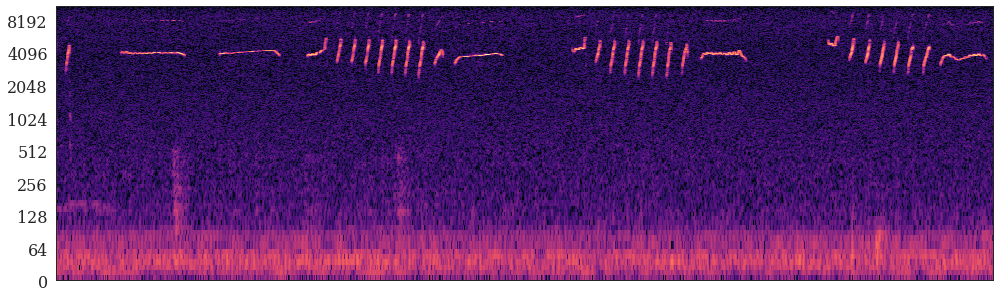

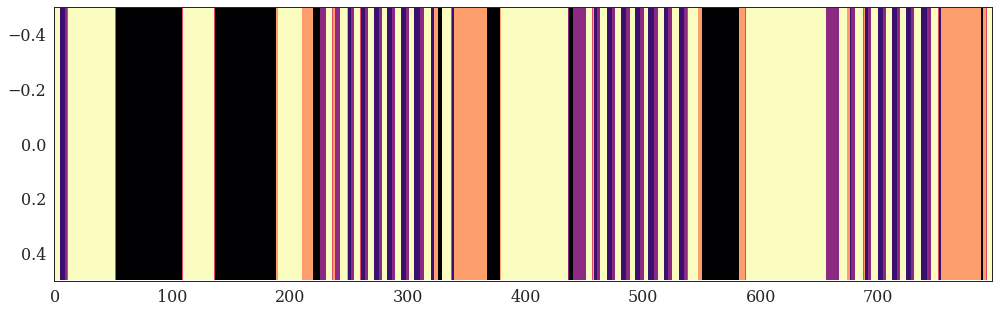

In [207]:
%matplotlib inline

# NoEnergy + Logmel13

num_mels=13
# window_size_ms=50
# window_shift_ms=12.5
spectrum_type="linear"
title=None
center=False
ref_db=20
preemphasis=0.97
min_db=-100
mean_norm=True,
mel_min_freq=3000
verbose=False
draw_verbose=False
# n_fft=int(window_size_ms / 1000 * sampling_rate)
figsize=(6.9*1.1, 4.2*1.1)

# Energy
energy_filter= {'filter': "butter", "filter_type": "highpass", "cutoff_freq": 4000, "order": 16}
energy = log_rms_energy(path=path, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, n_fft=n_fft, center=center, verbose=verbose, draw_verbose=draw_verbose, colorbar=colorbar, figsize=figsize)
logmel = librosa_spectrum_tacotron3(path=path, n_fft=n_fft, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, spectrum_type=spectrum_type, title=title, center=center, ref_db=ref_db, preemphasis=preemphasis, mel=num_mels, min_db=min_db, mean_norm=False, mel_min_freq=mel_min_freq, verbose=False, draw_verbose=False, figsize=figsize)
mfcc = librosa.feature.mfcc(sr=sampling_rate, S=logmel, n_mfcc=num_mels, dct_type=2, norm='ortho', lifter=0)

# # Add energy: the zeroth coefficient is replaced with the log of the total frame rms energy.
# # energy = (energy - energy.mean()) / energy.std()
# mfcc[0] = energy
# logmel[0] = energy

sources = logmel.T

D = sources.shape[1]
alpha = 1 # concentrate parameter
mu0 = np.mean(sources, axis = 0)
lmbda = 1 # belief of the mean
Sigma0 = np.cov(sources.T) # belief of the covariance
nu = D + 3 # belief of variance or degree of freedom
K0=3 # initial number of clusters
num_iterations = 1500
verbose=True

results = DPGMM3(alpha, mu0, lmbda, Sigma0, nu, sources, K0, num_iterations, verbose)
preds = np.argmax(results['z_posterior'], axis=1) # or preds = results['z']

print(preds)

y, sr = librosa.load(path, sr=48000)
D = librosa.stft(y)  # STFT of y
S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = librosa.display.specshow(S_db, cmap='magma', y_axis='log')
plt.gca().set_ylabel(None)# Turn off y labels

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = plt.imshow(preds[:,np.newaxis].T, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'

# Delta feature

[ 01/07/2022 22:29:02 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 0 - num_clusters: 3
[ 01/07/2022 22:29:02 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1 - num_clusters: 3
[ 01/07/2022 22:29:02 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 2 - num_clusters: 3
[ 01/07/2022 22:29:02 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 3 - num_clusters: 3
[ 01/07/2022 22:29:02 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 4 - num_clusters: 3
[ 01/07/2022 22:29:02 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 5 - num_clusters: 3
[ 01/07/2022 22:29:03 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 6 - num_clusters: 3
[ 01/07/2022 22:29:03 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 7 - num_clusters: 3
[ 01/07/2022 22:29:03 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 8 - num_clusters: 3
[ 01/07/2022 22:29:03 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 9 - num_clusters: 3
[ 01/07/2022 22:29:03 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 10 - num

[ 01/07/2022 22:29:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 89 - num_clusters: 3
[ 01/07/2022 22:29:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 90 - num_clusters: 3
[ 01/07/2022 22:29:08 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 91 - num_clusters: 3
[ 01/07/2022 22:29:08 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 92 - num_clusters: 3
[ 01/07/2022 22:29:08 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 93 - num_clusters: 3
[ 01/07/2022 22:29:08 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 94 - num_clusters: 3
[ 01/07/2022 22:29:08 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 95 - num_clusters: 3
[ 01/07/2022 22:29:08 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 96 - num_clusters: 3
[ 01/07/2022 22:29:08 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 97 - num_clusters: 3
[ 01/07/2022 22:29:08 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 98 - num_clusters: 3
[ 01/07/2022 22:29:08 | <ipython-input-160-a49e42be2f2d> | INFO ] iter

[ 01/07/2022 22:29:13 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 177 - num_clusters: 3
[ 01/07/2022 22:29:13 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 178 - num_clusters: 3
[ 01/07/2022 22:29:13 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 179 - num_clusters: 3
[ 01/07/2022 22:29:13 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 180 - num_clusters: 3
[ 01/07/2022 22:29:13 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 181 - num_clusters: 3
[ 01/07/2022 22:29:13 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 182 - num_clusters: 3
[ 01/07/2022 22:29:13 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 183 - num_clusters: 3
[ 01/07/2022 22:29:13 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 184 - num_clusters: 3
[ 01/07/2022 22:29:14 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 185 - num_clusters: 3
[ 01/07/2022 22:29:14 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 186 - num_clusters: 3
[ 01/07/2022 22:29:14 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 22:29:19 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 265 - num_clusters: 3
[ 01/07/2022 22:29:19 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 266 - num_clusters: 3
[ 01/07/2022 22:29:19 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 267 - num_clusters: 3
[ 01/07/2022 22:29:19 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 268 - num_clusters: 3
[ 01/07/2022 22:29:19 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 269 - num_clusters: 3
[ 01/07/2022 22:29:19 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 270 - num_clusters: 3
[ 01/07/2022 22:29:19 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 271 - num_clusters: 3
[ 01/07/2022 22:29:19 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 272 - num_clusters: 3
[ 01/07/2022 22:29:19 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 273 - num_clusters: 3
[ 01/07/2022 22:29:19 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 274 - num_clusters: 3
[ 01/07/2022 22:29:19 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 22:29:24 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 353 - num_clusters: 3
[ 01/07/2022 22:29:25 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 354 - num_clusters: 3
[ 01/07/2022 22:29:25 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 355 - num_clusters: 3
[ 01/07/2022 22:29:25 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 356 - num_clusters: 3
[ 01/07/2022 22:29:25 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 357 - num_clusters: 3
[ 01/07/2022 22:29:25 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 358 - num_clusters: 3
[ 01/07/2022 22:29:25 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 359 - num_clusters: 3
[ 01/07/2022 22:29:25 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 360 - num_clusters: 3
[ 01/07/2022 22:29:25 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 361 - num_clusters: 3
[ 01/07/2022 22:29:25 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 362 - num_clusters: 3
[ 01/07/2022 22:29:25 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 22:29:30 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 441 - num_clusters: 3
[ 01/07/2022 22:29:30 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 442 - num_clusters: 3
[ 01/07/2022 22:29:30 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 443 - num_clusters: 3
[ 01/07/2022 22:29:30 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 444 - num_clusters: 3
[ 01/07/2022 22:29:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 445 - num_clusters: 3
[ 01/07/2022 22:29:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 446 - num_clusters: 3
[ 01/07/2022 22:29:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 447 - num_clusters: 3
[ 01/07/2022 22:29:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 448 - num_clusters: 3
[ 01/07/2022 22:29:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 449 - num_clusters: 3
[ 01/07/2022 22:29:31 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 450 - num_clusters: 3
[ 01/07/2022 22:29:31 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 22:29:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 529 - num_clusters: 3
[ 01/07/2022 22:29:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 530 - num_clusters: 3
[ 01/07/2022 22:29:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 531 - num_clusters: 3
[ 01/07/2022 22:29:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 532 - num_clusters: 3
[ 01/07/2022 22:29:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 533 - num_clusters: 3
[ 01/07/2022 22:29:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 534 - num_clusters: 3
[ 01/07/2022 22:29:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 535 - num_clusters: 3
[ 01/07/2022 22:29:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 536 - num_clusters: 3
[ 01/07/2022 22:29:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 537 - num_clusters: 3
[ 01/07/2022 22:29:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 538 - num_clusters: 3
[ 01/07/2022 22:29:37 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 22:29:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 617 - num_clusters: 3
[ 01/07/2022 22:29:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 618 - num_clusters: 3
[ 01/07/2022 22:29:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 619 - num_clusters: 3
[ 01/07/2022 22:29:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 620 - num_clusters: 3
[ 01/07/2022 22:29:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 621 - num_clusters: 3
[ 01/07/2022 22:29:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 622 - num_clusters: 3
[ 01/07/2022 22:29:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 623 - num_clusters: 3
[ 01/07/2022 22:29:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 624 - num_clusters: 3
[ 01/07/2022 22:29:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 625 - num_clusters: 3
[ 01/07/2022 22:29:42 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 626 - num_clusters: 3
[ 01/07/2022 22:29:42 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 22:29:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 705 - num_clusters: 3
[ 01/07/2022 22:29:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 706 - num_clusters: 3
[ 01/07/2022 22:29:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 707 - num_clusters: 3
[ 01/07/2022 22:29:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 708 - num_clusters: 3
[ 01/07/2022 22:29:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 709 - num_clusters: 3
[ 01/07/2022 22:29:48 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 710 - num_clusters: 3
[ 01/07/2022 22:29:48 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 711 - num_clusters: 3
[ 01/07/2022 22:29:48 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 712 - num_clusters: 3
[ 01/07/2022 22:29:48 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 713 - num_clusters: 3
[ 01/07/2022 22:29:48 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 714 - num_clusters: 3
[ 01/07/2022 22:29:48 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 22:29:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 793 - num_clusters: 3
[ 01/07/2022 22:29:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 794 - num_clusters: 3
[ 01/07/2022 22:29:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 795 - num_clusters: 3
[ 01/07/2022 22:29:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 796 - num_clusters: 3
[ 01/07/2022 22:29:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 797 - num_clusters: 3
[ 01/07/2022 22:29:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 798 - num_clusters: 3
[ 01/07/2022 22:29:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 799 - num_clusters: 3
[ 01/07/2022 22:29:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 800 - num_clusters: 3
[ 01/07/2022 22:29:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 801 - num_clusters: 3
[ 01/07/2022 22:29:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 802 - num_clusters: 3
[ 01/07/2022 22:29:53 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 22:29:58 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 881 - num_clusters: 3
[ 01/07/2022 22:29:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 882 - num_clusters: 3
[ 01/07/2022 22:29:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 883 - num_clusters: 3
[ 01/07/2022 22:29:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 884 - num_clusters: 3
[ 01/07/2022 22:29:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 885 - num_clusters: 3
[ 01/07/2022 22:29:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 886 - num_clusters: 3
[ 01/07/2022 22:29:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 887 - num_clusters: 3
[ 01/07/2022 22:29:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 888 - num_clusters: 3
[ 01/07/2022 22:29:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 889 - num_clusters: 3
[ 01/07/2022 22:29:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 890 - num_clusters: 3
[ 01/07/2022 22:29:59 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 22:30:04 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 969 - num_clusters: 3
[ 01/07/2022 22:30:04 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 970 - num_clusters: 3
[ 01/07/2022 22:30:04 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 971 - num_clusters: 3
[ 01/07/2022 22:30:04 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 972 - num_clusters: 3
[ 01/07/2022 22:30:04 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 973 - num_clusters: 3
[ 01/07/2022 22:30:04 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 974 - num_clusters: 3
[ 01/07/2022 22:30:05 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 975 - num_clusters: 3
[ 01/07/2022 22:30:05 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 976 - num_clusters: 3
[ 01/07/2022 22:30:05 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 977 - num_clusters: 3
[ 01/07/2022 22:30:05 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 978 - num_clusters: 3
[ 01/07/2022 22:30:05 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 22:30:10 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1056 - num_clusters: 3
[ 01/07/2022 22:30:10 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1057 - num_clusters: 3
[ 01/07/2022 22:30:10 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1058 - num_clusters: 3
[ 01/07/2022 22:30:10 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1059 - num_clusters: 3
[ 01/07/2022 22:30:10 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1060 - num_clusters: 3
[ 01/07/2022 22:30:10 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1061 - num_clusters: 3
[ 01/07/2022 22:30:10 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1062 - num_clusters: 3
[ 01/07/2022 22:30:10 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1063 - num_clusters: 3
[ 01/07/2022 22:30:10 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1064 - num_clusters: 3
[ 01/07/2022 22:30:10 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1065 - num_clusters: 3
[ 01/07/2022 22:30:10 | <ipython-input-160-a49e42b

[ 01/07/2022 22:30:15 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1143 - num_clusters: 3
[ 01/07/2022 22:30:15 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1144 - num_clusters: 3
[ 01/07/2022 22:30:15 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1145 - num_clusters: 3
[ 01/07/2022 22:30:16 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1146 - num_clusters: 3
[ 01/07/2022 22:30:16 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1147 - num_clusters: 3
[ 01/07/2022 22:30:16 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1148 - num_clusters: 3
[ 01/07/2022 22:30:16 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1149 - num_clusters: 3
[ 01/07/2022 22:30:16 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1150 - num_clusters: 3
[ 01/07/2022 22:30:16 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1151 - num_clusters: 3
[ 01/07/2022 22:30:16 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1152 - num_clusters: 3
[ 01/07/2022 22:30:16 | <ipython-input-160-a49e42b

[ 01/07/2022 22:30:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1230 - num_clusters: 3
[ 01/07/2022 22:30:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1231 - num_clusters: 3
[ 01/07/2022 22:30:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1232 - num_clusters: 3
[ 01/07/2022 22:30:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1233 - num_clusters: 3
[ 01/07/2022 22:30:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1234 - num_clusters: 3
[ 01/07/2022 22:30:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1235 - num_clusters: 3
[ 01/07/2022 22:30:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1236 - num_clusters: 3
[ 01/07/2022 22:30:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1237 - num_clusters: 3
[ 01/07/2022 22:30:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1238 - num_clusters: 3
[ 01/07/2022 22:30:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1239 - num_clusters: 3
[ 01/07/2022 22:30:22 | <ipython-input-160-a49e42b

[ 01/07/2022 22:30:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1317 - num_clusters: 3
[ 01/07/2022 22:30:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1318 - num_clusters: 3
[ 01/07/2022 22:30:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1319 - num_clusters: 3
[ 01/07/2022 22:30:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1320 - num_clusters: 3
[ 01/07/2022 22:30:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1321 - num_clusters: 3
[ 01/07/2022 22:30:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1322 - num_clusters: 3
[ 01/07/2022 22:30:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1323 - num_clusters: 3
[ 01/07/2022 22:30:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1324 - num_clusters: 3
[ 01/07/2022 22:30:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1325 - num_clusters: 3
[ 01/07/2022 22:30:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1326 - num_clusters: 3
[ 01/07/2022 22:30:27 | <ipython-input-160-a49e42b

[ 01/07/2022 22:30:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1404 - num_clusters: 3
[ 01/07/2022 22:30:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1405 - num_clusters: 3
[ 01/07/2022 22:30:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1406 - num_clusters: 3
[ 01/07/2022 22:30:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1407 - num_clusters: 3
[ 01/07/2022 22:30:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1408 - num_clusters: 3
[ 01/07/2022 22:30:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1409 - num_clusters: 3
[ 01/07/2022 22:30:32 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1410 - num_clusters: 3
[ 01/07/2022 22:30:33 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1411 - num_clusters: 3
[ 01/07/2022 22:30:33 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1412 - num_clusters: 3
[ 01/07/2022 22:30:33 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1413 - num_clusters: 3
[ 01/07/2022 22:30:33 | <ipython-input-160-a49e42b

[ 01/07/2022 22:30:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1491 - num_clusters: 3
[ 01/07/2022 22:30:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1492 - num_clusters: 3
[ 01/07/2022 22:30:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1493 - num_clusters: 3
[ 01/07/2022 22:30:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1494 - num_clusters: 3
[ 01/07/2022 22:30:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1495 - num_clusters: 3
[ 01/07/2022 22:30:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1496 - num_clusters: 3
[ 01/07/2022 22:30:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1497 - num_clusters: 3
[ 01/07/2022 22:30:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1498 - num_clusters: 3
[ 01/07/2022 22:30:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1499 - num_clusters: 3
[2 2 2 2 2 0 0 0 0 0 0 1 1 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1

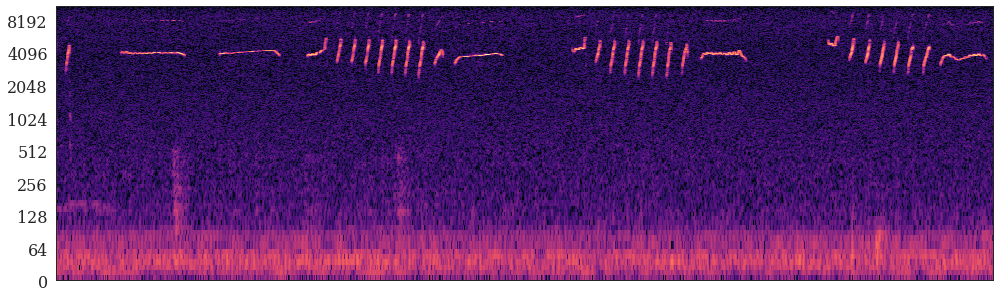

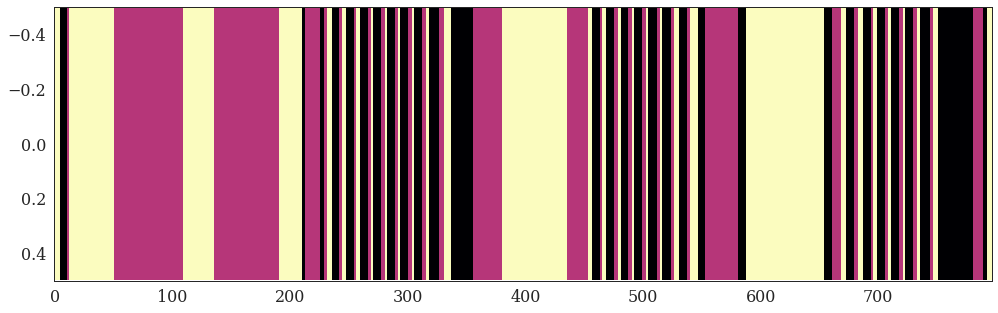

In [183]:
%matplotlib inline

# Energy + MFCC13 + d1

num_mels=13
# window_size_ms=50
# window_shift_ms=12.5
spectrum_type="linear"
title=None
center=False
ref_db=20
preemphasis=0.97
min_db=-100
mean_norm=True,
mel_min_freq=3000
verbose=False
draw_verbose=False
# n_fft=int(window_size_ms / 1000 * sampling_rate)
figsize=(6.9*1.1, 4.2*1.1)

# Energy
energy_filter= {'filter': "butter", "filter_type": "highpass", "cutoff_freq": 4000, "order": 16}
energy = log_rms_energy(path=path, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, n_fft=n_fft, center=center, verbose=verbose, draw_verbose=draw_verbose, colorbar=colorbar, figsize=figsize)
logmel = librosa_spectrum_tacotron3(path=path, n_fft=n_fft, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, spectrum_type=spectrum_type, title=title, center=center, ref_db=ref_db, preemphasis=preemphasis, mel=num_mels, min_db=min_db, mean_norm=False, mel_min_freq=mel_min_freq, verbose=False, draw_verbose=False, figsize=figsize)
mfcc = librosa.feature.mfcc(sr=sampling_rate, S=logmel, n_mfcc=num_mels, dct_type=2, norm='ortho', lifter=0)


# Add energy: the zeroth coefficient is replaced with the log of the total frame rms energy.
# energy = (energy - energy.mean()) / energy.std()
mfcc[0] = energy
logmel[0] = energy

feat = mfcc.T

import python_speech_features
feat_delta = python_speech_features.base.delta(feat, N=2)
feat_delta2 = python_speech_features.base.delta(feat_delta, N=2)
feat_d1 = np.concatenate([feat, feat_delta], axis=1)
feat_d2 = np.concatenate([feat, feat_delta, feat_delta2], axis=1)

sources = feat_d1

D = sources.shape[1]
alpha = 1 # concentrate parameter
mu0 = np.mean(sources, axis = 0)
lmbda = 1 # belief of the mean
Sigma0 = np.cov(sources.T) # belief of the covariance
nu = D + 3 # belief of variance or degree of freedom
K0=3 # initial number of clusters
num_iterations = 1500
verbose=True

results = DPGMM3(alpha, mu0, lmbda, Sigma0, nu, sources, K0, num_iterations, verbose)
preds = np.argmax(results['z_posterior'], axis=1) # or preds = results['z']

print(preds)

y, sr = librosa.load(path, sr=48000)
D = librosa.stft(y)  # STFT of y
S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = librosa.display.specshow(S_db, cmap='magma', y_axis='log')
plt.gca().set_ylabel(None)# Turn off y labels

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = plt.imshow(preds[:,np.newaxis].T, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'

[ 01/07/2022 23:41:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 0 - num_clusters: 3
[ 01/07/2022 23:41:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1 - num_clusters: 3
[ 01/07/2022 23:41:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 2 - num_clusters: 3
[ 01/07/2022 23:41:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 3 - num_clusters: 3
[ 01/07/2022 23:41:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 4 - num_clusters: 3
[ 01/07/2022 23:41:40 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 5 - num_clusters: 3
[ 01/07/2022 23:41:40 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 6 - num_clusters: 3
[ 01/07/2022 23:41:40 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 7 - num_clusters: 3
[ 01/07/2022 23:41:40 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 8 - num_clusters: 3
[ 01/07/2022 23:41:40 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 9 - num_clusters: 3
[ 01/07/2022 23:41:40 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 10 - num

[ 01/07/2022 23:41:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 89 - num_clusters: 3
[ 01/07/2022 23:41:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 90 - num_clusters: 3
[ 01/07/2022 23:41:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 91 - num_clusters: 3
[ 01/07/2022 23:41:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 92 - num_clusters: 3
[ 01/07/2022 23:41:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 93 - num_clusters: 3
[ 01/07/2022 23:41:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 94 - num_clusters: 3
[ 01/07/2022 23:41:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 95 - num_clusters: 3
[ 01/07/2022 23:41:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 96 - num_clusters: 3
[ 01/07/2022 23:41:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 97 - num_clusters: 3
[ 01/07/2022 23:41:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 98 - num_clusters: 3
[ 01/07/2022 23:41:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter

[ 01/07/2022 23:42:03 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 177 - num_clusters: 3
[ 01/07/2022 23:42:03 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 178 - num_clusters: 3
[ 01/07/2022 23:42:03 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 179 - num_clusters: 3
[ 01/07/2022 23:42:03 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 180 - num_clusters: 3
[ 01/07/2022 23:42:03 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 181 - num_clusters: 3
[ 01/07/2022 23:42:03 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 182 - num_clusters: 3
[ 01/07/2022 23:42:03 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 183 - num_clusters: 3
[ 01/07/2022 23:42:04 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 184 - num_clusters: 3
[ 01/07/2022 23:42:04 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 185 - num_clusters: 3
[ 01/07/2022 23:42:04 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 186 - num_clusters: 3
[ 01/07/2022 23:42:04 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 23:42:15 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 265 - num_clusters: 3
[ 01/07/2022 23:42:15 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 266 - num_clusters: 3
[ 01/07/2022 23:42:15 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 267 - num_clusters: 3
[ 01/07/2022 23:42:15 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 268 - num_clusters: 3
[ 01/07/2022 23:42:15 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 269 - num_clusters: 3
[ 01/07/2022 23:42:15 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 270 - num_clusters: 3
[ 01/07/2022 23:42:15 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 271 - num_clusters: 3
[ 01/07/2022 23:42:16 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 272 - num_clusters: 3
[ 01/07/2022 23:42:16 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 273 - num_clusters: 3
[ 01/07/2022 23:42:16 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 274 - num_clusters: 3
[ 01/07/2022 23:42:16 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 23:42:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 353 - num_clusters: 3
[ 01/07/2022 23:42:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 354 - num_clusters: 3
[ 01/07/2022 23:42:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 355 - num_clusters: 3
[ 01/07/2022 23:42:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 356 - num_clusters: 3
[ 01/07/2022 23:42:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 357 - num_clusters: 3
[ 01/07/2022 23:42:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 358 - num_clusters: 3
[ 01/07/2022 23:42:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 359 - num_clusters: 3
[ 01/07/2022 23:42:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 360 - num_clusters: 3
[ 01/07/2022 23:42:24 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 361 - num_clusters: 3
[ 01/07/2022 23:42:24 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 362 - num_clusters: 3
[ 01/07/2022 23:42:24 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 23:42:35 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 441 - num_clusters: 3
[ 01/07/2022 23:42:35 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 442 - num_clusters: 3
[ 01/07/2022 23:42:35 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 443 - num_clusters: 3
[ 01/07/2022 23:42:35 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 444 - num_clusters: 3
[ 01/07/2022 23:42:35 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 445 - num_clusters: 3
[ 01/07/2022 23:42:35 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 446 - num_clusters: 3
[ 01/07/2022 23:42:35 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 447 - num_clusters: 3
[ 01/07/2022 23:42:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 448 - num_clusters: 3
[ 01/07/2022 23:42:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 449 - num_clusters: 3
[ 01/07/2022 23:42:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 450 - num_clusters: 3
[ 01/07/2022 23:42:36 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 23:42:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 529 - num_clusters: 3
[ 01/07/2022 23:42:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 530 - num_clusters: 3
[ 01/07/2022 23:42:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 531 - num_clusters: 3
[ 01/07/2022 23:42:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 532 - num_clusters: 3
[ 01/07/2022 23:42:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 533 - num_clusters: 3
[ 01/07/2022 23:42:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 534 - num_clusters: 3
[ 01/07/2022 23:42:47 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 535 - num_clusters: 3
[ 01/07/2022 23:42:48 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 536 - num_clusters: 3
[ 01/07/2022 23:42:48 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 537 - num_clusters: 3
[ 01/07/2022 23:42:48 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 538 - num_clusters: 3
[ 01/07/2022 23:42:48 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 23:42:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 617 - num_clusters: 3
[ 01/07/2022 23:42:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 618 - num_clusters: 3
[ 01/07/2022 23:42:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 619 - num_clusters: 3
[ 01/07/2022 23:42:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 620 - num_clusters: 3
[ 01/07/2022 23:42:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 621 - num_clusters: 3
[ 01/07/2022 23:42:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 622 - num_clusters: 3
[ 01/07/2022 23:42:59 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 623 - num_clusters: 3
[ 01/07/2022 23:43:00 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 624 - num_clusters: 3
[ 01/07/2022 23:43:00 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 625 - num_clusters: 3
[ 01/07/2022 23:43:00 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 626 - num_clusters: 3
[ 01/07/2022 23:43:00 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 23:43:09 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 705 - num_clusters: 3
[ 01/07/2022 23:43:09 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 706 - num_clusters: 3
[ 01/07/2022 23:43:09 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 707 - num_clusters: 3
[ 01/07/2022 23:43:09 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 708 - num_clusters: 3
[ 01/07/2022 23:43:09 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 709 - num_clusters: 3
[ 01/07/2022 23:43:09 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 710 - num_clusters: 3
[ 01/07/2022 23:43:09 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 711 - num_clusters: 3
[ 01/07/2022 23:43:09 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 712 - num_clusters: 3
[ 01/07/2022 23:43:10 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 713 - num_clusters: 3
[ 01/07/2022 23:43:10 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 714 - num_clusters: 3
[ 01/07/2022 23:43:10 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 23:43:18 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 793 - num_clusters: 3
[ 01/07/2022 23:43:18 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 794 - num_clusters: 3
[ 01/07/2022 23:43:18 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 795 - num_clusters: 3
[ 01/07/2022 23:43:19 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 796 - num_clusters: 3
[ 01/07/2022 23:43:19 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 797 - num_clusters: 3
[ 01/07/2022 23:43:19 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 798 - num_clusters: 3
[ 01/07/2022 23:43:19 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 799 - num_clusters: 3
[ 01/07/2022 23:43:19 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 800 - num_clusters: 3
[ 01/07/2022 23:43:19 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 801 - num_clusters: 3
[ 01/07/2022 23:43:19 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 802 - num_clusters: 3
[ 01/07/2022 23:43:20 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 23:43:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 881 - num_clusters: 3
[ 01/07/2022 23:43:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 882 - num_clusters: 3
[ 01/07/2022 23:43:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 883 - num_clusters: 3
[ 01/07/2022 23:43:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 884 - num_clusters: 3
[ 01/07/2022 23:43:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 885 - num_clusters: 3
[ 01/07/2022 23:43:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 886 - num_clusters: 3
[ 01/07/2022 23:43:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 887 - num_clusters: 3
[ 01/07/2022 23:43:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 888 - num_clusters: 3
[ 01/07/2022 23:43:28 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 889 - num_clusters: 3
[ 01/07/2022 23:43:28 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 890 - num_clusters: 3
[ 01/07/2022 23:43:28 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 23:43:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 969 - num_clusters: 3
[ 01/07/2022 23:43:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 970 - num_clusters: 3
[ 01/07/2022 23:43:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 971 - num_clusters: 3
[ 01/07/2022 23:43:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 972 - num_clusters: 3
[ 01/07/2022 23:43:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 973 - num_clusters: 3
[ 01/07/2022 23:43:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 974 - num_clusters: 3
[ 01/07/2022 23:43:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 975 - num_clusters: 3
[ 01/07/2022 23:43:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 976 - num_clusters: 3
[ 01/07/2022 23:43:40 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 977 - num_clusters: 3
[ 01/07/2022 23:43:40 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 978 - num_clusters: 3
[ 01/07/2022 23:43:40 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 23:43:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1056 - num_clusters: 3
[ 01/07/2022 23:43:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1057 - num_clusters: 3
[ 01/07/2022 23:43:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1058 - num_clusters: 3
[ 01/07/2022 23:43:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1059 - num_clusters: 3
[ 01/07/2022 23:43:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1060 - num_clusters: 3
[ 01/07/2022 23:43:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1061 - num_clusters: 3
[ 01/07/2022 23:43:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1062 - num_clusters: 3
[ 01/07/2022 23:43:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1063 - num_clusters: 3
[ 01/07/2022 23:43:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1064 - num_clusters: 3
[ 01/07/2022 23:43:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1065 - num_clusters: 3
[ 01/07/2022 23:43:51 | <ipython-input-160-a49e42b

[ 01/07/2022 23:44:02 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1143 - num_clusters: 3
[ 01/07/2022 23:44:02 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1144 - num_clusters: 3
[ 01/07/2022 23:44:02 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1145 - num_clusters: 3
[ 01/07/2022 23:44:02 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1146 - num_clusters: 3
[ 01/07/2022 23:44:02 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1147 - num_clusters: 3
[ 01/07/2022 23:44:02 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1148 - num_clusters: 3
[ 01/07/2022 23:44:02 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1149 - num_clusters: 3
[ 01/07/2022 23:44:03 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1150 - num_clusters: 3
[ 01/07/2022 23:44:03 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1151 - num_clusters: 3
[ 01/07/2022 23:44:03 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1152 - num_clusters: 3
[ 01/07/2022 23:44:03 | <ipython-input-160-a49e42b

[ 01/07/2022 23:44:13 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1230 - num_clusters: 3
[ 01/07/2022 23:44:14 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1231 - num_clusters: 3
[ 01/07/2022 23:44:14 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1232 - num_clusters: 3
[ 01/07/2022 23:44:14 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1233 - num_clusters: 3
[ 01/07/2022 23:44:14 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1234 - num_clusters: 3
[ 01/07/2022 23:44:14 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1235 - num_clusters: 3
[ 01/07/2022 23:44:14 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1236 - num_clusters: 3
[ 01/07/2022 23:44:14 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1237 - num_clusters: 3
[ 01/07/2022 23:44:14 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1238 - num_clusters: 3
[ 01/07/2022 23:44:15 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1239 - num_clusters: 3
[ 01/07/2022 23:44:15 | <ipython-input-160-a49e42b

[ 01/07/2022 23:44:25 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1317 - num_clusters: 3
[ 01/07/2022 23:44:25 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1318 - num_clusters: 3
[ 01/07/2022 23:44:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1319 - num_clusters: 3
[ 01/07/2022 23:44:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1320 - num_clusters: 3
[ 01/07/2022 23:44:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1321 - num_clusters: 3
[ 01/07/2022 23:44:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1322 - num_clusters: 3
[ 01/07/2022 23:44:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1323 - num_clusters: 3
[ 01/07/2022 23:44:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1324 - num_clusters: 3
[ 01/07/2022 23:44:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1325 - num_clusters: 3
[ 01/07/2022 23:44:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1326 - num_clusters: 3
[ 01/07/2022 23:44:27 | <ipython-input-160-a49e42b

[ 01/07/2022 23:44:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1404 - num_clusters: 3
[ 01/07/2022 23:44:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1405 - num_clusters: 3
[ 01/07/2022 23:44:37 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1406 - num_clusters: 3
[ 01/07/2022 23:44:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1407 - num_clusters: 3
[ 01/07/2022 23:44:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1408 - num_clusters: 3
[ 01/07/2022 23:44:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1409 - num_clusters: 3
[ 01/07/2022 23:44:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1410 - num_clusters: 3
[ 01/07/2022 23:44:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1411 - num_clusters: 3
[ 01/07/2022 23:44:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1412 - num_clusters: 3
[ 01/07/2022 23:44:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1413 - num_clusters: 3
[ 01/07/2022 23:44:39 | <ipython-input-160-a49e42b

[ 01/07/2022 23:44:49 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1491 - num_clusters: 3
[ 01/07/2022 23:44:49 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1492 - num_clusters: 3
[ 01/07/2022 23:44:49 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1493 - num_clusters: 3
[ 01/07/2022 23:44:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1494 - num_clusters: 3
[ 01/07/2022 23:44:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1495 - num_clusters: 3
[ 01/07/2022 23:44:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1496 - num_clusters: 3
[ 01/07/2022 23:44:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1497 - num_clusters: 3
[ 01/07/2022 23:44:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1498 - num_clusters: 3
[ 01/07/2022 23:44:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1499 - num_clusters: 3
[1 0 2 2 2 2 2 2 0 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1

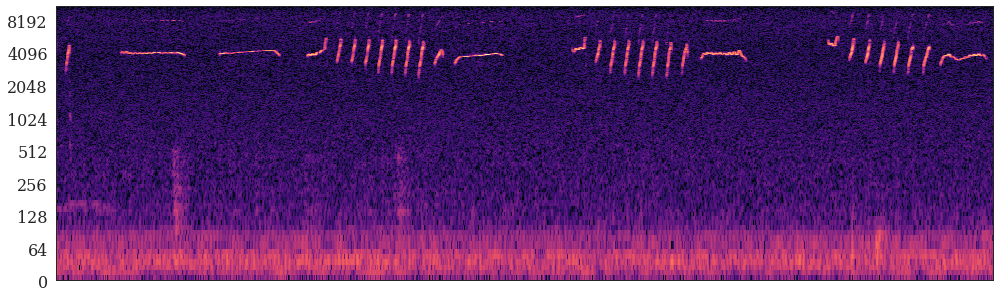

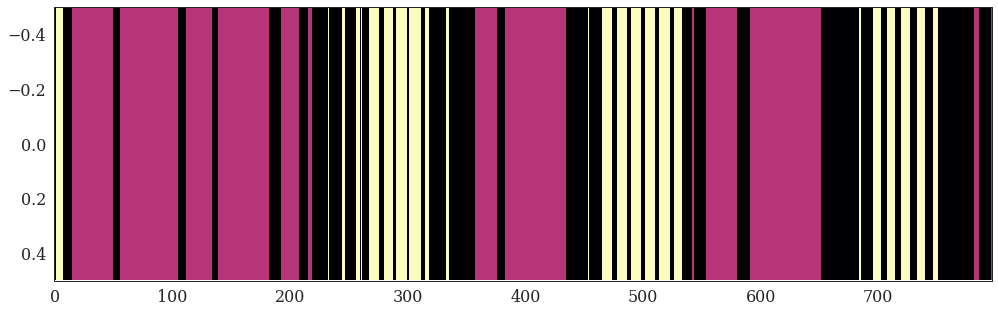

In [195]:
%matplotlib inline

# Energy + MFCC13 + d2

num_mels=13
# window_size_ms=50
# window_shift_ms=12.5
spectrum_type="linear"
title=None
center=False
ref_db=20
preemphasis=0.97
min_db=-100
mean_norm=True,
mel_min_freq=3000
verbose=False
draw_verbose=False
# n_fft=int(window_size_ms / 1000 * sampling_rate)
figsize=(6.9*1.1, 4.2*1.1)

# Energy
energy_filter= {'filter': "butter", "filter_type": "highpass", "cutoff_freq": 4000, "order": 16}
energy = log_rms_energy(path=path, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, n_fft=n_fft, center=center, verbose=verbose, draw_verbose=draw_verbose, colorbar=colorbar, figsize=figsize)
logmel = librosa_spectrum_tacotron3(path=path, n_fft=n_fft, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, spectrum_type=spectrum_type, title=title, center=center, ref_db=ref_db, preemphasis=preemphasis, mel=num_mels, min_db=min_db, mean_norm=False, mel_min_freq=mel_min_freq, verbose=False, draw_verbose=False, figsize=figsize)
mfcc = librosa.feature.mfcc(sr=sampling_rate, S=logmel, n_mfcc=num_mels, dct_type=2, norm='ortho', lifter=0)


# Add energy: the zeroth coefficient is replaced with the log of the total frame rms energy.
# energy = (energy - energy.mean()) / energy.std()
mfcc[0] = energy
logmel[0] = energy

feat = mfcc.T

import python_speech_features
feat_delta = python_speech_features.base.delta(feat, N=2)
feat_delta2 = python_speech_features.base.delta(feat_delta, N=2)
feat_d1 = np.concatenate([feat, feat_delta], axis=1)
feat_d2 = np.concatenate([feat, feat_delta, feat_delta2], axis=1)

sources = feat_d2

D = sources.shape[1]
alpha = 1 # concentrate parameter
mu0 = np.mean(sources, axis = 0)
lmbda = 1 # belief of the mean
Sigma0 = np.cov(sources.T) # belief of the covariance
nu = D + 3 # belief of variance or degree of freedom
K0=3 # initial number of clusters
num_iterations = 1500
verbose=True

results = DPGMM3(alpha, mu0, lmbda, Sigma0, nu, sources, K0, num_iterations, verbose)
preds = np.argmax(results['z_posterior'], axis=1) # or preds = results['z']

print(preds)

y, sr = librosa.load(path, sr=48000)
D = librosa.stft(y)  # STFT of y
S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = librosa.display.specshow(S_db, cmap='magma', y_axis='log')
plt.gca().set_ylabel(None)# Turn off y labels

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = plt.imshow(preds[:,np.newaxis].T, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'

[ 01/07/2022 23:44:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 0 - num_clusters: 3
[ 01/07/2022 23:44:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1 - num_clusters: 3
[ 01/07/2022 23:44:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 2 - num_clusters: 3
[ 01/07/2022 23:44:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 3 - num_clusters: 3
[ 01/07/2022 23:44:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 4 - num_clusters: 3
[ 01/07/2022 23:44:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 5 - num_clusters: 3
[ 01/07/2022 23:44:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 6 - num_clusters: 3
[ 01/07/2022 23:44:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 7 - num_clusters: 3
[ 01/07/2022 23:44:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 8 - num_clusters: 3
[ 01/07/2022 23:44:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 9 - num_clusters: 3
[ 01/07/2022 23:44:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 10 - num

[ 01/07/2022 23:45:08 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 89 - num_clusters: 3
[ 01/07/2022 23:45:08 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 90 - num_clusters: 3
[ 01/07/2022 23:45:08 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 91 - num_clusters: 3
[ 01/07/2022 23:45:08 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 92 - num_clusters: 3
[ 01/07/2022 23:45:09 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 93 - num_clusters: 3
[ 01/07/2022 23:45:09 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 94 - num_clusters: 3
[ 01/07/2022 23:45:09 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 95 - num_clusters: 3
[ 01/07/2022 23:45:09 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 96 - num_clusters: 3
[ 01/07/2022 23:45:09 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 97 - num_clusters: 3
[ 01/07/2022 23:45:09 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 98 - num_clusters: 3
[ 01/07/2022 23:45:10 | <ipython-input-160-a49e42be2f2d> | INFO ] iter

[ 01/07/2022 23:45:24 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 177 - num_clusters: 3
[ 01/07/2022 23:45:24 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 178 - num_clusters: 3
[ 01/07/2022 23:45:24 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 179 - num_clusters: 3
[ 01/07/2022 23:45:24 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 180 - num_clusters: 3
[ 01/07/2022 23:45:24 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 181 - num_clusters: 3
[ 01/07/2022 23:45:24 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 182 - num_clusters: 3
[ 01/07/2022 23:45:25 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 183 - num_clusters: 3
[ 01/07/2022 23:45:25 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 184 - num_clusters: 3
[ 01/07/2022 23:45:25 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 185 - num_clusters: 3
[ 01/07/2022 23:45:25 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 186 - num_clusters: 3
[ 01/07/2022 23:45:25 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 23:45:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 265 - num_clusters: 3
[ 01/07/2022 23:45:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 266 - num_clusters: 3
[ 01/07/2022 23:45:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 267 - num_clusters: 3
[ 01/07/2022 23:45:40 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 268 - num_clusters: 3
[ 01/07/2022 23:45:40 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 269 - num_clusters: 3
[ 01/07/2022 23:45:40 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 270 - num_clusters: 3
[ 01/07/2022 23:45:40 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 271 - num_clusters: 3
[ 01/07/2022 23:45:40 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 272 - num_clusters: 3
[ 01/07/2022 23:45:40 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 273 - num_clusters: 3
[ 01/07/2022 23:45:41 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 274 - num_clusters: 3
[ 01/07/2022 23:45:41 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 23:45:55 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 353 - num_clusters: 3
[ 01/07/2022 23:45:55 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 354 - num_clusters: 3
[ 01/07/2022 23:45:55 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 355 - num_clusters: 3
[ 01/07/2022 23:45:55 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 356 - num_clusters: 3
[ 01/07/2022 23:45:55 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 357 - num_clusters: 3
[ 01/07/2022 23:45:55 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 358 - num_clusters: 3
[ 01/07/2022 23:45:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 359 - num_clusters: 3
[ 01/07/2022 23:45:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 360 - num_clusters: 3
[ 01/07/2022 23:45:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 361 - num_clusters: 3
[ 01/07/2022 23:45:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 362 - num_clusters: 3
[ 01/07/2022 23:45:56 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 23:46:10 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 441 - num_clusters: 3
[ 01/07/2022 23:46:10 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 442 - num_clusters: 3
[ 01/07/2022 23:46:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 443 - num_clusters: 3
[ 01/07/2022 23:46:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 444 - num_clusters: 3
[ 01/07/2022 23:46:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 445 - num_clusters: 3
[ 01/07/2022 23:46:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 446 - num_clusters: 3
[ 01/07/2022 23:46:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 447 - num_clusters: 3
[ 01/07/2022 23:46:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 448 - num_clusters: 3
[ 01/07/2022 23:46:12 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 449 - num_clusters: 3
[ 01/07/2022 23:46:12 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 450 - num_clusters: 3
[ 01/07/2022 23:46:12 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 23:46:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 529 - num_clusters: 3
[ 01/07/2022 23:46:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 530 - num_clusters: 3
[ 01/07/2022 23:46:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 531 - num_clusters: 3
[ 01/07/2022 23:46:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 532 - num_clusters: 3
[ 01/07/2022 23:46:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 533 - num_clusters: 3
[ 01/07/2022 23:46:26 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 534 - num_clusters: 3
[ 01/07/2022 23:46:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 535 - num_clusters: 3
[ 01/07/2022 23:46:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 536 - num_clusters: 3
[ 01/07/2022 23:46:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 537 - num_clusters: 3
[ 01/07/2022 23:46:27 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 538 - num_clusters: 3
[ 01/07/2022 23:46:27 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 23:46:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 617 - num_clusters: 3
[ 01/07/2022 23:46:40 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 618 - num_clusters: 3
[ 01/07/2022 23:46:40 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 619 - num_clusters: 3
[ 01/07/2022 23:46:40 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 620 - num_clusters: 3
[ 01/07/2022 23:46:40 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 621 - num_clusters: 3
[ 01/07/2022 23:46:40 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 622 - num_clusters: 3
[ 01/07/2022 23:46:40 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 623 - num_clusters: 3
[ 01/07/2022 23:46:40 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 624 - num_clusters: 3
[ 01/07/2022 23:46:41 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 625 - num_clusters: 3
[ 01/07/2022 23:46:41 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 626 - num_clusters: 3
[ 01/07/2022 23:46:41 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 23:46:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 705 - num_clusters: 3
[ 01/07/2022 23:46:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 706 - num_clusters: 3
[ 01/07/2022 23:46:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 707 - num_clusters: 3
[ 01/07/2022 23:46:53 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 708 - num_clusters: 3
[ 01/07/2022 23:46:54 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 709 - num_clusters: 3
[ 01/07/2022 23:46:54 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 710 - num_clusters: 3
[ 01/07/2022 23:46:54 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 711 - num_clusters: 3
[ 01/07/2022 23:46:54 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 712 - num_clusters: 3
[ 01/07/2022 23:46:54 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 713 - num_clusters: 3
[ 01/07/2022 23:46:54 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 714 - num_clusters: 3
[ 01/07/2022 23:46:55 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 23:47:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 793 - num_clusters: 3
[ 01/07/2022 23:47:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 794 - num_clusters: 3
[ 01/07/2022 23:47:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 795 - num_clusters: 3
[ 01/07/2022 23:47:08 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 796 - num_clusters: 3
[ 01/07/2022 23:47:08 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 797 - num_clusters: 3
[ 01/07/2022 23:47:08 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 798 - num_clusters: 3
[ 01/07/2022 23:47:08 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 799 - num_clusters: 3
[ 01/07/2022 23:47:08 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 800 - num_clusters: 3
[ 01/07/2022 23:47:08 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 801 - num_clusters: 3
[ 01/07/2022 23:47:09 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 802 - num_clusters: 3
[ 01/07/2022 23:47:09 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 23:47:19 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 881 - num_clusters: 3
[ 01/07/2022 23:47:19 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 882 - num_clusters: 3
[ 01/07/2022 23:47:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 883 - num_clusters: 3
[ 01/07/2022 23:47:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 884 - num_clusters: 3
[ 01/07/2022 23:47:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 885 - num_clusters: 3
[ 01/07/2022 23:47:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 886 - num_clusters: 3
[ 01/07/2022 23:47:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 887 - num_clusters: 3
[ 01/07/2022 23:47:20 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 888 - num_clusters: 3
[ 01/07/2022 23:47:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 889 - num_clusters: 3
[ 01/07/2022 23:47:21 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 890 - num_clusters: 3
[ 01/07/2022 23:47:21 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 23:47:35 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 969 - num_clusters: 3
[ 01/07/2022 23:47:35 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 970 - num_clusters: 3
[ 01/07/2022 23:47:35 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 971 - num_clusters: 3
[ 01/07/2022 23:47:35 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 972 - num_clusters: 3
[ 01/07/2022 23:47:35 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 973 - num_clusters: 3
[ 01/07/2022 23:47:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 974 - num_clusters: 3
[ 01/07/2022 23:47:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 975 - num_clusters: 3
[ 01/07/2022 23:47:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 976 - num_clusters: 3
[ 01/07/2022 23:47:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 977 - num_clusters: 3
[ 01/07/2022 23:47:36 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 978 - num_clusters: 3
[ 01/07/2022 23:47:37 | <ipython-input-160-a49e42be2f2d> | I

[ 01/07/2022 23:47:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1056 - num_clusters: 3
[ 01/07/2022 23:47:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1057 - num_clusters: 3
[ 01/07/2022 23:47:50 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1058 - num_clusters: 3
[ 01/07/2022 23:47:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1059 - num_clusters: 3
[ 01/07/2022 23:47:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1060 - num_clusters: 3
[ 01/07/2022 23:47:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1061 - num_clusters: 3
[ 01/07/2022 23:47:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1062 - num_clusters: 3
[ 01/07/2022 23:47:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1063 - num_clusters: 3
[ 01/07/2022 23:47:51 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1064 - num_clusters: 3
[ 01/07/2022 23:47:52 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1065 - num_clusters: 3
[ 01/07/2022 23:47:52 | <ipython-input-160-a49e42b

[ 01/07/2022 23:48:05 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1143 - num_clusters: 3
[ 01/07/2022 23:48:05 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1144 - num_clusters: 3
[ 01/07/2022 23:48:05 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1145 - num_clusters: 3
[ 01/07/2022 23:48:05 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1146 - num_clusters: 3
[ 01/07/2022 23:48:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1147 - num_clusters: 3
[ 01/07/2022 23:48:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1148 - num_clusters: 3
[ 01/07/2022 23:48:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1149 - num_clusters: 3
[ 01/07/2022 23:48:06 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1150 - num_clusters: 3
[ 01/07/2022 23:48:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1151 - num_clusters: 3
[ 01/07/2022 23:48:07 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1152 - num_clusters: 3
[ 01/07/2022 23:48:07 | <ipython-input-160-a49e42b

[ 01/07/2022 23:48:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1230 - num_clusters: 3
[ 01/07/2022 23:48:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1231 - num_clusters: 3
[ 01/07/2022 23:48:22 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1232 - num_clusters: 3
[ 01/07/2022 23:48:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1233 - num_clusters: 3
[ 01/07/2022 23:48:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1234 - num_clusters: 3
[ 01/07/2022 23:48:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1235 - num_clusters: 3
[ 01/07/2022 23:48:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1236 - num_clusters: 3
[ 01/07/2022 23:48:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1237 - num_clusters: 3
[ 01/07/2022 23:48:23 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1238 - num_clusters: 3
[ 01/07/2022 23:48:24 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1239 - num_clusters: 3
[ 01/07/2022 23:48:24 | <ipython-input-160-a49e42b

[ 01/07/2022 23:48:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1317 - num_clusters: 3
[ 01/07/2022 23:48:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1318 - num_clusters: 3
[ 01/07/2022 23:48:38 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1319 - num_clusters: 3
[ 01/07/2022 23:48:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1320 - num_clusters: 3
[ 01/07/2022 23:48:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1321 - num_clusters: 3
[ 01/07/2022 23:48:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1322 - num_clusters: 3
[ 01/07/2022 23:48:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1323 - num_clusters: 3
[ 01/07/2022 23:48:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1324 - num_clusters: 3
[ 01/07/2022 23:48:39 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1325 - num_clusters: 3
[ 01/07/2022 23:48:40 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1326 - num_clusters: 3
[ 01/07/2022 23:48:40 | <ipython-input-160-a49e42b

[ 01/07/2022 23:48:54 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1404 - num_clusters: 3
[ 01/07/2022 23:48:54 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1405 - num_clusters: 3
[ 01/07/2022 23:48:54 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1406 - num_clusters: 3
[ 01/07/2022 23:48:54 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1407 - num_clusters: 3
[ 01/07/2022 23:48:55 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1408 - num_clusters: 3
[ 01/07/2022 23:48:55 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1409 - num_clusters: 3
[ 01/07/2022 23:48:55 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1410 - num_clusters: 3
[ 01/07/2022 23:48:55 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1411 - num_clusters: 3
[ 01/07/2022 23:48:55 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1412 - num_clusters: 3
[ 01/07/2022 23:48:55 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1413 - num_clusters: 3
[ 01/07/2022 23:48:56 | <ipython-input-160-a49e42b

[ 01/07/2022 23:49:09 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1491 - num_clusters: 3
[ 01/07/2022 23:49:09 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1492 - num_clusters: 3
[ 01/07/2022 23:49:10 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1493 - num_clusters: 3
[ 01/07/2022 23:49:10 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1494 - num_clusters: 3
[ 01/07/2022 23:49:10 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1495 - num_clusters: 3
[ 01/07/2022 23:49:10 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1496 - num_clusters: 3
[ 01/07/2022 23:49:10 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1497 - num_clusters: 3
[ 01/07/2022 23:49:10 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1498 - num_clusters: 3
[ 01/07/2022 23:49:11 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1499 - num_clusters: 3
[0 0 0 2 2 2 2 2 2 2 2 2 2 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0

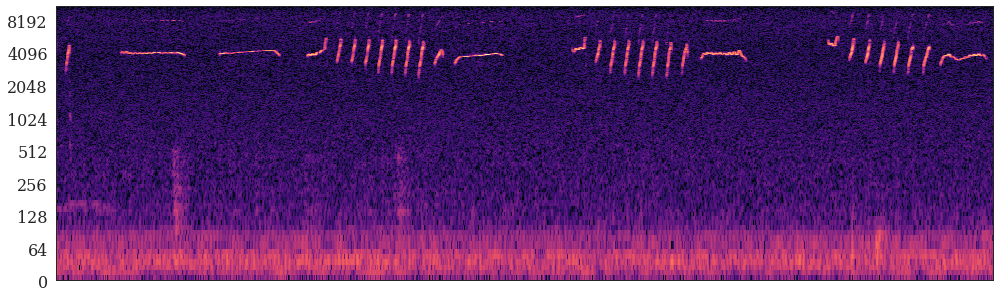

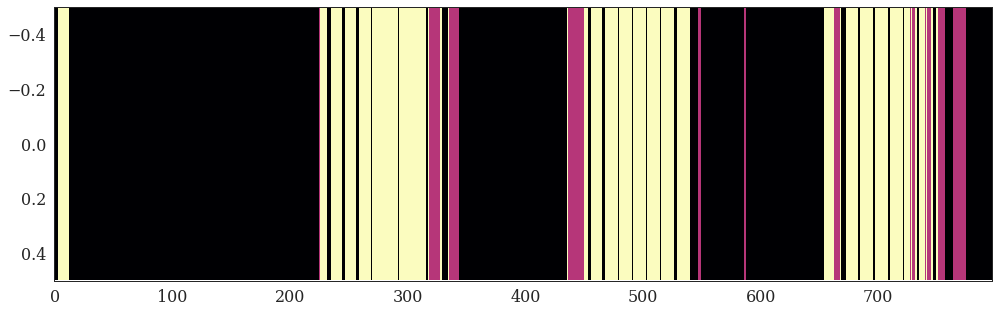

In [196]:
%matplotlib inline

# Energy + MFCC26 + d1

num_mels=26
# window_size_ms=50
# window_shift_ms=12.5
spectrum_type="linear"
title=None
center=False
ref_db=20
preemphasis=0.97
min_db=-100
mean_norm=True,
mel_min_freq=3000
verbose=False
draw_verbose=False
# n_fft=int(window_size_ms / 1000 * sampling_rate)
figsize=(6.9*1.1, 4.2*1.1)

# Energy
energy_filter= {'filter': "butter", "filter_type": "highpass", "cutoff_freq": 4000, "order": 16}
energy = log_rms_energy(path=path, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, n_fft=n_fft, center=center, verbose=verbose, draw_verbose=draw_verbose, colorbar=colorbar, figsize=figsize)
logmel = librosa_spectrum_tacotron3(path=path, n_fft=n_fft, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, spectrum_type=spectrum_type, title=title, center=center, ref_db=ref_db, preemphasis=preemphasis, mel=num_mels, min_db=min_db, mean_norm=False, mel_min_freq=mel_min_freq, verbose=False, draw_verbose=False, figsize=figsize)
mfcc = librosa.feature.mfcc(sr=sampling_rate, S=logmel, n_mfcc=num_mels, dct_type=2, norm='ortho', lifter=0)


# Add energy: the zeroth coefficient is replaced with the log of the total frame rms energy.
# energy = (energy - energy.mean()) / energy.std()
mfcc[0] = energy
logmel[0] = energy

feat = mfcc.T

import python_speech_features
feat_delta = python_speech_features.base.delta(feat, N=2)
feat_delta2 = python_speech_features.base.delta(feat_delta, N=2)
feat_d1 = np.concatenate([feat, feat_delta], axis=1)
feat_d2 = np.concatenate([feat, feat_delta, feat_delta2], axis=1)

sources = feat_d1

D = sources.shape[1]
alpha = 1 # concentrate parameter
mu0 = np.mean(sources, axis = 0)
lmbda = 1 # belief of the mean
Sigma0 = np.cov(sources.T) # belief of the covariance
nu = D + 3 # belief of variance or degree of freedom
K0=3 # initial number of clusters
num_iterations = 1500
verbose=True

results = DPGMM3(alpha, mu0, lmbda, Sigma0, nu, sources, K0, num_iterations, verbose)
preds = np.argmax(results['z_posterior'], axis=1) # or preds = results['z']

print(preds)

y, sr = librosa.load(path, sr=48000)
D = librosa.stft(y)  # STFT of y
S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = librosa.display.specshow(S_db, cmap='magma', y_axis='log')
plt.gca().set_ylabel(None)# Turn off y labels

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = plt.imshow(preds[:,np.newaxis].T, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'

In [219]:
%matplotlib inline

# Energy + MFCC26 + d2

num_mels=26
# window_size_ms=50
# window_shift_ms=12.5
spectrum_type="linear"
title=None
center=False
ref_db=20
preemphasis=0.97
min_db=-100
mean_norm=True,
mel_min_freq=3000
verbose=False
draw_verbose=False
# n_fft=int(window_size_ms / 1000 * sampling_rate)
figsize=(6.9*1.1, 4.2*1.1)

# Energy
energy_filter= {'filter': "butter", "filter_type": "highpass", "cutoff_freq": 4000, "order": 16}
energy = log_rms_energy(path=path, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, n_fft=n_fft, center=center, verbose=verbose, draw_verbose=draw_verbose, colorbar=colorbar, figsize=figsize)
logmel = librosa_spectrum_tacotron3(path=path, n_fft=n_fft, sampling_rate=sampling_rate, window_size_ms=window_size_ms, window_shift_ms=window_shift_ms, spectrum_type=spectrum_type, title=title, center=center, ref_db=ref_db, preemphasis=preemphasis, mel=num_mels, min_db=min_db, mean_norm=False, mel_min_freq=mel_min_freq, verbose=False, draw_verbose=False, figsize=figsize)
mfcc = librosa.feature.mfcc(sr=sampling_rate, S=logmel, n_mfcc=num_mels, dct_type=2, norm='ortho', lifter=0)


# Add energy: the zeroth coefficient is replaced with the log of the total frame rms energy.
# energy = (energy - energy.mean()) / energy.std()
mfcc[0] = energy
logmel[0] = energy

feat = mfcc.T

import python_speech_features
feat_delta = python_speech_features.base.delta(feat, N=2)
feat_delta2 = python_speech_features.base.delta(feat_delta, N=2)
feat_d1 = np.concatenate([feat, feat_delta], axis=1)
feat_d2 = np.concatenate([feat, feat_delta, feat_delta2], axis=1)

sources = feat_d2

D = sources.shape[1]
alpha = 1 # concentrate parameter
mu0 = np.mean(sources, axis = 0)
lmbda = 1 # belief of the mean
Sigma0 = np.cov(sources.T) # belief of the covariance
nu = D + 3 # belief of variance or degree of freedom
K0=3 # initial number of clusters
num_iterations = 1500
verbose=True

results = DPGMM3(alpha, mu0, lmbda, Sigma0, nu, sources, K0, num_iterations, verbose)
preds = np.argmax(results['z_posterior'], axis=1) # or preds = results['z']

print(preds)

y, sr = librosa.load(path, sr=48000)
D = librosa.stft(y)  # STFT of y
S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = librosa.display.specshow(S_db, cmap='magma', y_axis='log')
plt.gca().set_ylabel(None)# Turn off y labels

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = plt.imshow(preds[:,np.newaxis].T, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'

[ 02/07/2022 18:26:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 0 - num_clusters: 3
[ 02/07/2022 18:26:56 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 1 - num_clusters: 3
[ 02/07/2022 18:26:57 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 2 - num_clusters: 3
[ 02/07/2022 18:26:57 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 3 - num_clusters: 3
[ 02/07/2022 18:26:57 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 4 - num_clusters: 3
[ 02/07/2022 18:26:57 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 5 - num_clusters: 3
[ 02/07/2022 18:26:58 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 6 - num_clusters: 3
[ 02/07/2022 18:26:58 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 7 - num_clusters: 3
[ 02/07/2022 18:26:58 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 8 - num_clusters: 3
[ 02/07/2022 18:26:58 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 9 - num_clusters: 3
[ 02/07/2022 18:26:58 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 10 - num

[ 02/07/2022 18:27:17 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 89 - num_clusters: 3
[ 02/07/2022 18:27:17 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 90 - num_clusters: 3
[ 02/07/2022 18:27:17 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 91 - num_clusters: 3
[ 02/07/2022 18:27:17 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 92 - num_clusters: 3
[ 02/07/2022 18:27:18 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 93 - num_clusters: 3
[ 02/07/2022 18:27:18 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 94 - num_clusters: 3
[ 02/07/2022 18:27:18 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 95 - num_clusters: 3
[ 02/07/2022 18:27:18 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 96 - num_clusters: 3
[ 02/07/2022 18:27:19 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 97 - num_clusters: 3
[ 02/07/2022 18:27:19 | <ipython-input-160-a49e42be2f2d> | INFO ] iter: 98 - num_clusters: 3
[ 02/07/2022 18:27:19 | <ipython-input-160-a49e42be2f2d> | INFO ] iter

LinAlgError: singular matrix

[ 15/06/2022 18:36:47 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 0 - num_clusters: 5
[ 15/06/2022 18:36:47 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1 - num_clusters: 5
[ 15/06/2022 18:36:47 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 2 - num_clusters: 6
[ 15/06/2022 18:36:47 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 3 - num_clusters: 6
[ 15/06/2022 18:36:47 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 4 - num_clusters: 6
[ 15/06/2022 18:36:48 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 5 - num_clusters: 6
[ 15/06/2022 18:36:48 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 6 - num_clusters: 6
[ 15/06/2022 18:36:48 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 7 - num_clusters: 6
[ 15/06/2022 18:36:48 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 8 - num_clusters: 6
[ 15/06/2022 18:36:48 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 9 - num_clusters: 6
[ 15/06/2022 18:36:48 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 10 - num

[ 15/06/2022 18:36:52 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 89 - num_clusters: 9
[ 15/06/2022 18:36:52 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 90 - num_clusters: 9
[ 15/06/2022 18:36:52 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 91 - num_clusters: 9
[ 15/06/2022 18:36:52 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 92 - num_clusters: 9
[ 15/06/2022 18:36:52 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 93 - num_clusters: 9
[ 15/06/2022 18:36:52 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 94 - num_clusters: 9
[ 15/06/2022 18:36:52 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 95 - num_clusters: 9
[ 15/06/2022 18:36:52 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 96 - num_clusters: 9
[ 15/06/2022 18:36:52 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 97 - num_clusters: 9
[ 15/06/2022 18:36:53 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 98 - num_clusters: 9
[ 15/06/2022 18:36:53 | <ipython-input-364-a49e42be2f2d> | INFO ] iter

[ 15/06/2022 18:36:58 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 177 - num_clusters: 8
[ 15/06/2022 18:36:58 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 178 - num_clusters: 8
[ 15/06/2022 18:36:58 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 179 - num_clusters: 8
[ 15/06/2022 18:36:58 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 180 - num_clusters: 8
[ 15/06/2022 18:36:58 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 181 - num_clusters: 8
[ 15/06/2022 18:36:58 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 182 - num_clusters: 8
[ 15/06/2022 18:36:58 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 183 - num_clusters: 8
[ 15/06/2022 18:36:58 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 184 - num_clusters: 8
[ 15/06/2022 18:36:58 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 185 - num_clusters: 8
[ 15/06/2022 18:36:58 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 186 - num_clusters: 8
[ 15/06/2022 18:36:58 | <ipython-input-364-a49e42be2f2d> | I

[ 15/06/2022 18:37:04 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 265 - num_clusters: 8
[ 15/06/2022 18:37:04 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 266 - num_clusters: 8
[ 15/06/2022 18:37:04 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 267 - num_clusters: 8
[ 15/06/2022 18:37:04 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 268 - num_clusters: 8
[ 15/06/2022 18:37:04 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 269 - num_clusters: 8
[ 15/06/2022 18:37:04 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 270 - num_clusters: 8
[ 15/06/2022 18:37:04 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 271 - num_clusters: 8
[ 15/06/2022 18:37:04 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 272 - num_clusters: 8
[ 15/06/2022 18:37:04 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 273 - num_clusters: 8
[ 15/06/2022 18:37:04 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 274 - num_clusters: 8
[ 15/06/2022 18:37:04 | <ipython-input-364-a49e42be2f2d> | I

[ 15/06/2022 18:37:10 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 353 - num_clusters: 8
[ 15/06/2022 18:37:10 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 354 - num_clusters: 8
[ 15/06/2022 18:37:10 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 355 - num_clusters: 8
[ 15/06/2022 18:37:10 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 356 - num_clusters: 8
[ 15/06/2022 18:37:10 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 357 - num_clusters: 8
[ 15/06/2022 18:37:10 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 358 - num_clusters: 8
[ 15/06/2022 18:37:10 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 359 - num_clusters: 8
[ 15/06/2022 18:37:10 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 360 - num_clusters: 8
[ 15/06/2022 18:37:10 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 361 - num_clusters: 8
[ 15/06/2022 18:37:10 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 362 - num_clusters: 8
[ 15/06/2022 18:37:10 | <ipython-input-364-a49e42be2f2d> | I

[ 15/06/2022 18:37:15 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 441 - num_clusters: 8
[ 15/06/2022 18:37:16 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 442 - num_clusters: 8
[ 15/06/2022 18:37:16 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 443 - num_clusters: 8
[ 15/06/2022 18:37:16 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 444 - num_clusters: 8
[ 15/06/2022 18:37:16 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 445 - num_clusters: 8
[ 15/06/2022 18:37:16 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 446 - num_clusters: 8
[ 15/06/2022 18:37:16 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 447 - num_clusters: 8
[ 15/06/2022 18:37:16 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 448 - num_clusters: 8
[ 15/06/2022 18:37:16 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 449 - num_clusters: 8
[ 15/06/2022 18:37:16 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 450 - num_clusters: 8
[ 15/06/2022 18:37:16 | <ipython-input-364-a49e42be2f2d> | I

[ 15/06/2022 18:37:21 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 529 - num_clusters: 8
[ 15/06/2022 18:37:21 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 530 - num_clusters: 8
[ 15/06/2022 18:37:22 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 531 - num_clusters: 8
[ 15/06/2022 18:37:22 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 532 - num_clusters: 8
[ 15/06/2022 18:37:22 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 533 - num_clusters: 8
[ 15/06/2022 18:37:22 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 534 - num_clusters: 8
[ 15/06/2022 18:37:22 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 535 - num_clusters: 8
[ 15/06/2022 18:37:22 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 536 - num_clusters: 8
[ 15/06/2022 18:37:22 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 537 - num_clusters: 8
[ 15/06/2022 18:37:22 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 538 - num_clusters: 8
[ 15/06/2022 18:37:22 | <ipython-input-364-a49e42be2f2d> | I

[ 15/06/2022 18:37:27 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 617 - num_clusters: 8
[ 15/06/2022 18:37:27 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 618 - num_clusters: 8
[ 15/06/2022 18:37:27 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 619 - num_clusters: 8
[ 15/06/2022 18:37:27 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 620 - num_clusters: 8
[ 15/06/2022 18:37:27 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 621 - num_clusters: 8
[ 15/06/2022 18:37:27 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 622 - num_clusters: 8
[ 15/06/2022 18:37:28 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 623 - num_clusters: 8
[ 15/06/2022 18:37:28 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 624 - num_clusters: 8
[ 15/06/2022 18:37:28 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 625 - num_clusters: 8
[ 15/06/2022 18:37:28 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 626 - num_clusters: 8
[ 15/06/2022 18:37:28 | <ipython-input-364-a49e42be2f2d> | I

[ 15/06/2022 18:37:33 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 705 - num_clusters: 8
[ 15/06/2022 18:37:33 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 706 - num_clusters: 8
[ 15/06/2022 18:37:33 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 707 - num_clusters: 8
[ 15/06/2022 18:37:33 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 708 - num_clusters: 8
[ 15/06/2022 18:37:33 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 709 - num_clusters: 8
[ 15/06/2022 18:37:33 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 710 - num_clusters: 8
[ 15/06/2022 18:37:33 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 711 - num_clusters: 8
[ 15/06/2022 18:37:33 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 712 - num_clusters: 8
[ 15/06/2022 18:37:34 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 713 - num_clusters: 8
[ 15/06/2022 18:37:34 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 714 - num_clusters: 8
[ 15/06/2022 18:37:34 | <ipython-input-364-a49e42be2f2d> | I

[ 15/06/2022 18:37:39 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 793 - num_clusters: 8
[ 15/06/2022 18:37:39 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 794 - num_clusters: 8
[ 15/06/2022 18:37:39 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 795 - num_clusters: 8
[ 15/06/2022 18:37:39 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 796 - num_clusters: 8
[ 15/06/2022 18:37:39 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 797 - num_clusters: 8
[ 15/06/2022 18:37:39 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 798 - num_clusters: 8
[ 15/06/2022 18:37:39 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 799 - num_clusters: 8
[ 15/06/2022 18:37:39 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 800 - num_clusters: 8
[ 15/06/2022 18:37:39 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 801 - num_clusters: 8
[ 15/06/2022 18:37:39 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 802 - num_clusters: 8
[ 15/06/2022 18:37:40 | <ipython-input-364-a49e42be2f2d> | I

[ 15/06/2022 18:37:45 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 881 - num_clusters: 8
[ 15/06/2022 18:37:45 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 882 - num_clusters: 8
[ 15/06/2022 18:37:45 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 883 - num_clusters: 8
[ 15/06/2022 18:37:45 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 884 - num_clusters: 8
[ 15/06/2022 18:37:45 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 885 - num_clusters: 8
[ 15/06/2022 18:37:45 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 886 - num_clusters: 8
[ 15/06/2022 18:37:45 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 887 - num_clusters: 8
[ 15/06/2022 18:37:45 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 888 - num_clusters: 8
[ 15/06/2022 18:37:45 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 889 - num_clusters: 8
[ 15/06/2022 18:37:45 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 890 - num_clusters: 8
[ 15/06/2022 18:37:46 | <ipython-input-364-a49e42be2f2d> | I

[ 15/06/2022 18:37:51 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 969 - num_clusters: 8
[ 15/06/2022 18:37:51 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 970 - num_clusters: 8
[ 15/06/2022 18:37:51 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 971 - num_clusters: 8
[ 15/06/2022 18:37:51 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 972 - num_clusters: 8
[ 15/06/2022 18:37:51 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 973 - num_clusters: 8
[ 15/06/2022 18:37:51 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 974 - num_clusters: 8
[ 15/06/2022 18:37:51 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 975 - num_clusters: 8
[ 15/06/2022 18:37:52 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 976 - num_clusters: 8
[ 15/06/2022 18:37:52 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 977 - num_clusters: 8
[ 15/06/2022 18:37:52 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 978 - num_clusters: 8
[ 15/06/2022 18:37:52 | <ipython-input-364-a49e42be2f2d> | I

[ 15/06/2022 18:37:57 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1056 - num_clusters: 9
[ 15/06/2022 18:37:57 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1057 - num_clusters: 8
[ 15/06/2022 18:37:57 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1058 - num_clusters: 8
[ 15/06/2022 18:37:57 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1059 - num_clusters: 8
[ 15/06/2022 18:37:57 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1060 - num_clusters: 8
[ 15/06/2022 18:37:57 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1061 - num_clusters: 8
[ 15/06/2022 18:37:57 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1062 - num_clusters: 8
[ 15/06/2022 18:37:57 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1063 - num_clusters: 8
[ 15/06/2022 18:37:57 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1064 - num_clusters: 8
[ 15/06/2022 18:37:57 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1065 - num_clusters: 8
[ 15/06/2022 18:37:58 | <ipython-input-364-a49e42b

[ 15/06/2022 18:38:03 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1143 - num_clusters: 8
[ 15/06/2022 18:38:03 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1144 - num_clusters: 8
[ 15/06/2022 18:38:03 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1145 - num_clusters: 8
[ 15/06/2022 18:38:03 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1146 - num_clusters: 8
[ 15/06/2022 18:38:03 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1147 - num_clusters: 8
[ 15/06/2022 18:38:03 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1148 - num_clusters: 8
[ 15/06/2022 18:38:03 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1149 - num_clusters: 9
[ 15/06/2022 18:38:03 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1150 - num_clusters: 9
[ 15/06/2022 18:38:03 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1151 - num_clusters: 9
[ 15/06/2022 18:38:03 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1152 - num_clusters: 9
[ 15/06/2022 18:38:03 | <ipython-input-364-a49e42b

[ 15/06/2022 18:38:08 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1230 - num_clusters: 8
[ 15/06/2022 18:38:08 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1231 - num_clusters: 8
[ 15/06/2022 18:38:09 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1232 - num_clusters: 8
[ 15/06/2022 18:38:09 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1233 - num_clusters: 8
[ 15/06/2022 18:38:09 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1234 - num_clusters: 8
[ 15/06/2022 18:38:09 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1235 - num_clusters: 8
[ 15/06/2022 18:38:09 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1236 - num_clusters: 8
[ 15/06/2022 18:38:09 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1237 - num_clusters: 8
[ 15/06/2022 18:38:09 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1238 - num_clusters: 8
[ 15/06/2022 18:38:09 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1239 - num_clusters: 8
[ 15/06/2022 18:38:09 | <ipython-input-364-a49e42b

[ 15/06/2022 18:38:14 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1317 - num_clusters: 8
[ 15/06/2022 18:38:14 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1318 - num_clusters: 8
[ 15/06/2022 18:38:14 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1319 - num_clusters: 8
[ 15/06/2022 18:38:14 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1320 - num_clusters: 8
[ 15/06/2022 18:38:14 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1321 - num_clusters: 8
[ 15/06/2022 18:38:15 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1322 - num_clusters: 8
[ 15/06/2022 18:38:15 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1323 - num_clusters: 8
[ 15/06/2022 18:38:15 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1324 - num_clusters: 8
[ 15/06/2022 18:38:15 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1325 - num_clusters: 8
[ 15/06/2022 18:38:15 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1326 - num_clusters: 8
[ 15/06/2022 18:38:15 | <ipython-input-364-a49e42b

[ 15/06/2022 18:38:20 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1404 - num_clusters: 8
[ 15/06/2022 18:38:20 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1405 - num_clusters: 8
[ 15/06/2022 18:38:20 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1406 - num_clusters: 8
[ 15/06/2022 18:38:20 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1407 - num_clusters: 8
[ 15/06/2022 18:38:20 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1408 - num_clusters: 8
[ 15/06/2022 18:38:20 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1409 - num_clusters: 8
[ 15/06/2022 18:38:20 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1410 - num_clusters: 8
[ 15/06/2022 18:38:20 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1411 - num_clusters: 8
[ 15/06/2022 18:38:21 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1412 - num_clusters: 8
[ 15/06/2022 18:38:21 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1413 - num_clusters: 8
[ 15/06/2022 18:38:21 | <ipython-input-364-a49e42b

[ 15/06/2022 18:38:26 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1491 - num_clusters: 8
[ 15/06/2022 18:38:26 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1492 - num_clusters: 8
[ 15/06/2022 18:38:26 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1493 - num_clusters: 8
[ 15/06/2022 18:38:26 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1494 - num_clusters: 8
[ 15/06/2022 18:38:26 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1495 - num_clusters: 8
[ 15/06/2022 18:38:26 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1496 - num_clusters: 8
[ 15/06/2022 18:38:26 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1497 - num_clusters: 8
[ 15/06/2022 18:38:26 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1498 - num_clusters: 8
[ 15/06/2022 18:38:26 | <ipython-input-364-a49e42be2f2d> | INFO ] iter: 1499 - num_clusters: 8
[0 5 3 3 3 3 3 1 1 1 2 5 5 6 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3
 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 6 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4 4

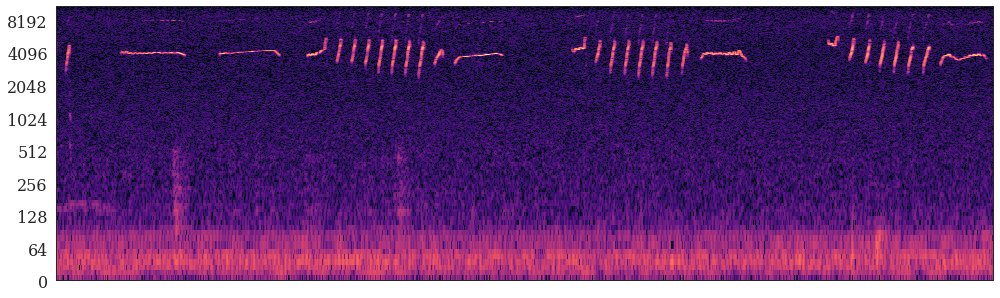

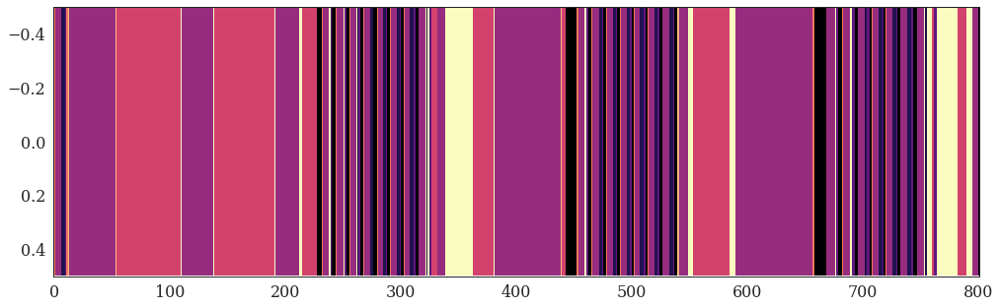

In [388]:
%matplotlib inline
import logging

import scipy
from sklearn import cluster, datasets
from itertools import cycle, islice


# sources = mfcc40_feats[utt_key] # (num_frames, feat_dim)
sources = logmel.T
# sources = mel80_feats[utt_key] 

D = sources.shape[1]
alpha = 1 # concentrate parameter
mu0 = np.mean(sources, axis = 0)
lmbda = 1 # belief of the mean
Sigma0 = np.cov(sources.T) # belief of the covariance
nu = D + 3 # belief of variance or degree of freedom
K0=5 # initial number of clusters
num_iterations = 1500
verbose=True

results = DPGMM3(alpha, mu0, lmbda, Sigma0, nu, sources, K0, num_iterations, verbose)
# preds = results['z']
preds = np.argmax(results['z_posterior'], axis=1)

print(preds)

# https://librosa.org/doc/main/auto_examples/plot_display.html
import numpy as np
import matplotlib.pyplot as plt

import librosa
import librosa.display

y, sr = librosa.load(path, sr=48000)
D = librosa.stft(y)  # STFT of y
S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)

plt.figure(figsize=(14*1.2, 4.2*1.2))
# draw_spectrogram(spectrogram)
ax = librosa.display.specshow(S_db, cmap='magma', y_axis='log')
plt.gca().set_ylabel(None)# Turn off y labels

# plt.figure(figsize=(14*1.2, 4.2*1.2))
# ax = plt.imshow(mfcc40_feats[utt_key].T, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = plt.imshow(preds[:,np.newaxis].T, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'

(801, 13)
[2 5 0 0 0 0 0 3 2 2 2 1 1 5 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 3 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 2 2 2 2 2 2 2 2 2 2 2 2
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 5 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 2 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 5 2 2 2 5 0 0 0 0 0 8 1 1 2 2 2 2 0 0 0 0 0 0 8 1 2 2 2 2 0 0
 0 0 0 6 2 2 2 2 2 2 0 0 0 0 0 2 2 2 2 2 2 5 0 0 0 0 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 5 0 0 0 0 2 2 2 2 2 2 2 4 0 0 0 0 0 0 2 8 8 8 1 1 1 1 1 1 0
 0 0 0 0 0 0 8 1 1 1 1 1 1 1 1 1 1 1 1 1 8 8 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 1 1 1 2
 2 2 2 2 2 2 2 2 2 7 0 0 0 0 0 9 1 1 6 2 2 2 0 0 0 0 0 0 2 2 2 2 2 4 4 0 0
 0 0 0 2 2 2 2 

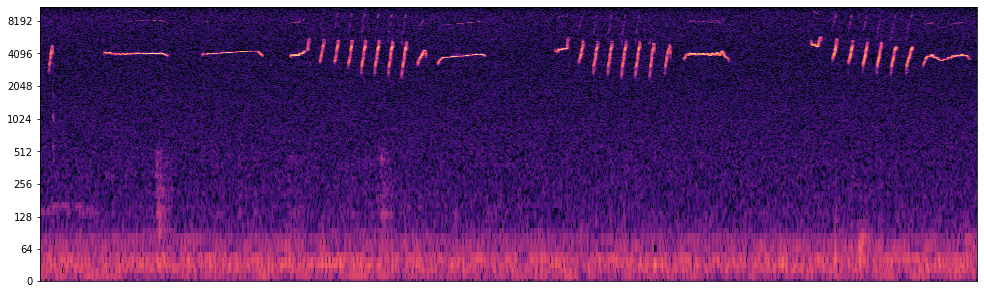

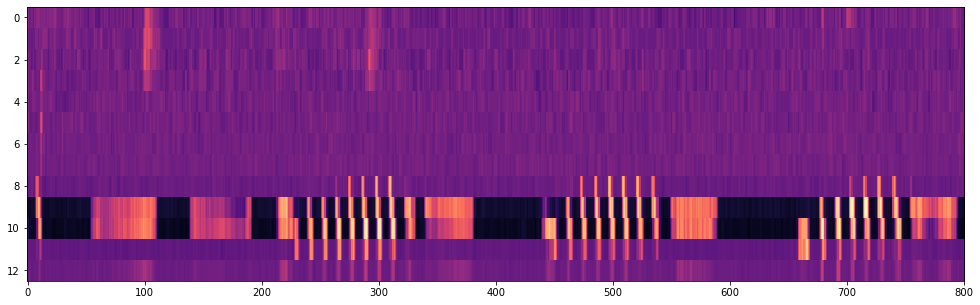

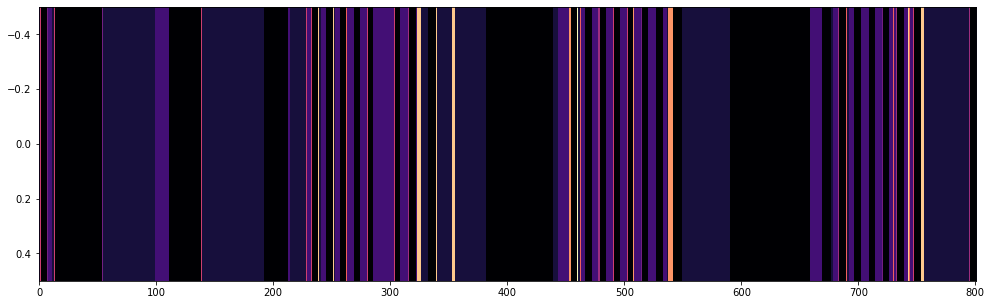

In [210]:
%matplotlib inline
import logging

import scipy
from sklearn import cluster, datasets
from itertools import cycle, islice

n_samples = 1500
blobs = datasets.make_blobs(n_samples=n_samples, random_state=8)
sources, targets = blobs[0], blobs[1]

utt_key = "1100F_0124_2017_0s_10s"
print(mel13_feats[utt_key].shape)
# print(mel80_feats[utt_key].shape)

sources = mel13_feats[utt_key] # (num_frames, feat_dim) 
# sources = mel80_feats[utt_key] 

D = sources.shape[1]
alpha = 1 # concentrate parameter
mu0 = np.mean(sources, axis = 0)
lmbda = 1 # belief of the mean
Sigma0 = np.cov(sources.T) # belief of the covariance
nu = D + 3 # belief of variance or degree of freedom
K0=3 # initial number of clusters
num_iterations = 1500
verbose=True

results = DPGMM3(alpha, mu0, lmbda, Sigma0, nu, sources, K0, num_iterations, verbose)
# preds = results['z']
preds_mel13 = np.argmax(results['z_posterior'], axis=1)

print(preds_mel13)

# https://librosa.org/doc/main/auto_examples/plot_display.html
import numpy as np
import matplotlib.pyplot as plt

import librosa
import librosa.display

utt_key = "1100F_0124_2017_0s_10s"
print(mel13_feats["1100F_0124_2017_0s_10s"].shape)
# print(mfcc13_feats["1100F_0124_2017_0s_10s"].shape)

y, sr = librosa.load(path, sr=48000)
D = librosa.stft(y)  # STFT of y
S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)

plt.figure(figsize=(14*1.2, 4.2*1.2))
# draw_spectrogram(spectrogram)
ax = librosa.display.specshow(S_db, cmap='magma', y_axis='log')
plt.gca().set_ylabel(None)# Turn off y labels

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = plt.imshow(mel13_feats[utt_key].T, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = plt.imshow(preds_mel13[:,np.newaxis].T, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'

In [202]:
%matplotlib inline
import logging

import scipy
from sklearn import cluster, datasets
from itertools import cycle, islice

n_samples = 1500
blobs = datasets.make_blobs(n_samples=n_samples, random_state=8)
sources, targets = blobs[0], blobs[1]

utt_key = "1100F_0124_2017_0s_10s"
# print(mfcc40_feats[utt_key].shape)
print(mel80_feats[utt_key].shape)

# sources = mfcc40_feats[utt_key] # (num_frames, feat_dim) 
sources = mel80_feats[utt_key] 

D = sources.shape[1]
alpha = 1 # concentrate parameter
mu0 = np.mean(sources, axis = 0)
lmbda = 1 # belief of the mean
Sigma0 = np.cov(sources.T) # belief of the covariance
nu = D + 3 # belief of variance or degree of freedom
K0=3 # initial number of clusters
num_iterations = 1500
verbose=True

results = DPGMM3(alpha, mu0, lmbda, Sigma0, nu, sources, K0, num_iterations, verbose)
# preds = results['z']
preds_mel80 = np.argmax(results['z_posterior'], axis=1)

(801, 80)


In [203]:
preds_mel80

array([2, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 2, 2, 2, 2, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 0, 0,
       2, 2, 2, 2, 2, 1, 1, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 2, 2, 2, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 2, 1, 1, 1, 2, 0, 0, 0, 0, 0, 0, 1,
       1, 2, 1, 1, 2, 0, 0, 0, 0, 0, 1, 1, 2, 0, 0, 1, 0, 0, 0, 0, 0, 2,
       2, 1, 2, 2, 1, 0, 0, 0, 2, 2, 2, 2, 2, 2, 0,

(801, 80)
(998, 13)


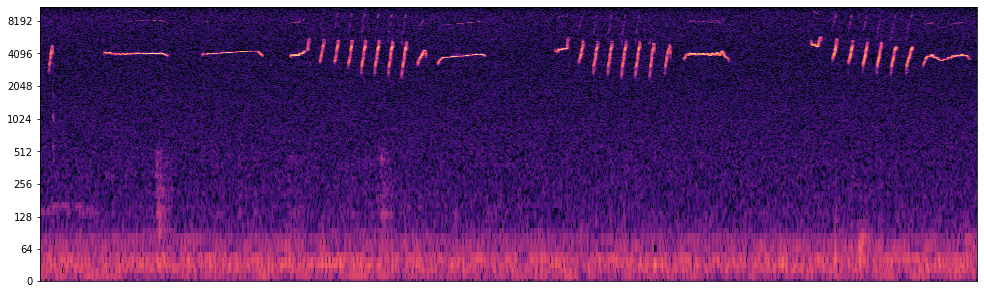

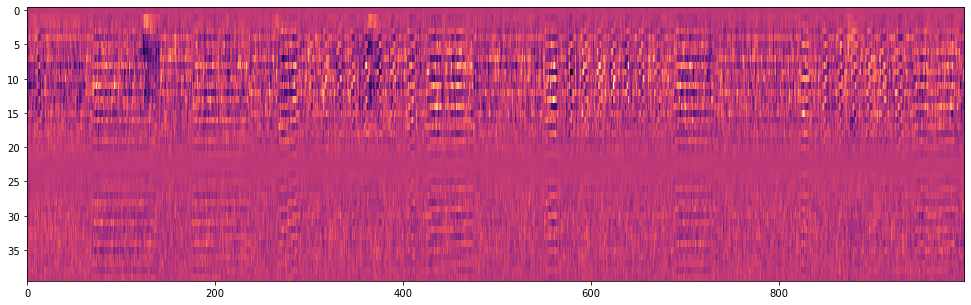

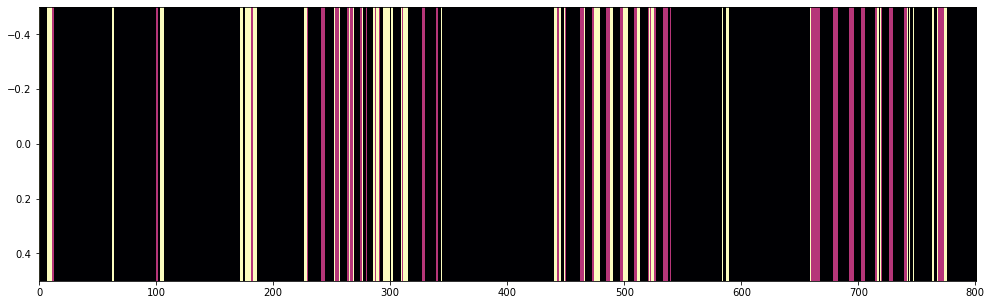

In [204]:
# https://librosa.org/doc/main/auto_examples/plot_display.html
import numpy as np
import matplotlib.pyplot as plt

import librosa
import librosa.display

utt_key = "1100F_0124_2017_0s_10s"
print(mel80_feats["1100F_0124_2017_0s_10s"].shape)
print(mfcc13_feats["1100F_0124_2017_0s_10s"].shape)

y, sr = librosa.load(path, sr=48000)
D = librosa.stft(y)  # STFT of y
S_db = librosa.amplitude_to_db(np.abs(D), ref=np.max)

plt.figure(figsize=(14*1.2, 4.2*1.2))
# draw_spectrogram(spectrogram)
ax = librosa.display.specshow(S_db, cmap='magma', y_axis='log')
plt.gca().set_ylabel(None)# Turn off y labels

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = plt.imshow(mfcc40_feats[utt_key].T, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'

plt.figure(figsize=(14*1.2, 4.2*1.2))
ax = plt.imshow(preds_mel80[:,np.newaxis].T, aspect='auto', cmap='magma') # continuous cmap='viridis' discrete cmap='tab20c'

In [182]:
%matplotlib notebook
import logging

import scipy
from sklearn import cluster, datasets
from itertools import cycle, islice

n_samples = 1500
blobs = datasets.make_blobs(n_samples=n_samples, random_state=8)
sources, targets = blobs[0], blobs[1]

utt_key = "1100F_0124_2017_0s_10s"
print(mel80_feats[utt_key].shape)
print(mfcc40_feats[utt_key].shape)

sources = mel80_feats[utt_key] # (num_frames, feat_dim) 

D = sources.shape[1]
alpha = 1 # concentrate parameter
mu0 = np.mean(sources, axis = 0)
lmbda = 1 # belief of the mean
Sigma0 = np.cov(sources.T) # belief of the covariance
nu = D + 3 # belief of variance or degree of freedom
K0=1 # initial number of clusters
num_iterations = 1500
verbose=True

results = DPGMM3(alpha, mu0, lmbda, Sigma0, nu, sources, K0, num_iterations, verbose)
# preds = results['z']
preds_mel80 = np.argmax(results['z_posterior'], axis=1)

(1500, 2)

(801, 80)
(998, 40)


In [17]:
librosa.feature.delta

<function librosa.feature.utils.delta(data, width=9, order=1, axis=-1, mode='interp', **kwargs)>

In [15]:
D.shape

(1025, 938)

In [19]:
utt_key = "1100F_0124_2017_0s_10s"
print(mel80_feats["1100F_0124_2017_0s_10s"].shape)
print(mel13_feats["1100F_0124_2017_0s_10s"].T.shape)

(801, 80)
(13, 801)


In [31]:
mel13_feats["1100F_0124_2017_0s_10s"][0]

array([ 0.04380051, -0.00595903,  0.01918627,  0.01036408,  0.00713383,
        0.04559018, -0.01774935, -0.01837803, -0.05451202, -0.14464831,
       -0.09450501, -0.04848342, -0.04558443], dtype=float32)

In [62]:
# in kaldi  --delta-window: Parameter controlling window for delta computation (actual window size for each delta order is 1 + 2*delta-window-size) (int, default = 2)
librosa.feature.delta(mel13_feats["1100F_0124_2017_0s_10s"].T, width=5, order=1).T[0]

array([-0.01139438, -0.01035792, -0.01430527, -0.00425729, -0.00584269,
       -0.02073963,  0.00040765, -0.00159419,  0.00294322,  0.00152656,
       -0.01801569, -0.00098483, -0.00077636], dtype=float32)

In [38]:
librosa.feature.delta(mel13_feats["1100F_0124_2017_0s_10s"].T, width=5,order=2).T[0]

array([ 0.0124893 ,  0.01117618,  0.00884475,  0.01521371,  0.01285833,
        0.01721448, -0.00073676,  0.00217113,  0.00073643,  0.00310029,
        0.01325322,  0.00045036, -0.00561649], dtype=float32)

In [32]:
mel39_feats["1100F_0124_2017_0s_10s"][0]

array([ 4.3800510e-02, -5.9590265e-03,  1.9186266e-02,  1.0364078e-02,
        7.1338266e-03,  4.5590177e-02, -1.7749354e-02, -1.8378034e-02,
       -5.4512024e-02, -1.4464831e-01, -9.4505012e-02, -4.8483416e-02,
       -4.5584425e-02, -1.3839027e-02, -1.1860626e-02, -9.9622738e-03,
       -1.0540260e-02, -8.7348409e-03, -1.8478394e-02,  3.2190792e-04,
       -1.4567885e-03,  5.1695947e-04, -1.6273651e-03, -1.6294584e-02,
       -3.7583988e-04,  3.5195476e-03, -3.2782038e-03, -2.8811761e-03,
       -4.0587946e-03, -1.5685065e-03, -2.1012647e-03, -6.0483669e-03,
        1.3202807e-04, -5.2432460e-04,  7.9913298e-04,  3.4432253e-04,
       -5.0811633e-03, -3.2864744e-04, -1.6971328e-04], dtype=float32)

In [69]:
import python_speech_features
python_speech_features.base.delta(mel13_feats["1100F_0124_2017_0s_10s"], N=2)

array([[-0.01383903, -0.01186063, -0.00996227, ..., -0.01629458,
        -0.00037584,  0.00351955],
       [-0.01429207, -0.01363593, -0.01669482, ..., -0.02060078,
        -0.00104395,  0.00190869],
       [-0.01139438, -0.01035792, -0.01430527, ..., -0.01801569,
        -0.00098483, -0.00077636],
       ...,
       [-0.00581546, -0.00118569, -0.01303015, ..., -0.00243407,
         0.00280609, -0.00324891],
       [-0.00609647, -0.00318164, -0.01172342, ..., -0.00281249,
         0.00140186, -0.0050247 ],
       [-0.00112289,  0.00111119, -0.00786418, ..., -0.00242601,
        -0.00046125, -0.00462553]], dtype=float32)

In [97]:
import python_speech_features
feat_delta = python_speech_features.base.delta(mel13_feats["1100F_0124_2017_0s_10s"], N=2)
python_speech_features.base.delta(feat_delta, N=2)

array([[ 4.4362582e-04,  1.2301104e-04, -1.5418546e-03, ...,
        -7.7484100e-04, -1.8860922e-04, -1.0202671e-03],
       [ 1.6056587e-03,  1.8630745e-03,  6.3177978e-04, ...,
         1.3129439e-03, -1.7996044e-04, -1.5255056e-03],
       [ 3.9682365e-03,  3.5886993e-03,  3.0214924e-03, ...,
         4.2203078e-03, -1.1659055e-04, -1.2683844e-03],
       ...,
       [ 6.7639595e-04, -1.6647208e-04, -2.2833105e-03, ...,
         1.2222088e-03, -4.4171454e-04, -1.0506029e-03],
       [ 1.3763322e-03,  1.7474128e-04,  2.4983249e-04, ...,
        -1.9159063e-04, -1.0557974e-03, -7.8933232e-04],
       [ 1.4358703e-03,  8.8865962e-04,  1.4191180e-03, ...,
         4.0258328e-05, -8.3977863e-04, -2.3540747e-04]], dtype=float32)

index=365, begin_sec=4.5375, end_sec=4.5875
len(wav)=2401
[0.0, 240.1, 480.2, 720.3, 960.4, 1200.5, 1440.6, 1680.7, 1920.8, 2160.9]
240.1
[ 0.00000000e+00  4.79800083e+03  9.59600167e+03  1.43940025e+04
  1.91920033e+04  2.39900042e+04 -1.92119950e+04 -1.44139942e+04
 -9.61599334e+03 -4.81799250e+03 -1.99916701e+01]
['0.0', '4798.0', '9596.0', '14394.0', '19192.0', '23990.0', '-19212.0', '-14414.0', '-9616.0', '-4818.0', '-20.0']



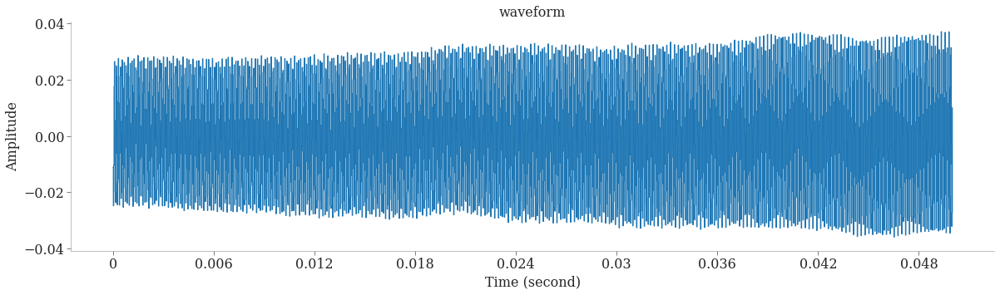

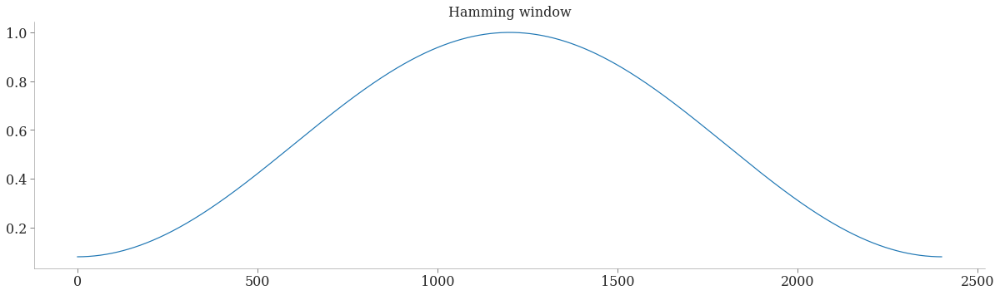

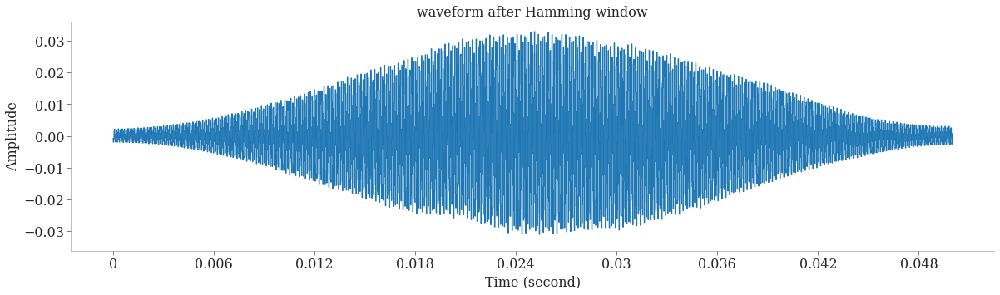

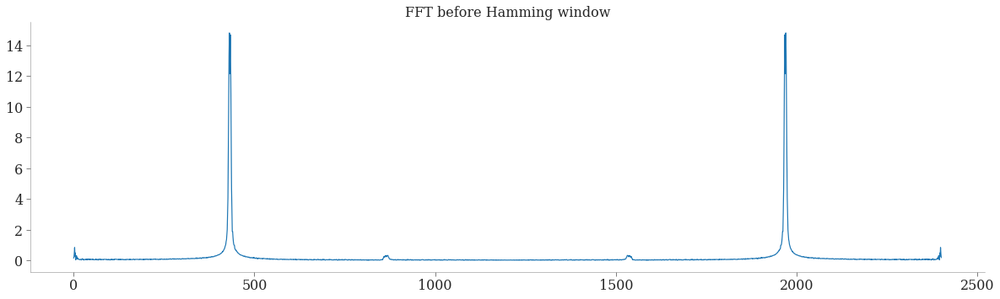

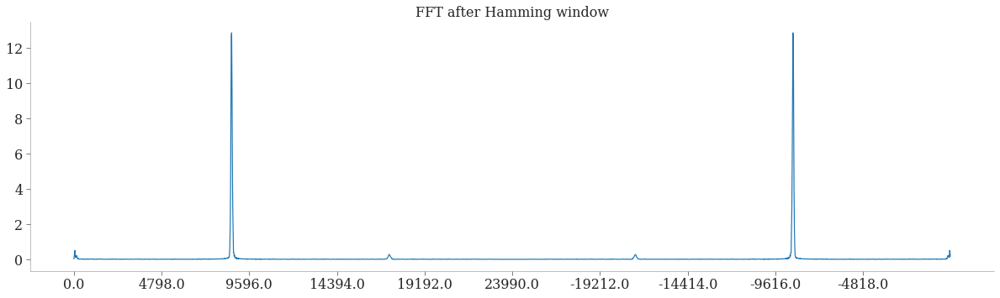

In [465]:
# window_size_ms=50
# window_shift_ms=12.5
# time = 5.98
# time = 6.05
time = 4.56
index, begin_sec, end_sec = time2index(time, window_size=window_size_ms/1000, window_shift=window_shift_ms/1000, center=True, verbose=True)
print(f"{index=}, {begin_sec=}, {end_sec=}")

wav = load_wav(path=path, sr=sampling_rate, begin_sec=begin_sec, end_sec=end_sec)
print(f"{len(wav)=}")
draw_wav(wav, sampling_rate=sampling_rate, title="waveform")


hann_window = scipy.signal.get_window('hann', len(wav))
draw_line_plot(hann_window, title="hann window")

wav_backup = wav
wav = hann_window * wav
draw_wav(wav, sampling_rate=sampling_rate, title="waveform after hann window")

fft_coeff = scipy.fft.fft(wav_backup)
amplitude = np.abs(fft_coeff)
draw_line_plot(amplitude, title="FFT before hann window")

fft_coeff = scipy.fft.fft(wav)
amplitude = np.abs(fft_coeff)
ax = draw_line_plot(amplitude, title="FFT after hann window")



freq = np.fft.fftfreq(len(wav), d=1/sampling_rate) # [0, 20, 40, …] 20 = sampling_rate / window_size_num_samples = 48000 / 2400 
# print(freq)

# # Set the xtick labels.
# ax.set_xticks([0, 1, 2, 3])
# ax.set_xticklabels(['0', '4', '8', '16'])

# ax.set_xticks(np.linspace(start=0, stop=6000, num=4, endpoint=False))

ax.set_xticks(np.linspace(start=0, stop=len(wav), num=10, endpoint=False))

a=ax.get_xticks().tolist()
print(a)
step_size=a[1]-a[0]
print(step_size)
print(freq[::int(step_size)])
labels = [str(round(x, ndigits=0)) for x in freq[::int(step_size)]]
print(labels)

ax.set_xticklabels(labels)

print()
